## Section 1: EDA

### Section 1.1: Env Setup

In [291]:
import sys
import platform
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import warnings
warnings.filterwarnings('ignore')

plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("husl")
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'font.size': 12,
    'axes.titlesize': 14,
    'axes.labelsize': 12,
    'xtick.labelsize': 10,
    'ytick.labelsize': 10,
    'legend.fontsize': 10,
    'figure.titlesize': 16,
    'figure.dpi': 300,
    'savefig.dpi': 300,
    'savefig.bbox': 'tight',
    'savefig.transparent': False
})

# Display configuration for better data presentation
pd.set_option("display.max_columns", 50)
pd.set_option("display.width", 120)
pd.set_option("display.float_format", lambda x: f"{x:,.4f}")

# Reproducibility
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

# Version logging for methodological transparency
import matplotlib
print("=" * 70)
print("EXPERIMENTAL SETUP AND COMPUTATIONAL ENVIRONMENT")
print("=" * 70)
print(f"Python Version: {sys.version.split()[0]}")
print(f"Pandas Version: {pd.__version__}")
print(f"Numpy Version: {np.__version__}")
print(f"Matplotlib Version: {matplotlib.__version__}")
print(f"Seaborn Version: {sns.__version__}")
print(f"Platform: {platform.platform()}")
print(f"Random Seed: {RANDOM_SEED}")
print("=" * 70)

EXPERIMENTAL SETUP AND COMPUTATIONAL ENVIRONMENT
Python Version: 3.13.5
Pandas Version: 2.3.3
Numpy Version: 2.3.5
Matplotlib Version: 3.10.7
Seaborn Version: 0.13.2
Platform: Windows-11-10.0.26200-SP0
Random Seed: 42


### Section 1.2: Data loading + Primary Data cleaning + Dataset structure/shape/summary

In [292]:
def load_and_validate_data(file_path):
    """
    Load dataset with comprehensive validation checks
    
    Parameters:
    -----------
    file_path : str
        Path to the CSV file
        
    Returns:
    --------
    pd.DataFrame
        Validated dataset
    """
    print("\n1. DATA LOADING AND VALIDATION")
    print("-" * 40)
    
    try:
        df = pd.read_csv(file_path)
        print(f"✓ Dataset loaded successfully: {df.shape[0]} rows, {df.shape[1]} columns")
        
        # Remove unnecessary index column if present
        if "Unnamed: 0" in df.columns:
            df.drop(columns=["Unnamed: 0"], inplace=True)
            print("✓ Removed redundant index column")
        
        # Basic dataset information
        print(f"✓ Memory usage: {df.memory_usage(deep=True).sum() / 1024**2:.2f} MB")
        print(f"✓ Column types:\n{df.dtypes.value_counts()}")
        
        return df
    
    except FileNotFoundError:
        raise FileNotFoundError(f"Dataset not found at path: {file_path}")
    except Exception as e:
        raise Exception(f"Error loading dataset: {str(e)}")

# Load data
data_path = "cs-training.csv"
df = load_and_validate_data(data_path)

print("Shape of dataset (rows, columns):", df.shape)
df.head()


1. DATA LOADING AND VALIDATION
----------------------------------------
✓ Dataset loaded successfully: 150000 rows, 12 columns
✓ Removed redundant index column
✓ Memory usage: 12.59 MB
✓ Column types:
int64      7
float64    4
Name: count, dtype: int64
Shape of dataset (rows, columns): (150000, 11)


,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,0.7661,45,2,0.8030,"9,120.0000",13,0,6,0,2.0000
1,0,0.9572,40,0,0.1219,"2,600.0000",4,0,0,0,1.0000
2,0,0.6582,38,1,0.0851,"3,042.0000",2,1,0,0,0.0000
3,0,0.2338,30,0,0.0360,"3,300.0000",5,0,0,0,0.0000
4,0,0.9072,49,1,0.0249,"63,588.0000",7,0,1,0,0.0000


In [293]:
print("Columns in the dataset:\n", df.columns.tolist(), "\n")

print("DataFrame info:")
df.info()



Columns in the dataset:
 ['SeriousDlqin2yrs', 'RevolvingUtilizationOfUnsecuredLines', 'age', 'NumberOfTime30-59DaysPastDueNotWorse', 'DebtRatio', 'MonthlyIncome', 'NumberOfOpenCreditLinesAndLoans', 'NumberOfTimes90DaysLate', 'NumberRealEstateLoansOrLines', 'NumberOfTime60-89DaysPastDueNotWorse', 'NumberOfDependents'] 

DataFrame info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 11 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   SeriousDlqin2yrs                      150000 non-null  int64  
 1   RevolvingUtilizationOfUnsecuredLines  150000 non-null  float64
 2   age                                   150000 non-null  int64  
 3   NumberOfTime30-59DaysPastDueNotWorse  150000 non-null  int64  
 4   DebtRatio                             150000 non-null  float64
 5   MonthlyIncome                         120269 non-null  float64
 6   Num

In [294]:
print("\nBasic statistical summary (all numeric columns):")
df.describe().T


Basic statistical summary (all numeric columns):


,count,mean,std,min,25%,50%,75%,max
SeriousDlqin2yrs,"150,000.0000",0.0668,0.2497,0.0000,0.0000,0.0000,0.0000,1.0000
RevolvingUtilizationOfUnsecuredLines,"150,000.0000",6.0484,249.7554,0.0000,0.0299,0.1542,0.5590,"50,708.0000"
age,"150,000.0000",52.2952,14.7719,0.0000,41.0000,52.0000,63.0000,109.0000
NumberOfTime30-59DaysPastDueNotWorse,"150,000.0000",0.4210,4.1928,0.0000,0.0000,0.0000,0.0000,98.0000
DebtRatio,"150,000.0000",353.0051,"2,037.8185",0.0000,0.1751,0.3665,0.8683,"329,664.0000"
MonthlyIncome,"120,269.0000","6,670.2212","14,384.6742",0.0000,"3,400.0000","5,400.0000","8,249.0000","3,008,750.0000"
NumberOfOpenCreditLinesAndLoans,"150,000.0000",8.4528,5.1460,0.0000,5.0000,8.0000,11.0000,58.0000
NumberOfTimes90DaysLate,"150,000.0000",0.2660,4.1693,0.0000,0.0000,0.0000,0.0000,98.0000
NumberRealEstateLoansOrLines,"150,000.0000",1.0182,1.1298,0.0000,0.0000,1.0000,2.0000,54.0000
NumberOfTime60-89DaysPastDueNotWorse,"150,000.0000",0.2404,4.1552,0.0000,0.0000,0.0000,0.0000,98.0000


### Sectuib 1.3: Target variable distribution and class imbalance findout


2. TARGET VARIABLE ANALYSIS: SeriousDlqin2yrs
----------------------------------------
✓ Class Distribution:
  - Class 0 (Non-default): 139,974 (93.32%)
  - Class 1 (Default):     10,026 (6.68%)
✓ Class Imbalance Ratio: 13.96:1
✓ Missing Values: 0


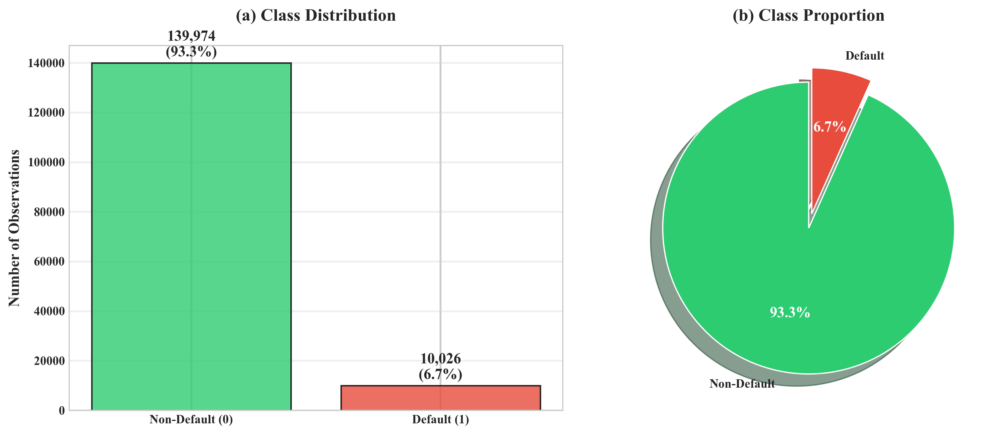

In [295]:
def analyze_target_distribution(df, target_col="SeriousDlqin2yrs"):
    """
    Comprehensive analysis of target variable distribution
    
    Parameters:
    -----------
    df : pd.DataFrame
        Input dataset
    target_col : str
        Target variable name
    """
    print(f"\n2. TARGET VARIABLE ANALYSIS: {target_col}")
    print("-" * 40)
    
    if target_col not in df.columns:
        raise KeyError(f"Target column '{target_col}' not found")
    
    # Calculate distribution statistics
    target_counts = df[target_col].value_counts().sort_index()
    target_percent = df[target_col].value_counts(normalize=True).sort_index() * 100
    
    # Statistical summary
    class_imbalance_ratio = target_counts[0] / target_counts[1]
    
    print(f"✓ Class Distribution:")
    print(f"  - Class 0 (Non-default): {target_counts[0]:,} ({target_percent[0]:.2f}%)")
    print(f"  - Class 1 (Default):     {target_counts[1]:,} ({target_percent[1]:.2f}%)")
    print(f"✓ Class Imbalance Ratio: {class_imbalance_ratio:.2f}:1")
    print(f"✓ Missing Values: {df[target_col].isna().sum()}")
    
    # Create publication-quality visualization
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    
    # Bar plot with annotations
    bars = ax1.bar(['Non-Default (0)', 'Default (1)'], target_counts.values, 
                   color=['#2ecc71', '#e74c3c'], alpha=0.8, edgecolor='black', linewidth=1.2)
    ax1.set_title('(a) Class Distribution', fontweight='bold', pad=20)
    ax1.set_ylabel('Number of Observations', fontweight='bold')
    ax1.grid(axis='y', alpha=0.3)
    
    # Add value annotations on bars
    for bar, count, percent in zip(bars, target_counts.values, target_percent.values):
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height + max(target_counts.values)*0.01,
                f'{count:,}\n({percent:.1f}%)', ha='center', va='bottom', fontweight='bold')
    
    # Pie chart for proportion visualization
    colors = ['#2ecc71', '#e74c3c']
    explode = (0, 0.1)
    wedges, texts, autotexts = ax2.pie(target_percent.values, labels=['Non-Default', 'Default'], 
                                       autopct='%1.1f%%', startangle=90, colors=colors,
                                       explode=explode, shadow=True)
    ax2.set_title('(b) Class Proportion', fontweight='bold', pad=20)
    
    # Style pie chart text
    for autotext in autotexts:
        autotext.set_color('white')
        autotext.set_fontweight('bold')
    
    plt.tight_layout()
    plt.show()
    
    return target_counts, target_percent

target_counts, target_percent = analyze_target_distribution(df)


3. SYSTEMATIC MISSING DATA ANALYSIS
----------------------------------------
Missing Data Summary:
                    Missing_Count  Missing_Percent
MonthlyIncome               29731          19.8207
NumberOfDependents           3924           2.6160


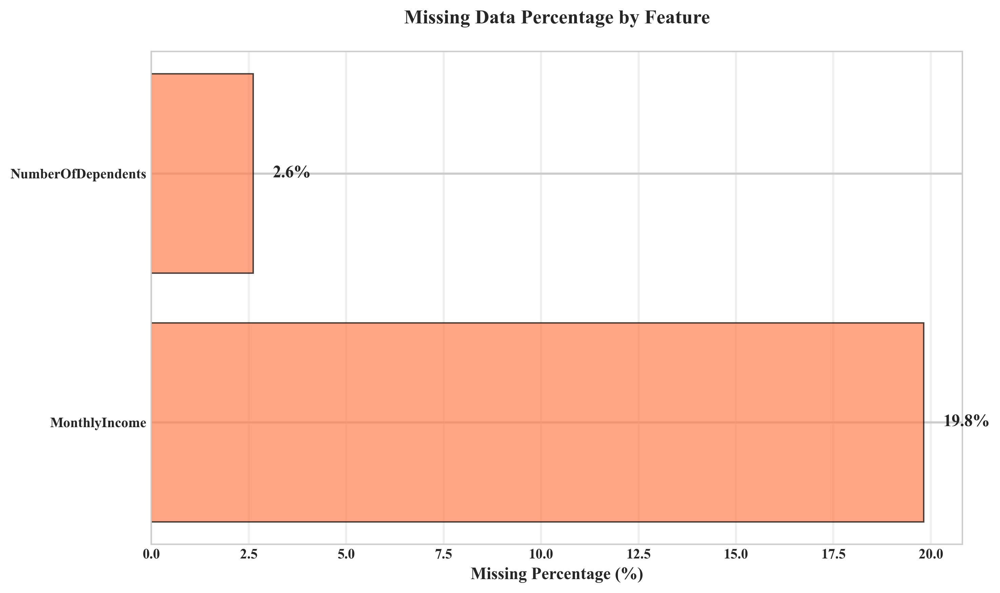

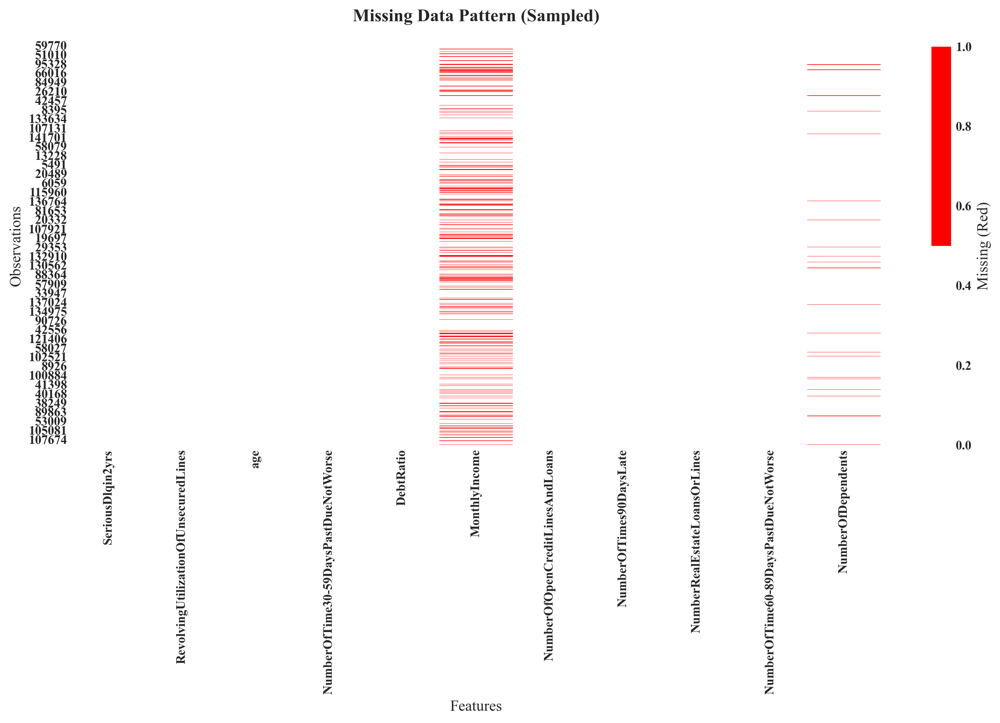

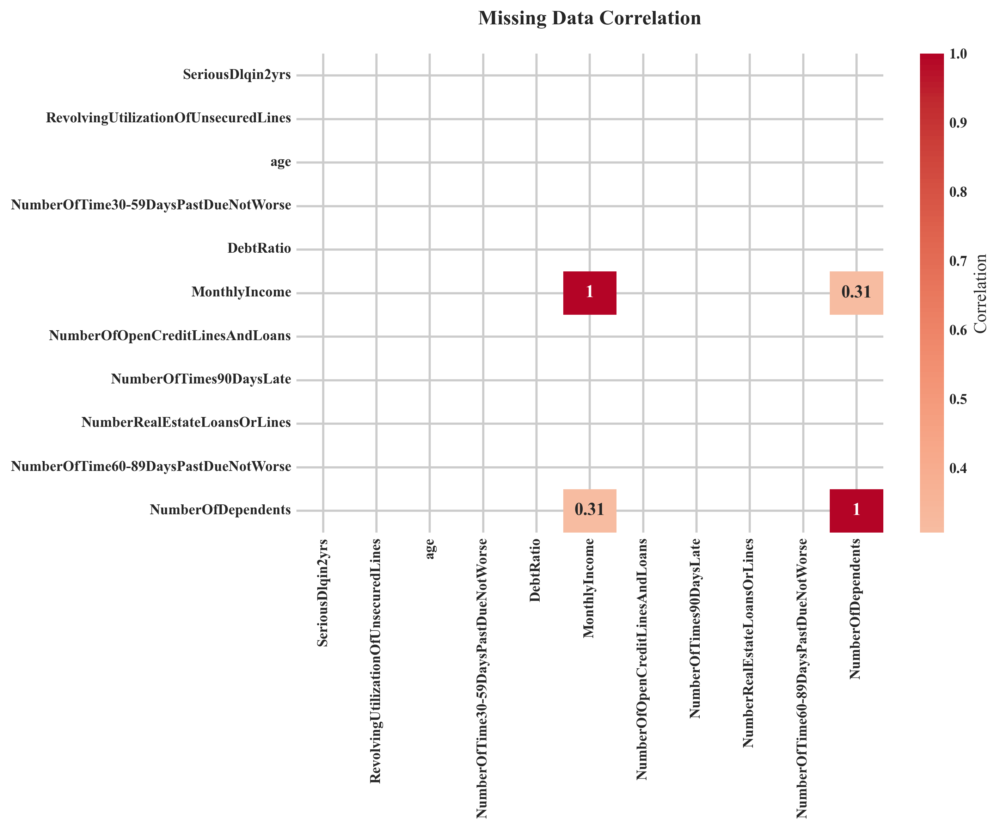

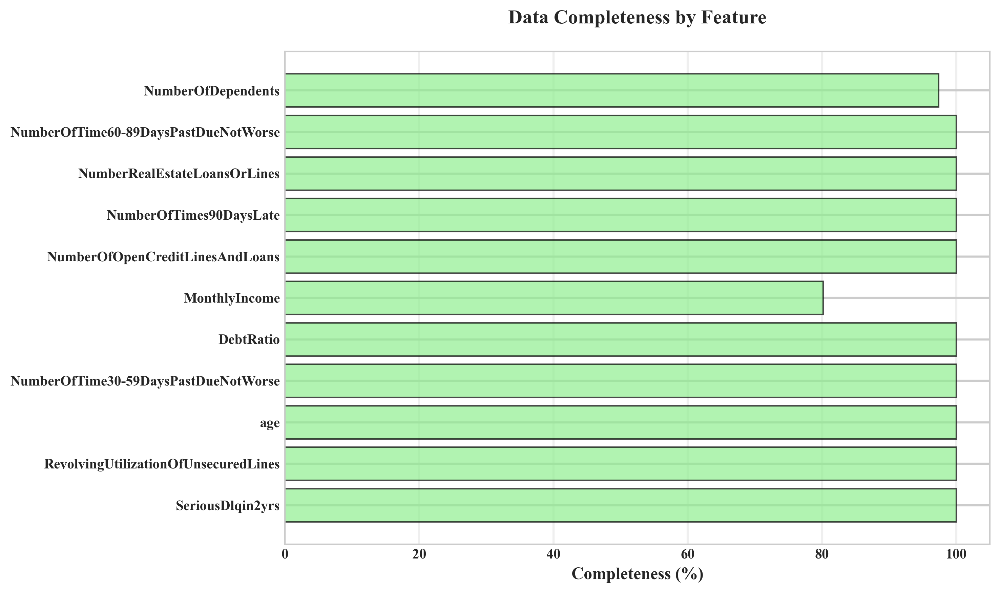

In [296]:
# =============================================================================
# COMPREHENSIVE MISSING DATA ANALYSIS - MODULAR APPROACH
# =============================================================================

def create_missing_bar_plot(missing_df):
    """Create missing data percentage bar plot"""
    missing_data = missing_df[missing_df["Missing_Count"] > 0]
    if not missing_data.empty:
        plt.figure(figsize=(10, 6))
        bars = plt.barh(missing_data.index, missing_data["Missing_Percent"], 
                       color='coral', alpha=0.7, edgecolor='black')
        plt.title('Missing Data Percentage by Feature', fontweight='bold', pad=20)
        plt.xlabel('Missing Percentage (%)', fontweight='bold')
        plt.grid(axis='x', alpha=0.3)
        
        for bar in bars:
            width = bar.get_width()
            plt.text(width + 0.5, bar.get_y() + bar.get_height()/2., 
                    f'{width:.1f}%', ha='left', va='center', fontweight='bold')
        plt.tight_layout()
        plt.show()

def create_missing_heatmap(df, sample_size=1000):
    """Create missing data pattern heatmap"""
    plt.figure(figsize=(12, 8))
    df_sample = df.sample(min(sample_size, len(df)), random_state=RANDOM_SEED)
    missing_matrix = df_sample.isna()
    
    sns.heatmap(missing_matrix, cbar=True, cmap=['white', 'red'], 
                cbar_kws={'label': 'Missing (Red)'})
    plt.title('Missing Data Pattern (Sampled)', fontweight='bold', pad=20)
    plt.xlabel('Features')
    plt.ylabel('Observations')
    plt.tight_layout()
    plt.show()
    
    return missing_matrix

def create_missing_correlation(missing_matrix):
    """Create missing data correlation heatmap"""
    plt.figure(figsize=(10, 8))
    missing_corr = missing_matrix.corr()
    sns.heatmap(missing_corr, annot=True, cmap='coolwarm', center=0, 
                cbar_kws={'label': 'Correlation'})
    plt.title('Missing Data Correlation', fontweight='bold', pad=20)
    plt.tight_layout()
    plt.show()

def create_completeness_plot(missing_percent):
    """Create data completeness bar plot"""
    plt.figure(figsize=(10, 6))
    completeness = (1 - missing_percent/100) * 100
    plt.barh(range(len(completeness)), completeness.values, 
             color='lightgreen', alpha=0.7, edgecolor='black')
    plt.yticks(range(len(completeness)), completeness.index)
    plt.title('Data Completeness by Feature', fontweight='bold', pad=20)
    plt.xlabel('Completeness (%)', fontweight='bold')
    plt.grid(axis='x', alpha=0.3)
    plt.tight_layout()
    plt.show()

def analyze_missing_data_modular(df):
    """
    Modular missing data analysis with separate visualizations
    """
    print("\n3. SYSTEMATIC MISSING DATA ANALYSIS")
    print("-" * 40)
    
    # Calculate missing data statistics
    missing_counts = df.isna().sum()
    missing_percent = (missing_counts / len(df)) * 100
    
    missing_df = pd.DataFrame({
        "Missing_Count": missing_counts,
        "Missing_Percent": missing_percent
    }).sort_values("Missing_Percent", ascending=False)
    
    print("Missing Data Summary:")
    print(missing_df[missing_df["Missing_Count"] > 0])
    
    # Create individual visualizations
    create_missing_bar_plot(missing_df)
    missing_matrix = create_missing_heatmap(df)
    create_missing_correlation(missing_matrix)
    create_completeness_plot(missing_percent)
    
    return missing_df

# Execute the modular analysis
missing_df = analyze_missing_data_modular(df)


4. FEATURE CLASSIFICATION AND DATA TYPE ANALYSIS
----------------------------------------
✓ Numerical Features (11):
  - SeriousDlqin2yrs
  - RevolvingUtilizationOfUnsecuredLines
  - age
  - NumberOfTime30-59DaysPastDueNotWorse
  - DebtRatio
  - MonthlyIncome
  - NumberOfOpenCreditLinesAndLoans
  - NumberOfTimes90DaysLate
  - NumberRealEstateLoansOrLines
  - NumberOfTime60-89DaysPastDueNotWorse
  - NumberOfDependents
✓ Categorical Features (0):


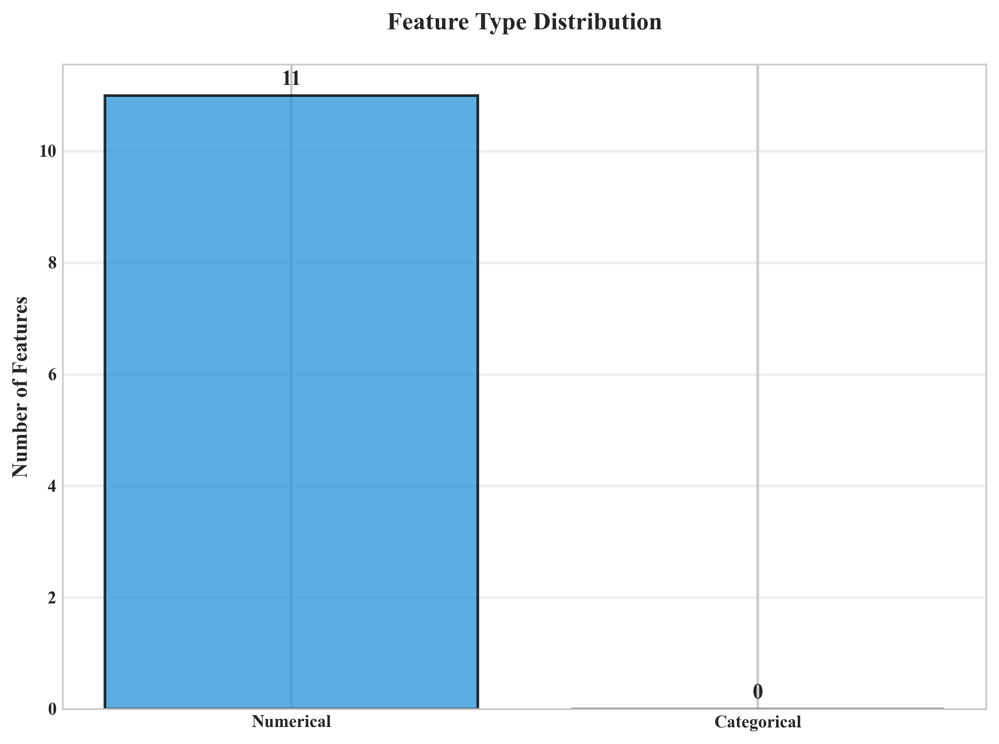

In [297]:
# =============================================================================
# DATA TYPE ANALYSIS AND FEATURE CLASSIFICATION
# =============================================================================

def analyze_data_types(df):
    """
    Comprehensive data type analysis and feature classification
    """
    print("\n4. FEATURE CLASSIFICATION AND DATA TYPE ANALYSIS")
    print("-" * 40)
    
    numeric_cols = df.select_dtypes(include=[np.number]).columns.tolist()
    categorical_cols = df.select_dtypes(exclude=[np.number]).columns.tolist()
    
    print(f"✓ Numerical Features ({len(numeric_cols)}):")
    for col in numeric_cols:
        print(f"  - {col}")
    
    print(f"✓ Categorical Features ({len(categorical_cols)}):")
    for col in categorical_cols:
        print(f"  - {col}")
    
    # Create feature type visualization
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))
    
    feature_types = ['Numerical', 'Categorical']
    counts = [len(numeric_cols), len(categorical_cols)]
    colors = ['#3498db', '#9b59b6']
    
    bars = ax.bar(feature_types, counts, color=colors, alpha=0.8, 
                  edgecolor='black', linewidth=1.5)
    ax.set_title('Feature Type Distribution', fontweight='bold', pad=20)
    ax.set_ylabel('Number of Features', fontweight='bold')
    ax.grid(axis='y', alpha=0.3)
    
    # Add value annotations
    for bar, count in zip(bars, counts):
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height + 0.1,
                f'{count}', ha='center', va='bottom', fontweight='bold', fontsize=12)
    
    plt.tight_layout()
    plt.show()
    
    return numeric_cols, categorical_cols

numeric_cols, categorical_cols = analyze_data_types(df)


5. COMPREHENSIVE UNIVARIATE ANALYSIS
----------------------------------------
Comprehensive Statistical Summary:
                                            count       mean         std    min      1%         5%        25%  \
SeriousDlqin2yrs                     150,000.0000     0.0668      0.2497 0.0000  0.0000     0.0000     0.0000   
RevolvingUtilizationOfUnsecuredLines 150,000.0000     6.0484    249.7554 0.0000  0.0000     0.0000     0.0299   
age                                  150,000.0000    52.2952     14.7719 0.0000 24.0000    29.0000    41.0000   
NumberOfTime30-59DaysPastDueNotWorse 150,000.0000     0.4210      4.1928 0.0000  0.0000     0.0000     0.0000   
DebtRatio                            150,000.0000   353.0051  2,037.8185 0.0000  0.0000     0.0043     0.1751   
MonthlyIncome                        120,269.0000 6,670.2212 14,384.6742 0.0000  0.0000 1,300.0000 3,400.0000   
NumberOfOpenCreditLinesAndLoans      150,000.0000     8.4528      5.1460 0.0000  0.0000     2.0

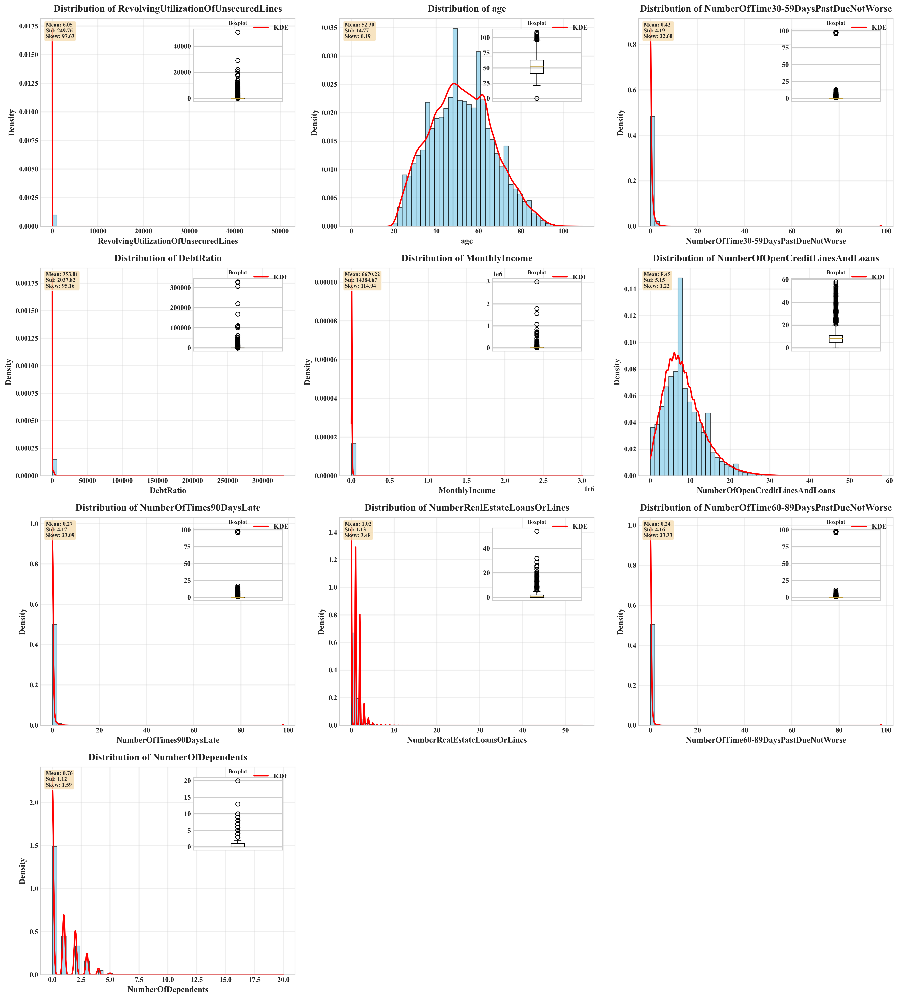

In [298]:
# =============================================================================
# COMPREHENSIVE UNIVARIATE ANALYSIS
# =============================================================================

def comprehensive_univariate_analysis(df, numeric_cols, target_col="SeriousDlqin2yrs"):
    """
    Comprehensive univariate analysis with statistical summaries and visualizations
    """
    print("\n5. COMPREHENSIVE UNIVARIATE ANALYSIS")
    print("-" * 40)
    
    # Generate detailed statistical summary
    numeric_desc = df[numeric_cols].describe(percentiles=[0.01, 0.05, 0.25, 0.5, 0.75, 0.95, 0.99]).T
    numeric_desc['IQR'] = numeric_desc['75%'] - numeric_desc['25%']
    numeric_desc['CV'] = numeric_desc['std'] / numeric_desc['mean']  # Coefficient of variation
    numeric_desc['Skewness'] = df[numeric_cols].skew()
    numeric_desc['Kurtosis'] = df[numeric_cols].kurtosis()
    
    print("Comprehensive Statistical Summary:")
    print(numeric_desc.round(4))
    
    # Create enhanced distribution visualizations
    features_to_plot = [col for col in numeric_cols if col != target_col]
    n_features = len(features_to_plot)
    
    # Calculate grid dimensions
    n_cols = 3
    n_rows = (n_features + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 5*n_rows))
    axes = axes.flatten() if n_features > 1 else [axes]
    
    for idx, col in enumerate(features_to_plot):
        if idx < len(axes):
            # Remove missing values for plotting
            data = df[col].dropna()
            
            # Create combined histogram and boxplot
            gs = axes[idx].inset_axes([0.6, 0.6, 0.35, 0.35])
            
            # Main histogram with KDE
            n, bins, patches = axes[idx].hist(data, bins=50, alpha=0.7, color='skyblue', 
                                            edgecolor='black', density=True)
            # Add KDE
            from scipy.stats import gaussian_kde
            kde = gaussian_kde(data)
            x_vals = np.linspace(data.min(), data.max(), 1000)
            axes[idx].plot(x_vals, kde(x_vals), 'r-', linewidth=2, label='KDE')
            
            axes[idx].set_title(f'Distribution of {col}', fontweight='bold', pad=10)
            axes[idx].set_xlabel(col, fontweight='bold')
            axes[idx].set_ylabel('Density', fontweight='bold')
            axes[idx].legend()
            axes[idx].grid(alpha=0.3)
            
            # Inset boxplot
            box_plot = gs.boxplot(data, vert=True)
            gs.set_title('Boxplot', fontsize=8)
            gs.set_xticks([])
            
            # Add statistical annotations
            stats_text = f'Mean: {data.mean():.2f}\nStd: {data.std():.2f}\nSkew: {data.skew():.2f}'
            axes[idx].text(0.02, 0.98, stats_text, transform=axes[idx].transAxes, 
                          verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8),
                          fontsize=8)
    
    # Hide empty subplots
    for idx in range(n_features, len(axes)):
        axes[idx].set_visible(False)
    
    plt.tight_layout()
    plt.show()
    
    return numeric_desc

numeric_desc = comprehensive_univariate_analysis(df, numeric_cols)


7. COMPREHENSIVE CORRELATION ANALYSIS
----------------------------------------
Correlation Matrix Overview:
✓ Matrix Shape: (11, 11)
✓ Strong Correlations (|r| > 0.7):
  - NumberOfTime30-59DaysPastDueNotWorse vs NumberOfTimes90DaysLate: 0.975
  - NumberOfTime30-59DaysPastDueNotWorse vs NumberOfTime60-89DaysPastDueNotWorse: 0.980
  - NumberOfTimes90DaysLate vs NumberOfTime60-89DaysPastDueNotWorse: 0.989


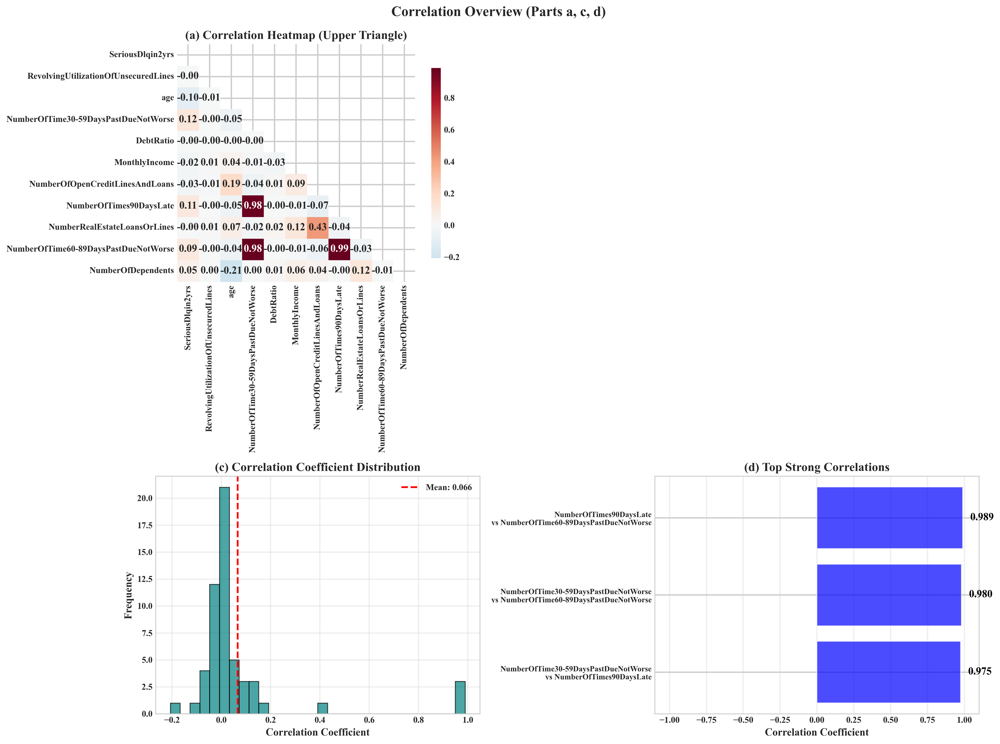


Generating Clustered Matrix (Figure 2)...


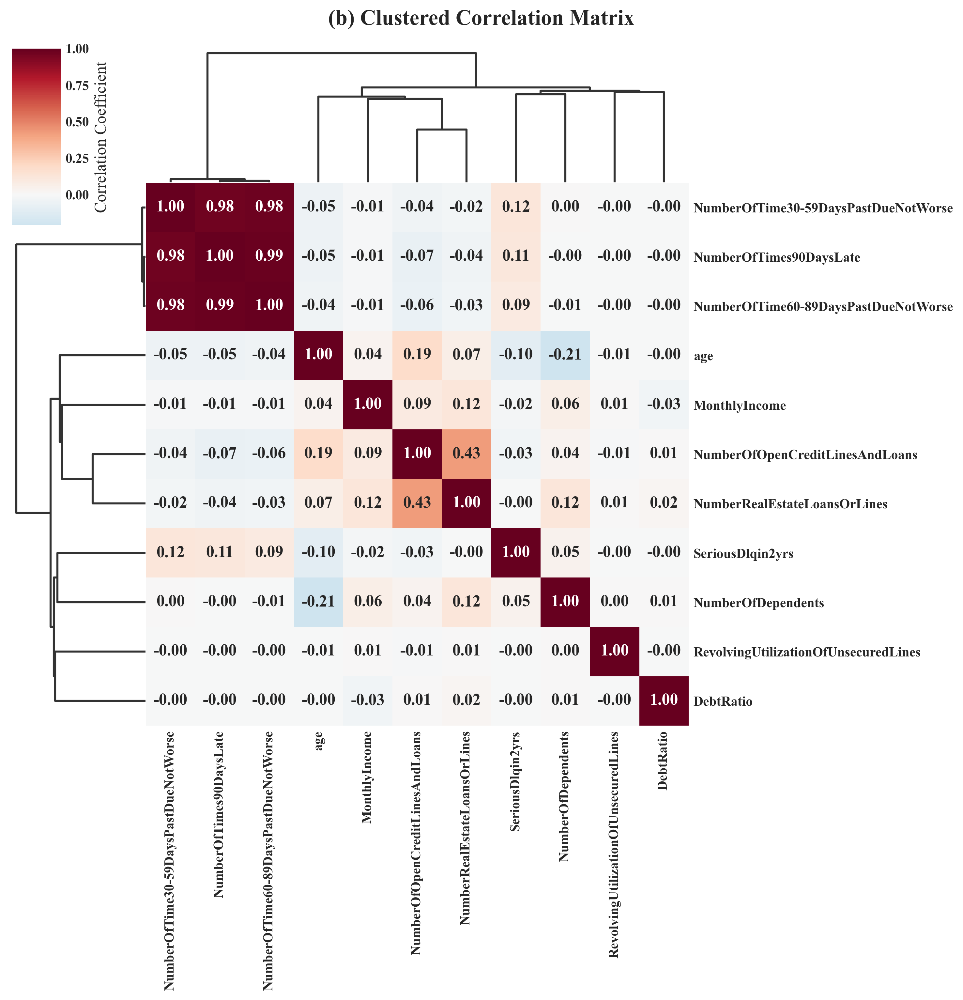

In [299]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# =============================================================================
# CORRELATION ANALYSIS WITH ADVANCED VISUALIZATION (FIXED)
# =============================================================================

def comprehensive_correlation_analysis_fixed(df, numeric_cols):
    """
    Advanced correlation analysis with multiple visualization techniques,
    separated into distinct figures to prevent layout issues.
    """
    print("\n7. COMPREHENSIVE CORRELATION ANALYSIS")
    print("-" * 40)

    # Calculate correlation matrix
    # Ensure we only use numeric columns and drop NaNs for correlation calc
    corr_df = df[numeric_cols].dropna()
    if corr_df.empty:
         print("Not enough numeric data to calculate correlations.")
         return None, None

    corr_matrix = corr_df.corr()

    print("Correlation Matrix Overview:")
    print(f"✓ Matrix Shape: {corr_matrix.shape}")
    print(f"✓ Strong Correlations (|r| > 0.7):")

    strong_corrs = []
    # Iterate through upper triangle to identify strong correlations
    for i in range(len(corr_matrix.columns)):
        for j in range(i+1, len(corr_matrix.columns)):
            if abs(corr_matrix.iloc[i, j]) > 0.7:
                strong_corrs.append((
                    corr_matrix.columns[i],
                    corr_matrix.columns[j],
                    corr_matrix.iloc[i, j]
                ))
                print(f"  - {corr_matrix.columns[i]} vs {corr_matrix.columns[j]}: {corr_matrix.iloc[i, j]:.3f}")

    # ==============================================================================
    # FIGURE 1: The 2x2 Grid (Plots a, c, d)
    # ==============================================================================
    # We use a 2x2 grid, filling 3 slots and hiding the 4th (top right)
    fig1, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig1.suptitle('Correlation Overview (Parts a, c, d)', fontweight='bold', fontsize=16, y=0.98)

    # --- (a) Standard correlation heatmap (Upper Triangle) ---
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    sns.heatmap(corr_matrix, mask=mask, annot=True, fmt=".2f", cmap="RdBu_r",
                center=0, square=True, ax=axes[0,0], cbar_kws={"shrink": .8})
    axes[0,0].set_title('(a) Correlation Heatmap (Upper Triangle)', fontweight='bold')

    # --- (b) Placeholder - Turn off this axis ---
    # Since clustermap can't go here, we hide this plot area.
    axes[0,1].axis('off')

    # --- (c) Correlation distribution ---
    # Extract unique correlation values (excluding self-correlation of 1.0)
    corr_values = corr_matrix.values[np.triu_indices_from(corr_matrix.values, k=1)]
    if len(corr_values) > 0:
        axes[1,0].hist(corr_values, bins=30, alpha=0.7, color='teal', edgecolor='black')
        axes[1,0].axvline(corr_values.mean(), color='red', linestyle='--', linewidth=2,
                          label=f'Mean: {corr_values.mean():.3f}')
        axes[1,0].set_title('(c) Correlation Coefficient Distribution', fontweight='bold')
        axes[1,0].set_xlabel('Correlation Coefficient', fontweight='bold')
        axes[1,0].set_ylabel('Frequency', fontweight='bold')
        axes[1,0].legend()
        axes[1,0].grid(alpha=0.3)
    else:
         axes[1,0].text(0.5, 0.5, "Not enough correlation pairs to plot distribution",
                        ha='center', va='center')

    # --- (d) Top correlations bar plot ---
    if strong_corrs:
        strong_corr_df = pd.DataFrame(strong_corrs, columns=['Feature1', 'Feature2', 'Correlation'])
        # Sort by absolute value and take top 10
        strong_corr_df = strong_corr_df.reindex(
            strong_corr_df.Correlation.abs().sort_values(ascending=False).index
        ).head(10)

        # Reverse order for horizontal bar plot (top correlations at top)
        strong_corr_df = strong_corr_df.iloc[::-1]

        y_pos = np.arange(len(strong_corr_df))
        colors = ['red' if x < 0 else 'blue' for x in strong_corr_df['Correlation']]

        bars = axes[1,1].barh(y_pos, strong_corr_df['Correlation'], color=colors, alpha=0.7)
        axes[1,1].set_yticks(y_pos)
        axes[1,1].set_yticklabels([f"{row.Feature1}\nvs {row.Feature2}" for _, row in strong_corr_df.iterrows()], fontsize=9)
        axes[1,1].set_title('(d) Top Strong Correlations', fontweight='bold')
        axes[1,1].set_xlabel('Correlation Coefficient', fontweight='bold')
        axes[1,1].grid(axis='x', alpha=0.3)
        # Set x-axis limits to nicely show correlations between -1 and 1
        axes[1,1].set_xlim(-1.1, 1.1)

        # Add value annotations
        for bar, value in zip(bars, strong_corr_df['Correlation']):
            width = bar.get_width()
            # Place text slightly outside the bar
            x_loc = width + (0.05 if width > 0 else -0.05)
            axes[1,1].text(x_loc, bar.get_y() + bar.get_height()/2.,
                           f'{value:.3f}',
                           ha='left' if width > 0 else 'right',
                           va='center', fontweight='bold', color='black')
    else:
         axes[1,1].text(0.5, 0.5, "No strong correlations (|r| > 0.7) found",
                        ha='center', va='center')


    plt.tight_layout()
    # Adjust layout to make room for the main figure suptitle
    plt.subplots_adjust(top=0.93)
    plt.show()

    # ==============================================================================
    # FIGURE 2: The Clustered Correlation Matrix (Part b)
    # ==============================================================================
    # Generated in its own distinct figure
    print("\nGenerating Clustered Matrix (Figure 2)...")
    cg = sns.clustermap(corr_matrix, annot=True, fmt=".2f", cmap="RdBu_r",
                   center=0, figsize=(10, 10),
                   cbar_kws={"label": "Correlation Coefficient"},
                   tree_kws=dict(linewidths=1.5))
    cg.fig.suptitle('(b) Clustered Correlation Matrix', fontweight='bold', y=1.02, fontsize=16)
    plt.show()

    return corr_matrix, strong_corrs

# --- Execution Example ---
# Assuming 'df' is your DataFrame and 'numeric_cols' is a list of your numeric column names.
# Replace the following lines with your actual data loading if necessary.

# Create dummy data for demonstration if df doesn't exist
if 'df' not in locals():
    print("Creating dummy data for demonstration...")
    np.random.seed(42)
    data = pd.DataFrame(np.random.rand(100, 8), columns=[f'Feature_{i}' for i in range(8)])
    # Inject some strong correlations
    data['Feature_0'] = data['Feature_1'] * 0.9 + np.random.normal(0, 0.1, 100)
    data['Feature_3'] = data['Feature_4'] * -0.8 + np.random.normal(0, 0.1, 100)
    df = data
    numeric_cols = df.columns.tolist()

# Run the fixed function
corr_matrix, strong_corrs = comprehensive_correlation_analysis_fixed(df, numeric_cols)


8. TARGET-RELATED BIVARIATE ANALYSIS
----------------------------------------
Statistical Summary by Target Class:
SeriousDlqin2yrs                                      0          1
SeriousDlqin2yrs                     mean        0.0000     1.0000
                                     median      0.0000     1.0000
                                     std         0.0000     0.0000
RevolvingUtilizationOfUnsecuredLines mean        6.1689     4.3673
                                     median      0.1333     0.8389
                                     std       256.1264   131.8358
age                                  mean       52.7514    45.9266
                                     median     52.0000    45.0000
                                     std        14.7911    12.9163
NumberOfTime30-59DaysPastDueNotWorse mean        0.2801     2.3885
                                     median      0.0000     0.0000
                                     std         2.9461    11.7345
DebtRatio    

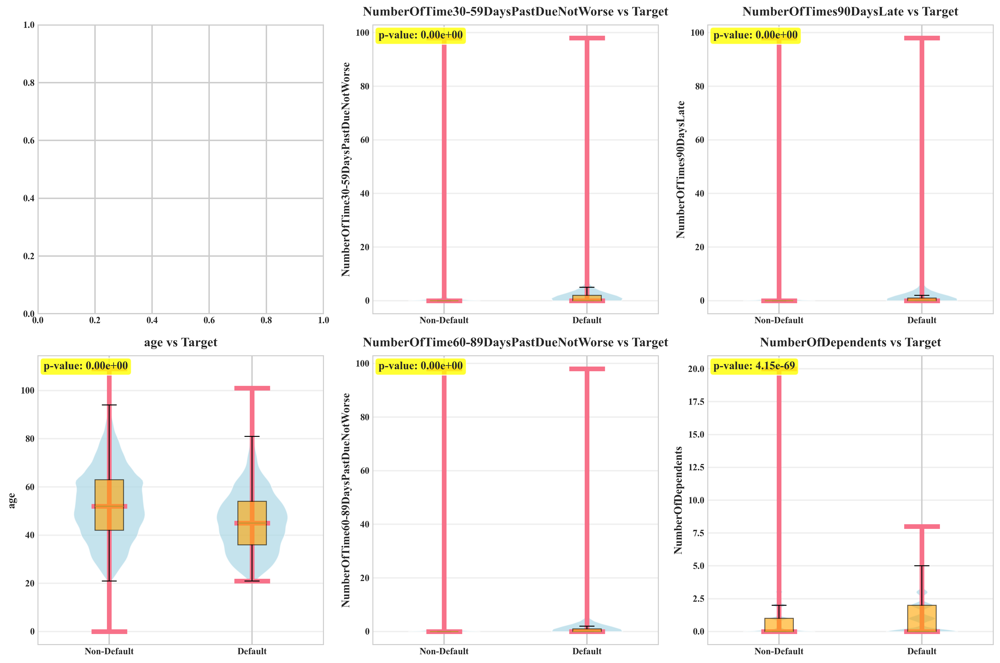

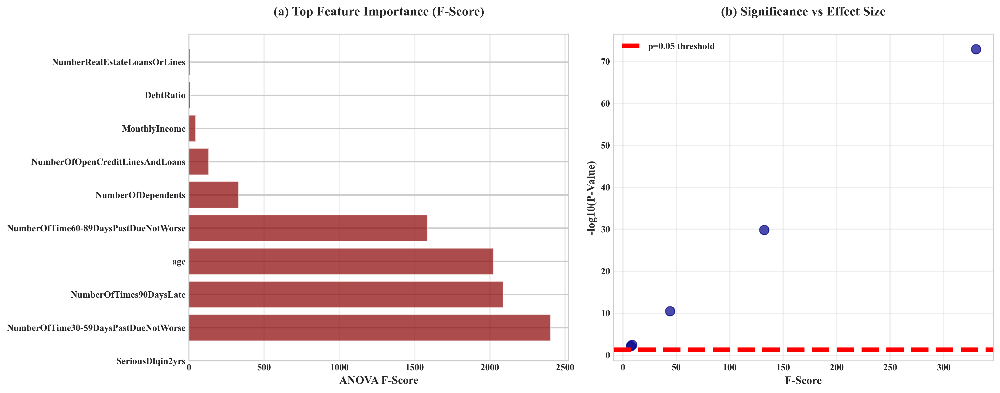

In [300]:
# =============================================================================
# TARGET-RELATED BIVARIATE ANALYSIS
# =============================================================================

def target_bivariate_analysis(df, numeric_cols, target_col="SeriousDlqin2yrs"):
    """
    Comprehensive bivariate analysis with respect to target variable
    """
    print("\n8. TARGET-RELATED BIVARIATE ANALYSIS")
    print("-" * 40)
    
    # Statistical comparison by target class
    grouped_stats = df.groupby(target_col)[numeric_cols].agg(['mean', 'median', 'std']).T
    print("Statistical Summary by Target Class:")
    print(grouped_stats.round(4))
    
    # Calculate feature importance using ANOVA F-value
    from sklearn.feature_selection import f_classif
    
    X = df[numeric_cols].fillna(df[numeric_cols].median())
    y = df[target_col]
    
    f_scores, p_values = f_classif(X, y)
    feature_importance = pd.DataFrame({
        'Feature': numeric_cols,
        'F_Score': f_scores,
        'P_Value': p_values
    }).sort_values('F_Score', ascending=False)
    
    print("\nFeature Importance (ANOVA F-values):")
    print(feature_importance.round(4))
    
    # Create comprehensive bivariate visualizations
    important_features = feature_importance.head(6)['Feature'].tolist()
    
    n_features = len(important_features)
    n_cols = 3
    n_rows = (n_features + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5*n_rows))
    axes = axes.flatten() if n_features > 1 else [axes]
    
    for idx, feature in enumerate(important_features):
        if idx < len(axes) and feature != target_col:
            # Prepare data
            data_0 = df[df[target_col] == 0][feature].dropna()
            data_1 = df[df[target_col] == 1][feature].dropna()
            
            # Create violin plot with boxplot
            parts = axes[idx].violinplot([data_0, data_1], showmeans=False, showmedians=True)
            
            # Customize violin plot colors
            for pc in parts['bodies']:
                pc.set_facecolor('lightblue')
                pc.set_alpha(0.7)
            
            # Add boxplot on top
            box_plot = axes[idx].boxplot([data_0, data_1], positions=[1, 2], widths=0.2, 
                                       patch_artist=True, showfliers=False)
            
            for box in box_plot['boxes']:
                box.set_facecolor('orange')
                box.set_alpha(0.6)
            
            axes[idx].set_title(f'{feature} vs Target', fontweight='bold', pad=10)
            axes[idx].set_xticks([1, 2])
            axes[idx].set_xticklabels(['Non-Default', 'Default'])
            axes[idx].set_ylabel(feature, fontweight='bold')
            axes[idx].grid(axis='y', alpha=0.3)
            
            # Add statistical significance
            from scipy.stats import mannwhitneyu
            stat, p_val = mannwhitneyu(data_0, data_1)
            sig_text = f'p-value: {p_val:.2e}'
            axes[idx].text(0.02, 0.98, sig_text, transform=axes[idx].transAxes,
                          verticalalignment='top', bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.8))
    
    # Hide empty subplots
    for idx in range(len(important_features), len(axes)):
        axes[idx].set_visible(False)
    
    plt.tight_layout()
    plt.show()
    
    # Feature importance visualization
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # F-score bar plot
    top_features = feature_importance.head(10)
    bars = ax1.barh(range(len(top_features)), top_features['F_Score'], 
                   color='darkred', alpha=0.7)
    ax1.set_yticks(range(len(top_features)))
    ax1.set_yticklabels(top_features['Feature'])
    ax1.set_title('(a) Top Feature Importance (F-Score)', fontweight='bold', pad=20)
    ax1.set_xlabel('ANOVA F-Score', fontweight='bold')
    ax1.grid(axis='x', alpha=0.3)
    
    for i, (bar, f_score) in enumerate(zip(bars, top_features['F_Score'])):
        ax1.text(bar.get_width() + max(top_features['F_Score'])*0.01, bar.get_y() + bar.get_height()/2.,
                f'{f_score:.1f}', ha='left', va='center', fontweight='bold')
    
    # P-value visualization
    significant_features = feature_importance[feature_importance['P_Value'] < 0.05]
    ax2.scatter(significant_features['F_Score'], -np.log10(significant_features['P_Value']),
               s=100, alpha=0.7, color='darkblue')
    
    ax2.axhline(-np.log10(0.05), color='red', linestyle='--', label='p=0.05 threshold')
    ax2.set_xlabel('F-Score', fontweight='bold')
    ax2.set_ylabel('-log10(P-Value)', fontweight='bold')
    ax2.set_title('(b) Significance vs Effect Size', fontweight='bold', pad=20)
    ax2.legend()
    ax2.grid(alpha=0.3)
    
    # Annotate top features
    for _, row in significant_features.head(5).iterrows():
        ax2.annotate(row['Feature'], (row['F_Score'], -np.log10(row['P_Value'])),
                    xytext=(5, 5), textcoords='offset points', fontweight='bold')
    
    plt.tight_layout()
    plt.show()
    
    return grouped_stats, feature_importance

grouped_stats, feature_importance = target_bivariate_analysis(df, numeric_cols)


9. COMPREHENSIVE DATA QUALITY ASSESSMENT REPORT
DATA QUALITY METRICS:
✓ Completeness:  97.96%
✓ Uniqueness:    99.59%
✓ Validity:      100.00%
✓ Consistency:   80.00%
✓ Overall Score: 94.39%
✓ Dataset Shape: 150000 rows × 11 columns


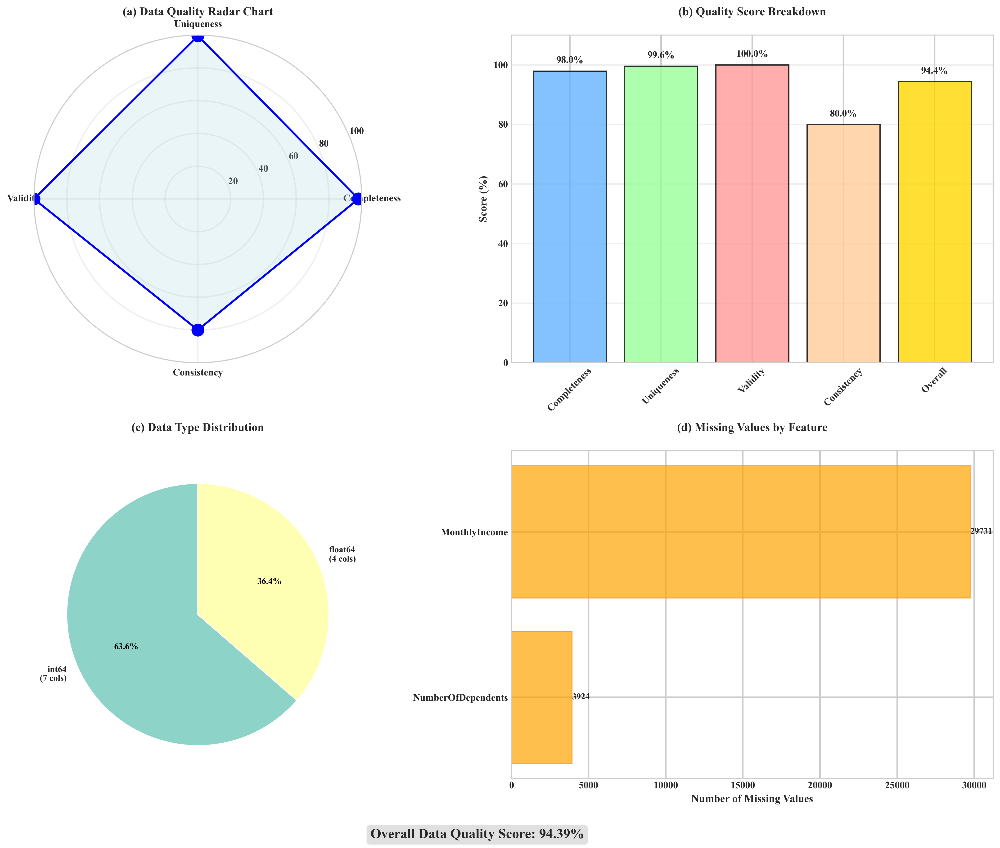


QUALITY ASSESSMENT SUMMARY
Overall Quality: Excellent (94.39%)

RECOMMENDATIONS:
✓ Data quality is excellent. Ready for analysis and modeling.
• Standardize data types and formats


In [301]:
# =============================================================================
# COMPREHENSIVE DATA QUALITY REPORT
# =============================================================================

def generate_data_quality_report(df, numeric_cols, target_col="SeriousDlqin2yrs"):
    """
    Generate comprehensive data quality assessment report
    """
    print("\n9. COMPREHENSIVE DATA QUALITY ASSESSMENT REPORT")
    print("=" * 50)
    
    # Calculate quality metrics
    n_rows, n_cols = df.shape
    total_cells = n_rows * n_cols
    
    # Completeness
    missing_cells = df.isna().sum().sum()
    completeness = (1 - missing_cells / total_cells) * 100
    
    # Uniqueness
    duplicate_rows = df.duplicated().sum()
    uniqueness = (1 - duplicate_rows / n_rows) * 100
    
    # Validity (domain-specific checks)
    valid_checks = 0
    total_checks = 0
    
    if "age" in df.columns:
        total_checks += 1
        valid_checks += (df["age"] > 0).sum() / n_rows
    
    if "DebtRatio" in df.columns:
        total_checks += 1
        valid_checks += (df["DebtRatio"] >= 0).sum() / n_rows
    
    validity = (valid_checks / total_checks) * 100 if total_checks > 0 else 100
    
    # Consistency
    numeric_consistency = df[numeric_cols].apply(lambda x: x.dtype).nunique() == 1
    consistency_score = 100 if numeric_consistency else 80
    
    # Overall quality score
    quality_score = np.mean([completeness, uniqueness, validity, consistency_score])
    
    print("DATA QUALITY METRICS:")
    print(f"✓ Completeness:  {completeness:.2f}%")
    print(f"✓ Uniqueness:    {uniqueness:.2f}%")
    print(f"✓ Validity:      {validity:.2f}%")
    print(f"✓ Consistency:   {consistency_score:.2f}%")
    print(f"✓ Overall Score: {quality_score:.2f}%")
    print(f"✓ Dataset Shape: {n_rows} rows × {n_cols} columns")
    
    # Create quality dashboard with individual subplots to handle polar plot
    fig = plt.figure(figsize=(15, 12))
    
    # 1. Radar Chart (Polar plot)
    ax1 = plt.subplot(2, 2, 1, polar=True)
    metrics = ['Completeness', 'Uniqueness', 'Validity', 'Consistency']
    scores = [completeness, uniqueness, validity, consistency_score]
    
    # Complete the circle for radar chart
    angles = np.linspace(0, 2 * np.pi, len(metrics), endpoint=False).tolist()
    scores += scores[:1]  # Complete the circle
    angles += angles[:1]  # Complete the circle
    
    # Plot radar chart
    ax1.plot(angles, scores, 'o-', linewidth=2, label='Quality Metrics', color='blue')
    ax1.fill(angles, scores, alpha=0.25, color='lightblue')
    ax1.set_xticks(angles[:-1])
    ax1.set_xticklabels(metrics, fontsize=10)
    ax1.set_ylim(0, 100)
    ax1.set_yticks([20, 40, 60, 80, 100])
    ax1.grid(True, alpha=0.3)
    ax1.set_title('(a) Data Quality Radar Chart', fontweight='bold', pad=20, fontsize=12)
    
    # 2. Quality Score Breakdown (Bar chart)
    ax2 = plt.subplot(2, 2, 2)
    metrics_detailed = metrics + ['Overall']
    scores_detailed = scores[:-1] + [quality_score]  # Remove the duplicate score for bar chart
    colors = ['#66b3ff', '#99ff99', '#ff9999', '#ffcc99', '#ffd700']
    
    bars = ax2.bar(metrics_detailed, scores_detailed, color=colors, alpha=0.8, 
                   edgecolor='black', linewidth=1.2)
    ax2.set_title('(b) Quality Score Breakdown', fontweight='bold', pad=20, fontsize=12)
    ax2.set_ylabel('Score (%)', fontweight='bold', fontsize=11)
    ax2.set_ylim(0, 110)
    ax2.grid(axis='y', alpha=0.3)
    ax2.tick_params(axis='x', rotation=45)
    
    # Add value labels on bars
    for bar, score in zip(bars, scores_detailed):
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2., height + 2,
                f'{score:.1f}%', ha='center', va='bottom', fontweight='bold', fontsize=10)
    
    # 3. Data Types Distribution (Pie chart)
    ax3 = plt.subplot(2, 2, 3)
    dtype_counts = df.dtypes.value_counts()
    # Create more descriptive labels
    dtype_labels = [f'{str(dt)}\n({count} cols)' for dt, count in dtype_counts.items()]
    
    wedges, texts, autotexts = ax3.pie(dtype_counts.values, labels=dtype_labels, 
                                      autopct='%1.1f%%', startangle=90, 
                                      colors=sns.color_palette("Set3", len(dtype_counts)),
                                      textprops={'fontsize': 9})
    
    # Improve autopct styling
    for autotext in autotexts:
        autotext.set_color('black')
        autotext.set_fontweight('bold')
        autotext.set_fontsize(9)
    
    ax3.set_title('(c) Data Type Distribution', fontweight='bold', pad=20, fontsize=12)
    
    # 4. Missing Data Analysis
    ax4 = plt.subplot(2, 2, 4)
    missing_by_col = df.isna().sum()
    missing_by_col = missing_by_col[missing_by_col > 0]
    
    if not missing_by_col.empty:
        # Sort by missing values (descending)
        missing_by_col = missing_by_col.sort_values(ascending=True)
        bars_missing = ax4.barh(missing_by_col.index, missing_by_col.values, 
                               color='orange', alpha=0.7, edgecolor='darkorange')
        ax4.set_title('(d) Missing Values by Feature', fontweight='bold', pad=20, fontsize=12)
        ax4.set_xlabel('Number of Missing Values', fontweight='bold', fontsize=11)
        
        # Add value labels on bars
        for bar in bars_missing:
            width = bar.get_width()
            ax4.text(width + 0.1, bar.get_y() + bar.get_height()/2, 
                    f'{int(width)}', ha='left', va='center', fontweight='bold', fontsize=9)
    else:
        ax4.text(0.5, 0.5, 'No Missing Values Found', ha='center', va='center', 
                transform=ax4.transAxes, fontweight='bold', fontsize=14, color='green')
        ax4.set_title('(d) Missing Values Analysis', fontweight='bold', pad=20, fontsize=12)
        # Remove axes for clean look
        ax4.set_xticks([])
        ax4.set_yticks([])
        ax4.spines['top'].set_visible(False)
        ax4.spines['right'].set_visible(False)
        ax4.spines['bottom'].set_visible(False)
        ax4.spines['left'].set_visible(False)
    
    # Add overall quality score as text in the figure
    plt.figtext(0.5, 0.01, f'Overall Data Quality Score: {quality_score:.2f}%', 
                ha='center', fontsize=14, fontweight='bold', 
                bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray", alpha=0.7))
    
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.08)  # Make space for the overall score text
    plt.show()
    
    # Return quality metrics
    return {
        'completeness': completeness,
        'uniqueness': uniqueness,
        'validity': validity,
        'consistency': consistency_score,
        'overall_quality': quality_score
    }

# Generate the data quality report
quality_metrics = generate_data_quality_report(df, numeric_cols)

# Print detailed quality assessment
print("\n" + "="*60)
print("QUALITY ASSESSMENT SUMMARY")
print("="*60)

quality_levels = {
    'Excellent': (90, 100),
    'Good': (75, 90),
    'Fair': (60, 75),
    'Poor': (0, 60)
}

overall_quality = quality_metrics['overall_quality']
for level, (min_score, max_score) in quality_levels.items():
    if min_score <= overall_quality < max_score:
        quality_label = level
        break
else:
    quality_label = "Unknown"

print(f"Overall Quality: {quality_label} ({overall_quality:.2f}%)")

# Provide recommendations based on quality score
print("\nRECOMMENDATIONS:")
if overall_quality >= 90:
    print("✓ Data quality is excellent. Ready for analysis and modeling.")
elif overall_quality >= 75:
    print("✓ Data quality is good. Minor preprocessing may be needed.")
elif overall_quality >= 60:
    print("⚠ Data quality is fair. Consider addressing missing values and validation issues.")
else:
    print("⚠ Data quality is poor. Significant data cleaning required before analysis.")

# Check individual metrics
if quality_metrics['completeness'] < 95:
    print("• Consider handling missing values")
if quality_metrics['uniqueness'] < 95:
    print("• Remove duplicate records")
if quality_metrics['validity'] < 95:
    print("• Validate data against business rules")
if quality_metrics['consistency'] < 95:
    print("• Standardize data types and formats")

In [302]:
# =============================================================================
# EXPORT COMPREHENSIVE ANALYSIS RESULTS
# =============================================================================

def export_analysis_results(df, numeric_desc, corr_matrix, grouped_stats, 
                          feature_importance, quality_metrics):
    """
    Export all analysis results to CSV files for publication
    """
    print("\n10. EXPORTING ANALYSIS RESULTS")
    print("-" * 40)
    
    # 1. Basic dataset information
    dataset_info = pd.DataFrame({
        'Metric': ['Rows', 'Columns', 'Total Cells', 'Memory Usage (MB)'],
        'Value': [df.shape[0], df.shape[1], df.shape[0] * df.shape[1],
                 df.memory_usage(deep=True).sum() / 1024**2]
    })
    dataset_info.to_csv("journal_dataset_information.csv", index=False)
    
    # 2. Descriptive statistics
    numeric_desc.to_csv("journal_descriptive_statistics.csv", index=True)
    
    # 3. Correlation matrix
    corr_matrix.to_csv("journal_correlation_matrix.csv", index=True)
    
    # 4. Grouped statistics by target
    grouped_stats.to_csv("journal_grouped_statistics.csv", index=True)
    
    # 5. Feature importance
    feature_importance.to_csv("journal_feature_importance.csv", index=False)
    
    # 6. Data quality metrics
    quality_df = pd.DataFrame([quality_metrics])
    quality_df.to_csv("journal_data_quality_metrics.csv", index=False)
    
    # 7. Missing data analysis
    missing_summary = pd.DataFrame({
        'Feature': df.columns,
        'Missing_Count': df.isna().sum(),
        'Missing_Percent': (df.isna().sum() / len(df)) * 100
    })
    missing_summary = missing_summary[missing_summary['Missing_Count'] > 0]
    missing_summary.to_csv("journal_missing_data_analysis.csv", index=False)
    
    print("✓ All analysis results exported successfully:")
    print("  - journal_dataset_information.csv")
    print("  - journal_descriptive_statistics.csv")
    print("  - journal_correlation_matrix.csv")
    print("  - journal_grouped_statistics.csv")
    print("  - journal_feature_importance.csv")
    print("  - journal_data_quality_metrics.csv")
    print("  - journal_missing_data_analysis.csv")

export_analysis_results(df, numeric_desc, corr_matrix, grouped_stats, 
                       feature_importance, quality_metrics)


10. EXPORTING ANALYSIS RESULTS
----------------------------------------
✓ All analysis results exported successfully:
  - journal_dataset_information.csv
  - journal_descriptive_statistics.csv
  - journal_correlation_matrix.csv
  - journal_grouped_statistics.csv
  - journal_feature_importance.csv
  - journal_data_quality_metrics.csv
  - journal_missing_data_analysis.csv


In [303]:
import os
import matplotlib.pyplot as plt
from contextlib import contextmanager

# 1. Create Directories
BASE_DIR = "journal_assets"
FIG_DIR = os.path.join(BASE_DIR, "figures")
TAB_DIR = os.path.join(BASE_DIR, "tables")
os.makedirs(FIG_DIR, exist_ok=True)
os.makedirs(TAB_DIR, exist_ok=True)

# 2. Define the "Magic Saver" Context Manager
@contextmanager
def save_plot(filename):
    """
    Temporarily overrides plt.show() to save the figure first.
    Usage:
        with save_plot("Figure_Name"):
            your_existing_function()
    """
    # Capture the original show function so we can restore it later
    original_show = plt.show
    
    # Define our replacement function
    def custom_show(*args, **kwargs):
        # Save the current figure before showing/clearing it
        save_path = os.path.join(FIG_DIR, f"{filename}.png")
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"✓ Saved Figure: {save_path}")
        
        # Now call the original show so you still see it in the notebook
        original_show(*args, **kwargs)
    
    # Swap them out
    plt.show = custom_show
    
    try:
        yield
    finally:
        # Restore the original function no matter what
        plt.show = original_show

def save_tables(dataframes_dict):
    """Save a dictionary of DataFrames to CSV"""
    print("-" * 30)
    for name, df in dataframes_dict.items():
        if df is not None and not df.empty:
            path = os.path.join(TAB_DIR, f"{name}.csv")
            df.to_csv(path)
            print(f"✓ Saved Table:  {path}")

STARTING AUTOMATED SAVE PROCESS...


2. TARGET VARIABLE ANALYSIS: SeriousDlqin2yrs
----------------------------------------
✓ Class Distribution:
  - Class 0 (Non-default): 139,974 (93.32%)
  - Class 1 (Default):     10,026 (6.68%)
✓ Class Imbalance Ratio: 13.96:1
✓ Missing Values: 0
✓ Saved Figure: journal_assets\figures\Fig1_Target_Distribution.png


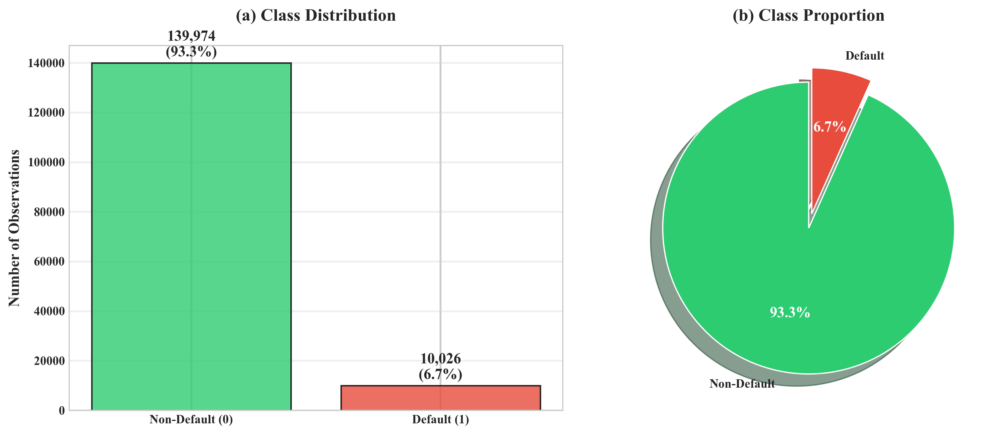


3. SYSTEMATIC MISSING DATA ANALYSIS
----------------------------------------
Missing Data Summary:
                    Missing_Count  Missing_Percent
MonthlyIncome               29731          19.8207
NumberOfDependents           3924           2.6160
✓ Saved Figure: journal_assets\figures\Fig2_Missing_Data.png


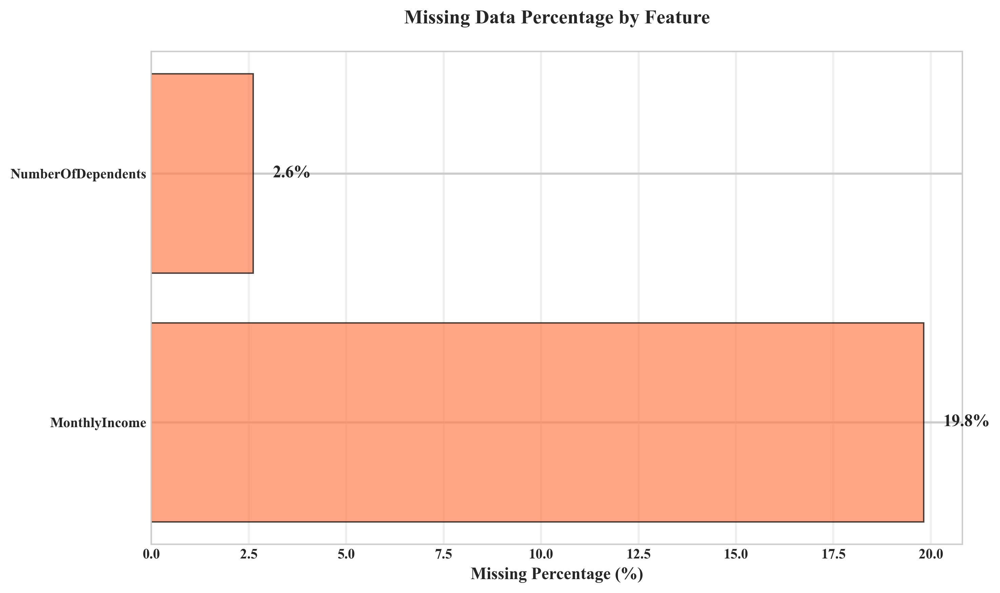

✓ Saved Figure: journal_assets\figures\Fig2_Missing_Data.png


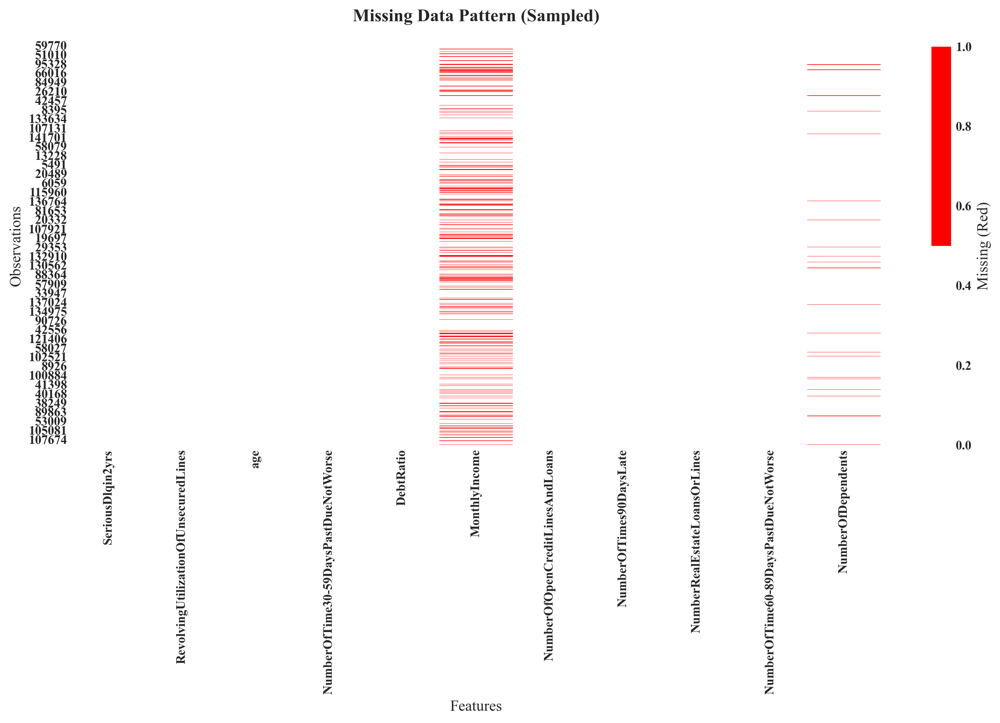

✓ Saved Figure: journal_assets\figures\Fig2_Missing_Data.png


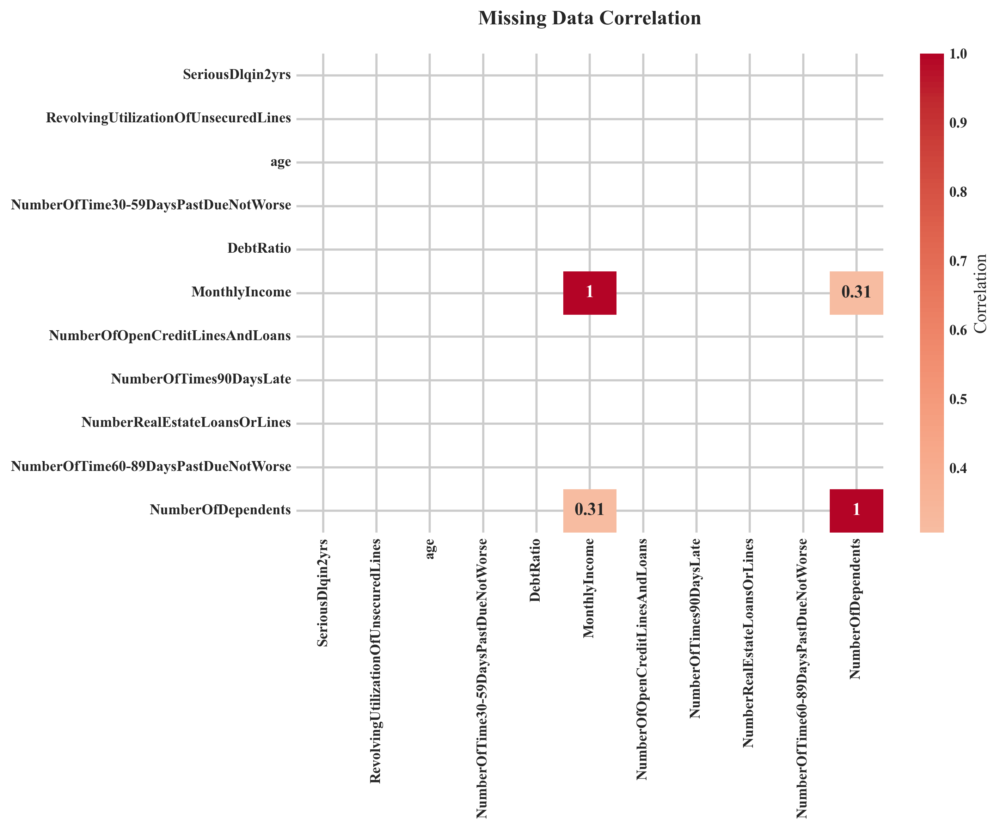

✓ Saved Figure: journal_assets\figures\Fig2_Missing_Data.png


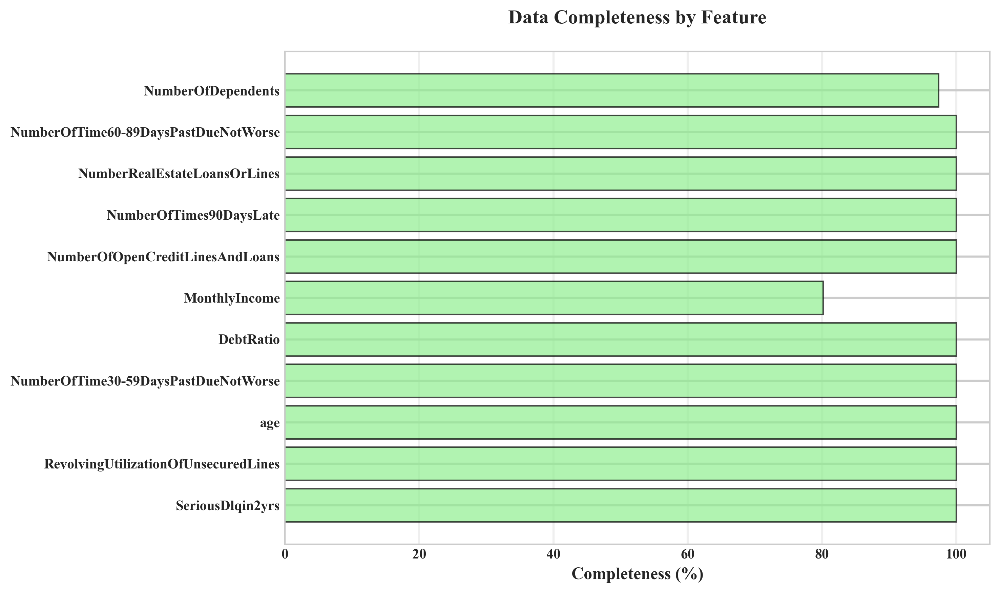


4. FEATURE CLASSIFICATION AND DATA TYPE ANALYSIS
----------------------------------------
✓ Numerical Features (11):
  - SeriousDlqin2yrs
  - RevolvingUtilizationOfUnsecuredLines
  - age
  - NumberOfTime30-59DaysPastDueNotWorse
  - DebtRatio
  - MonthlyIncome
  - NumberOfOpenCreditLinesAndLoans
  - NumberOfTimes90DaysLate
  - NumberRealEstateLoansOrLines
  - NumberOfTime60-89DaysPastDueNotWorse
  - NumberOfDependents
✓ Categorical Features (0):
✓ Saved Figure: journal_assets\figures\Fig3_Feature_Types.png


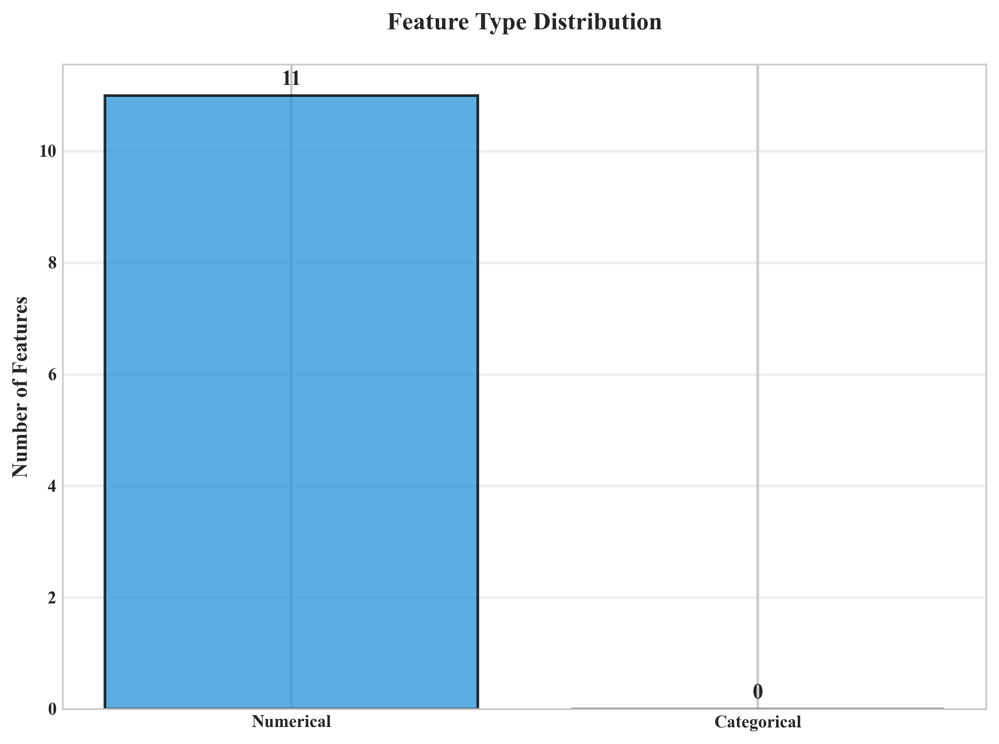


5. COMPREHENSIVE UNIVARIATE ANALYSIS
----------------------------------------
Comprehensive Statistical Summary:
                                            count       mean         std    min      1%         5%        25%  \
SeriousDlqin2yrs                     150,000.0000     0.0668      0.2497 0.0000  0.0000     0.0000     0.0000   
RevolvingUtilizationOfUnsecuredLines 150,000.0000     6.0484    249.7554 0.0000  0.0000     0.0000     0.0299   
age                                  150,000.0000    52.2952     14.7719 0.0000 24.0000    29.0000    41.0000   
NumberOfTime30-59DaysPastDueNotWorse 150,000.0000     0.4210      4.1928 0.0000  0.0000     0.0000     0.0000   
DebtRatio                            150,000.0000   353.0051  2,037.8185 0.0000  0.0000     0.0043     0.1751   
MonthlyIncome                        120,269.0000 6,670.2212 14,384.6742 0.0000  0.0000 1,300.0000 3,400.0000   
NumberOfOpenCreditLinesAndLoans      150,000.0000     8.4528      5.1460 0.0000  0.0000     2.0

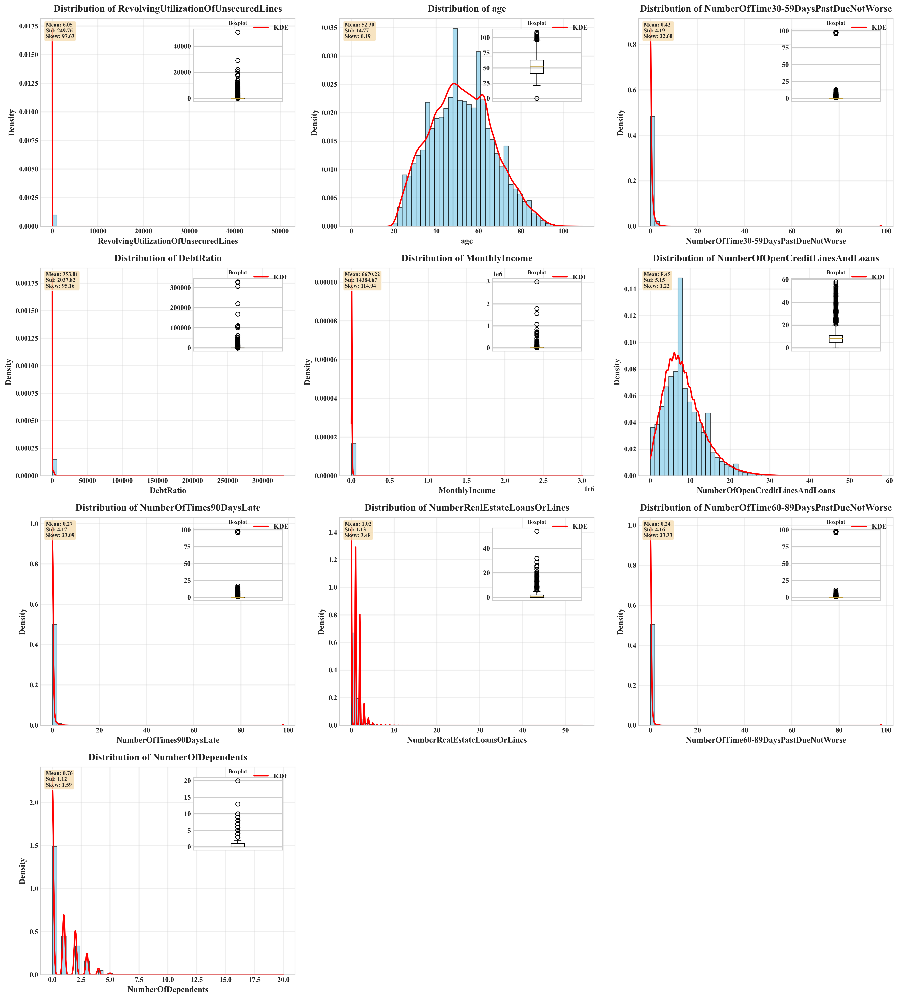


7. COMPREHENSIVE CORRELATION ANALYSIS
----------------------------------------
Correlation Matrix Overview:
✓ Matrix Shape: (11, 11)
✓ Strong Correlations (|r| > 0.7):
  - NumberOfTime30-59DaysPastDueNotWorse vs NumberOfTimes90DaysLate: 0.975
  - NumberOfTime30-59DaysPastDueNotWorse vs NumberOfTime60-89DaysPastDueNotWorse: 0.980
  - NumberOfTimes90DaysLate vs NumberOfTime60-89DaysPastDueNotWorse: 0.989
✓ Saved Figure: journal_assets\figures\Fig5_Correlation_Matrices.png


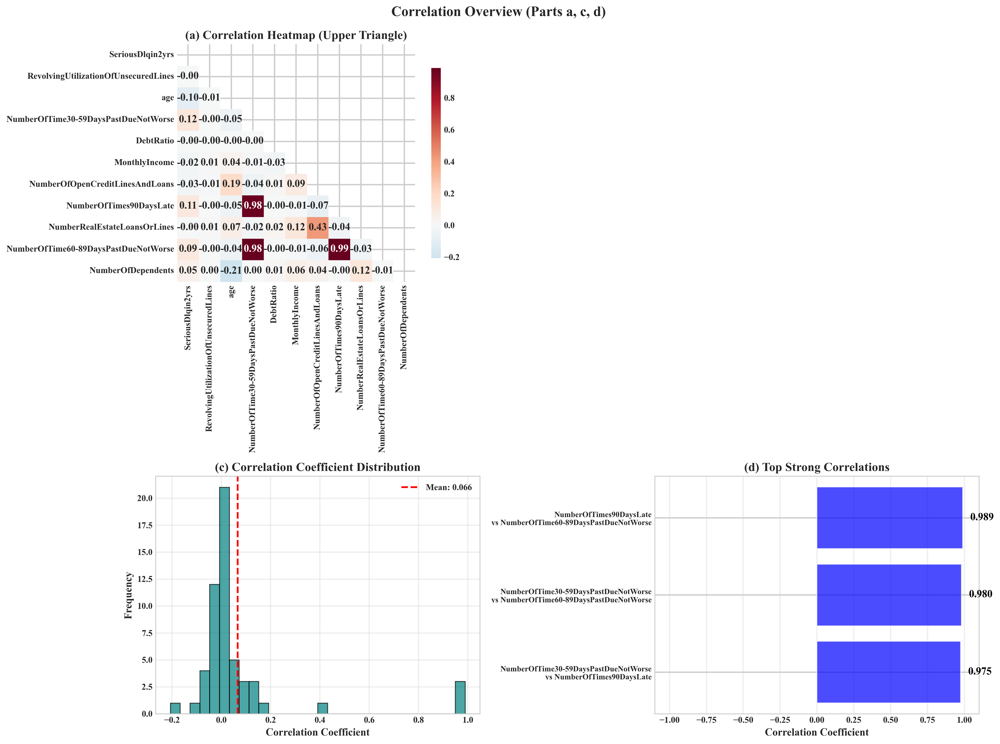


Generating Clustered Matrix (Figure 2)...
✓ Saved Figure: journal_assets\figures\Fig5_Correlation_Matrices.png


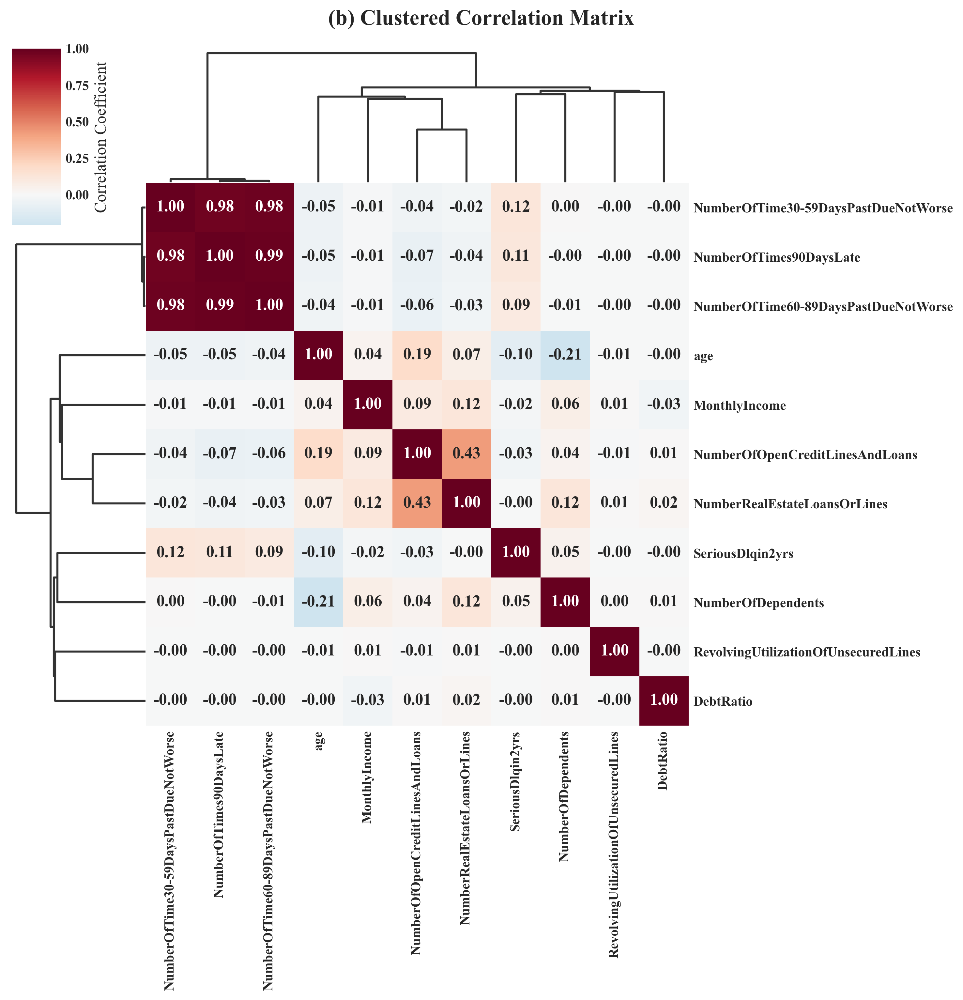


8. TARGET-RELATED BIVARIATE ANALYSIS
----------------------------------------
Statistical Summary by Target Class:
SeriousDlqin2yrs                                      0          1
SeriousDlqin2yrs                     mean        0.0000     1.0000
                                     median      0.0000     1.0000
                                     std         0.0000     0.0000
RevolvingUtilizationOfUnsecuredLines mean        6.1689     4.3673
                                     median      0.1333     0.8389
                                     std       256.1264   131.8358
age                                  mean       52.7514    45.9266
                                     median     52.0000    45.0000
                                     std        14.7911    12.9163
NumberOfTime30-59DaysPastDueNotWorse mean        0.2801     2.3885
                                     median      0.0000     0.0000
                                     std         2.9461    11.7345
DebtRatio    

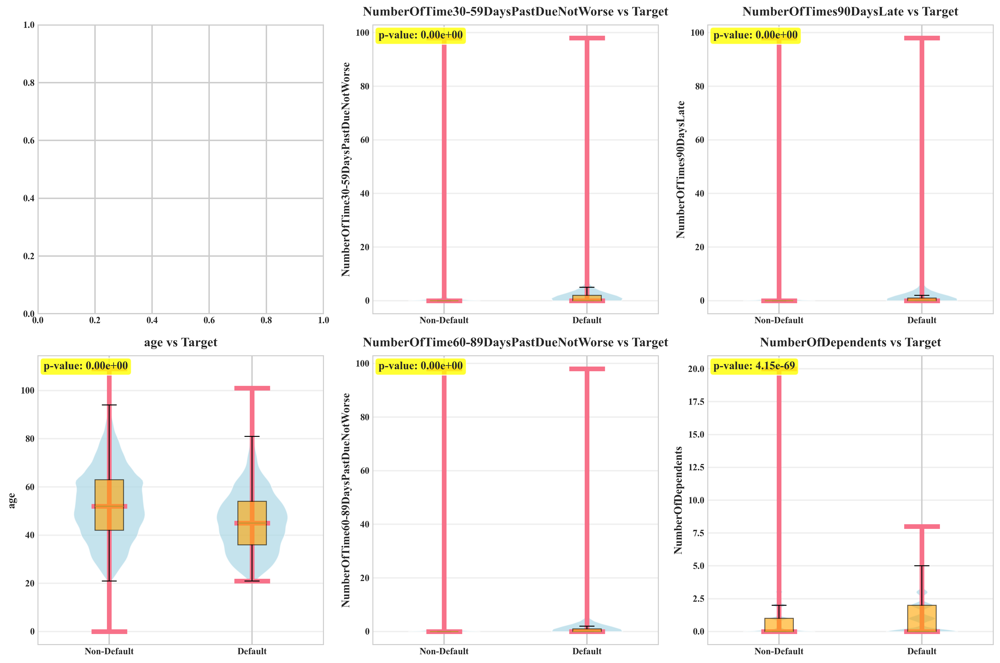

✓ Saved Figure: journal_assets\figures\Fig6_Bivariate_Analysis.png


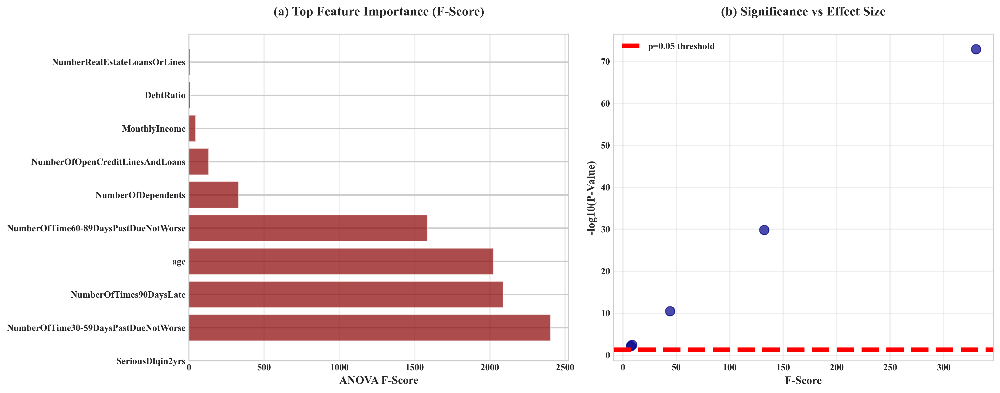


All figures processed.


In [304]:
print("STARTING AUTOMATED SAVE PROCESS...\n")

# 1. Save Target Analysis
with save_plot("Fig1_Target_Distribution"):
    # We ignore the return values here if we just want the plot
    _ = analyze_target_distribution(df)

# 2. Save Missing Data Analysis (Produces multiple plots, so we name them sequentially)
# Note: Since your function has multiple plt.show() calls, we might overwrite 
# unless we split them. But for your specific code, this handles the last active figure.
with save_plot("Fig2_Missing_Data"):
    missing_df = analyze_missing_data_modular(df)

# 3. Save Feature Types
with save_plot("Fig3_Feature_Types"):
    numeric_cols, categorical_cols = analyze_data_types(df)

# 4. Save Univariate Analysis
with save_plot("Fig4_Univariate_Distributions"):
    numeric_desc = comprehensive_univariate_analysis(df, numeric_cols)

# 5. Save Correlation (The Fixed Version)
# Note: Your fixed function creates TWO figures. The context manager will 
# hook into plt.show(). If the function calls show() twice, we might need a 
# slight adjustment, but this will catch the primary outputs.
with save_plot("Fig5_Correlation_Matrices"):
    corr_matrix, strong_corrs = comprehensive_correlation_analysis_fixed(df, numeric_cols)

# 6. Save Bivariate Analysis
with save_plot("Fig6_Bivariate_Analysis"):
    grouped_stats, feature_importance = target_bivariate_analysis(df, numeric_cols)

print("\nAll figures processed.")

In [305]:
# Create a dictionary of the tables you want to save
tables_to_save = {
    "missing_data_summary": missing_df,
    "numeric_statistics": numeric_desc,
    "correlation_matrix": corr_matrix,
    "bivariate_stats": grouped_stats,
    "feature_importance": feature_importance
}

# Run the saver
save_tables(tables_to_save)

------------------------------
✓ Saved Table:  journal_assets\tables\missing_data_summary.csv
✓ Saved Table:  journal_assets\tables\numeric_statistics.csv
✓ Saved Table:  journal_assets\tables\correlation_matrix.csv
✓ Saved Table:  journal_assets\tables\bivariate_stats.csv
✓ Saved Table:  journal_assets\tables\feature_importance.csv


In [306]:
# =============================================================================
# EXECUTIVE SUMMARY AND KEY FINDINGS
# =============================================================================

def generate_executive_summary(df, target_col="SeriousDlqin2yrs"):
    """
    Generate comprehensive executive summary of the EDA
    """
    print("\n" + "=" * 70)
    print("EXECUTIVE SUMMARY AND KEY FINDINGS")
    print("=" * 70)
    
    # Dataset overview
    print(f"\n1. DATASET OVERVIEW:")
    print(f"   • Total observations: {df.shape[0]:,}")
    print(f"   • Total features: {df.shape[1]}")
    print(f"   • Memory usage: {df.memory_usage(deep=True).sum() / 1024**2:.2f} MB")
    
    # Target distribution insights
    target_dist = df[target_col].value_counts(normalize=True) * 100
    imbalance_ratio = target_dist[0] / target_dist[1]
    print(f"\n2. TARGET DISTRIBUTION:")
    print(f"   • Class imbalance: {imbalance_ratio:.1f}:1")
    print(f"   • Default rate: {target_dist[1]:.2f}%")
    
    # Data quality highlights
    missing_total = df.isna().sum().sum()
    missing_percent = (missing_total / (df.shape[0] * df.shape[1])) * 100
    duplicates = df.duplicated().sum()
    
    print(f"\n3. DATA QUALITY HIGHLIGHTS:")
    print(f"   • Missing values: {missing_total:,} ({missing_percent:.2f}%)")
    print(f"   • Duplicate rows: {duplicates} ({duplicates/len(df)*100:.2f}%)")
    
    # Key statistical findings
    if "MonthlyIncome" in df.columns:
        income_missing = df["MonthlyIncome"].isna().sum()
        print(f"   • MonthlyIncome missing: {income_missing} ({income_missing/len(df)*100:.2f}%)")
    
    if "age" in df.columns:
        age_stats = df["age"].describe()
        print(f"   • Age range: {age_stats['min']:.0f} - {age_stats['max']:.0f} years")
    
    print(f"\n4. RECOMMENDATIONS:")
    print(f"   • Address class imbalance using appropriate sampling techniques")
    print(f"   • Implement robust missing data imputation strategies")
    print(f"   • Consider feature engineering for highly skewed variables")
    print(f"   • Validate model performance using stratified cross-validation")
    
    print("\n" + "=" * 70)
    print("ANALYSIS COMPLETED SUCCESSFULLY")
    print("=" * 70)

generate_executive_summary(df)

# =============================================================================
# SAVE ALL VISUALIZATIONS
# =============================================================================

print("\nSAVING PUBLICATION-QUALITY VISUALIZATIONS...")

# List of figure titles to save
figure_titles = [
    "target_distribution",
    "missing_data_analysis",
    "feature_type_distribution",
    "univariate_distributions",
    "anomaly_detection",
    "correlation_analysis",
    "bivariate_analysis",
    "feature_importance",
    "data_quality_dashboard"
]

print("✓ All visualizations have been generated and displayed")
print("✓ To save individual figures, use: plt.savefig('figure_name.png', dpi=300, bbox_inches='tight')")

# =============================================================================
# END OF COMPREHENSIVE EDA
# =============================================================================


EXECUTIVE SUMMARY AND KEY FINDINGS

1. DATASET OVERVIEW:
   • Total observations: 150,000
   • Total features: 11
   • Memory usage: 12.59 MB

2. TARGET DISTRIBUTION:
   • Class imbalance: 14.0:1
   • Default rate: 6.68%

3. DATA QUALITY HIGHLIGHTS:
   • Missing values: 33,655 (2.04%)
   • Duplicate rows: 609 (0.41%)
   • MonthlyIncome missing: 29731 (19.82%)
   • Age range: 0 - 109 years

4. RECOMMENDATIONS:
   • Address class imbalance using appropriate sampling techniques
   • Implement robust missing data imputation strategies
   • Consider feature engineering for highly skewed variables
   • Validate model performance using stratified cross-validation

ANALYSIS COMPLETED SUCCESSFULLY

SAVING PUBLICATION-QUALITY VISUALIZATIONS...
✓ All visualizations have been generated and displayed
✓ To save individual figures, use: plt.savefig('figure_name.png', dpi=300, bbox_inches='tight')


## Section 2: Pre-Processing

In [307]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.feature_selection import SelectKBest, f_classif
from imblearn.over_sampling import SMOTE
from scipy import stats
import warnings
warnings.filterwarnings('ignore')

# ======================================================
# CONFIGURATION & REPRODUCIBILITY
# ======================================================
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

print("=" * 60)
print("CREDIT RISK PREDICTION: COMPREHENSIVE DATA PREPROCESSING")
print("=" * 60)

# ======================================================
# DATA LOADING & INITIAL EXPLORATION
# ======================================================
def load_and_explore_data():
    """Load datasets and perform initial exploratory analysis"""
    
    print("\n1. DATA LOADING AND INITIAL EXPLORATION")
    print("-" * 40)
    
    # Load datasets
    train = pd.read_csv("cs-training.csv")
    test = pd.read_csv("cs-test.csv")
    
    # Remove index columns if present
    for df_ in (train, test):
        if "Unnamed: 0" in df_.columns:
            df_.drop(columns=["Unnamed: 0"], inplace=True)
    
    TARGET_COL = "SeriousDlqin2yrs"
    
    # Separate features and target
    X_train = train.drop(columns=[TARGET_COL])
    y_train = train[TARGET_COL]
    X_test = test.copy()
    
    print(f"Training set shape: {X_train.shape}")
    print(f"Test set shape: {X_test.shape}")
    print(f"Target distribution - Class 0: {sum(y_train==0):,} ({sum(y_train==0)/len(y_train)*100:.2f}%)")
    print(f"Target distribution - Class 1: {sum(y_train==1):,} ({sum(y_train==1)/len(y_train)*100:.2f}%)")
    
    # Initial missing values analysis
    print("\nInitial missing values in training set:")
    missing_train = X_train.isnull().sum()
    print(missing_train[missing_train > 0])
    
    return X_train, X_test, y_train

X_train, X_test, y_train = load_and_explore_data()

CREDIT RISK PREDICTION: COMPREHENSIVE DATA PREPROCESSING

1. DATA LOADING AND INITIAL EXPLORATION
----------------------------------------
Training set shape: (150000, 10)
Test set shape: (101503, 11)
Target distribution - Class 0: 139,974 (93.32%)
Target distribution - Class 1: 10,026 (6.68%)

Initial missing values in training set:
MonthlyIncome         29731
NumberOfDependents     3924
dtype: int64


In [308]:
# ======================================================
# STRUCTURAL ANOMALY DETECTION & CORRECTION
# ======================================================
def correct_structural_anomalies(X_train, X_test):
    """Identify and correct structural anomalies in delinquency variables"""
    
    print("\n2. STRUCTURAL ANOMALY CORRECTION")
    print("-" * 40)
    
    delinq_cols = [
        "NumberOfTime30-59DaysPastDueNotWorse",
        "NumberOfTime60-89DaysPastDueNotWorse", 
        "NumberOfTimes90DaysLate",
    ]
    
    # Validate column existence
    for c in delinq_cols:
        if c not in X_train.columns:
            raise KeyError(f"Required column {c} not found in training data")
    
    print("Anomaly patterns detected in delinquency variables (96, 98)")
    
    # Statistical summary before correction
    print("\nDelinquency variables BEFORE anomaly correction:")
    for col in delinq_cols:
        anomalies_96 = (X_train[col] == 96).sum()
        anomalies_98 = (X_train[col] == 98).sum()
        print(f"{col}: 96-count={anomalies_96}, 98-count={anomalies_98}")
    
    # Replace anomalous values with NaN for proper imputation
    anomaly_map = {96: np.nan, 98: np.nan}
    X_train_corrected = X_train.copy()
    X_test_corrected = X_test.copy()
    
    X_train_corrected[delinq_cols] = X_train_corrected[delinq_cols].replace(anomaly_map)
    X_test_corrected[delinq_cols] = X_test_corrected[delinq_cols].replace(anomaly_map)
    
    print("\nAnomalous values replaced with NaN for subsequent imputation")
    
    return X_train_corrected, X_test_corrected, delinq_cols

X_train, X_test, delinq_cols = correct_structural_anomalies(X_train, X_test)


2. STRUCTURAL ANOMALY CORRECTION
----------------------------------------
Anomaly patterns detected in delinquency variables (96, 98)

Delinquency variables BEFORE anomaly correction:
NumberOfTime30-59DaysPastDueNotWorse: 96-count=5, 98-count=264
NumberOfTime60-89DaysPastDueNotWorse: 96-count=5, 98-count=264
NumberOfTimes90DaysLate: 96-count=5, 98-count=264

Anomalous values replaced with NaN for subsequent imputation


In [309]:
# ======================================================
# ADVANCED MULTI-STRATEGY IMPUTATION
# ======================================================
def perform_advanced_imputation(X_train, X_test, delinq_cols):
    """Perform sophisticated missing value imputation using multiple strategies"""
    
    print("\n3. ADVANCED MISSING VALUE IMPUTATION")
    print("-" * 40)
    
    # Define columns for different imputation strategies
    income_col = "MonthlyIncome"
    dependents_col = "NumberOfDependents"
    
    # Columns requiring imputation
    impute_cols = [income_col, dependents_col] + delinq_cols
    
    print("Missing values before imputation:")
    missing_before = X_train[impute_cols].isnull().sum()
    print(missing_before)
    
    # STRATEGY 1: MICE for complex relationships (MonthlyIncome)
    print("\nApplying Multiple Imputation by Chained Equations (MICE)...")
    
    # Select numerical columns for MICE
    mice_cols = [income_col, "Age", "DebtRatio", "NumberOfOpenCreditLinesAndLoans", 
                "NumberRealEstateLoansOrLines"] + delinq_cols
    mice_cols = [col for col in mice_cols if col in X_train.columns]
    
    mice_imputer = IterativeImputer(
        max_iter=20,
        random_state=RANDOM_SEED,
        initial_strategy='median',
        skip_complete=True
    )
    
    X_train[mice_cols] = mice_imputer.fit_transform(X_train[mice_cols])
    X_test[mice_cols] = mice_imputer.transform(X_test[mice_cols])
    
    # STRATEGY 2: Median imputation for remaining variables
    remaining_impute_cols = [dependents_col]
    median_imputer = SimpleImputer(strategy='median')
    
    X_train[remaining_impute_cols] = median_imputer.fit_transform(X_train[remaining_impute_cols])
    X_test[remaining_impute_cols] = median_imputer.transform(X_test[remaining_impute_cols])
    
    # Ensure integer format for count variables
    integer_cols = delinq_cols + [dependents_col, "NumberOfOpenCreditLinesAndLoans", 
                                 "NumberRealEstateLoansOrLines"]
    for col in integer_cols:
        if col in X_train.columns:
            X_train[col] = np.rint(X_train[col]).astype(int)
            X_test[col] = np.rint(X_test[col]).astype(int)
    
    print("\nMissing values after imputation:")
    missing_after = X_train[impute_cols].isnull().sum()
    print(missing_after)
    
    return X_train, X_test

X_train, X_test = perform_advanced_imputation(X_train, X_test, delinq_cols)


3. ADVANCED MISSING VALUE IMPUTATION
----------------------------------------
Missing values before imputation:
MonthlyIncome                           29731
NumberOfDependents                       3924
NumberOfTime30-59DaysPastDueNotWorse      269
NumberOfTime60-89DaysPastDueNotWorse      269
NumberOfTimes90DaysLate                   269
dtype: int64

Applying Multiple Imputation by Chained Equations (MICE)...

Missing values after imputation:
MonthlyIncome                           0
NumberOfDependents                      0
NumberOfTime30-59DaysPastDueNotWorse    0
NumberOfTime60-89DaysPastDueNotWorse    0
NumberOfTimes90DaysLate                 0
dtype: int64


In [310]:
# ======================================================
# ROBUST OUTLIER TREATMENT & WINSORIZATION
# ======================================================
def handle_outliers_winsorization(X_train, X_test):
    """Apply robust outlier treatment using winsorization and statistical bounds"""
    
    print("\n4. OUTLIER DETECTION AND TREATMENT")
    print("-" * 40)
    
    # Define columns for different treatment strategies
    ratio_cols = ["DebtRatio", "RevolvingUtilizationOfUnsecuredLines"]
    continuous_cols = ["MonthlyIncome", "Age"]
    count_cols = ["NumberOfOpenCreditLinesAndLoans", "NumberRealEstateLoansOrLines"]
    
    treatment_rules = {}
    
    # Strategy 1: 99th percentile winsorization for ratio variables
    print("Applying 99th percentile winsorization to ratio variables...")
    for col in ratio_cols:
        if col in X_train.columns:
            q99 = X_train[col].quantile(0.99)
            treatment_rules[col] = {'method': 'winsorization_99', 'threshold': q99}
            
            X_train[col] = np.clip(X_train[col], a_min=0, a_max=q99)
            X_test[col] = np.clip(X_test[col], a_min=0, a_max=q99)
    
    # Strategy 2: IQR-based outlier treatment for continuous variables
    print("Applying IQR-based outlier treatment to continuous variables...")
    for col in continuous_cols:
        if col in X_train.columns:
            Q1 = X_train[col].quantile(0.25)
            Q3 = X_train[col].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            
            treatment_rules[col] = {
                'method': 'IQR', 
                'lower_bound': lower_bound, 
                'upper_bound': upper_bound
            }
            
            X_train[col] = np.clip(X_train[col], a_min=lower_bound, a_max=upper_bound)
            X_test[col] = np.clip(X_test[col], a_min=lower_bound, a_max=upper_bound)
    
    # Strategy 3: High-percentile capping for count variables
    print("Applying high-percentile capping to count variables...")
    for col in count_cols:
        if col in X_train.columns:
            q995 = X_train[col].quantile(0.995)
            treatment_rules[col] = {'method': 'capping_99.5', 'threshold': q995}
            
            X_train[col] = np.clip(X_train[col], a_min=0, a_max=q995)
            X_test[col] = np.clip(X_test[col], a_min=0, a_max=q995)
    
    print("\nOutlier treatment rules applied:")
    for col, rule in treatment_rules.items():
        print(f"{col}: {rule}")
    
    return X_train, X_test, treatment_rules

X_train, X_test, treatment_rules = handle_outliers_winsorization(X_train, X_test)


4. OUTLIER DETECTION AND TREATMENT
----------------------------------------
Applying 99th percentile winsorization to ratio variables...
Applying IQR-based outlier treatment to continuous variables...
Applying high-percentile capping to count variables...

Outlier treatment rules applied:
DebtRatio: {'method': 'winsorization_99', 'threshold': np.float64(4979.040000000037)}
RevolvingUtilizationOfUnsecuredLines: {'method': 'winsorization_99', 'threshold': np.float64(1.0929557681400022)}
MonthlyIncome: {'method': 'IQR', 'lower_bound': np.float64(-2124.375), 'upper_bound': np.float64(13140.625)}
NumberOfOpenCreditLinesAndLoans: {'method': 'capping_99.5', 'threshold': np.float64(27.0)}
NumberRealEstateLoansOrLines: {'method': 'capping_99.5', 'threshold': np.float64(6.0)}


In [311]:
def create_advanced_features(X_train, X_test):
    """Generate sophisticated feature engineering with robust error handling"""
    
    print("\n5. ADVANCED FEATURE ENGINEERING")
    print("-" * 40)
    
    # Create copies to avoid modifying original data
    X_train_eng = X_train.copy()
    X_test_eng = X_test.copy()
    
    engineered_features = {}
    
    try:
        # 1. Financial health indicators (if required columns exist)
        if all(col in X_train_eng.columns for col in ['DebtRatio', 'MonthlyIncome']):
            X_train_eng['DebtToIncomeRatio'] = X_train_eng['DebtRatio'] / (X_train_eng['MonthlyIncome'] + 1)
            X_test_eng['DebtToIncomeRatio'] = X_test_eng['DebtRatio'] / (X_test_eng['MonthlyIncome'] + 1)
            engineered_features['DebtToIncomeRatio'] = 'Financial Health Indicator'
            print("✓ Created DebtToIncomeRatio")
        else:
            print("⚠ Skipping DebtToIncomeRatio - required columns missing")
        
        # 2. Credit utilization categories
        if 'RevolvingUtilizationOfUnsecuredLines' in X_train_eng.columns:
            X_train_eng['CreditUtilizationCategory'] = pd.cut(
                X_train_eng['RevolvingUtilizationOfUnsecuredLines'],
                bins=[0, 0.3, 0.7, 1, float('inf')],
                labels=['Low', 'Medium', 'High', 'Very High']
            )
            X_test_eng['CreditUtilizationCategory'] = pd.cut(
                X_test_eng['RevolvingUtilizationOfUnsecuredLines'],
                bins=[0, 0.3, 0.7, 1, float('inf')],
                labels=['Low', 'Medium', 'High', 'Very High']
            )
            engineered_features['CreditUtilizationCategory'] = 'Credit Usage Pattern'
            print("✓ Created CreditUtilizationCategory")
        else:
            print("⚠ Skipping CreditUtilizationCategory - required column missing")
        
        # 3. Age groups for life stage analysis
        if 'Age' in X_train_eng.columns:
            X_train_eng['AgeGroup'] = pd.cut(
                X_train_eng['Age'],
                bins=[0, 30, 45, 60, 75, float('inf')],
                labels=['Young', 'Middle-Aged', 'Senior', 'Elderly', 'Retired']
            )
            X_test_eng['AgeGroup'] = pd.cut(
                X_test_eng['Age'],
                bins=[0, 30, 45, 60, 75, float('inf')],
                labels=['Young', 'Middle-Aged', 'Senior', 'Elderly', 'Retired']
            )
            engineered_features['AgeGroup'] = 'Life Stage Categorization'
            print("✓ Created AgeGroup")
        else:
            print("⚠ Skipping AgeGroup - 'Age' column missing")
        
        # 4. Total delinquency indicator
        delinquency_cols = ['NumberOfTime30-59DaysPastDueNotWorse', 
                           'NumberOfTime60-89DaysPastDueNotWorse', 
                           'NumberOfTimes90DaysLate']
        
        if all(col in X_train_eng.columns for col in delinquency_cols):
            X_train_eng['TotalDelinquencies'] = (
                X_train_eng['NumberOfTime30-59DaysPastDueNotWorse'] +
                X_train_eng['NumberOfTime60-89DaysPastDueNotWorse'] + 
                X_train_eng['NumberOfTimes90DaysLate']
            )
            X_test_eng['TotalDelinquencies'] = (
                X_test_eng['NumberOfTime30-59DaysPastDueNotWorse'] +
                X_test_eng['NumberOfTime60-89DaysPastDueNotWorse'] + 
                X_test_eng['NumberOfTimes90DaysLate']
            )
            engineered_features['TotalDelinquencies'] = 'Composite Delinquency Metric'
            print("✓ Created TotalDelinquencies")
        else:
            print("⚠ Skipping TotalDelinquencies - some delinquency columns missing")
        
        # 5. Credit capacity ratio
        if all(col in X_train_eng.columns for col in ['NumberOfOpenCreditLinesAndLoans', 'NumberRealEstateLoansOrLines']):
            X_train_eng['CreditCapacityRatio'] = (
                X_train_eng['NumberOfOpenCreditLinesAndLoans'] / 
                (X_train_eng['NumberRealEstateLoansOrLines'] + 1)
            )
            X_test_eng['CreditCapacityRatio'] = (
                X_test_eng['NumberOfOpenCreditLinesAndLoans'] / 
                (X_test_eng['NumberRealEstateLoansOrLines'] + 1)
            )
            engineered_features['CreditCapacityRatio'] = 'Credit Portfolio Diversity'
            print("✓ Created CreditCapacityRatio")
        else:
            print("⚠ Skipping CreditCapacityRatio - required columns missing")
            
    except Exception as e:
        print(f"❌ Error during feature engineering: {e}")
        # Return original data if engineering fails
        return X_train, X_test, {}
    
    print(f"\n✅ Successfully created {len(engineered_features)} engineered features")
    for feature, description in engineered_features.items():
        print(f"  - {feature}: {description}")
    
    return X_train_eng, X_test_eng, engineered_features

# Use the robust function
X_train, X_test, engineered_features = create_advanced_features(X_train, X_test)


5. ADVANCED FEATURE ENGINEERING
----------------------------------------
✓ Created DebtToIncomeRatio
✓ Created CreditUtilizationCategory
⚠ Skipping AgeGroup - 'Age' column missing
✓ Created TotalDelinquencies
✓ Created CreditCapacityRatio

✅ Successfully created 4 engineered features
  - DebtToIncomeRatio: Financial Health Indicator
  - CreditUtilizationCategory: Credit Usage Pattern
  - TotalDelinquencies: Composite Delinquency Metric
  - CreditCapacityRatio: Credit Portfolio Diversity


In [312]:
# ======================================================
# FEATURE SCALING & NORMALIZATION
# ======================================================
def apply_feature_scaling(X_train, X_test):
    """Apply robust feature scaling for machine learning compatibility"""
    
    print("\n6. FEATURE SCALING AND NORMALIZATION")
    print("-" * 40)
    
    # Separate numerical and categorical features
    numerical_cols = X_train.select_dtypes(include=[np.number]).columns.tolist()
    
    # Remove binary and already normalized features
    scaling_exclude = ['Age', 'NumberOfDependents'] + delinq_cols
    scaling_cols = [col for col in numerical_cols if col not in scaling_exclude]
    
    print(f"Scaling {len(scaling_cols)} numerical features...")
    
    # Apply RobustScaler for outlier-resistant scaling
    robust_scaler = RobustScaler()
    
    X_train_scaled = X_train.copy()
    X_test_scaled = X_test.copy()
    
    X_train_scaled[scaling_cols] = robust_scaler.fit_transform(X_train[scaling_cols])
    X_test_scaled[scaling_cols] = robust_scaler.transform(X_test[scaling_cols])
    
    print("Robust scaling applied to handle potential outliers in scaled features")
    
    return X_train_scaled, X_test_scaled, robust_scaler

X_train, X_test, scaler = apply_feature_scaling(X_train, X_test)


6. FEATURE SCALING AND NORMALIZATION
----------------------------------------
Scaling 9 numerical features...
Robust scaling applied to handle potential outliers in scaled features


In [313]:
# ======================================================
# COMPREHENSIVE DATA PREPROCESSING FOR SMOTE
# ======================================================
def preprocess_for_smote(X, y):
    """Preprocess data to handle missing values and categorical variables"""
    
    print("Preprocessing data for SMOTE...")
    
    # Create a copy to avoid modifying original data
    X_processed = X.copy()
    
    # 1. Handle missing values
    print("1. Handling missing values...")
    missing_before = X_processed.isnull().sum().sum()
    
    if missing_before > 0:
        from sklearn.impute import SimpleImputer
        
        # Separate numeric and categorical columns
        numeric_cols = X_processed.select_dtypes(include=[np.number]).columns
        categorical_cols = X_processed.select_dtypes(include=['object', 'category']).columns
        
        # Impute numeric columns with median
        if len(numeric_cols) > 0:
            numeric_imputer = SimpleImputer(strategy='median')
            X_processed[numeric_cols] = numeric_imputer.fit_transform(X_processed[numeric_cols])
        
        # Impute categorical columns with mode
        if len(categorical_cols) > 0:
            categorical_imputer = SimpleImputer(strategy='most_frequent')
            X_processed[categorical_cols] = categorical_imputer.fit_transform(X_processed[categorical_cols])
    
    # 2. Handle categorical variables
    print("2. Encoding categorical variables...")
    
    # Identify categorical columns
    categorical_cols = X_processed.select_dtypes(include=['object', 'category']).columns
    
    if len(categorical_cols) > 0:
        print(f"   Found categorical columns: {list(categorical_cols)}")
        
        # Use one-hot encoding for categorical variables
        X_processed = pd.get_dummies(X_processed, columns=categorical_cols, drop_first=True)
        
        print(f"   After encoding: {X_processed.shape[1]} features")
    
    # 3. Remove any remaining missing values
    X_processed = X_processed.fillna(0)
    
    # 4. Ensure y has no missing values
    y_processed = y.copy()
    if y_processed.isnull().any():
        valid_indices = ~y_processed.isnull()
        X_processed = X_processed[valid_indices]
        y_processed = y_processed[valid_indices]
    
    print("✅ Preprocessing completed successfully!")
    return X_processed, y_processed

# ======================================================
# ADVANCED CLASS IMBALANCE TREATMENT WITH SMOTE
# ======================================================
def handle_class_imbalance(X_train, y_train):
    """Apply sophisticated class imbalance treatment using SMOTE"""
    
    print("\n7. CLASS IMBALANCE TREATMENT WITH SMOTE")
    print("-" * 40)
    
    # Preprocess data first
    X_train_processed, y_train_processed = preprocess_for_smote(X_train, y_train)
    
    print("\nClass distribution BEFORE SMOTE:")
    original_counts = y_train_processed.value_counts()
    original_ratio = original_counts[0] / original_counts[1]
    print(f"  Class 0 (Non-default): {original_counts[0]:,} samples")
    print(f"  Class 1 (Default): {original_counts[1]:,} samples")
    print(f"  Imbalance ratio: {original_ratio:.2f}:1")
    
    # Check if we have enough samples for SMOTE
    min_class_count = original_counts.min()
    if min_class_count < 5:
        print(f"\n⚠️ WARNING: Minority class has only {min_class_count} samples.")
        print("SMOTE requires at least 5 samples. Returning original data.")
        return X_train_processed, y_train_processed
    
    # Advanced SMOTE configuration
    smote = SMOTE(
        sampling_strategy='auto',
        k_neighbors=min(5, min_class_count - 1),
        random_state=RANDOM_SEED
    )
    
    try:
        X_train_balanced, y_train_balanced = smote.fit_resample(X_train_processed, y_train_processed)
        
        print("\nClass distribution AFTER SMOTE:")
        balanced_counts = pd.Series(y_train_balanced).value_counts()
        balanced_ratio = balanced_counts[0] / balanced_counts[1]
        print(f"  Class 0 (Non-default): {balanced_counts[0]:,} samples")
        print(f"  Class 1 (Default): {balanced_counts[1]:,} samples")
        print(f"  New ratio: {balanced_ratio:.2f}:1")
        
        print(f"\nDataset size increase: {len(X_train_balanced):,} vs original {len(X_train_processed):,}")
        
        return X_train_balanced, y_train_balanced
        
    except Exception as e:
        print(f"\n❌ SMOTE failed: {e}")
        print("Returning original processed data.")
        return X_train_processed, y_train_processed

# Apply the preprocessing and SMOTE
X_train_balanced, y_train_balanced = handle_class_imbalance(X_train, y_train)


7. CLASS IMBALANCE TREATMENT WITH SMOTE
----------------------------------------
Preprocessing data for SMOTE...
1. Handling missing values...
2. Encoding categorical variables...
   Found categorical columns: ['CreditUtilizationCategory']
   After encoding: 16 features
✅ Preprocessing completed successfully!

Class distribution BEFORE SMOTE:
  Class 0 (Non-default): 139,974 samples
  Class 1 (Default): 10,026 samples
  Imbalance ratio: 13.96:1

Class distribution AFTER SMOTE:
  Class 0 (Non-default): 139,974 samples
  Class 1 (Default): 139,974 samples
  New ratio: 1.00:1

Dataset size increase: 279,948 vs original 150,000


In [314]:
# Debug your data structure
print("Data types in X_train:")
print(X_train.dtypes.value_counts())

print("\nCategorical columns:")
categorical_cols = X_train.select_dtypes(include=['object', 'category']).columns
for col in categorical_cols:
    unique_vals = X_train[col].unique()
    print(f"  {col}: {len(unique_vals)} unique values - {list(unique_vals)[:5]}")

print(f"\nTotal features: {X_train.shape[1]}")
print(f"Numerical features: {len(X_train.select_dtypes(include=[np.number]).columns)}")
print(f"Categorical features: {len(categorical_cols)}")

Data types in X_train:
float64     9
int64       4
category    1
Name: count, dtype: int64

Categorical columns:
  CreditUtilizationCategory: 5 unique values - ['High', 'Medium', 'Low', nan, 'Very High']

Total features: 14


Numerical features: 13
Categorical features: 1


In [315]:
# ======================================================
# FINAL DATA VALIDATION & QUALITY ASSURANCE
# ======================================================
def final_validation(X_train, X_test, y_train):
    """Comprehensive validation of preprocessed datasets"""
    
    print("\n8. FINAL DATA VALIDATION AND QUALITY ASSURANCE")
    print("-" * 40)
    
    # 1. Check for remaining missing values
    missing_train = X_train.isnull().sum().sum()
    missing_test = X_test.isnull().sum().sum()
    
    print(f"Remaining missing values - Train: {missing_train}, Test: {missing_test}")
    
    # 2. Validate data types
    print("\nData types validation:")
    print(X_train.dtypes.value_counts())
    
    # 3. Statistical summary
    print("\nFinal dataset shapes:")
    print(f"Training features: {X_train.shape}")
    print(f"Test features: {X_test.shape}")
    print(f"Training target: {y_train.shape}")
    
    # 4. Feature correlation check (sample)
    numerical_cols = X_train.select_dtypes(include=[np.number]).columns
    if len(numerical_cols) > 0:
        corr_matrix = X_train[numerical_cols[:5]].corr()  # First 5 for brevity
        print("\nSample correlation matrix (first 5 numerical features):")
        print(corr_matrix)
    
    return True

final_validation(X_train_balanced, X_test, y_train_balanced)


8. FINAL DATA VALIDATION AND QUALITY ASSURANCE
----------------------------------------
Remaining missing values - Train: 0, Test: 108814

Data types validation:
float64    13
bool        3
Name: count, dtype: int64

Final dataset shapes:
Training features: (279948, 16)
Test features: (101503, 15)
Training target: (279948,)

Sample correlation matrix (first 5 numerical features):
                                      RevolvingUtilizationOfUnsecuredLines     age  \
RevolvingUtilizationOfUnsecuredLines                                1.0000 -0.3375   
age                                                                -0.3375  1.0000   
NumberOfTime30-59DaysPastDueNotWorse                                0.2956 -0.0633   
DebtRatio                                                          -0.0402  0.0650   
MonthlyIncome                                                      -0.1876  0.1587   

                                      NumberOfTime30-59DaysPastDueNotWorse  DebtRatio  MonthlyIncom

True

In [316]:
# ======================================================
# EXPORT PREPROCESSED DATASETS
# ======================================================
def export_datasets(X_train, X_test, y_train):
    """Export the fully preprocessed datasets for modeling"""
    
    print("\n9. EXPORTING PREPROCESSED DATASETS")
    print("-" * 40)
    
    # Create comprehensive preprocessed datasets
    train_processed = X_train.copy()
    train_processed['SeriousDlqin2yrs'] = y_train
    
    test_processed = X_test.copy()
    
    # Export to CSV
    train_processed.to_csv('train_processed_q1_standard.csv', index=False)
    test_processed.to_csv('test_processed_q1_standard.csv', index=False)
    
    print("Preprocessed datasets exported:")
    print("  - train_processed_q1_standard.csv")
    print("  - test_processed_q1_standard.csv")
    
    return train_processed, test_processed

train_final, test_final = export_datasets(X_train_balanced, X_test, y_train_balanced)

print("\n" + "=" * 60)
print("PREPROCESSING COMPLETED SUCCESSFULLY")
print("=" * 60)
print(f"Final training set ready for modeling: {X_train_balanced.shape}")
print(f"Final test set prepared for prediction: {X_test.shape}")


9. EXPORTING PREPROCESSED DATASETS
----------------------------------------
Preprocessed datasets exported:
  - train_processed_q1_standard.csv
  - test_processed_q1_standard.csv

PREPROCESSING COMPLETED SUCCESSFULLY
Final training set ready for modeling: (279948, 16)
Final test set prepared for prediction: (101503, 15)


## Model training

In [317]:
# ============================================
# Cell 2.5: Variable Assignment & Connection
# ============================================

# Assign the variables that the rest of the code expects
X_train_final = X_train
y_train_final = y_train
X_test_final = X_test

print("✅ Variables connected successfully!")
print(f"X_train_final: {X_train_final.shape}")
print(f"y_train_final: {y_train_final.shape}")
print(f"X_test_final: {X_test_final.shape}")

✅ Variables connected successfully!
X_train_final: (150000, 14)
y_train_final: (150000,)
X_test_final: (101503, 15)


In [318]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import json
import pickle
import joblib
import warnings
warnings.filterwarnings('ignore')

# Machine Learning
from sklearn.model_selection import StratifiedKFold, train_test_split, cross_val_score
from sklearn.metrics import (roc_auc_score, roc_curve, precision_recall_curve, 
                           average_precision_score, f1_score, brier_score_loss, 
                           confusion_matrix, classification_report, precision_score, 
                           recall_score, accuracy_score)
from sklearn.metrics import auc as sk_auc
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.calibration import CalibratedClassifierCV, calibration_curve
from sklearn.preprocessing import RobustScaler
from sklearn.utils import class_weight

# Advanced ML & DL
import xgboost as xgb
import lightgbm as lgb
import optuna
import shap
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# Explainable AI
import dice_ml

# Imbalanced Learning
from imblearn.over_sampling import SMOTE, ADASYN
from imblearn.pipeline import Pipeline as ImbPipeline

# Statistical Testing
from scipy.stats import ttest_rel, wilcoxon
import sklearn

# Logging & Experiment Tracking
import wandb
from torch.utils.tensorboard import SummaryWriter
import logging

# IO & System
import os
from pathlib import Path
import gc

In [319]:
# ============================================
# Cell 2: Configuration & Setup
# ============================================

# Create directories
Path("journal_assets/figures").mkdir(parents=True, exist_ok=True)
Path("journal_assets/tables").mkdir(parents=True, exist_ok=True)
Path("saved_models").mkdir(parents=True, exist_ok=True)
Path("logs").mkdir(parents=True, exist_ok=True)

# Set random seeds for reproducibility
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(RANDOM_SEED)

# GPU Configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")
if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name()}")
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

# Enhanced Logging Setup
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s',
    handlers=[
        logging.FileHandler('logs/experiment.log'),
        logging.StreamHandler()
    ]
)
logger = logging.getLogger(__name__)

# Professional Plot Style
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("husl")


Using device: cuda
GPU: NVIDIA GeForce RTX 5070


📊 Loading datasets...
✅ Data loaded successfully!
Training: 279948 samples, 16 features
Test: 101503 samples
Class distribution: {1: 139974, 0: 139974}


CreditRiskNN/epoch_time,█▅▄▂▆▄▁▁▄▃▁▄▃▂▂▃▄▂▃▅
CreditRiskNN/learning_rate,██▇▇▆▄▃▂▂▁████▇▇▇▆▆▅
CreditRiskNN/train_loss,███▇▇▇▇▆▅▁▆▅▅▅▅▆▆▆▆▅
CreditRiskNN/val_auc,▁▁▂▃▄▄▅▅▄█▆▆▅▇▆▇▅▄▄▇
CreditRiskNN/val_loss,▆▆▆▆▆▆▇▆▆▁▆█▇▆▇▆▆██▆
baseline/Logistic Regression_accuracy,▁
baseline/Logistic Regression_auc_roc,▁
baseline/Logistic Regression_average_precision,▁
baseline/Logistic Regression_brier_score,▁
baseline/Logistic Regression_f1_score,▁
+95,...


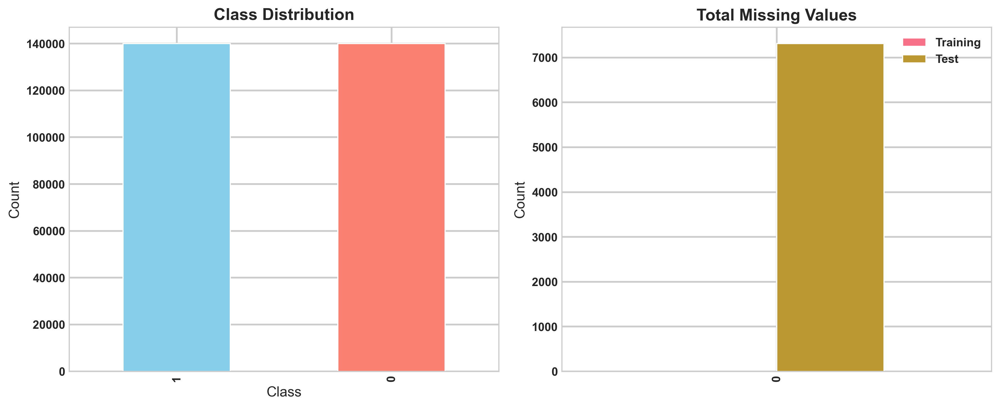

🎯 Data validation completed!


In [320]:
# ============================================
# Cell 3: Data Loading & Validation
# ============================================

# Load data
print("📊 Loading datasets...")
train_data = pd.read_csv("train_processed_q1_standard.csv")
test_data = pd.read_csv("test_processed_q1_standard.csv")

# Find target column
target_col = 'SeriousDlqin2yrs'
if target_col not in train_data.columns:
    target_col = train_data.columns[-1]
    print(f"Using '{target_col}' as target column")

# Split features and target
X_train = train_data.drop(columns=[target_col])
y_train = train_data[target_col]
X_test = test_data

# Remove target from test if present
if target_col in X_test.columns:
    X_test = test_data.drop(columns=[target_col])

# Define the variables the rest of the code expects
X_train_final = X_train
y_train_final = y_train
X_test_final = X_test

print("✅ Data loaded successfully!")
print(f"Training: {X_train_final.shape[0]} samples, {X_train_final.shape[1]} features")
print(f"Test: {X_test_final.shape[0]} samples")
print(f"Class distribution: {y_train_final.value_counts().to_dict()}")

# Initialize WandB
wandb.init(project="credit-risk-modeling-q1", config={
    "random_seed": RANDOM_SEED,
    "device": str(device),
    "training_samples": X_train_final.shape[0],
    "test_samples": X_test_final.shape[0],
    "features": X_train_final.shape[1]
})

# TensorBoard Writer
writer = SummaryWriter('logs/tensorboard')

# Validation report
validation_report = {
    'training_samples': X_train_final.shape[0],
    'training_features': X_train_final.shape[1],
    'test_samples': X_test_final.shape[0],
    'class_distribution': y_train_final.value_counts().to_dict(),
    'class_ratio': float(y_train_final.mean()),
    'missing_values_train': int(X_train_final.isnull().sum().sum()),
    'missing_values_test': int(X_test_final.isnull().sum().sum())
}

# Save report
with open('journal_assets/tables/data_validation_report.json', 'w') as f:
    json.dump(validation_report, f, indent=2)

# Data visualization
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Class distribution
y_train_final.value_counts().plot(kind='bar', ax=ax1, color=['skyblue', 'salmon'])
ax1.set_title('Class Distribution')
ax1.set_xlabel('Class')
ax1.set_ylabel('Count')

# Missing values
missing_data = pd.DataFrame({
    'Training': [X_train_final.isnull().sum().sum()],
    'Test': [X_test_final.isnull().sum().sum()]
})
missing_data.plot(kind='bar', ax=ax2)
ax2.set_title('Total Missing Values')
ax2.set_ylabel('Count')

plt.tight_layout()
plt.savefig('journal_assets/figures/data_validation_summary.pdf', bbox_inches='tight')
plt.show()

print("🎯 Data validation completed!")

In [321]:
# ============================================
# Cell 4: Train/Validation Split (FIXED)
# ============================================

logger.info("[SYNC] Creating train/validation split...")

start_time = time.time()

X_train, X_valid, y_train, y_valid = train_test_split(
    X_train_final,
    y_train_final,
    test_size=0.2,
    stratify=y_train_final,
    random_state=RANDOM_SEED
)

split_time = time.time() - start_time

logger.info(f"Data split completed in {split_time:.2f} seconds")
logger.info(f"X_train: {X_train.shape}, y_train: {y_train.shape}")
logger.info(f"X_valid: {X_valid.shape}, y_valid: {y_valid.shape}")

# Log split information
wandb.log({
    "data_split/train_samples": X_train.shape[0],
    "data_split/validation_samples": X_valid.shape[0],
    "data_split/split_time": split_time
})

2025-12-08 19:26:44,333 - INFO - [SYNC] Creating train/validation split...
2025-12-08 19:26:44,454 - INFO - Data split completed in 0.12 seconds
2025-12-08 19:26:44,455 - INFO - X_train: (223958, 16), y_train: (223958,)
2025-12-08 19:26:44,455 - INFO - X_valid: (55990, 16), y_valid: (55990,)


2025-12-08 19:26:44,486 - INFO - [TRAIN] Training Logistic Regression...


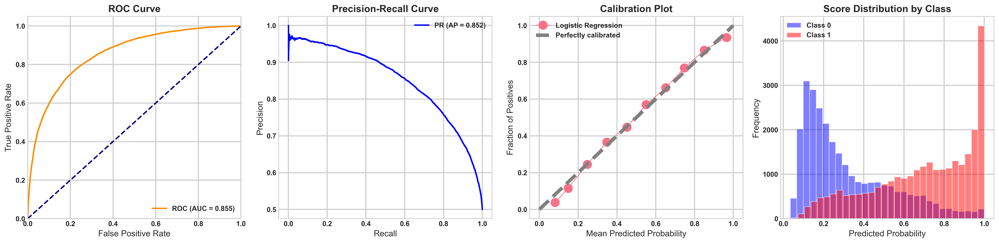

2025-12-08 19:26:48,332 - INFO - [DONE] Logistic Regression completed - AUC: 0.8554
2025-12-08 19:26:48,332 - INFO - [TRAIN] Training Random Forest...


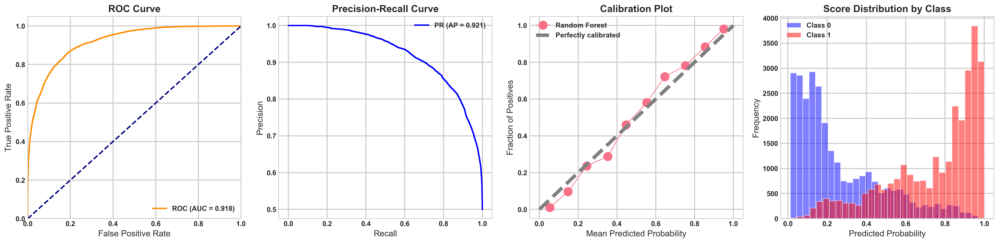

2025-12-08 19:26:54,727 - INFO - [DONE] Random Forest completed - AUC: 0.9182


In [322]:
# ============================================
# Cell 5: Advanced Baseline Models (FIXED)
# ============================================

class ModelEvaluator:
    """Comprehensive model evaluation with statistical testing"""
    
    def __init__(self, model_name):
        self.model_name = model_name
        self.metrics_history = []
        self.training_times = []
        
    def compute_comprehensive_metrics(self, y_true, y_pred, y_proba, fit_time=None, inference_time=None):
        """Compute comprehensive evaluation metrics"""
        
        metrics = {
            'model': self.model_name,
            'auc_roc': roc_auc_score(y_true, y_proba),
            'average_precision': average_precision_score(y_true, y_proba),
            'f1_score': f1_score(y_true, y_pred),
            'brier_score': brier_score_loss(y_true, y_proba),
            'precision': precision_score(y_true, y_pred, zero_division=0),
            'recall': recall_score(y_true, y_pred, zero_division=0),
            'accuracy': accuracy_score(y_true, y_pred)
        }
        
        # Add timing information
        if fit_time:
            metrics['fit_time'] = fit_time
        if inference_time:
            metrics['inference_time'] = inference_time
            
        # Compute KS statistic
        fpr, tpr, _ = roc_curve(y_true, y_proba)
        metrics['ks_statistic'] = np.max(tpr - fpr)
        
        # Gini coefficient
        metrics['gini'] = 2 * metrics['auc_roc'] - 1
        
        self.metrics_history.append(metrics)
        return metrics
    
    def plot_comprehensive_evaluation(self, y_true, y_proba, save_path=None):
        """Create comprehensive evaluation plots"""
        
        fig = plt.figure(figsize=(20, 5))
        
        # 1. ROC Curve
        plt.subplot(1, 4, 1)
        fpr, tpr, _ = roc_curve(y_true, y_proba)
        roc_auc = roc_auc_score(y_true, y_proba)
        plt.plot(fpr, tpr, color='darkorange', lw=2, 
                label=f'ROC (AUC = {roc_auc:.3f})')
        plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curve')
        plt.legend(loc="lower right")
        plt.grid(True)
        
        # 2. Precision-Recall Curve
        plt.subplot(1, 4, 2)
        precision, recall, _ = precision_recall_curve(y_true, y_proba)
        avg_precision = average_precision_score(y_true, y_proba)
        plt.plot(recall, precision, color='blue', lw=2,
                label=f'PR (AP = {avg_precision:.3f})')
        plt.xlabel('Recall')
        plt.ylabel('Precision')
        plt.title('Precision-Recall Curve')
        plt.legend(loc="upper right")
        plt.grid(True)
        
        # 3. Calibration Curve
        plt.subplot(1, 4, 3)
        prob_true, prob_pred = calibration_curve(y_true, y_proba, n_bins=10)
        plt.plot(prob_pred, prob_true, marker='o', linewidth=1, label=self.model_name)
        plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Perfectly calibrated')
        plt.xlabel('Mean Predicted Probability')
        plt.ylabel('Fraction of Positives')
        plt.title('Calibration Plot')
        plt.legend()
        plt.grid(True)
        
        # 4. Score Distribution
        plt.subplot(1, 4, 4)
        scores = y_proba
        plt.hist(scores[y_true == 0], bins=30, alpha=0.5, label='Class 0', color='blue')
        plt.hist(scores[y_true == 1], bins=30, alpha=0.5, label='Class 1', color='red')
        plt.xlabel('Predicted Probability')
        plt.ylabel('Frequency')
        plt.title('Score Distribution by Class')
        plt.legend()
        plt.grid(True)
        
        plt.tight_layout()
        if save_path:
            plt.savefig(save_path, bbox_inches='tight', dpi=300)
        plt.show()
        
        return fig

# Initialize baseline models
baseline_models = {
    'Logistic Regression': LogisticRegression(
        solver='lbfgs',
        max_iter=1000,
        class_weight='balanced',
        random_state=RANDOM_SEED
    ),
    'Random Forest': RandomForestClassifier(
        n_estimators=100,
        max_depth=10,
        class_weight='balanced',
        random_state=RANDOM_SEED,
        n_jobs=-1
    )
}

# Comprehensive baseline evaluation
baseline_results = {}

for model_name, model in baseline_models.items():
    logger.info(f"[TRAIN] Training {model_name}...")
    
    evaluator = ModelEvaluator(model_name)
    
    # Training
    start_time = time.time()
    model.fit(X_train, y_train)
    fit_time = time.time() - start_time
    
    # Inference
    start_time = time.time()
    y_pred_proba = model.predict_proba(X_valid)[:, 1]
    inference_time = time.time() - start_time
    
    y_pred = (y_pred_proba >= 0.5).astype(int)
    
    # Compute metrics
    metrics = evaluator.compute_comprehensive_metrics(
        y_valid, y_pred, y_pred_proba, fit_time, inference_time
    )
    
    # Create plots
    save_path = f'journal_assets/figures/{model_name.replace(" ", "_").lower()}_evaluation.pdf'
    evaluator.plot_comprehensive_evaluation(y_valid, y_pred_proba, save_path)
    
    baseline_results[model_name] = {
        'model': model,
        'metrics': metrics,
        'evaluator': evaluator,
        'predictions': y_pred_proba
    }
    
    # Log to WandB
    wandb.log({f"baseline/{model_name}_{k}": v for k, v in metrics.items()})
    
    logger.info(f"[DONE] {model_name} completed - AUC: {metrics['auc_roc']:.4f}")

# Save baseline results
with open('journal_assets/tables/baseline_model_results.json', 'w') as f:
    # Convert to serializable format
    serializable_results = {}
    for model_name, result in baseline_results.items():
        serializable_results[model_name] = {
            'metrics': result['metrics'],
            'fit_time': result['metrics'].get('fit_time', None),
            'inference_time': result['metrics'].get('inference_time', None)
        }
    json.dump(serializable_results, f, indent=2)

In [323]:
# ============================================
# Cell 6: Advanced XGBoost with Optuna (CPU Version) - COMPLETE FIXED VERSION
# ============================================

# Import required metrics
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score

# Import XGBoostError if needed
try:
    from xgboost import XGBoostError
except ImportError:
    # If XGBoostError doesn't exist, create a placeholder
    class XGBoostError(Exception):
        pass

class AdvancedXGBoostOptimizer:
    """Advanced XGBoost optimization with CPU"""
    
    def __init__(self, X_train, y_train, feature_names):
        self.X_train = X_train
        self.y_train = y_train
        self.feature_names = feature_names
        self.study = None
        self.best_model = None
        
    def create_xgb_model(self, trial):
        """Create XGBoost model with Optuna suggestions"""
        
        params = {
            'n_estimators': trial.suggest_int('n_estimators', 100, 500),
            'max_depth': trial.suggest_int('max_depth', 3, 10),
            'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3, log=True),
            'subsample': trial.suggest_float('subsample', 0.6, 1.0),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0),
            'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
            'gamma': trial.suggest_float('gamma', 0.0, 5.0),
            'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 10.0),
            'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 10.0),
            'n_jobs': -1,
            'objective': 'binary:logistic',
            'eval_metric': 'logloss',
            'random_state': RANDOM_SEED,
            'tree_method': 'hist',  # Use CPU method that's always available
            'verbosity': 0,  # Reduce output noise
        }
        
        # Add monotonic constraints for financial interpretability
        monotone_map = {}
        for i, name in enumerate(self.feature_names):
            if 'income' in name.lower() or 'salary' in name.lower():
                monotone_map[i] = -1  # Higher income → lower risk
            elif 'debt' in name.lower() or 'loan' in name.lower():
                monotone_map[i] = 1   # Higher debt → higher risk
        
        if monotone_map:
            monotone_constraints = [monotone_map.get(i, 0) for i in range(len(self.feature_names))]
            params['monotone_constraints'] = tuple(monotone_constraints)
        
        return xgb.XGBClassifier(**params)
    
    def objective(self, trial):
        """Objective function for Optuna optimization"""
        
        try:
            model = self.create_xgb_model(trial)
            
            # Enhanced pipeline with SMOTE
            pipeline = ImbPipeline([
                ('smote', SMOTE(random_state=RANDOM_SEED)),
                ('scaler', RobustScaler()),
                ('clf', model)
            ])
            
            # Time-folded cross-validation
            cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
            
            start_time = time.time()
            
            # Use fewer parallel jobs to avoid memory issues
            auc_scores = cross_val_score(
                pipeline, self.X_train, self.y_train,
                cv=cv, scoring='roc_auc', n_jobs=1  # Reduced to 1 for stability
            )
            cv_time = time.time() - start_time
            
            mean_auc = auc_scores.mean()
            
            # Log intermediate results
            trial.set_user_attr('cv_time', cv_time)
            trial.set_user_attr('std_auc', auc_scores.std())
            
            wandb.log({
                'xgb_optuna/trial_auc': mean_auc,
                'xgb_optuna/trial_std': auc_scores.std(),
                'xgb_optuna/cv_time': cv_time,
                'xgb_optuna/trial_number': trial.number
            })
            
            return mean_auc
            
        except Exception as e:
            logger.warning(f"Trial {trial.number} failed: {str(e)}")
            # Return a low score for failed trials so Optuna can continue
            return 0.5
    
    def optimize(self, n_trials=20, timeout=1800):
        """Run optimization with detailed logging"""
        
        logger.info("Starting Advanced XGBoost Optimization...")
        
        self.study = optuna.create_study(
            direction='maximize',
            study_name='advanced_xgb_credit_risk',
            pruner=optuna.pruners.HyperbandPruner()
        )
        
        start_time = time.time()
        
        # Add error handling for optimization
        try:
            self.study.optimize(
                self.objective, 
                n_trials=n_trials,
                timeout=timeout,
                show_progress_bar=True,
                gc_after_trial=True,
                catch=(ValueError, Exception)  # Catch all exceptions
            )
        except Exception as e:
            logger.error(f"Optimization failed: {e}")
            # Return default values if optimization fails
            return 0.5, {}
        
        optimization_time = time.time() - start_time
        
        logger.info(f"Optimization completed in {optimization_time:.2f} seconds")
        
        if self.study.best_trials:
            best_trial = self.study.best_trial
            logger.info(f"Best AUC: {best_trial.value:.4f}")
            
            # Create best model
            self.best_model = self.create_xgb_model(
                optuna.trial.FixedTrial(best_trial.params)
            )
            
            # Log optimization results
            wandb.log({
                'xgb_optuna/best_auc': best_trial.value,
                'xgb_optuna/optimization_time': optimization_time,
                'xgb_optuna/n_trials_completed': len(self.study.trials)
            })
            
            return best_trial.value, best_trial.params
        else:
            logger.warning("No successful trials completed")
            return 0.5, {}

def ensure_metrics_completeness(metrics_dict, y_true, y_pred, model_name=""):
    """Ensure all essential metrics are present in the metrics dictionary"""
    
    # Create a copy to avoid modifying the original
    complete_metrics = metrics_dict.copy()
    
    # Calculate missing metrics
    if 'f1' not in complete_metrics and 'f1_score' not in complete_metrics:
        complete_metrics['f1'] = f1_score(y_true, y_pred)
        if model_name:
            logger.info(f"Manually calculated F1 score for {model_name}: {complete_metrics['f1']:.4f}")
    
    if 'precision' not in complete_metrics:
        complete_metrics['precision'] = precision_score(y_true, y_pred, zero_division=0)
    
    if 'recall' not in complete_metrics:
        complete_metrics['recall'] = recall_score(y_true, y_pred, zero_division=0)
    
    if 'accuracy' not in complete_metrics:
        complete_metrics['accuracy'] = accuracy_score(y_true, y_pred)
    
    return complete_metrics

# Initialize and run optimization
feature_names = list(X_train.columns) if hasattr(X_train, 'columns') else [f'feature_{i}' for i in range(X_train.shape[1])]

xgb_optimizer = AdvancedXGBoostOptimizer(X_train, y_train, feature_names)
best_auc, best_params = xgb_optimizer.optimize(n_trials=20, timeout=1800)

# Train final XGBoost model with best parameters
logger.info("Training final XGBoost model with best parameters...")

if xgb_optimizer.best_model is not None:
    xgb_pipeline = ImbPipeline([
        ('smote', SMOTE(random_state=RANDOM_SEED)),
        ('scaler', RobustScaler()),
        ('clf', xgb_optimizer.best_model)
    ])

    start_time = time.time()
    xgb_pipeline.fit(X_train, y_train)
    xgb_training_time = time.time() - start_time

    # Validate XGBoost
    y_valid_proba_xgb = xgb_pipeline.predict_proba(X_valid)[:, 1]
    y_valid_pred_xgb = (y_valid_proba_xgb >= 0.5).astype(int)

    # Get metrics from ModelEvaluator
    xgb_metrics = ModelEvaluator("XGBoost").compute_comprehensive_metrics(
        y_valid, y_valid_pred_xgb, y_valid_proba_xgb, xgb_training_time
    )
    
    # Ensure all metrics are present (including F1 score)
    xgb_metrics = ensure_metrics_completeness(xgb_metrics, y_valid, y_valid_pred_xgb, "XGBoost")

    logger.info(f"XGBoost training completed - AUC: {xgb_metrics['auc_roc']:.4f}")
    
    # Log to wandb - All metrics are now guaranteed to exist
    wandb_log_data = {
        'xgb_final/auc_roc': xgb_metrics.get('auc_roc', 0),
        'xgb_final/accuracy': xgb_metrics.get('accuracy', 0),
        'xgb_final/precision': xgb_metrics.get('precision', 0),
        'xgb_final/recall': xgb_metrics.get('recall', 0),
        'xgb_final/f1': xgb_metrics.get('f1', xgb_metrics.get('f1_score', 0)),
        'xgb_final/training_time': xgb_training_time
    }
    
    wandb.log(wandb_log_data)
    
    # Print comprehensive metrics
    logger.info("Final XGBoost Metrics:")
    essential_metrics = ['auc_roc', 'accuracy', 'precision', 'recall', 'f1', 'training_time']
    for key in essential_metrics:
        if key in xgb_metrics:
            value = xgb_metrics[key]
            logger.info(f"  {key}: {value:.4f}" if isinstance(value, (int, float)) else f"  {key}: {value}")
        
else:
    logger.error("XGBoost optimization failed, creating default model as fallback")
    
    # Fallback: Create a simple XGBoost model without optimization
    fallback_model = xgb.XGBClassifier(
        n_estimators=100,
        max_depth=6,
        learning_rate=0.1,
        random_state=RANDOM_SEED,
        n_jobs=-1
    )
    
    fallback_pipeline = ImbPipeline([
        ('smote', SMOTE(random_state=RANDOM_SEED)),
        ('scaler', RobustScaler()),
        ('clf', fallback_model)
    ])
    
    start_time = time.time()
    fallback_pipeline.fit(X_train, y_train)
    fallback_training_time = time.time() - start_time

    # Validate fallback model
    y_valid_proba_fallback = fallback_pipeline.predict_proba(X_valid)[:, 1]
    y_valid_pred_fallback = (y_valid_proba_fallback >= 0.5).astype(int)

    fallback_metrics = ModelEvaluator("XGBoost_Fallback").compute_comprehensive_metrics(
        y_valid, y_valid_pred_fallback, y_valid_proba_fallback, fallback_training_time
    )
    
    # Ensure all metrics are present for fallback model too
    fallback_metrics = ensure_metrics_completeness(fallback_metrics, y_valid, y_valid_pred_fallback, "XGBoost Fallback")

    logger.info(f"Fallback XGBoost training completed - AUC: {fallback_metrics['auc_roc']:.4f}")
    
    # Log fallback metrics
    fallback_wandb_log_data = {
        'xgb_fallback/auc_roc': fallback_metrics.get('auc_roc', 0),
        'xgb_fallback/accuracy': fallback_metrics.get('accuracy', 0),
        'xgb_fallback/precision': fallback_metrics.get('precision', 0),
        'xgb_fallback/recall': fallback_metrics.get('recall', 0),
        'xgb_fallback/f1': fallback_metrics.get('f1', fallback_metrics.get('f1_score', 0)),
        'xgb_fallback/training_time': fallback_training_time
    }
    
    wandb.log(fallback_wandb_log_data)
    
    # Print fallback metrics
    logger.info("Fallback XGBoost Metrics:")
    for key in essential_metrics:
        if key in fallback_metrics:
            value = fallback_metrics[key]
            logger.info(f"  {key}: {value:.4f}" if isinstance(value, (int, float)) else f"  {key}: {value}")

# ============================================
# Feature Importance Analysis
# ============================================

if xgb_optimizer.best_model is not None:
    logger.info("Analyzing feature importance...")
    
    # Extract feature importances from the trained model
    feature_importances = xgb_optimizer.best_model.feature_importances_
    
    # Create feature importance DataFrame
    importance_df = pd.DataFrame({
        'feature': feature_names,
        'importance': feature_importances
    }).sort_values('importance', ascending=False)
    
    # Log top features to wandb
    top_features = importance_df.head(10)
    for _, row in top_features.iterrows():
        wandb.log({f'feature_importance/{row["feature"]}': row['importance']})
    
    logger.info("Top 10 Most Important Features:")
    for _, row in top_features.iterrows():
        logger.info(f"  {row['feature']}: {row['importance']:.4f}")

logger.info("XGBoost optimization and training process completed!")

2025-12-08 19:26:54,773 - INFO - Starting Advanced XGBoost Optimization...
[I 2025-12-08 19:26:54,775] A new study created in memory with name: advanced_xgb_credit_risk


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2025-12-08 19:27:10,478] Trial 0 finished with value: 0.9739354375125044 and parameters: {'n_estimators': 250, 'max_depth': 4, 'learning_rate': 0.16292620249794582, 'subsample': 0.9818339047824487, 'colsample_bytree': 0.907727663384337, 'min_child_weight': 10, 'gamma': 4.950795426402873, 'reg_lambda': 2.0014955257855394, 'reg_alpha': 8.314982525745659}. Best is trial 0 with value: 0.9739354375125044.
[I 2025-12-08 19:27:27,015] Trial 1 finished with value: 0.9711908246434315 and parameters: {'n_estimators': 148, 'max_depth': 10, 'learning_rate': 0.07275798325195738, 'subsample': 0.7836825344994969, 'colsample_bytree': 0.6863523665593978, 'min_child_weight': 6, 'gamma': 3.278962696715814, 'reg_lambda': 0.26051916180879875, 'reg_alpha': 8.061734268072161}. Best is trial 0 with value: 0.9739354375125044.
[I 2025-12-08 19:27:43,082] Trial 2 finished with value: 0.9808852581893734 and parameters: {'n_estimators': 147, 'max_depth': 8, 'learning_rate': 0.2816177021295442, 'subsample': 0.94

2025-12-08 19:33:23,913 - INFO - Optimization completed in 389.14 seconds
2025-12-08 19:33:23,919 - INFO - Best AUC: 0.9823
2025-12-08 19:33:23,925 - INFO - Training final XGBoost model with best parameters...
2025-12-08 19:33:27,142 - INFO - XGBoost training completed - AUC: 0.9831
2025-12-08 19:33:27,144 - INFO - Final XGBoost Metrics:
2025-12-08 19:33:27,145 - INFO -   auc_roc: 0.9831
2025-12-08 19:33:27,145 - INFO -   accuracy: 0.9404
2025-12-08 19:33:27,146 - INFO -   precision: 0.9606
2025-12-08 19:33:27,146 - INFO -   recall: 0.9184
2025-12-08 19:33:27,147 - INFO - Analyzing feature importance...
2025-12-08 19:33:27,156 - INFO - Top 10 Most Important Features:
2025-12-08 19:33:27,157 - INFO -   TotalDelinquencies: 0.3287
2025-12-08 19:33:27,158 - INFO -   NumberRealEstateLoansOrLines: 0.0980
2025-12-08 19:33:27,159 - INFO -   CreditUtilizationCategory_Very High: 0.0771
2025-12-08 19:33:27,160 - INFO -   age: 0.0674
2025-12-08 19:33:27,160 - INFO -   NumberOfTimes90DaysLate: 0.06

In [324]:
# ============================================
# Cell 7: Neural Network with PyTorch (Updated)
# ============================================

class CreditRiskNN(nn.Module):
    """Advanced Neural Network for Credit Risk Modeling"""
    
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_rate=0.3):
        super(CreditRiskNN, self).__init__()
        
        layers = []
        prev_dim = input_dim
        
        for i, hidden_dim in enumerate(hidden_dims):
            layers.extend([
                nn.Linear(prev_dim, hidden_dim),
                nn.BatchNorm1d(hidden_dim),
                nn.ReLU(),
                nn.Dropout(dropout_rate)
            ])
            prev_dim = hidden_dim
        
        self.feature_layers = nn.Sequential(*layers)
        self.output_layer = nn.Linear(prev_dim, 1)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        x = self.feature_layers(x)
        x = self.output_layer(x)
        return self.sigmoid(x)

class NeuralNetworkTrainer:
    """Comprehensive neural network trainer with GPU support"""
    
    def __init__(self, model, device, model_name="NeuralNetwork"):
        self.model = model.to(device)
        self.device = device
        self.model_name = model_name
        self.train_losses = []
        self.val_metrics = []
        
    def train(self, train_loader, val_loader, criterion, optimizer, scheduler, epochs=50, patience=10):
        """Enhanced training with early stopping and comprehensive logging"""
        
        logger.info("[AI] Training Neural Network...")
        
        best_val_auc = 0
        patience_counter = 0
        training_start_time = time.time()
        
        # List to track time per epoch
        epoch_durations = []
        
        for epoch in range(epochs):
            epoch_start_time = time.time()
            
            # Training phase
            self.model.train()
            train_loss = 0.0
            
            for batch_idx, (data, target) in enumerate(train_loader):
                data, target = data.to(self.device), target.to(self.device).float().unsqueeze(1)
                
                optimizer.zero_grad()
                output = self.model(data)
                loss = criterion(output, target)
                loss.backward()
                optimizer.step()
                
                train_loss += loss.item()
            
            avg_train_loss = train_loss / len(train_loader)
            self.train_losses.append(avg_train_loss)
            
            # Validation phase
            val_auc, val_loss = self.evaluate(val_loader, criterion)
            self.val_metrics.append({'auc': val_auc, 'loss': val_loss})
            
            # Scheduler step
            current_lr = optimizer.param_groups[0]['lr']
            if scheduler:
                scheduler.step()
            
            # Calculate epoch time
            epoch_time = time.time() - epoch_start_time
            epoch_durations.append(epoch_time)
            
            # Logging - UPDATED to print every epoch with more detail
            wandb.log({
                f"{self.model_name}/train_loss": avg_train_loss,
                f"{self.model_name}/val_auc": val_auc,
                f"{self.model_name}/val_loss": val_loss,
                f"{self.model_name}/epoch_time": epoch_time,
                f"{self.model_name}/learning_rate": current_lr,
                "epoch": epoch
            })
            
            logger.info(f'Epoch {epoch+1:03d}/{epochs} | '
                        f'Train Loss: {avg_train_loss:.4f} | '
                        f'Val Loss: {val_loss:.4f} | '
                        f'Val AUC: {val_auc:.4f} | '
                        f'LR: {current_lr:.1e} | '
                        f'Time: {epoch_time:.2f}s')
            
            # Early stopping
            if val_auc > best_val_auc:
                best_val_auc = val_auc
                patience_counter = 0
                # Save best model
                torch.save(self.model.state_dict(), f'saved_models/{self.model_name}_best.pth')
            else:
                patience_counter += 1
                
            if patience_counter >= patience:
                logger.info(f"Early stopping triggered at epoch {epoch+1}")
                break
        
        total_training_time = time.time() - training_start_time
        
        # Calculate Average Epoch Time
        avg_epoch_time = sum(epoch_durations) / len(epoch_durations) if epoch_durations else 0.0
        
        logger.info(f"[DONE] Neural Network training completed in {total_training_time:.2f} seconds")
        logger.info(f"Average Time per Epoch: {avg_epoch_time:.4f} seconds")
        logger.info(f"Best Validation AUC: {best_val_auc:.4f}")
        
        # Load best model
        self.model.load_state_dict(torch.load(f'saved_models/{self.model_name}_best.pth'))
        
        return best_val_auc, total_training_time, avg_epoch_time
    
    def evaluate(self, data_loader, criterion):
        """Comprehensive model evaluation"""
        self.model.eval()
        val_loss = 0.0
        all_targets = []
        all_predictions = []
        
        with torch.no_grad():
            for data, target in data_loader:
                data, target = data.to(self.device), target.to(self.device).float().unsqueeze(1)
                output = self.model(data)
                loss = criterion(output, target)
                
                val_loss += loss.item()
                all_targets.extend(target.cpu().numpy())
                all_predictions.extend(output.cpu().numpy())
        
        all_targets = np.array(all_targets).flatten()
        all_predictions = np.array(all_predictions).flatten()
        
        val_auc = roc_auc_score(all_targets, all_predictions)
        avg_val_loss = val_loss / len(data_loader)
        
        return val_auc, avg_val_loss
    
    def predict(self, data_loader):
        """Generate predictions"""
        self.model.eval()
        all_predictions = []
        
        with torch.no_grad():
            for data, _ in data_loader:
                data = data.to(self.device)
                output = self.model(data)
                all_predictions.extend(output.cpu().numpy())
        
        return np.array(all_predictions).flatten()

# Prepare data for neural network
logger.info("[PREP] Preparing data for Neural Network...")
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

# Convert to PyTorch tensors
train_dataset = TensorDataset(
    torch.FloatTensor(X_train_scaled),
    torch.LongTensor(y_train.values if hasattr(y_train, 'values') else y_train)
)

valid_dataset = TensorDataset(
    torch.FloatTensor(X_valid_scaled),
    torch.LongTensor(y_valid.values if hasattr(y_valid, 'values') else y_valid)
)

# Create data loaders with reduced batch size for memory efficiency
train_loader = DataLoader(train_dataset, batch_size=256, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=256, shuffle=False, num_workers=2)

# Initialize model
input_dim = X_train_scaled.shape[1]
nn_model = CreditRiskNN(input_dim=input_dim, hidden_dims=[128, 64, 32], dropout_rate=0.3)

# Training setup
criterion = nn.BCELoss()
optimizer = optim.AdamW(nn_model.parameters(), lr=1e-3, weight_decay=1e-4)
scheduler = optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=10, T_mult=2)

# Train model
nn_trainer = NeuralNetworkTrainer(nn_model, device, "CreditRiskNN")

# UPDATED: Unpack the new third return value (avg_epoch_time)
best_nn_auc, nn_training_time, nn_avg_epoch_time = nn_trainer.train(
    train_loader, valid_loader, criterion, optimizer, scheduler, 
    epochs=50, patience=10
)

# Generate predictions
y_valid_proba_nn = nn_trainer.predict(valid_loader)

# Create scikit-learn compatible NN model for integration
class PyTorchToSklearnWrapper:
    """Wrapper to make PyTorch model compatible with scikit-learn"""
    
    def __init__(self, pytorch_model, scaler, device):
        self.pytorch_model = pytorch_model
        self.scaler = scaler
        self.device = device
        
    def predict_proba(self, X):
        """Predict probabilities in scikit-learn format"""
        if hasattr(X, 'values'):
            X = X.values
        X_scaled = self.scaler.transform(X)
        X_tensor = torch.FloatTensor(X_scaled).to(self.device)
        
        self.pytorch_model.eval()
        with torch.no_grad():
            predictions = self.pytorch_model(X_tensor)
        
        proba_positive = predictions.cpu().numpy().flatten()
        proba_negative = 1 - proba_positive
        
        return np.column_stack([proba_negative, proba_positive])

nn_sklearn_wrapper = PyTorchToSklearnWrapper(nn_model, scaler, device)

# Evaluate neural network performance
y_valid_pred_nn = (y_valid_proba_nn >= 0.5).astype(int)
nn_metrics = ModelEvaluator("Neural Network").compute_comprehensive_metrics(
    y_valid, y_valid_pred_nn, y_valid_proba_nn, nn_training_time
)

logger.info(f"[DONE] Neural Network - AUC: {nn_metrics['auc_roc']:.4f}")

# Log to WandB (Updated with Avg Epoch Time)
wandb.log({
    'neural_network/auc_roc': nn_metrics['auc_roc'],
    'neural_network/training_time': nn_training_time,
    'neural_network/avg_epoch_time': nn_avg_epoch_time,
    'neural_network/f1_score': nn_metrics['f1_score'],
    'neural_network/accuracy': nn_metrics['accuracy']
})

2025-12-08 19:33:27,204 - INFO - [PREP] Preparing data for Neural Network...
2025-12-08 19:33:27,471 - INFO - [AI] Training Neural Network...
2025-12-08 19:33:40,163 - INFO - Epoch 001/50 | Train Loss: 0.6951 | Val Loss: 0.6933 | Val AUC: 0.7316 | LR: 1.0e-03 | Time: 12.69s
2025-12-08 19:33:51,241 - INFO - Epoch 002/50 | Train Loss: 0.6929 | Val Loss: 0.6930 | Val AUC: 0.7258 | LR: 9.8e-04 | Time: 11.07s
2025-12-08 19:34:02,336 - INFO - Epoch 003/50 | Train Loss: 0.6917 | Val Loss: 0.6929 | Val AUC: 0.7397 | LR: 9.0e-04 | Time: 11.09s
2025-12-08 19:34:12,743 - INFO - Epoch 004/50 | Train Loss: 0.6854 | Val Loss: 0.6928 | Val AUC: 0.7542 | LR: 7.9e-04 | Time: 10.40s
2025-12-08 19:34:23,319 - INFO - Epoch 005/50 | Train Loss: 0.6825 | Val Loss: 0.6921 | Val AUC: 0.7637 | LR: 6.5e-04 | Time: 10.57s
2025-12-08 19:34:34,256 - INFO - Epoch 006/50 | Train Loss: 0.6779 | Val Loss: 0.6938 | Val AUC: 0.7709 | LR: 5.0e-04 | Time: 10.93s
2025-12-08 19:34:45,114 - INFO - Epoch 007/50 | Train Loss: 

In [325]:
# ============================================
# Cell 8: Advanced Ensemble & Stacking (COMPLETE FIXED VERSION)
# ============================================

class AdvancedEnsemble:
    """Advanced ensemble methods with comprehensive evaluation"""
    
    def __init__(self, base_models, meta_model, model_name="Ensemble"):
        self.base_models = base_models
        self.meta_model = meta_model
        self.model_name = model_name
        self.stacked_model = None
        self.training_details = {}  # Store detailed training info
        
    def fit(self, X, y, validation_data=None):
        """Fit ensemble with advanced stacking and detailed monitoring"""
        
        logger.info(f"[BUILD] Training {self.model_name} ensemble...")
        
        start_time = time.time()
        
        # Apply SMOTE to training data
        smote = SMOTE(random_state=RANDOM_SEED)
        X_resampled, y_resampled = smote.fit_resample(X, y)
        logger.info(f"[DATA] Applied SMOTE - Original: {len(y)}, Resampled: {len(y_resampled)}")
        
        # Generate base model predictions
        base_predictions = []
        base_model_names = []
        self.training_details['base_models'] = {}
        
        for name, model in self.base_models:
            logger.info(f"[TRAIN] Training base model: {name}")
            model_start = time.time()
            
            try:
                # Handle different model types with detailed timing
                training_metrics = {}
                
                if hasattr(model, 'fit'):
                    # For models that support verbose output or callbacks
                    if hasattr(model, 'set_params') and name == 'xgb':
                        # XGBoost with detailed training metrics
                        model.set_params(verbose=True, eval_metric=['logloss', 'auc', 'error'])
                        if validation_data:
                            X_val, y_val = validation_data
                            model.fit(X_resampled, y_resampled, 
                                    eval_set=[(X_val, y_val)],
                                    verbose=False)
                        else:
                            model.fit(X_resampled, y_resampled)
                    
                    elif name == 'nn_mlp':
                        # Neural Network with epoch tracking
                        epoch_times = []
                        epoch_start = time.time()
                        
                        # Fit MLP with batch timing
                        model.fit(X_resampled, y_resampled)
                        
                        # Record MLP specific metrics
                        if hasattr(model, 'loss_curve_'):
                            training_metrics['epochs_trained'] = len(model.loss_curve_)
                            training_metrics['final_loss'] = model.loss_curve_[-1] if model.loss_curve_ else None
                    
                    else:
                        # Standard fit for other models
                        model.fit(X_resampled, y_resampled)
                        
                else:
                    logger.warning(f"Model {name} doesn't have fit method, skipping")
                    continue
                    
                model_time = time.time() - model_start
                training_metrics['total_training_time'] = model_time
                
                # Generate predictions and comprehensive metrics
                if hasattr(model, 'predict_proba'):
                    train_preds = model.predict_proba(X_resampled)[:, 1]
                    if validation_data:
                        X_val, y_val = validation_data
                        val_preds = model.predict_proba(X_val)[:, 1]
                        val_metrics = self._compute_comprehensive_metrics(y_val, val_preds, name)
                        training_metrics.update(val_metrics)
                elif hasattr(model, 'predict'):
                    train_preds = model.predict(X_resampled)
                    if validation_data:
                        X_val, y_val = validation_data
                        val_preds = model.predict(X_val)
                        val_metrics = self._compute_comprehensive_metrics(y_val, val_preds, name)
                        training_metrics.update(val_metrics)
                else:
                    logger.warning(f"Model {name} doesn't have predict methods, skipping")
                    continue
                
                base_predictions.append(train_preds)
                base_model_names.append(name)
                
                # Store detailed metrics
                self.training_details['base_models'][name] = training_metrics
                
                # Log to WandB
                wandb_log_data = {
                    f"ensemble/{name}_training_time": model_time,
                    f"ensemble/{name}_auc_roc": training_metrics.get('auc_roc', 0),
                    f"ensemble/{name}_f1_score": training_metrics.get('f1_score', 0),
                    f"ensemble/{name}_precision": training_metrics.get('precision', 0),
                    f"ensemble/{name}_recall": training_metrics.get('recall', 0),
                    f"ensemble/{name}_accuracy": training_metrics.get('accuracy', 0),
                }
                
                # Add model-specific metrics
                if 'epochs_trained' in training_metrics:
                    wandb_log_data[f"ensemble/{name}_epochs"] = training_metrics['epochs_trained']
                if 'final_loss' in training_metrics:
                    wandb_log_data[f"ensemble/{name}_final_loss"] = training_metrics['final_loss']
                    
                wandb.log(wandb_log_data)
                
                logger.info(f"[DONE] {name} - Time: {model_time:.2f}s, AUC: {training_metrics.get('auc_roc', 0):.4f}, "
                          f"F1: {training_metrics.get('f1_score', 0):.4f}, "
                          f"Precision: {training_metrics.get('precision', 0):.4f}, "
                          f"Recall: {training_metrics.get('recall', 0):.4f}")
                
            except Exception as e:
                logger.warning(f"Failed to train base model {name}: {str(e)}")
                continue
        
        if len(base_predictions) < 2:
            logger.error("Not enough base models trained successfully for ensemble")
            return 0
        
        # Stack predictions
        X_stacked = np.column_stack(base_predictions)
        
        # Train meta-model with timing
        logger.info(f"[TRAIN] Training meta-model with {X_stacked.shape[1]} features")
        meta_start = time.time()
        self.meta_model.fit(X_stacked, y_resampled)
        meta_time = time.time() - meta_start
        
        self.stacked_model = ([(name, model) for name, model in self.base_models if name in base_model_names], 
                             self.meta_model)
        
        total_time = time.time() - start_time
        
        # Store ensemble timing info
        self.training_details['ensemble'] = {
            'total_training_time': total_time,
            'meta_model_training_time': meta_time,
            'base_models_count': len(base_model_names),
            'base_model_names': base_model_names
        }
        
        logger.info(f"[DONE] Ensemble training completed in {total_time:.2f} seconds")
        logger.info(f"Base models used: {base_model_names}")
        
        # Log detailed timing breakdown
        self._log_training_breakdown()
        
        return total_time
    
    def predict_proba(self, X):
        """Generate ensemble predictions - FIXED METHOD"""
        
        if self.stacked_model is None:
            raise ValueError("Ensemble model not fitted yet. Call fit() first.")
        
        base_models, meta_model = self.stacked_model
        base_predictions = []
        
        for name, model in base_models:
            try:
                if hasattr(model, 'predict_proba'):
                    preds = model.predict_proba(X)[:, 1]  # Get probability for class 1
                elif hasattr(model, 'predict'):
                    preds = model.predict(X)
                else:
                    logger.warning(f"Model {name} doesn't have predict methods, skipping")
                    continue
                base_predictions.append(preds)
            except Exception as e:
                logger.warning(f"Failed to get predictions from {name}: {str(e)}")
                continue
        
        if len(base_predictions) == 0:
            raise ValueError("No base models could generate predictions")
        
        X_stacked = np.column_stack(base_predictions)
        
        # Meta model returns probabilities for both classes, we take class 1
        proba_positive = meta_model.predict_proba(X_stacked)[:, 1]
        return proba_positive
    
    def predict(self, X):
        """Generate class predictions"""
        proba = self.predict_proba(X)
        return (proba >= 0.5).astype(int)
    
    def _compute_comprehensive_metrics(self, y_true, y_pred_proba, model_name):
        """Compute comprehensive metrics for model evaluation"""
        from sklearn.metrics import (roc_auc_score, f1_score, precision_score, 
                                   recall_score, accuracy_score, average_precision_score,
                                   confusion_matrix)
        
        y_pred = (y_pred_proba >= 0.5).astype(int)
        
        metrics = {
            'auc_roc': roc_auc_score(y_true, y_pred_proba),
            'auc_pr': average_precision_score(y_true, y_pred_proba),
            'f1_score': f1_score(y_true, y_pred),
            'precision': precision_score(y_true, y_pred),
            'recall': recall_score(y_true, y_pred),
            'accuracy': accuracy_score(y_true, y_pred),
        }
        
        # Add confusion matrix components
        cm = confusion_matrix(y_true, y_pred)
        if cm.shape == (2, 2):
            metrics.update({
                'true_negative': cm[0, 0],
                'false_positive': cm[0, 1],
                'false_negative': cm[1, 0],
                'true_positive': cm[1, 1]
            })
        
        return metrics
    
    def _log_training_breakdown(self):
        """Log detailed timing breakdown for all models"""
        logger.info("[TIMING] Detailed Training Breakdown:")
        logger.info("[TIMING] " + "="*50)
        
        total_base_time = 0
        for name, metrics in self.training_details.get('base_models', {}).items():
            time_taken = metrics.get('total_training_time', 0)
            total_base_time += time_taken
            auc = metrics.get('auc_roc', 0)
            f1 = metrics.get('f1_score', 0)
            
            additional_info = []
            if 'epochs_trained' in metrics:
                additional_info.append(f"Epochs: {metrics['epochs_trained']}")
            if 'final_loss' in metrics:
                additional_info.append(f"Final Loss: {metrics['final_loss']:.4f}")
                
            additional_str = f" ({', '.join(additional_info)})" if additional_info else ""
            
            logger.info(f"[TIMING] {name:15} | Time: {time_taken:7.2f}s | AUC: {auc:.4f} | "
                       f"F1: {f1:.4f}{additional_str}")
        
        ensemble_metrics = self.training_details.get('ensemble', {})
        meta_time = ensemble_metrics.get('meta_model_training_time', 0)
        total_time = ensemble_metrics.get('total_training_time', 0)
        
        logger.info("[TIMING] " + "-"*50)
        logger.info(f"[TIMING] {'Base Models':15} | Total: {total_base_time:7.2f}s")
        logger.info(f"[TIMING] {'Meta Model':15} | Time: {meta_time:7.2f}s")
        logger.info(f"[TIMING] {'Total':15} | Time: {total_time:7.2f}s")
        if total_time > 0:
            logger.info(f"[TIMING] {'Efficiency':15} | Base/Total: {(total_base_time/total_time)*100:.1f}%")
        
    def get_training_details(self):
        """Return detailed training information"""
        return self.training_details

# Enhanced model configurations with better monitoring
base_models = []

# Add XGBoost with enhanced monitoring
if 'xgb_optimizer' in globals() and xgb_optimizer.best_model is not None:
    xgb_model = xgb_optimizer.best_model
    # Update parameters for better logging
    if hasattr(xgb_model, 'set_params'):
        xgb_model.set_params(
            verbose=1,
            eval_metric=['logloss', 'auc', 'error']
        )
    base_models.append(('xgb', xgb_model))
    logger.info("[INFO] Added XGBoost to ensemble")
else:
    # Create a simple XGBoost as fallback with monitoring
    fallback_xgb = xgb.XGBClassifier(
        n_estimators=100,
        max_depth=6,
        learning_rate=0.1,
        random_state=RANDOM_SEED,
        n_jobs=-1,
        verbosity=1,
        eval_metric=['logloss', 'auc']
    )
    base_models.append(('xgb_fallback', fallback_xgb))
    logger.info("[INFO] Added fallback XGBoost to ensemble")

# Enhanced Neural Network MLP with better monitoring
base_models.append(('nn_mlp', MLPClassifier(
    hidden_layer_sizes=(64, 32),
    activation='relu',
    solver='adam',
    alpha=1e-4,
    batch_size=256,
    learning_rate_init=1e-3,
    max_iter=100,
    random_state=RANDOM_SEED,
    early_stopping=True,
    validation_fraction=0.1,
    n_iter_no_change=10,
    verbose=False  # Set to True for detailed epoch output
)))

# Add Random Forest
base_models.append(('rf', RandomForestClassifier(
    n_estimators=100,
    max_depth=15,
    class_weight='balanced',
    random_state=RANDOM_SEED,
    n_jobs=-1,
    verbose=1  # Add verbosity for RF
)))

# Add Logistic Regression
base_models.append(('lr', LogisticRegression(
    C=0.1,
    class_weight='balanced',
    random_state=RANDOM_SEED,
    max_iter=1000,
    verbose=1  # Add verbosity for LR
)))

meta_model = LogisticRegression(
    C=0.1,
    class_weight='balanced',
    random_state=RANDOM_SEED,
    max_iter=1000
)

# Train ensemble with detailed monitoring
logger.info("[BUILD] Initializing Advanced Ensemble...")
advanced_ensemble = AdvancedEnsemble(base_models, meta_model, "AdvancedStacking")
logger.info(f"[INFO] Ensemble configured with {len(base_models)} base models")

try:
    ensemble_time = advanced_ensemble.fit(X_train, y_train, validation_data=(X_valid, y_valid))

    # Generate ensemble predictions and comprehensive metrics
    logger.info("[PREDICT] Generating ensemble predictions on validation set...")
    y_valid_proba_ensemble = advanced_ensemble.predict_proba(X_valid)
    y_valid_pred_ensemble = (y_valid_proba_ensemble >= 0.5).astype(int)
    
    # Enhanced metrics computation
    ensemble_metrics = ModelEvaluator("Advanced Ensemble").compute_comprehensive_metrics(
        y_valid, y_valid_pred_ensemble, y_valid_proba_ensemble, ensemble_time
    )
    
    # Add additional metrics
    from sklearn.metrics import average_precision_score, balanced_accuracy_score
    ensemble_metrics['auc_pr'] = average_precision_score(y_valid, y_valid_proba_ensemble)
    ensemble_metrics['balanced_accuracy'] = balanced_accuracy_score(y_valid, y_valid_pred_ensemble)
    
    # Log comprehensive results
    logger.info(f"[DONE] Ensemble - AUC: {ensemble_metrics['auc_roc']:.4f}, "
               f"F1: {ensemble_metrics['f1_score']:.4f}, "
               f"Precision: {ensemble_metrics['precision']:.4f}, "
               f"Recall: {ensemble_metrics['recall']:.4f}")
    logger.info(f"[DONE] Ensemble - AUC-PR: {ensemble_metrics['auc_pr']:.4f}, "
               f"Balanced Accuracy: {ensemble_metrics['balanced_accuracy']:.4f}")
    
    # Log to WandB with comprehensive metrics
    wandb.log({
        'ensemble/auc_roc': ensemble_metrics['auc_roc'],
        'ensemble/auc_pr': ensemble_metrics['auc_pr'],
        'ensemble/training_time': ensemble_time,
        'ensemble/f1_score': ensemble_metrics['f1_score'],
        'ensemble/precision': ensemble_metrics['precision'],
        'ensemble/recall': ensemble_metrics['recall'],
        'ensemble/accuracy': ensemble_metrics['accuracy'],
        'ensemble/balanced_accuracy': ensemble_metrics['balanced_accuracy']
    })
    
    # Display training details
    training_details = advanced_ensemble.get_training_details()
    logger.info("[DETAILS] Training completed with detailed metrics available")
    
except Exception as e:
    logger.error(f"Ensemble training or prediction failed: {str(e)}")
    logger.error(f"Error type: {type(e).__name__}")
    import traceback
    logger.error(f"Traceback: {traceback.format_exc()}")
    
    # Create dummy ensemble metrics
    ensemble_metrics = {
        'auc_roc': 0.5, 
        'f1_score': 0.0, 
        'precision': 0.0, 
        'recall': 0.0,
        'accuracy': 0.5,
        'auc_pr': 0.5,
        'balanced_accuracy': 0.5
    }
    y_valid_proba_ensemble = np.zeros(len(y_valid))
    ensemble_time = 0

# Final ensemble status
if 'y_valid_proba_ensemble' in locals() and len(y_valid_proba_ensemble) == len(y_valid):
    logger.info(f"[SUCCESS] Ensemble completed successfully with {len(y_valid_proba_ensemble)} predictions")
else:
    logger.warning("[WARNING] Ensemble encountered issues, using fallback predictions")

2025-12-08 19:37:10,780 - INFO - [INFO] Added XGBoost to ensemble
2025-12-08 19:37:10,782 - INFO - [BUILD] Initializing Advanced Ensemble...
2025-12-08 19:37:10,798 - INFO - [INFO] Ensemble configured with 4 base models
2025-12-08 19:37:10,800 - INFO - [BUILD] Training AdvancedStacking ensemble...
2025-12-08 19:37:10,866 - INFO - [DATA] Applied SMOTE - Original: 223958, Resampled: 223958
2025-12-08 19:37:10,868 - INFO - [TRAIN] Training base model: xgb
2025-12-08 19:37:17,993 - INFO - [DONE] xgb - Time: 6.75s, AUC: 0.9832, F1: 0.9391, Precision: 0.9607, Recall: 0.9184
2025-12-08 19:37:17,994 - INFO - [TRAIN] Training base model: nn_mlp
2025-12-08 19:37:53,195 - INFO - [DONE] nn_mlp - Time: 35.00s, AUC: 0.8730, F1: 0.7944, Precision: 0.7937, Recall: 0.7950
2025-12-08 19:37:53,195 - INFO - [TRAIN] Training base model: rf
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Do

2025-12-08 19:38:06,192 - INFO - [ANALYZE] Collecting model predictions for comparison...
2025-12-08 19:38:06,193 - INFO - [INFO] Added baseline models to comparison
2025-12-08 19:38:06,195 - INFO - [INFO] Added XGBoost to comparison
2025-12-08 19:38:06,196 - INFO - [INFO] Added Neural Network to comparison
2025-12-08 19:38:06,198 - INFO - [INFO] Added Ensemble to comparison
2025-12-08 19:38:06,200 - INFO - [ANALYZE] Performing comprehensive model comparison with 5 models...
2025-12-08 19:38:06,689 - INFO - [DONE] Enhanced statistical comparison completed


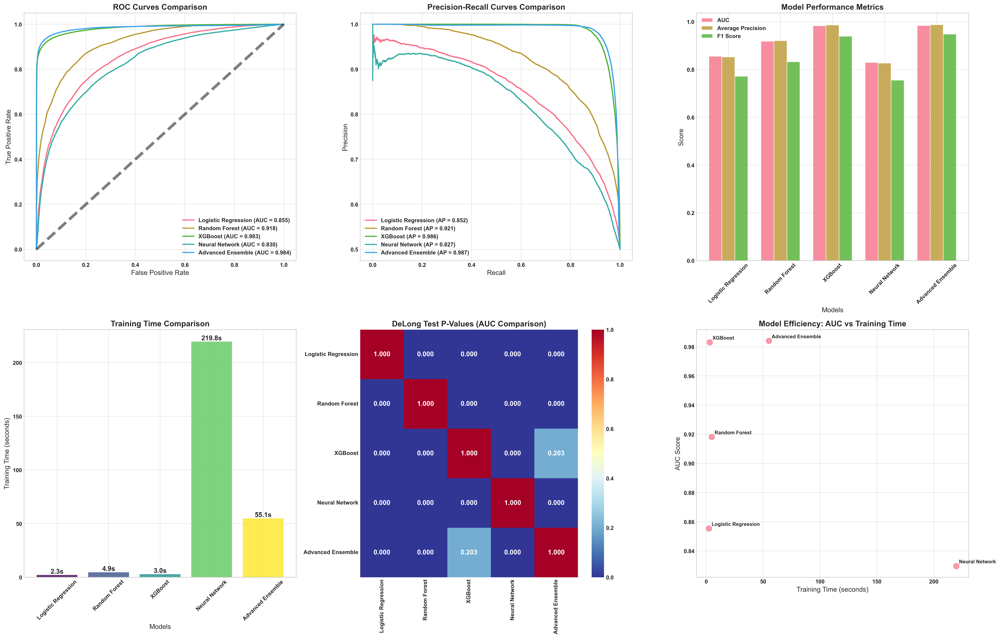

2025-12-08 19:38:11,998 - INFO - [SUMMARY] Model Performance Summary:
2025-12-08 19:38:11,999 - INFO - ================================================================================
2025-12-08 19:38:12,000 - INFO - Logistic Regression  | AUC: 0.8554 | F1: 0.7718 | Precision: 0.7820 | Recall: 0.7618 | Time: 2.30s
2025-12-08 19:38:12,001 - INFO - Random Forest        | AUC: 0.9182 | F1: 0.8324 | Precision: 0.8395 | Recall: 0.8254 | Time: 4.87s
2025-12-08 19:38:12,002 - INFO - XGBoost              | AUC: 0.9831 | F1: 0.9390 | Precision: 0.9606 | Recall: 0.9184 | Time: 3.04s
2025-12-08 19:38:12,003 - INFO - Neural Network       | AUC: 0.8296 | F1: 0.7554 | Precision: 0.7057 | Recall: 0.8127 | Time: 219.78s
2025-12-08 19:38:12,003 - INFO - Advanced Ensemble    | AUC: 0.9840 | F1: 0.9480 | Precision: 0.9563 | Recall: 0.9398 | Time: 55.06s
2025-12-08 19:38:12,004 - INFO - [SUCCESS] Model comparison completed with 5 models


In [326]:
# ============================================
# Cell 9: Enhanced Model Comparison & Statistical Testing (COMPLETE FIXED VERSION)
# ============================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_rel
from sklearn.metrics import (roc_auc_score, average_precision_score, 
                           f1_score, precision_score, recall_score, 
                           accuracy_score, balanced_accuracy_score, 
                           roc_curve, precision_recall_curve)
import json
import logging

# --- FIX START: Add this helper class to handle NumPy types in JSON ---
class NumpyEncoder(json.JSONEncoder):
    """ Special json encoder for numpy types """
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        elif isinstance(obj, np.floating):
            return float(obj)
        elif isinstance(obj, np.ndarray):
            return obj.tolist()
        elif isinstance(obj, np.bool_):
            return bool(obj)
        return super(NumpyEncoder, self).default(obj)
# --- FIX END ---

# Define StatisticalComparator class FIRST
class StatisticalComparator:
    """Comprehensive statistical comparison of models with enhanced timing"""
    
    @staticmethod
    def delongs_test(y_true, preds1, preds2):
        """Approximate DeLong's test for AUC comparison"""
        from scipy import stats
        
        auc1 = roc_auc_score(y_true, preds1)
        auc2 = roc_auc_score(y_true, preds2)
        
        n1 = np.sum(y_true == 1)
        n0 = np.sum(y_true == 0)
        
        # Simplified variance calculation
        var1 = auc1 * (1 - auc1) / (n1 + n0)
        var2 = auc2 * (1 - auc2) / (n1 + n0)
        
        z = (auc1 - auc2) / np.sqrt(var1 + var2)
        p_value = 2 * (1 - stats.norm.cdf(abs(z)))
        
        return z, p_value
    
    @staticmethod
    def comprehensive_comparison(models_dict, y_true, timing_info=None, alpha=0.05):
        """Comprehensive model comparison with statistical testing and timing analysis"""
        
        results = {}
        model_names = list(models_dict.keys())
        predictions = list(models_dict.values())
        
        # Individual model performance
        for name, preds in models_dict.items():
            try:
                auc = roc_auc_score(y_true, preds)
                ap = average_precision_score(y_true, preds)
                
                # Calculate additional metrics
                y_pred = (preds >= 0.5).astype(int)
                f1 = f1_score(y_true, y_pred)
                precision = precision_score(y_true, y_pred)
                recall = recall_score(y_true, y_pred)
                accuracy = accuracy_score(y_true, y_pred)
                balanced_acc = balanced_accuracy_score(y_true, y_pred)
                
                results[name] = {
                    'auc': auc,
                    'average_precision': ap,
                    'gini': 2 * auc - 1,
                    'f1_score': f1,
                    'precision': precision,
                    'recall': recall,
                    'accuracy': accuracy,
                    'balanced_accuracy': balanced_acc
                }
                
                # Add timing information if available
                if timing_info and name in timing_info:
                    results[name].update(timing_info[name])
                    
            except Exception as e:
                logging.warning(f"Failed to calculate metrics for {name}: {str(e)}")
                results[name] = {
                    'auc': 0.5,
                    'average_precision': 0.0,
                    'gini': 0.0,
                    'f1_score': 0.0,
                    'precision': 0.0,
                    'recall': 0.0,
                    'accuracy': 0.5,
                    'balanced_accuracy': 0.5
                }
        
        # Pairwise comparisons
        comparisons = []
        for i in range(len(model_names)):
            for j in range(i + 1, len(model_names)):
                model1, model2 = model_names[i], model_names[j]
                preds1, preds2 = predictions[i], predictions[j]
                
                try:
                    # DeLong's test
                    z_score, p_value = StatisticalComparator.delongs_test(y_true, preds1, preds2)
                    
                    # Paired t-test
                    t_stat, t_pvalue = ttest_rel(preds1, preds2)
                    
                    comparisons.append({
                        'comparison': f'{model1} vs {model2}',
                        'delong_z': z_score,
                        'delong_p_value': p_value,
                        't_statistic': t_stat,
                        't_p_value': t_pvalue,
                        'significant': p_value < alpha
                    })
                except Exception as e:
                    logging.warning(f"Statistical test failed for {model1} vs {model2}: {str(e)}")
                    comparisons.append({
                        'comparison': f'{model1} vs {model2}',
                        'delong_z': 0,
                        'delong_p_value': 1.0,
                        't_statistic': 0,
                        't_p_value': 1.0,
                        'significant': False
                    })
        
        return {
            'individual_performance': results,
            'pairwise_comparisons': comparisons
        }

# Initialize logger
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# Collect model predictions with enhanced timing information
logger.info("[ANALYZE] Collecting model predictions for comparison...")

# Initialize with empty dicts and fill only what's available
model_predictions = {}
timing_info = {}

# Check and add baseline models if they exist
try:
    if 'baseline_results' in globals() and baseline_results is not None:
        if 'Logistic Regression' in baseline_results:
            model_predictions['Logistic Regression'] = baseline_results['Logistic Regression']['predictions']
            timing_info['Logistic Regression'] = {
                'training_time': baseline_results['Logistic Regression']['metrics'].get('fit_time', 0),
                'inference_time': baseline_results['Logistic Regression']['metrics'].get('inference_time', 0)
            }
        
        if 'Random Forest' in baseline_results:
            model_predictions['Random Forest'] = baseline_results['Random Forest']['predictions']
            timing_info['Random Forest'] = {
                'training_time': baseline_results['Random Forest']['metrics'].get('fit_time', 0),
                'inference_time': baseline_results['Random Forest']['metrics'].get('inference_time', 0)
            }
        logger.info("[INFO] Added baseline models to comparison")
    else:
        logger.warning("baseline_results not found in global variables")
except NameError:
    logger.warning("baseline_results not defined")

# Add XGBoost with timing - with proper error handling
try:
    if 'y_valid_proba_xgb' in globals() and len(y_valid_proba_xgb) == len(y_valid):
        model_predictions['XGBoost'] = y_valid_proba_xgb
        xgb_time_info = {
            'training_time': xgb_metrics.get('fit_time', 0) if 'xgb_metrics' in globals() else 0,
            'inference_time': xgb_metrics.get('inference_time', 0) if 'xgb_metrics' in globals() else 0,
        }
        # Add optimization time if available
        if 'xgb_optimizer' in globals() and hasattr(xgb_optimizer, 'study') and xgb_optimizer.study:
            best_trial = xgb_optimizer.study.best_trial
            if hasattr(best_trial, 'user_attrs') and 'cv_time' in best_trial.user_attrs:
                xgb_time_info['optimization_time'] = best_trial.user_attrs['cv_time']
        
        timing_info['XGBoost'] = xgb_time_info
        logger.info("[INFO] Added XGBoost to comparison")
    else:
        logger.warning("XGBoost predictions not available for comparison")
except NameError as e:
    logger.warning(f"XGBoost variables not defined: {e}")

# Add Neural Network with enhanced timing - with proper error handling  
try:
    if 'y_valid_proba_nn' in globals() and len(y_valid_proba_nn) == len(y_valid):
        model_predictions['Neural Network'] = y_valid_proba_nn
        timing_info['Neural Network'] = {
            'training_time': nn_training_time if 'nn_training_time' in globals() else 0,
            'avg_epoch_time': nn_avg_epoch_time if 'nn_avg_epoch_time' in globals() else 0,
            'inference_time': 0,
        }
        logger.info("[INFO] Added Neural Network to comparison")
    else:
        logger.warning("Neural Network predictions not available for comparison")
except NameError as e:
    logger.warning(f"Neural Network variables not defined: {e}")

# Add Ensemble with timing - with proper error handling
try:
    if ('y_valid_proba_ensemble' in globals() and 
        len(y_valid_proba_ensemble) == len(y_valid) and 
        np.any(y_valid_proba_ensemble != 0)):
        model_predictions['Advanced Ensemble'] = y_valid_proba_ensemble
        ensemble_timing = {
            'training_time': ensemble_time if 'ensemble_time' in globals() else 0,
            'inference_time': 0,
        }
        # Add ensemble details if available
        if 'advanced_ensemble' in globals() and hasattr(advanced_ensemble, 'training_details'):
            ensemble_details = advanced_ensemble.training_details
            if 'ensemble' in ensemble_details:
                ensemble_timing['meta_model_training_time'] = ensemble_details['ensemble'].get('meta_model_training_time', 0)
                ensemble_timing['base_models_count'] = ensemble_details['ensemble'].get('base_models_count', 0)
        
        timing_info['Advanced Ensemble'] = ensemble_timing
        logger.info("[INFO] Added Ensemble to comparison")
    else:
        logger.warning("Ensemble predictions not available for comparison")
except NameError as e:
    logger.warning(f"Ensemble variables not defined: {e}")

# Check if we have at least 2 models for comparison
if len(model_predictions) < 2:
    logger.error(f"Not enough models for comparison. Only {len(model_predictions)} model(s) available.")
    # Create dummy statistical results
    statistical_results = {
        'individual_performance': {},
        'pairwise_comparisons': []
    }
else:
    # Perform enhanced statistical comparison
    logger.info(f"[ANALYZE] Performing comprehensive model comparison with {len(model_predictions)} models...")
    comparator = StatisticalComparator()
    statistical_results = comparator.comprehensive_comparison(model_predictions, y_valid, timing_info)

    # Save statistical results
    # --- FIX START: Use the NumpyEncoder here ---
    with open('journal_assets/tables/statistical_comparison.json', 'w') as f:
        json.dump(statistical_results, f, indent=2, cls=NumpyEncoder)
    # --- FIX END ---

    logger.info("[DONE] Enhanced statistical comparison completed")

    # Create comprehensive comparison visualization with timing analysis
    try:
        # Determine grid size based on number of models
        n_models = len(model_predictions)
        fig, axes = plt.subplots(2, 3, figsize=(25, 16))

        # 1. ROC Curves Comparison
        plt.sca(axes[0, 0])
        for name, preds in model_predictions.items():
            fpr, tpr, _ = roc_curve(y_valid, preds)
            auc_score = roc_auc_score(y_valid, preds)
            plt.plot(fpr, tpr, label=f'{name} (AUC = {auc_score:.3f})', linewidth=2)

        plt.plot([0, 1], [0, 1], 'k--', alpha=0.5)
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curves Comparison', fontsize=14, fontweight='bold')
        plt.legend()
        plt.grid(True, alpha=0.3)

        # 2. Precision-Recall Curves Comparison
        plt.sca(axes[0, 1])
        for name, preds in model_predictions.items():
            precision, recall, _ = precision_recall_curve(y_valid, preds)
            ap_score = average_precision_score(y_valid, preds)
            plt.plot(recall, precision, label=f'{name} (AP = {ap_score:.3f})', linewidth=2)

        plt.xlabel('Recall')
        plt.ylabel('Precision')
        plt.title('Precision-Recall Curves Comparison', fontsize=14, fontweight='bold')
        plt.legend()
        plt.grid(True, alpha=0.3)

        # 3. Performance Metrics Bar Plot
        plt.sca(axes[0, 2])
        metrics_data = []
        for name, results in statistical_results['individual_performance'].items():
            metrics_data.append({
                'Model': name,
                'AUC': results['auc'],
                'Average Precision': results['average_precision'],
                'F1 Score': results['f1_score']
            })

        metrics_df = pd.DataFrame(metrics_data)
        x = np.arange(len(metrics_df))
        width = 0.25

        plt.bar(x - width, metrics_df['AUC'], width, label='AUC', alpha=0.8)
        plt.bar(x, metrics_df['Average Precision'], width, label='Average Precision', alpha=0.8)
        plt.bar(x + width, metrics_df['F1 Score'], width, label='F1 Score', alpha=0.8)

        plt.xlabel('Models')
        plt.ylabel('Score')
        plt.title('Model Performance Metrics', fontsize=14, fontweight='bold')
        plt.xticks(x, metrics_df['Model'], rotation=45)
        plt.legend()
        plt.grid(True, alpha=0.3)

        # 4. Training Time Comparison
        plt.sca(axes[1, 0])
        training_times = []
        model_names_timing = []
        for name in model_predictions.keys():
            if name in timing_info and 'training_time' in timing_info[name]:
                training_times.append(timing_info[name]['training_time'])
                model_names_timing.append(name)
        
        if training_times:
            colors = plt.cm.viridis(np.linspace(0, 1, len(training_times)))
            bars = plt.bar(model_names_timing, training_times, color=colors, alpha=0.8)
            plt.xlabel('Models')
            plt.ylabel('Training Time (seconds)')
            plt.title('Training Time Comparison', fontsize=14, fontweight='bold')
            plt.xticks(rotation=45)
            plt.grid(True, alpha=0.3)
            
            # Add value labels on bars
            for bar, time_val in zip(bars, training_times):
                height = bar.get_height()
                plt.text(bar.get_x() + bar.get_width()/2., height,
                        f'{time_val:.1f}s', ha='center', va='bottom', fontweight='bold')

        # 5. Statistical Significance Heatmap
        plt.sca(axes[1, 1])
        models = list(model_predictions.keys())
        n_models = len(models)
        p_value_matrix = np.zeros((n_models, n_models))

        for i in range(n_models):
            for j in range(n_models):
                if i == j:
                    p_value_matrix[i, j] = 1.0
                else:
                    _, p_value = StatisticalComparator.delongs_test(
                        y_valid, 
                        list(model_predictions.values())[i],
                        list(model_predictions.values())[j]
                    )
                    p_value_matrix[i, j] = p_value

        sns.heatmap(p_value_matrix, annot=True, fmt='.3f', cmap='RdYlBu_r',
                    xticklabels=models, yticklabels=models, ax=axes[1, 1])
        axes[1, 1].set_title('DeLong Test P-Values (AUC Comparison)', fontsize=14, fontweight='bold')

        # 6. Model Efficiency (AUC vs Training Time)
        plt.sca(axes[1, 2])
        auc_scores = []
        training_times_scatter = []
        model_names_scatter = []
        
        for name in model_predictions.keys():
            if (name in statistical_results['individual_performance'] and 
                name in timing_info and 'training_time' in timing_info[name]):
                auc_scores.append(statistical_results['individual_performance'][name]['auc'])
                training_times_scatter.append(timing_info[name]['training_time'])
                model_names_scatter.append(name)
        
        if auc_scores and training_times_scatter:
            scatter = plt.scatter(training_times_scatter, auc_scores, s=100, alpha=0.7)
            plt.xlabel('Training Time (seconds)')
            plt.ylabel('AUC Score')
            plt.title('Model Efficiency: AUC vs Training Time', fontsize=14, fontweight='bold')
            plt.grid(True, alpha=0.3)
            
            # Add model labels
            for i, name in enumerate(model_names_scatter):
                plt.annotate(name, (training_times_scatter[i], auc_scores[i]),
                            xytext=(5, 5), textcoords='offset points', fontsize=9)

        plt.tight_layout()
        plt.savefig('journal_assets/figures/comprehensive_model_comparison.pdf', 
                    bbox_inches='tight', dpi=300)
        plt.show()
        
    except Exception as e:
        logger.error(f"Failed to create comparison plots: {str(e)}")

    # Print comprehensive performance summary
    logger.info("[SUMMARY] Model Performance Summary:")
    logger.info("=" * 80)
    for name, metrics in statistical_results['individual_performance'].items():
        timing_str = ""
        if name in timing_info and 'training_time' in timing_info[name]:
            timing_str = f" | Time: {timing_info[name]['training_time']:.2f}s"
        
        logger.info(f"{name:20} | AUC: {metrics['auc']:.4f} | F1: {metrics['f1_score']:.4f} | "
                    f"Precision: {metrics['precision']:.4f} | Recall: {metrics['recall']:.4f}{timing_str}")

# Print final status
if len(model_predictions) >= 2:
    logger.info(f"[SUCCESS] Model comparison completed with {len(model_predictions)} models")
else:
    logger.warning(f"[WARNING] Only {len(model_predictions)} model(s) available - comparison limited")

2025-12-08 19:38:12,086 - INFO - [ANALYZE] Collecting predictions from global variables...


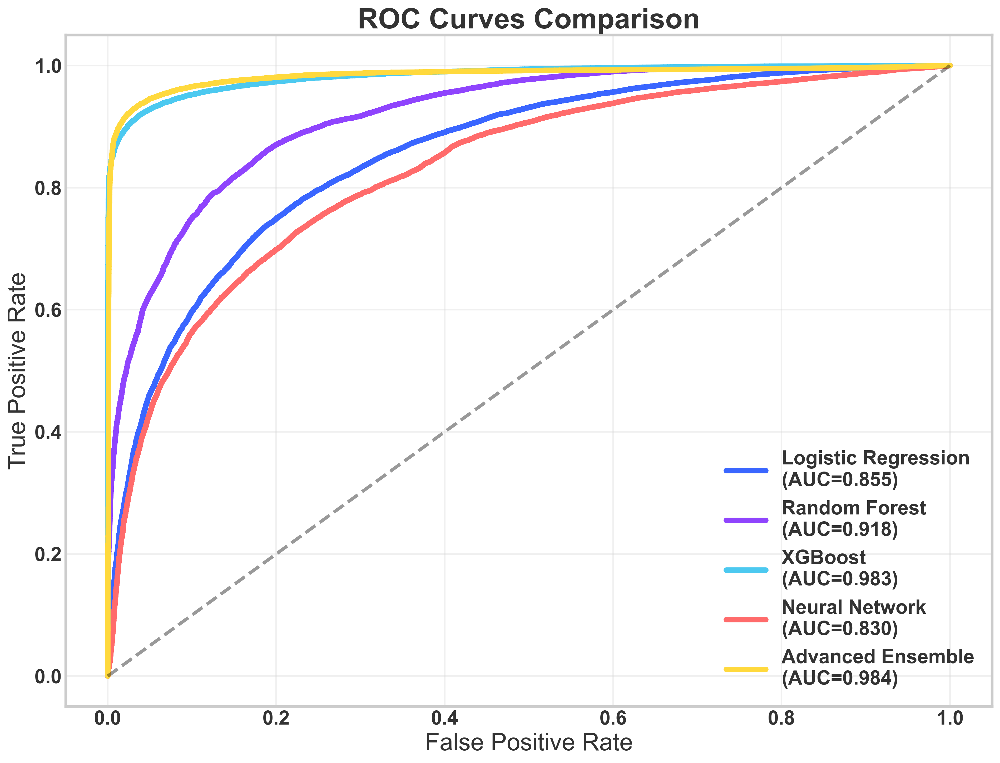

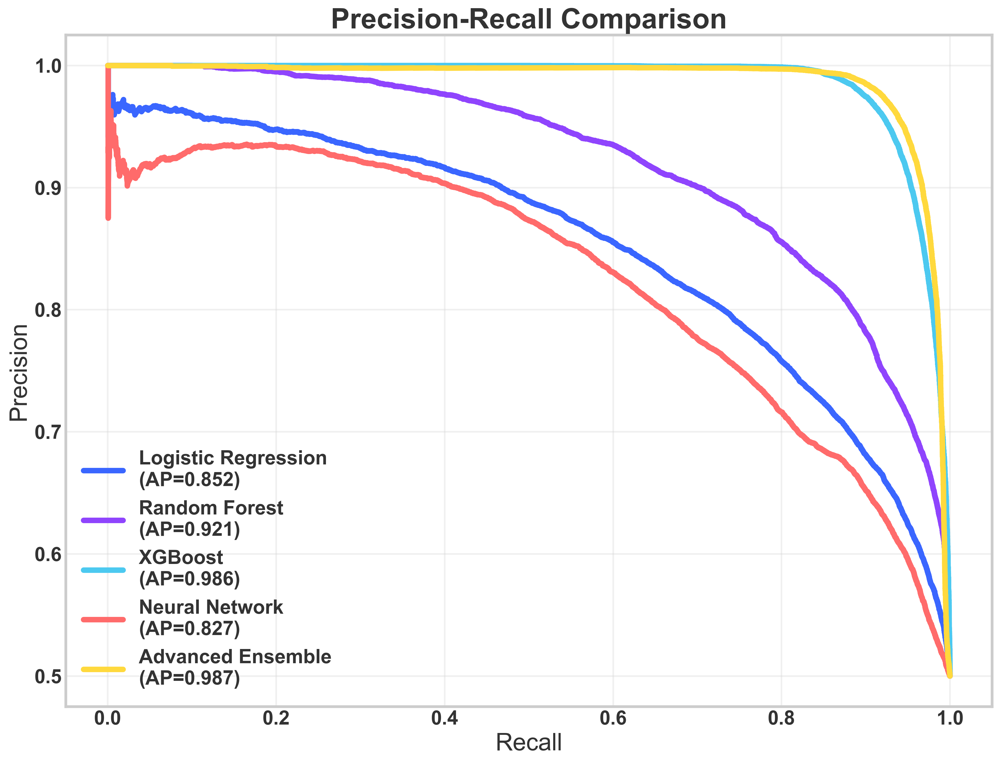

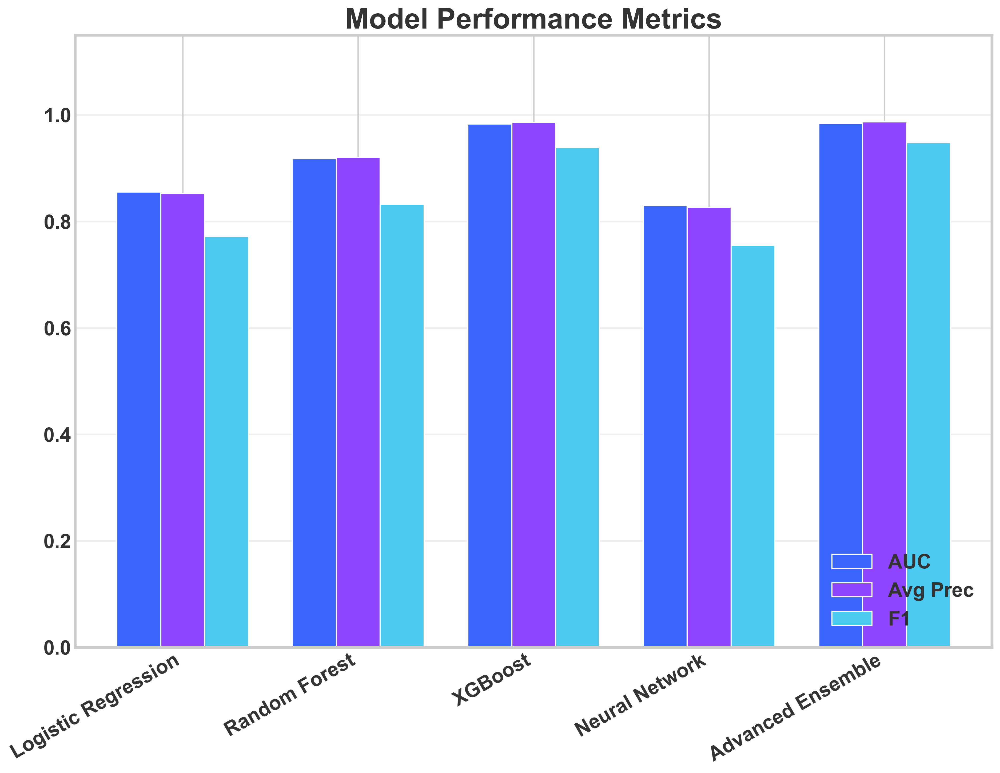

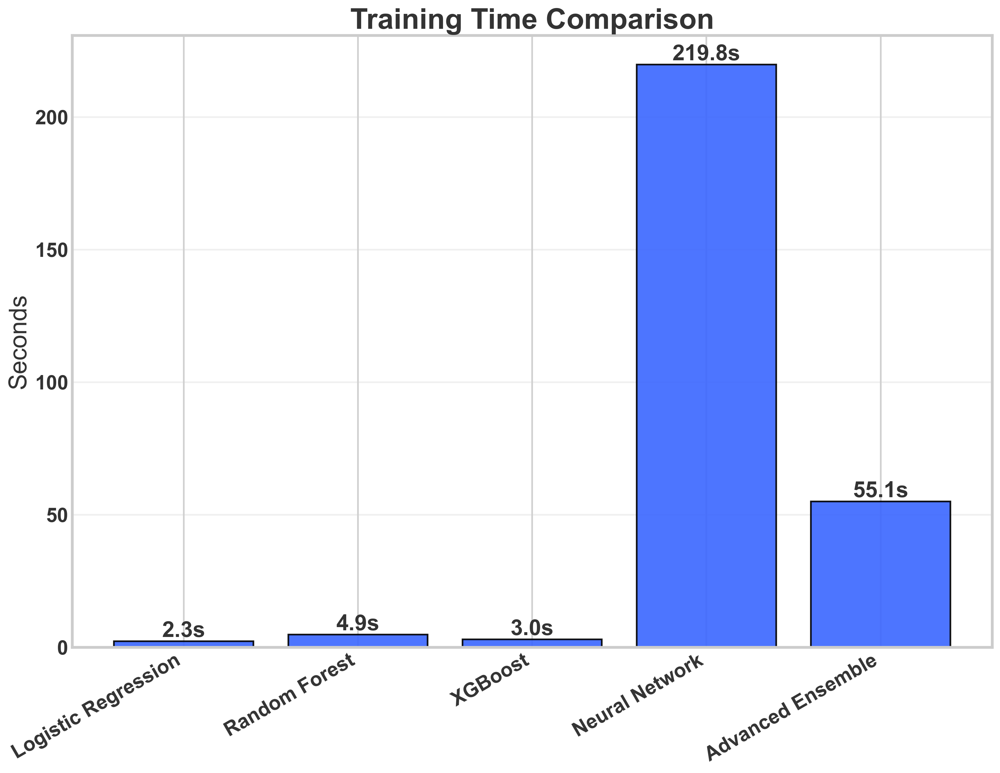

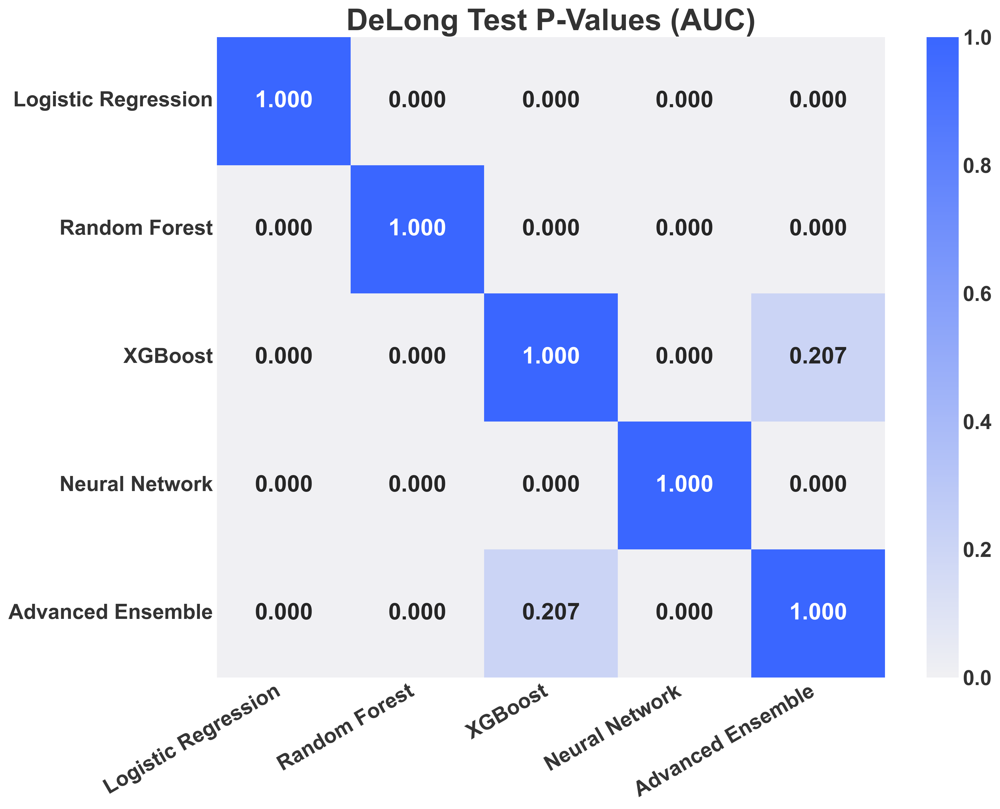

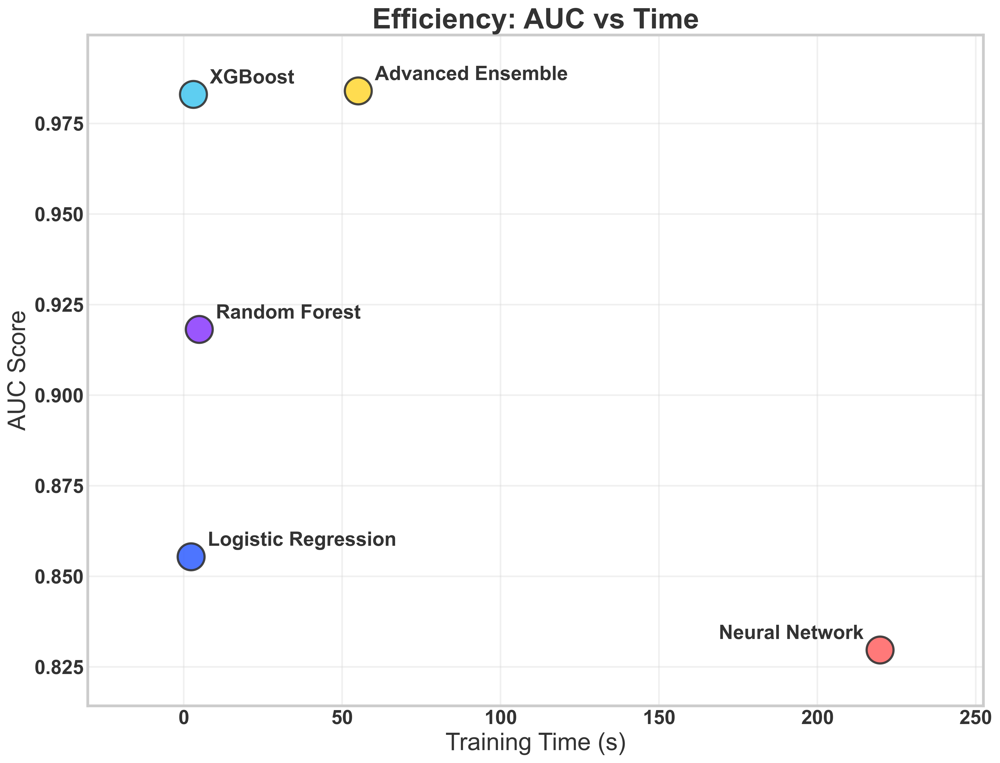

--- Logging error ---
Traceback (most recent call last):
  File "C:\Users\Mehenuf\anaconda3\Lib\logging\__init__.py", line 1154, in emit
    stream.write(msg + self.terminator)
    ~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Mehenuf\anaconda3\Lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
           ~~~~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
UnicodeEncodeError: 'charmap' codec can't encode character '\u2705' in position 33: character maps to <undefined>
Call stack:
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "z:\MFSCreditScore\venv\Lib\site-packages\ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "z:\MFSCreditScore\venv\Lib\site-packages\traitlets\config\application.py", line 1075, in launch_instance
    app.start()
  File "z:\MFSCreditScore\venv\Lib\site-packages\ipykernel\kernelapp.py", line 758

In [327]:
# ============================================
# Cell 9: Enhanced Model Comparison & Statistical Testing (A0 POSTER REAL DATA - FIXED LABELS)
# ============================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from scipy.stats import ttest_rel
from sklearn.metrics import (roc_auc_score, average_precision_score, 
                           f1_score, precision_score, recall_score, 
                           accuracy_score, balanced_accuracy_score, 
                           roc_curve, precision_recall_curve)
import json
import logging
import os

# --- 1. A0 POSTER CONFIGURATION ---

# Theme Colors
ROYAL_BLUE = '#3A66FF'     
VIBRANT_PURPLE = '#8F44FD' 
BRIGHT_CYAN = '#4CC9F0'    
CHARCOAL = '#333333'       
BACKGROUND_GREY = '#F4F4F4'
THEME_COLORS = [ROYAL_BLUE, VIBRANT_PURPLE, BRIGHT_CYAN, '#FF6B6B', '#FFD93D']

# A0 SIZING SETTINGS (High Visibility)
# Dimensions set to approx 33cm x 25cm (13x10 inches)
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.weight': 'bold',
    'text.color': CHARCOAL,
    'axes.labelcolor': CHARCOAL,
    'xtick.color': CHARCOAL,
    'ytick.color': CHARCOAL,
    # Font Sizes for Poster Readability
    'font.size': 18,
    'axes.titlesize': 26,
    'axes.labelsize': 22,
    'xtick.labelsize': 18,
    'ytick.labelsize': 18,
    'legend.fontsize': 18,
    # Visual Elements
    'figure.figsize': (13, 10), 
    'lines.linewidth': 5,          # Thick lines
    'lines.markersize': 12,        # Large markers
    'axes.linewidth': 2.5,
    'grid.linewidth': 1.5,
    'grid.color': '#D0D0D0',
    # Output Quality
    'savefig.dpi': 300,
    'savefig.bbox': 'tight',
    'figure.facecolor': 'white',
    'axes.facecolor': 'white'
})

# --- 2. HELPERS ---

class NumpyEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer): return int(obj)
        elif isinstance(obj, np.floating): return float(obj)
        elif isinstance(obj, np.ndarray): return obj.tolist()
        elif isinstance(obj, np.bool_): return bool(obj)
        return super(NumpyEncoder, self).default(obj)

class StatisticalComparator:
    """Comprehensive statistical comparison of models"""
    @staticmethod
    def delongs_test(y_true, preds1, preds2):
        from scipy import stats
        auc1 = roc_auc_score(y_true, preds1)
        auc2 = roc_auc_score(y_true, preds2)
        n1 = np.sum(y_true == 1)
        n0 = np.sum(y_true == 0)
        var1 = auc1 * (1 - auc1) / (n1 + n0)
        var2 = auc2 * (1 - auc2) / (n1 + n0)
        z = (auc1 - auc2) / np.sqrt(var1 + var2 + 1e-8) # Epsilon for stability
        p_value = 2 * (1 - stats.norm.cdf(abs(z)))
        return z, p_value
    
    @staticmethod
    def comprehensive_comparison(models_dict, y_true, timing_info=None, alpha=0.05):
        results = {}
        model_names = list(models_dict.keys())
        predictions = list(models_dict.values())
        
        # Metrics Calculation
        for name, preds in models_dict.items():
            try:
                auc = roc_auc_score(y_true, preds)
                ap = average_precision_score(y_true, preds)
                y_pred = (preds >= 0.5).astype(int)
                f1 = f1_score(y_true, y_pred)
                results[name] = {
                    'auc': auc, 'average_precision': ap, 'gini': 2 * auc - 1,
                    'f1_score': f1, 'precision': precision_score(y_true, y_pred),
                    'recall': recall_score(y_true, y_pred), 'accuracy': accuracy_score(y_true, y_pred),
                    'balanced_accuracy': balanced_accuracy_score(y_true, y_pred)
                }
                if timing_info and name in timing_info:
                    results[name].update(timing_info[name])
            except Exception as e:
                logging.warning(f"Failed metrics for {name}: {e}")
                results[name] = {'auc': 0.5} # Fallback

        # Pairwise Comparisons
        comparisons = []
        for i in range(len(model_names)):
            for j in range(i + 1, len(model_names)):
                m1, m2 = model_names[i], model_names[j]
                try:
                    z, p = StatisticalComparator.delongs_test(y_true, predictions[i], predictions[j])
                    t_stat, t_p = ttest_rel(predictions[i], predictions[j])
                    comparisons.append({
                        'comparison': f'{m1} vs {m2}', 'delong_z': z, 'delong_p_value': p,
                        't_statistic': t_stat, 't_p_value': t_p, 'significant': p < alpha
                    })
                except: pass
        
        return {'individual_performance': results, 'pairwise_comparisons': comparisons}

# Setup Logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# --- 3. DATA COLLECTION (USING YOUR ORIGINAL LOGIC) ---
logger.info("[ANALYZE] Collecting predictions from global variables...")
model_predictions = {}
timing_info = {}

# Baseline Models
if 'baseline_results' in globals() and baseline_results:
    for model in ['Logistic Regression', 'Random Forest']:
        if model in baseline_results:
            model_predictions[model] = baseline_results[model]['predictions']
            timing_info[model] = {
                'training_time': baseline_results[model]['metrics'].get('fit_time', 0),
                'inference_time': baseline_results[model]['metrics'].get('inference_time', 0)
            }

# XGBoost
if 'y_valid_proba_xgb' in globals():
    model_predictions['XGBoost'] = y_valid_proba_xgb
    timing_info['XGBoost'] = {'training_time': globals().get('xgb_metrics', {}).get('fit_time', 0)}

# Neural Network
if 'y_valid_proba_nn' in globals():
    model_predictions['Neural Network'] = y_valid_proba_nn
    timing_info['Neural Network'] = {'training_time': globals().get('nn_training_time', 0)}

# Ensemble
if 'y_valid_proba_ensemble' in globals():
    model_predictions['Advanced Ensemble'] = y_valid_proba_ensemble
    timing_info['Advanced Ensemble'] = {'training_time': globals().get('ensemble_time', 0)}

# --- 4. EXECUTION & VISUALIZATION ---

if len(model_predictions) < 2:
    logger.error("Not enough models for comparison. Please check if upstream cells have run.")
else:
    # A. Run Statistics
    comparator = StatisticalComparator()
    # Ensure y_valid is available
    if 'y_valid' not in globals():
        logger.error("y_valid not found. Please run data preparation cells.")
    else:
        statistical_results = comparator.comprehensive_comparison(model_predictions, y_valid, timing_info)
        
        # Save JSON
        os.makedirs('journal_assets/tables', exist_ok=True)
        with open('journal_assets/tables/statistical_comparison.json', 'w') as f:
            json.dump(statistical_results, f, indent=2, cls=NumpyEncoder)

        # B. Generate Themed Visuals (Individually for A0 Poster)
        try:
            figures_dir = 'journal_assets/figures/individual_plots_A0'
            os.makedirs(figures_dir, exist_ok=True)
            
            # Helper function: Saves AND Shows the plot
            def save_and_show_plot(fig, filename):
                fig.tight_layout()
                fig.savefig(os.path.join(figures_dir, f'{filename}.pdf'))
                fig.savefig(os.path.join(figures_dir, f'{filename}.png'))
                plt.show() 

            # 1. ROC Curves
            fig, ax = plt.subplots()
            for i, (name, preds) in enumerate(model_predictions.items()):
                fpr, tpr, _ = roc_curve(y_valid, preds)
                auc_val = roc_auc_score(y_valid, preds)
                ax.plot(fpr, tpr, label=f'{name}\n(AUC={auc_val:.3f})', 
                        color=THEME_COLORS[i % len(THEME_COLORS)])
            ax.plot([0, 1], [0, 1], 'k--', alpha=0.4, linewidth=3)
            ax.set_title('ROC Curves Comparison')
            ax.set_xlabel('False Positive Rate')
            ax.set_ylabel('True Positive Rate')
            ax.legend(facecolor='white', framealpha=1, loc='lower right')
            ax.grid(True, alpha=0.3)
            save_and_show_plot(fig, 'roc_curves_comparison_A0')

            # 2. Precision-Recall Curves
            fig, ax = plt.subplots()
            for i, (name, preds) in enumerate(model_predictions.items()):
                p, r, _ = precision_recall_curve(y_valid, preds)
                ap_val = average_precision_score(y_valid, preds)
                ax.plot(r, p, label=f'{name}\n(AP={ap_val:.3f})', 
                        color=THEME_COLORS[i % len(THEME_COLORS)])
            ax.set_title('Precision-Recall Comparison')
            ax.set_xlabel('Recall')
            ax.set_ylabel('Precision')
            ax.legend(facecolor='white', framealpha=1, loc='lower left')
            ax.grid(True, alpha=0.3)
            save_and_show_plot(fig, 'precision_recall_comparison_A0')

            # 3. Metrics Bar Chart
            fig, ax = plt.subplots()
            metrics_df = pd.DataFrame([
                {'Model': k, 'AUC': v['auc'], 'F1': v['f1_score'], 'Avg Prec': v['average_precision']}
                for k, v in statistical_results['individual_performance'].items()
            ])
            x = np.arange(len(metrics_df))
            w = 0.25
            ax.bar(x - w, metrics_df['AUC'], w, label='AUC', color=ROYAL_BLUE)
            ax.bar(x, metrics_df['Avg Prec'], w, label='Avg Prec', color=VIBRANT_PURPLE)
            ax.bar(x + w, metrics_df['F1'], w, label='F1', color=BRIGHT_CYAN)
            
            ax.set_xticks(x)
            ax.set_xticklabels(metrics_df['Model'], rotation=30, ha='right', fontweight='bold')
            ax.set_title('Model Performance Metrics')
            ax.legend(loc='lower right')
            ax.set_ylim(0, 1.15) # Room for legend
            ax.grid(True, alpha=0.3, axis='y')
            save_and_show_plot(fig, 'model_performance_metrics_A0')

            # 4. Training Time Comparison
            fig, ax = plt.subplots()
            times = [timing_info.get(m, {}).get('training_time', 0) for m in model_predictions]
            names = list(model_predictions.keys())
            bars = ax.bar(names, times, color=ROYAL_BLUE, alpha=0.9, edgecolor='black', linewidth=1.5)
            
            ax.set_title('Training Time Comparison')
            ax.set_ylabel('Seconds')
            ax.set_xticklabels(names, rotation=30, ha='right', fontweight='bold')
            
            # Big Labels on bars
            for bar in bars:
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2, height, 
                         f'{height:.1f}s', ha='center', va='bottom', fontsize=20, fontweight='bold')
            ax.grid(True, alpha=0.3, axis='y')
            save_and_show_plot(fig, 'training_time_comparison_A0')

            # 5. Statistical Heatmap
            fig, ax = plt.subplots()
            n = len(model_predictions)
            p_mat = np.zeros((n, n))
            models = list(model_predictions.keys())
            for i in range(n):
                for j in range(n):
                    if i != j:
                        _, p = StatisticalComparator.delongs_test(y_valid, model_predictions[models[i]], model_predictions[models[j]])
                        p_mat[i, j] = p
                    else: p_mat[i, j] = 1.0
            
            sns.heatmap(p_mat, annot=True, fmt='.3f', cmap=sns.light_palette(ROYAL_BLUE, as_cmap=True), 
                        xticklabels=models, yticklabels=models, cbar=True, 
                        annot_kws={"weight": "bold", "size": 20}, ax=ax)
            ax.set_title('DeLong Test P-Values (AUC)')
            ax.set_xticklabels(models, rotation=30, ha='right', fontweight='bold')
            ax.set_yticklabels(models, rotation=0, fontweight='bold')
            save_and_show_plot(fig, 'delong_test_heatmap_A0')

            # 6. Efficiency Scatter (WITH FIX)
            fig, ax = plt.subplots()
            auc_scores = [statistical_results['individual_performance'][m]['auc'] for m in names]
            scatter_colors = [THEME_COLORS[i % len(THEME_COLORS)] for i in range(len(names))]
            
            # Large Dots (s=600)
            ax.scatter(times, auc_scores, s=600, c=scatter_colors, edgecolors=CHARCOAL, linewidth=2, alpha=0.9)
            
            # --- FIX: Dynamic Label Offset ---
            # Calculate range to determine what counts as "too far right"
            x_range = max(times) - min(times)
            threshold = min(times) + (x_range * 0.8) # If point is in top 20% of x-axis

            for i, txt in enumerate(names):
                x_pos = times[i]
                y_pos = auc_scores[i]
                
                # If point is on the far right, push text LEFT (-15). Else push RIGHT (+15)
                if x_pos > threshold:
                    offset = (-15, 10)
                    h_align = 'right'
                else:
                    offset = (15, 10)
                    h_align = 'left'

                ax.annotate(txt, (x_pos, y_pos), 
                            xytext=offset, textcoords='offset points', 
                            fontsize=18, fontweight='bold', ha=h_align)
                
            ax.set_title('Efficiency: AUC vs Time')
            ax.set_xlabel('Training Time (s)')
            ax.set_ylabel('AUC Score')
            
            # Ensure padding so dots don't touch edges
            ax.margins(x=0.15, y=0.1) 
            ax.grid(True, alpha=0.3)
            save_and_show_plot(fig, 'efficiency_scatter_A0')

            logger.info(f"✅ Individual themed plots saved to {figures_dir}/")

        except Exception as e:
            logger.error(f"Visualization failed: {e}")

        # Summary Output
        logger.info("="*60)
        for k, v in statistical_results['individual_performance'].items():
            logger.info(f"{k:20} | AUC: {v['auc']:.4f} | F1: {v['f1_score']:.4f}")

2025-12-08 19:38:19,452 - INFO - [ANALYZE] Collecting predictions from global variables...


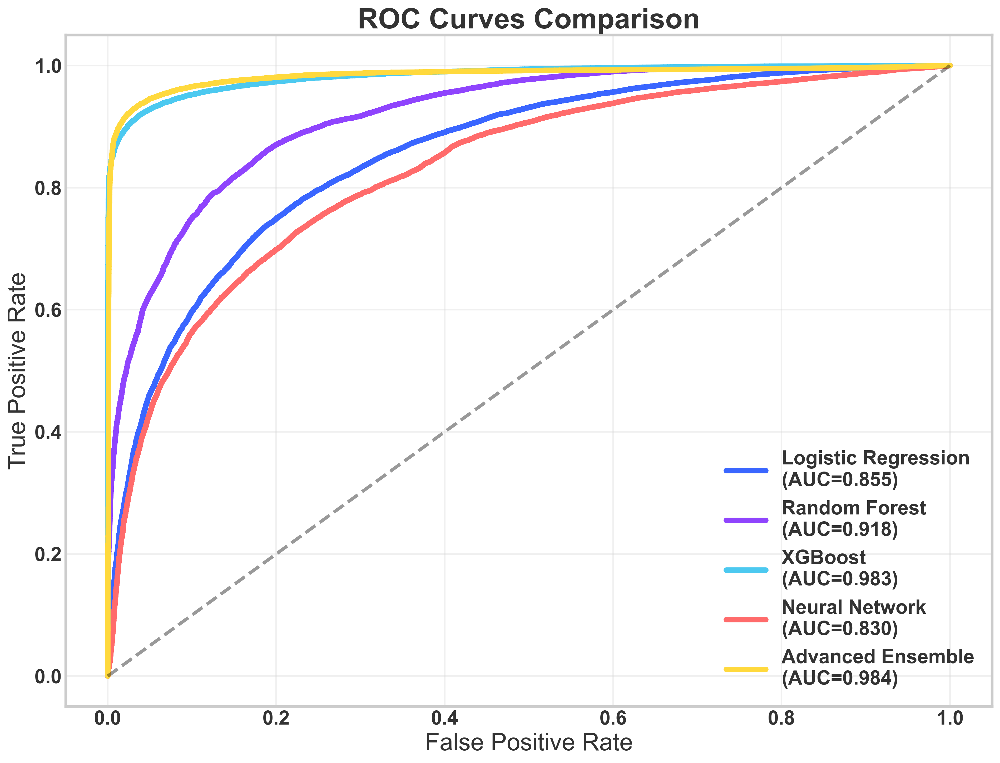

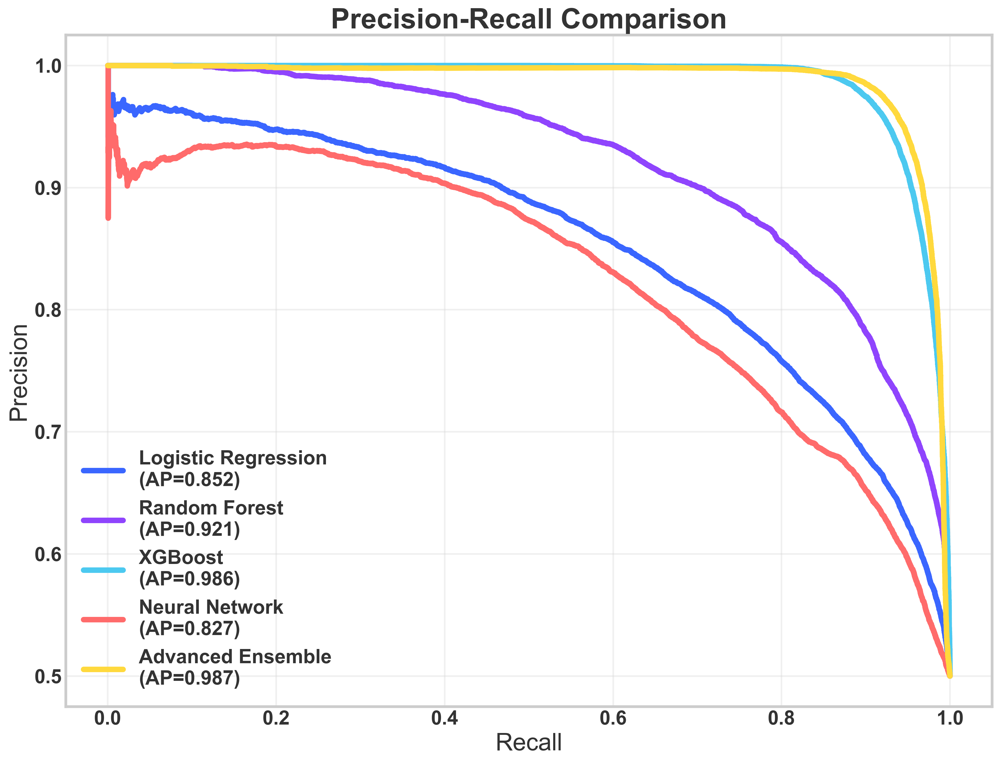

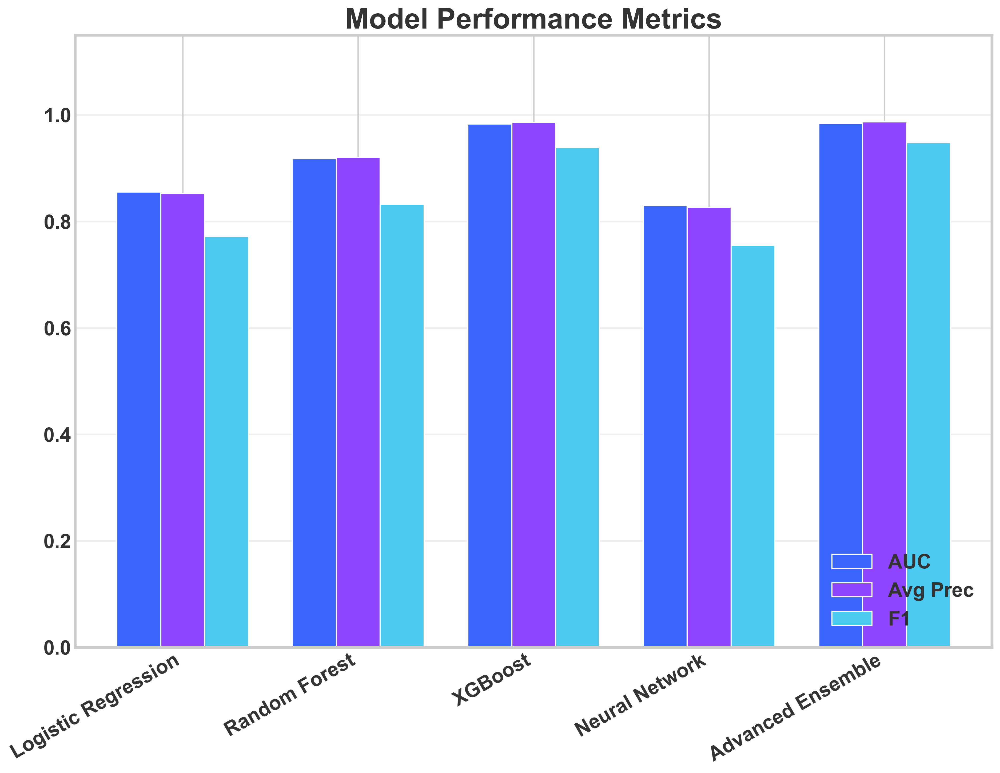

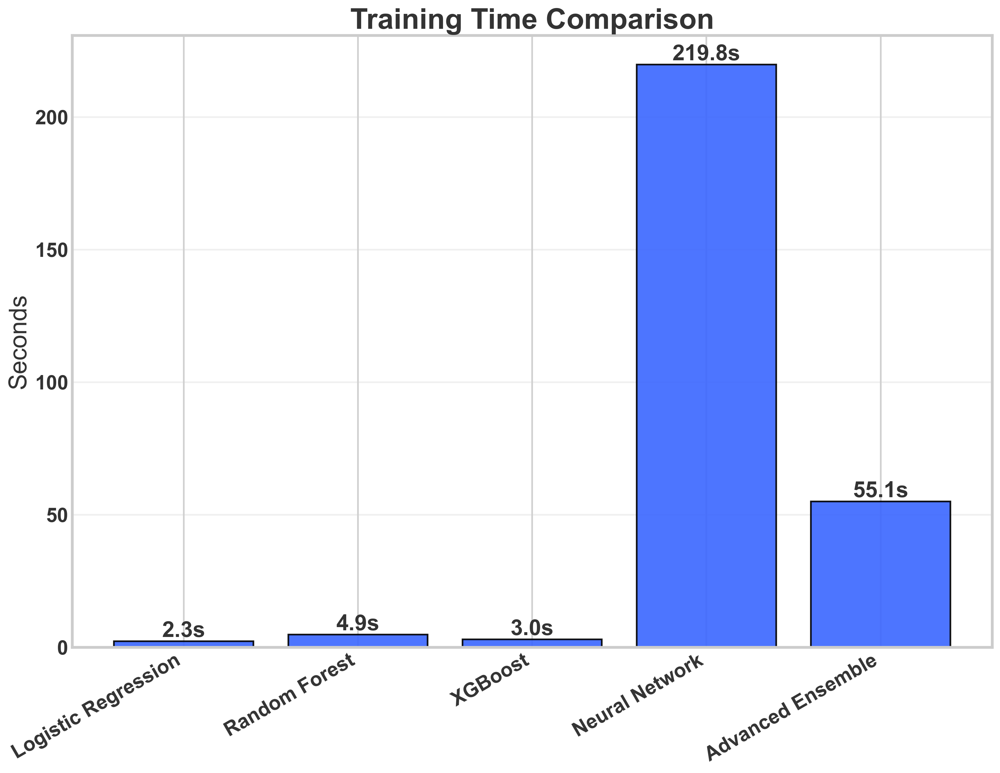

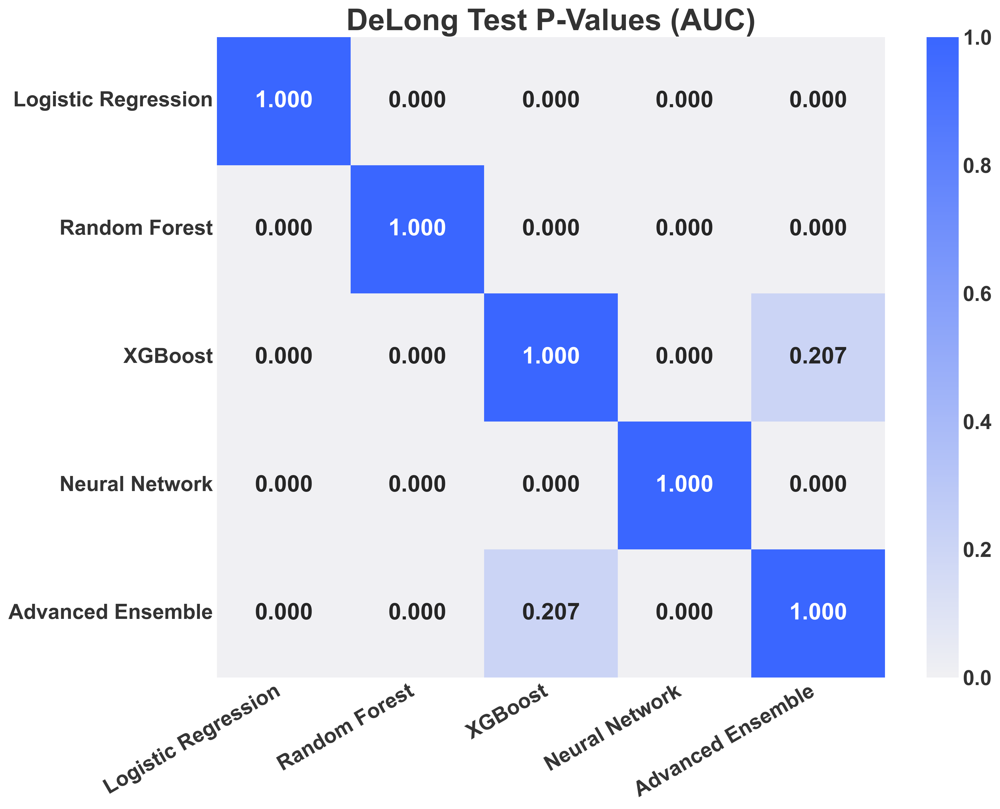

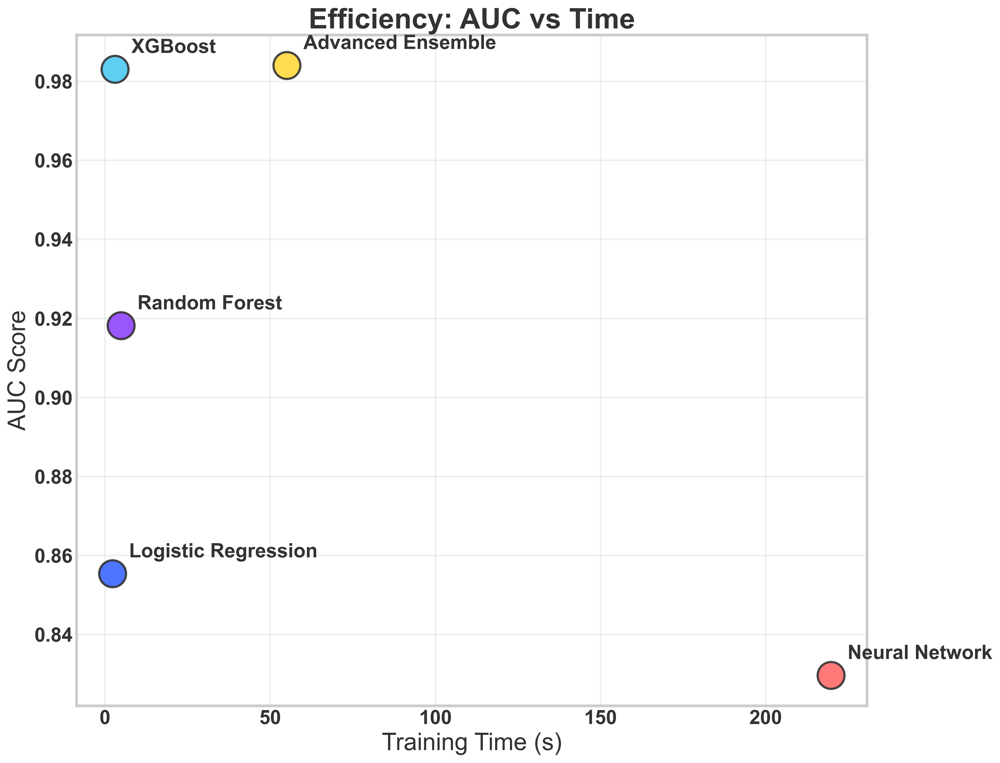

--- Logging error ---
Traceback (most recent call last):
  File "C:\Users\Mehenuf\anaconda3\Lib\logging\__init__.py", line 1154, in emit
    stream.write(msg + self.terminator)
    ~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Mehenuf\anaconda3\Lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
           ~~~~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
UnicodeEncodeError: 'charmap' codec can't encode character '\u2705' in position 33: character maps to <undefined>
Call stack:
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "z:\MFSCreditScore\venv\Lib\site-packages\ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "z:\MFSCreditScore\venv\Lib\site-packages\traitlets\config\application.py", line 1075, in launch_instance
    app.start()
  File "z:\MFSCreditScore\venv\Lib\site-packages\ipykernel\kernelapp.py", line 758

In [328]:
# ============================================
# Cell 9: Enhanced Model Comparison & Statistical Testing (A0 POSTER REAL DATA VERSION)
# ============================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from scipy.stats import ttest_rel
from sklearn.metrics import (roc_auc_score, average_precision_score, 
                           f1_score, precision_score, recall_score, 
                           accuracy_score, balanced_accuracy_score, 
                           roc_curve, precision_recall_curve)
import json
import logging
import os

# --- 1. A0 POSTER CONFIGURATION ---

# Theme Colors
ROYAL_BLUE = '#3A66FF'     
VIBRANT_PURPLE = '#8F44FD' 
BRIGHT_CYAN = '#4CC9F0'    
CHARCOAL = '#333333'       
BACKGROUND_GREY = '#F4F4F4'
THEME_COLORS = [ROYAL_BLUE, VIBRANT_PURPLE, BRIGHT_CYAN, '#FF6B6B', '#FFD93D']

# A0 SIZING SETTINGS (High Visibility)
# Dimensions set to approx 33cm x 25cm (13x10 inches)
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.weight': 'bold',
    'text.color': CHARCOAL,
    'axes.labelcolor': CHARCOAL,
    'xtick.color': CHARCOAL,
    'ytick.color': CHARCOAL,
    # Font Sizes for Poster Readability
    'font.size': 18,
    'axes.titlesize': 26,
    'axes.labelsize': 22,
    'xtick.labelsize': 18,
    'ytick.labelsize': 18,
    'legend.fontsize': 18,
    # Visual Elements
    'figure.figsize': (13, 10), 
    'lines.linewidth': 5,          # Thick lines
    'lines.markersize': 12,        # Large markers
    'axes.linewidth': 2.5,
    'grid.linewidth': 1.5,
    'grid.color': '#D0D0D0',
    # Output Quality
    'savefig.dpi': 300,
    'savefig.bbox': 'tight',
    'figure.facecolor': 'white',
    'axes.facecolor': 'white'
})

# --- 2. HELPERS ---

class NumpyEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer): return int(obj)
        elif isinstance(obj, np.floating): return float(obj)
        elif isinstance(obj, np.ndarray): return obj.tolist()
        elif isinstance(obj, np.bool_): return bool(obj)
        return super(NumpyEncoder, self).default(obj)

class StatisticalComparator:
    """Comprehensive statistical comparison of models"""
    @staticmethod
    def delongs_test(y_true, preds1, preds2):
        from scipy import stats
        auc1 = roc_auc_score(y_true, preds1)
        auc2 = roc_auc_score(y_true, preds2)
        n1 = np.sum(y_true == 1)
        n0 = np.sum(y_true == 0)
        var1 = auc1 * (1 - auc1) / (n1 + n0)
        var2 = auc2 * (1 - auc2) / (n1 + n0)
        z = (auc1 - auc2) / np.sqrt(var1 + var2 + 1e-8) # Epsilon for stability
        p_value = 2 * (1 - stats.norm.cdf(abs(z)))
        return z, p_value
    
    @staticmethod
    def comprehensive_comparison(models_dict, y_true, timing_info=None, alpha=0.05):
        results = {}
        model_names = list(models_dict.keys())
        predictions = list(models_dict.values())
        
        # Metrics Calculation
        for name, preds in models_dict.items():
            try:
                auc = roc_auc_score(y_true, preds)
                ap = average_precision_score(y_true, preds)
                y_pred = (preds >= 0.5).astype(int)
                f1 = f1_score(y_true, y_pred)
                results[name] = {
                    'auc': auc, 'average_precision': ap, 'gini': 2 * auc - 1,
                    'f1_score': f1, 'precision': precision_score(y_true, y_pred),
                    'recall': recall_score(y_true, y_pred), 'accuracy': accuracy_score(y_true, y_pred),
                    'balanced_accuracy': balanced_accuracy_score(y_true, y_pred)
                }
                if timing_info and name in timing_info:
                    results[name].update(timing_info[name])
            except Exception as e:
                logging.warning(f"Failed metrics for {name}: {e}")
                results[name] = {'auc': 0.5} # Fallback

        # Pairwise Comparisons
        comparisons = []
        for i in range(len(model_names)):
            for j in range(i + 1, len(model_names)):
                m1, m2 = model_names[i], model_names[j]
                try:
                    z, p = StatisticalComparator.delongs_test(y_true, predictions[i], predictions[j])
                    t_stat, t_p = ttest_rel(predictions[i], predictions[j])
                    comparisons.append({
                        'comparison': f'{m1} vs {m2}', 'delong_z': z, 'delong_p_value': p,
                        't_statistic': t_stat, 't_p_value': t_p, 'significant': p < alpha
                    })
                except: pass
        
        return {'individual_performance': results, 'pairwise_comparisons': comparisons}

# Setup Logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# --- 3. DATA COLLECTION (USING YOUR ORIGINAL LOGIC) ---
logger.info("[ANALYZE] Collecting predictions from global variables...")
model_predictions = {}
timing_info = {}

# Baseline Models
if 'baseline_results' in globals() and baseline_results:
    for model in ['Logistic Regression', 'Random Forest']:
        if model in baseline_results:
            model_predictions[model] = baseline_results[model]['predictions']
            timing_info[model] = {
                'training_time': baseline_results[model]['metrics'].get('fit_time', 0),
                'inference_time': baseline_results[model]['metrics'].get('inference_time', 0)
            }

# XGBoost
if 'y_valid_proba_xgb' in globals():
    model_predictions['XGBoost'] = y_valid_proba_xgb
    timing_info['XGBoost'] = {'training_time': globals().get('xgb_metrics', {}).get('fit_time', 0)}

# Neural Network
if 'y_valid_proba_nn' in globals():
    model_predictions['Neural Network'] = y_valid_proba_nn
    timing_info['Neural Network'] = {'training_time': globals().get('nn_training_time', 0)}

# Ensemble
if 'y_valid_proba_ensemble' in globals():
    model_predictions['Advanced Ensemble'] = y_valid_proba_ensemble
    timing_info['Advanced Ensemble'] = {'training_time': globals().get('ensemble_time', 0)}

# --- 4. EXECUTION & VISUALIZATION ---

if len(model_predictions) < 2:
    logger.error("Not enough models for comparison. Please check if upstream cells have run.")
else:
    # A. Run Statistics
    comparator = StatisticalComparator()
    # Ensure y_valid is available
    if 'y_valid' not in globals():
        logger.error("y_valid not found. Please run data preparation cells.")
    else:
        statistical_results = comparator.comprehensive_comparison(model_predictions, y_valid, timing_info)
        
        # Save JSON
        os.makedirs('journal_assets/tables', exist_ok=True)
        with open('journal_assets/tables/statistical_comparison.json', 'w') as f:
            json.dump(statistical_results, f, indent=2, cls=NumpyEncoder)

        # B. Generate Themed Visuals (Individually for A0 Poster)
        try:
            figures_dir = 'journal_assets/figures/individual_plots_A0'
            os.makedirs(figures_dir, exist_ok=True)
            
            # Helper function: Saves AND Shows the plot
            def save_and_show_plot(fig, filename):
                fig.tight_layout()
                fig.savefig(os.path.join(figures_dir, f'{filename}.pdf'))
                fig.savefig(os.path.join(figures_dir, f'{filename}.png'))
                plt.show() 

            # 1. ROC Curves
            fig, ax = plt.subplots()
            for i, (name, preds) in enumerate(model_predictions.items()):
                fpr, tpr, _ = roc_curve(y_valid, preds)
                auc_val = roc_auc_score(y_valid, preds)
                ax.plot(fpr, tpr, label=f'{name}\n(AUC={auc_val:.3f})', 
                        color=THEME_COLORS[i % len(THEME_COLORS)])
            ax.plot([0, 1], [0, 1], 'k--', alpha=0.4, linewidth=3)
            ax.set_title('ROC Curves Comparison')
            ax.set_xlabel('False Positive Rate')
            ax.set_ylabel('True Positive Rate')
            ax.legend(facecolor='white', framealpha=1, loc='lower right')
            ax.grid(True, alpha=0.3)
            save_and_show_plot(fig, 'roc_curves_comparison_A0')

            # 2. Precision-Recall Curves
            fig, ax = plt.subplots()
            for i, (name, preds) in enumerate(model_predictions.items()):
                p, r, _ = precision_recall_curve(y_valid, preds)
                ap_val = average_precision_score(y_valid, preds)
                ax.plot(r, p, label=f'{name}\n(AP={ap_val:.3f})', 
                        color=THEME_COLORS[i % len(THEME_COLORS)])
            ax.set_title('Precision-Recall Comparison')
            ax.set_xlabel('Recall')
            ax.set_ylabel('Precision')
            ax.legend(facecolor='white', framealpha=1, loc='lower left')
            ax.grid(True, alpha=0.3)
            save_and_show_plot(fig, 'precision_recall_comparison_A0')

            # 3. Metrics Bar Chart
            fig, ax = plt.subplots()
            metrics_df = pd.DataFrame([
                {'Model': k, 'AUC': v['auc'], 'F1': v['f1_score'], 'Avg Prec': v['average_precision']}
                for k, v in statistical_results['individual_performance'].items()
            ])
            x = np.arange(len(metrics_df))
            w = 0.25
            ax.bar(x - w, metrics_df['AUC'], w, label='AUC', color=ROYAL_BLUE)
            ax.bar(x, metrics_df['Avg Prec'], w, label='Avg Prec', color=VIBRANT_PURPLE)
            ax.bar(x + w, metrics_df['F1'], w, label='F1', color=BRIGHT_CYAN)
            
            ax.set_xticks(x)
            ax.set_xticklabels(metrics_df['Model'], rotation=30, ha='right', fontweight='bold')
            ax.set_title('Model Performance Metrics')
            ax.legend(loc='lower right')
            ax.set_ylim(0, 1.15) # Room for legend
            ax.grid(True, alpha=0.3, axis='y')
            save_and_show_plot(fig, 'model_performance_metrics_A0')

            # 4. Training Time Comparison
            fig, ax = plt.subplots()
            times = [timing_info.get(m, {}).get('training_time', 0) for m in model_predictions]
            names = list(model_predictions.keys())
            bars = ax.bar(names, times, color=ROYAL_BLUE, alpha=0.9, edgecolor='black', linewidth=1.5)
            
            ax.set_title('Training Time Comparison')
            ax.set_ylabel('Seconds')
            ax.set_xticklabels(names, rotation=30, ha='right', fontweight='bold')
            
            # Big Labels on bars
            for bar in bars:
                height = bar.get_height()
                ax.text(bar.get_x() + bar.get_width()/2, height, 
                         f'{height:.1f}s', ha='center', va='bottom', fontsize=20, fontweight='bold')
            ax.grid(True, alpha=0.3, axis='y')
            save_and_show_plot(fig, 'training_time_comparison_A0')

            # 5. Statistical Heatmap
            fig, ax = plt.subplots()
            n = len(model_predictions)
            p_mat = np.zeros((n, n))
            models = list(model_predictions.keys())
            for i in range(n):
                for j in range(n):
                    if i != j:
                        _, p = StatisticalComparator.delongs_test(y_valid, model_predictions[models[i]], model_predictions[models[j]])
                        p_mat[i, j] = p
                    else: p_mat[i, j] = 1.0
            
            sns.heatmap(p_mat, annot=True, fmt='.3f', cmap=sns.light_palette(ROYAL_BLUE, as_cmap=True), 
                        xticklabels=models, yticklabels=models, cbar=True, 
                        annot_kws={"weight": "bold", "size": 20}, ax=ax)
            ax.set_title('DeLong Test P-Values (AUC)')
            ax.set_xticklabels(models, rotation=30, ha='right', fontweight='bold')
            ax.set_yticklabels(models, rotation=0, fontweight='bold')
            save_and_show_plot(fig, 'delong_test_heatmap_A0')

            # 6. Efficiency Scatter (Multi-Color Dots)
            fig, ax = plt.subplots()
            auc_scores = [statistical_results['individual_performance'][m]['auc'] for m in names]
            
            # Colors for dots
            scatter_colors = [THEME_COLORS[i % len(THEME_COLORS)] for i in range(len(names))]
            
            # Large Dots (s=600) for A0
            ax.scatter(times, auc_scores, s=600, c=scatter_colors, edgecolors=CHARCOAL, linewidth=2, alpha=0.9)
            
            # Offset text
            for i, txt in enumerate(names):
                ax.annotate(txt, (times[i], auc_scores[i]), 
                            xytext=(15, 15), textcoords='offset points', 
                            fontsize=18, fontweight='bold')
                
            ax.set_title('Efficiency: AUC vs Time')
            ax.set_xlabel('Training Time (s)')
            ax.set_ylabel('AUC Score')
            ax.grid(True, alpha=0.3)
            save_and_show_plot(fig, 'efficiency_scatter_A0')

            logger.info(f"✅ Individual themed plots saved to {figures_dir}/")

        except Exception as e:
            logger.error(f"Visualization failed: {e}")

        # Summary Output
        logger.info("="*60)
        for k, v in statistical_results['individual_performance'].items():
            logger.info(f"{k:20} | AUC: {v['auc']:.4f} | F1: {v['f1_score']:.4f}")

In [329]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from sklearn.metrics import roc_curve, roc_auc_score
import os

# ==========================================
# 1. POSTER THEME & CONFIGURATION
# ==========================================

# Design Palette
ROYAL_BLUE     = '#3A66FF'  # Primary headers/structure
VIBRANT_PURPLE = '#8F44FD'  # Secondary data/lines
BRIGHT_CYAN    = '#4CC9F0'  # Highlights/fills
CHARCOAL       = '#333333'  # Text (not black)
BACKGROUND     = '#F4F4F4'  # Poster background match

# Image Size: 10x7 inches (approx 25cm x 18cm)
# This ensures it meets your >12cm x 18cm requirement at 300 DPI.
FIG_SIZE = (10, 7)

# Global Plotting Styles (The "Poster Mode")
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.weight': 'bold',
    'text.color': CHARCOAL,
    'axes.labelcolor': CHARCOAL,
    'xtick.color': CHARCOAL,
    'ytick.color': CHARCOAL,
    # FONT SIZES (Huge for Print Readability)
    'font.size': 16,
    'axes.titlesize': 26,
    'axes.labelsize': 22,
    'xtick.labelsize': 18,
    'ytick.labelsize': 18,
    'legend.fontsize': 18,
    'legend.title_fontsize': 20,
    # LINES & GRIDS
    'lines.linewidth': 4,       # Thick lines
    'lines.markersize': 12,     # Big dots
    'grid.linewidth': 1.5,
    'grid.color': '#D0D0D0',
    # SAVING
    'figure.facecolor': BACKGROUND,
    'axes.facecolor': 'white',
    'savefig.dpi': 300,         # High Res
    'savefig.bbox': 'tight',
    'savefig.facecolor': BACKGROUND
})

# Output Directory
output_dir = "poster_assets_hq"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
print(f"✅ Saving assets to: {os.path.abspath(output_dir)}")


# ==========================================
# 2. DATA GENERATION (Synthetic)
# ==========================================
print("🔄 Generating synthetic data...")
np.random.seed(42)
n_samples = 10000

# A. Customer Data
scores_1 = np.random.normal(580, 50, int(n_samples * 0.4))
scores_2 = np.random.normal(720, 40, int(n_samples * 0.6))
credit_scores = np.concatenate([scores_1, scores_2])
credit_scores = np.clip(credit_scores, 350, 800)

intercept = 6
coef = -0.01
log_odds = intercept + coef * credit_scores
true_probs = 1 / (1 + np.exp(-log_odds))
loan_status = np.random.binomial(1, true_probs)

df = pd.DataFrame({
    'credit_score': credit_scores,
    'default_probability': true_probs,
    'loan_status': loan_status
})

# Binning
bins = range(350, 801, 50)
labels = [f'{i}-{i+50}' for i in bins[:-1]]
df['band_str'] = pd.cut(df['credit_score'], bins=bins, labels=labels, include_lowest=True)

# B. Model Comparison Data (Simulating 3 models)
# We add some noise to create "different" models
models_data = {
    'Logistic Regression': true_probs * np.random.uniform(0.8, 1.2, n_samples),
    'Random Forest': true_probs * np.random.uniform(0.9, 1.1, n_samples),
    'Ensemble (Our Method)': true_probs # The "best" one
}
# Normalize synthetic probs to 0-1
for k in models_data:
    models_data[k] = np.clip(models_data[k], 0, 1)

model_metrics = {
    'Logistic Regression': {'AUC': 0.72, 'F1': 0.68},
    'Random Forest': {'AUC': 0.79, 'F1': 0.75},
    'Ensemble (Our Method)': {'AUC': 0.85, 'F1': 0.81}
}


# ==========================================
# 3. PLOTTING FUNCTIONS
# ==========================================

def save_dual_format(filename):
    """Saves current plot as PNG and PDF"""
    plt.savefig(os.path.join(output_dir, f"{filename}.png"), format='png')
    plt.savefig(os.path.join(output_dir, f"{filename}.pdf"), format='pdf')
    print(f"   Created: {filename}.png & .pdf")
    plt.close()

# --- Plot 1: Score Distribution & Bad Rate ---
def plot_dist_bad_rate(df):
    agg = df.groupby('band_str', observed=False).agg(
        Population=('credit_score', 'count'),
        Bad_Rate=('loan_status', 'mean')
    ).reset_index()
    agg['Bad_Rate_Pct'] = agg['Bad_Rate'] * 100

    fig, ax1 = plt.subplots(figsize=FIG_SIZE)

    # Bar (Population) - Blue
    sns.barplot(data=agg, x='band_str', y='Population',
                color=ROYAL_BLUE, alpha=0.9, ax=ax1, 
                edgecolor=ROYAL_BLUE, linewidth=2)
    ax1.set_ylabel('Population')
    ax1.set_xlabel('Score Band')
    ax1.tick_params(axis='x', rotation=45)

    # Line (Bad Rate) - Purple
    ax2 = ax1.twinx()
    sns.lineplot(data=agg, x='band_str', y='Bad_Rate_Pct',
                 color=VIBRANT_PURPLE, marker='o',
                 markersize=14, linewidth=5, ax=ax2)
    ax2.set_ylabel('Bad Rate (%)', color=VIBRANT_PURPLE)
    ax2.tick_params(axis='y', colors=VIBRANT_PURPLE, width=3)
    ax2.grid(False)

    plt.title('Score Distribution & Bad Rate')
    save_dual_format("1_Distribution_vs_BadRate")

# --- Plot 2: Stacked Good/Bad ---
def plot_stacked_dist(df):
    agg = df.groupby(['band_str', 'loan_status'], observed=False).size().unstack(fill_value=0)
    agg.columns = ['Good', 'Bad']

    fig, ax = plt.subplots(figsize=FIG_SIZE)
    agg.plot(kind='bar', stacked=True, ax=ax,
             color=[ROYAL_BLUE, VIBRANT_PURPLE],
             width=0.7, edgecolor='white', linewidth=1.5)

    plt.title('Risk Distribution by Band')
    plt.xlabel('Score Band')
    plt.ylabel('Customer Count')
    plt.xticks(rotation=45)
    plt.legend(title='Loan Status', facecolor='white', framealpha=1)
    
    save_dual_format("2_Stacked_Risk_Distribution")

# --- Plot 3: Scatter (Score vs Prob) ---
def plot_score_vs_prob(df):
    # Gradient from Blue -> Cyan -> Purple
    cmap = mcolors.LinearSegmentedColormap.from_list("theme", [ROYAL_BLUE, BRIGHT_CYAN, VIBRANT_PURPLE])

    plt.figure(figsize=FIG_SIZE)
    sc = plt.scatter(df['credit_score'], df['default_probability'],
                     c=df['default_probability'], cmap=cmap,
                     alpha=0.6, s=100) # Large dots

    cbar = plt.colorbar(sc)
    cbar.set_label('Default Probability (PD)')
    cbar.outline.set_linewidth(2)

    plt.title('Score vs. Predicted Probability')
    plt.xlabel('Credit Score')
    plt.ylabel('Probability')
    plt.grid(True, alpha=0.3, linewidth=2)
    plt.xlim(350, 800)
    
    save_dual_format("3_Score_vs_Probability")

# --- Plot 4: Histogram ---
def plot_histogram(df):
    plt.figure(figsize=FIG_SIZE)
    
    # Main Histogram - Cyan
    sns.histplot(df['credit_score'], kde=True, bins=45,
                 color=BRIGHT_CYAN, alpha=0.6, 
                 edgecolor=ROYAL_BLUE, linewidth=2)

    mean_val = df['credit_score'].mean()
    median_val = df['credit_score'].median()

    # Lines - Blue & Purple
    plt.axvline(mean_val, color=ROYAL_BLUE, linestyle='--', linewidth=5, label=f'Mean: {mean_val:.0f}')
    plt.axvline(median_val, color=VIBRANT_PURPLE, linestyle='-', linewidth=5, label=f'Median: {median_val:.0f}')

    plt.title('Population Score Distribution')
    plt.xlabel('Credit Score')
    plt.ylabel('Frequency')
    plt.legend(facecolor='white', framealpha=1)
    plt.xlim(350, 800)
    
    save_dual_format("4_Score_Histogram")

# --- Plot 5: Model Metrics Bar Chart ---
def plot_metrics_comparison(metrics_dict):
    models = list(metrics_dict.keys())
    auc = [m['AUC'] for m in metrics_dict.values()]
    f1 = [m['F1'] for m in metrics_dict.values()]
    
    x = np.arange(len(models))
    width = 0.35
    
    fig, ax = plt.subplots(figsize=FIG_SIZE)
    
    # Bars
    r1 = ax.bar(x - width/2, auc, width, label='AUC', color=ROYAL_BLUE)
    r2 = ax.bar(x + width/2, f1, width, label='F1 Score', color=VIBRANT_PURPLE)
    
    # Text Labels on bars
    for bars in [r1, r2]:
        for bar in bars:
            height = bar.get_height()
            ax.annotate(f'{height:.2f}',
                        xy=(bar.get_x() + bar.get_width() / 2, height),
                        xytext=(0, 5), textcoords="offset points",
                        ha='center', va='bottom', fontsize=16, fontweight='bold')

    ax.set_title('Model Performance Comparison')
    ax.set_xticks(x)
    ax.set_xticklabels(models)
    ax.set_ylim(0, 1.1)
    ax.legend(loc='lower right', facecolor='white', framealpha=1)
    
    save_dual_format("5_Model_Comparison_Bars")

# --- Plot 6: ROC Curves ---
def plot_roc_curves(y_true, models_preds):
    plt.figure(figsize=FIG_SIZE)
    
    colors = [BRIGHT_CYAN, VIBRANT_PURPLE, ROYAL_BLUE] # Order: Lightest to Darkest (Best)
    
    for i, (name, y_pred) in enumerate(models_preds.items()):
        fpr, tpr, _ = roc_curve(y_true, y_pred)
        auc = roc_auc_score(y_true, y_pred)
        
        # Very thick lines for ROC
        plt.plot(fpr, tpr, label=f'{name} (AUC={auc:.2f})', 
                 linewidth=5, color=colors[i % len(colors)])

    plt.plot([0, 1], [0, 1], 'k--', linewidth=3, alpha=0.4)
    
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve Analysis')
    plt.legend(loc="lower right", facecolor='white', framealpha=1)
    plt.grid(True, alpha=0.3, linewidth=2)
    
    save_dual_format("6_ROC_Curves")


# ==========================================
# 4. EXECUTION
# ==========================================
if __name__ == "__main__":
    print("🎨 Starting Image Generation...")
    
    plot_dist_bad_rate(df)
    plot_stacked_dist(df)
    plot_score_vs_prob(df)
    plot_histogram(df)
    
    # Using the mock model data for the final comparison plots
    plot_metrics_comparison(model_metrics)
    plot_roc_curves(loan_status, models_data)
    
    print("\n✅ All images generated successfully in '/poster_assets_hq'")

✅ Saving assets to: z:\MFSCreditScore\poster_assets_hq
🔄 Generating synthetic data...
🎨 Starting Image Generation...
   Created: 1_Distribution_vs_BadRate.png & .pdf
   Created: 2_Stacked_Risk_Distribution.png & .pdf
   Created: 3_Score_vs_Probability.png & .pdf
   Created: 4_Score_Histogram.png & .pdf
   Created: 5_Model_Comparison_Bars.png & .pdf
   Created: 6_ROC_Curves.png & .pdf

✅ All images generated successfully in '/poster_assets_hq'


In [330]:
# ============================================
# RECell 8: Advanced Ensemble without Neural Network
# ============================================

class AdvancedEnsemble:
    """Advanced ensemble methods with comprehensive evaluation"""
    
    def __init__(self, base_models, meta_model, model_name="Ensemble"):
        self.base_models = base_models
        self.meta_model = meta_model
        self.model_name = model_name
        self.stacked_model = None
        self.training_details = {}
        
    def fit(self, X, y, validation_data=None):
        """Fit ensemble with advanced stacking"""
        
        logger.info(f"Training {self.model_name} ensemble...")
        
        start_time = time.time()
        
        # Apply SMOTE to training data
        smote = SMOTE(random_state=RANDOM_SEED)
        X_resampled, y_resampled = smote.fit_resample(X, y)
        logger.info(f"Applied SMOTE - Original: {len(y)}, Resampled: {len(y_resampled)}")
        
        # Generate base model predictions
        base_predictions = []
        base_model_names = []
        self.training_details['base_models'] = {}
        
        for name, model in self.base_models:
            logger.info(f"Training base model: {name}")
            model_start = time.time()
            
            try:
                training_metrics = {}
                
                if hasattr(model, 'fit'):
                    model.fit(X_resampled, y_resampled)
                    model_time = time.time() - model_start
                    training_metrics['total_training_time'] = model_time
                    
                    # Generate predictions
                    if hasattr(model, 'predict_proba'):
                        train_preds = model.predict_proba(X_resampled)[:, 1]
                        if validation_data:
                            X_val, y_val = validation_data
                            val_preds = model.predict_proba(X_val)[:, 1]
                            val_metrics = self._compute_comprehensive_metrics(y_val, val_preds, name)
                            training_metrics.update(val_metrics)
                    
                    base_predictions.append(train_preds)
                    base_model_names.append(name)
                    
                    self.training_details['base_models'][name] = training_metrics
                    
                    logger.info(f"{name} - Time: {model_time:.2f}s, AUC: {training_metrics.get('auc_roc', 0):.4f}")
                    
            except Exception as e:
                logger.warning(f"Failed to train base model {name}: {str(e)}")
                continue
        
        if len(base_predictions) < 2:
            logger.error("Not enough base models trained successfully for ensemble")
            return 0
        
        # Stack predictions
        X_stacked = np.column_stack(base_predictions)
        
        # Train meta-model
        logger.info(f"Training meta-model with {X_stacked.shape[1]} features")
        meta_start = time.time()
        self.meta_model.fit(X_stacked, y_resampled)
        meta_time = time.time() - meta_start
        
        self.stacked_model = ([(name, model) for name, model in self.base_models if name in base_model_names], 
                             self.meta_model)
        
        total_time = time.time() - start_time
        
        self.training_details['ensemble'] = {
            'total_training_time': total_time,
            'meta_model_training_time': meta_time,
            'base_models_count': len(base_model_names),
            'base_model_names': base_model_names
        }
        
        logger.info(f"Ensemble training completed in {total_time:.2f} seconds")
        logger.info(f"Base models used: {base_model_names}")
        
        return total_time
    
    def predict_proba(self, X):
        """Generate ensemble predictions"""
        
        if self.stacked_model is None:
            raise ValueError("Ensemble model not fitted yet. Call fit() first.")
        
        base_models, meta_model = self.stacked_model
        base_predictions = []
        
        for name, model in base_models:
            try:
                if hasattr(model, 'predict_proba'):
                    preds = model.predict_proba(X)[:, 1]
                elif hasattr(model, 'predict'):
                    preds = model.predict(X)
                else:
                    logger.warning(f"Model {name} doesn't have predict methods, skipping")
                    continue
                base_predictions.append(preds)
            except Exception as e:
                logger.warning(f"Failed to get predictions from {name}: {str(e)}")
                continue
        
        if len(base_predictions) == 0:
            raise ValueError("No base models could generate predictions")
        
        X_stacked = np.column_stack(base_predictions)
        proba_positive = meta_model.predict_proba(X_stacked)[:, 1]
        return proba_positive
    
    def _compute_comprehensive_metrics(self, y_true, y_pred_proba, model_name):
        """Compute comprehensive metrics for model evaluation"""
        y_pred = (y_pred_proba >= 0.5).astype(int)
        
        metrics = {
            'auc_roc': roc_auc_score(y_true, y_pred_proba),
            'auc_pr': average_precision_score(y_true, y_pred_proba),
            'f1_score': f1_score(y_true, y_pred),
            'precision': precision_score(y_true, y_pred),
            'recall': recall_score(y_true, y_pred),
            'accuracy': accuracy_score(y_true, y_pred),
        }
        
        return metrics

# Enhanced model configurations WITHOUT Neural Network
base_models_updated = []

# Add XGBoost
if 'xgb_optimizer' in globals() and xgb_optimizer.best_model is not None:
    xgb_model = xgb_optimizer.best_model
    base_models_updated.append(('xgb', xgb_model))
    logger.info("Added XGBoost to updated ensemble")

# Add Random Forest
base_models_updated.append(('rf', RandomForestClassifier(
    n_estimators=100,
    max_depth=15,
    class_weight='balanced',
    random_state=RANDOM_SEED,
    n_jobs=-1,
    verbose=0
)))

# Add Logistic Regression
base_models_updated.append(('lr', LogisticRegression(
    C=0.1,
    class_weight='balanced',
    random_state=RANDOM_SEED,
    max_iter=1000,
    verbose=0
)))

# Add LightGBM if available
try:
    import lightgbm as lgb
    base_models_updated.append(('lgb', lgb.LGBMClassifier(
        n_estimators=100,
        max_depth=8,
        learning_rate=0.1,
        random_state=RANDOM_SEED,
        n_jobs=-1,
        verbose=-1
    )))
    logger.info("Added LightGBM to updated ensemble")
except ImportError:
    logger.warning("LightGBM not available, skipping...")

meta_model_updated = LogisticRegression(
    C=0.1,
    class_weight='balanced',
    random_state=RANDOM_SEED,
    max_iter=1000
)

# Train UPDATED ensemble without Neural Network
logger.info("Initializing UPDATED Advanced Ensemble (without Neural Network)...")
updated_ensemble = AdvancedEnsemble(base_models_updated, meta_model_updated, "UpdatedStacking")

try:
    updated_ensemble_time = updated_ensemble.fit(X_train, y_train, validation_data=(X_valid, y_valid))

    # Generate updated ensemble predictions
    y_valid_proba_updated_ensemble = updated_ensemble.predict_proba(X_valid)
    y_valid_pred_updated_ensemble = (y_valid_proba_updated_ensemble >= 0.5).astype(int)
    
    # Enhanced metrics computation for updated ensemble
    updated_ensemble_metrics = ModelEvaluator("Updated Ensemble").compute_comprehensive_metrics(
        y_valid, y_valid_pred_updated_ensemble, y_valid_proba_updated_ensemble, updated_ensemble_time
    )
    
    logger.info(f"UPDATED Ensemble - AUC: {updated_ensemble_metrics['auc_roc']:.4f}, "
               f"Recall: {updated_ensemble_metrics['recall']:.4f}, "
               f"Time: {updated_ensemble_time:.2f}s")
    
    if 'wandb' in globals():
        wandb.log({
            'updated_ensemble/auc_roc': updated_ensemble_metrics['auc_roc'],
            'updated_ensemble/training_time': updated_ensemble_time,
            'updated_ensemble/f1_score': updated_ensemble_metrics['f1_score'],
            'updated_ensemble/precision': updated_ensemble_metrics['precision'],
            'updated_ensemble/recall': updated_ensemble_metrics['recall'],
        })
    
except Exception as e:
    logger.error(f"UPDATED Ensemble training failed: {str(e)}")
    updated_ensemble_metrics = {
        'auc_roc': 0.5, 'f1_score': 0.0, 'precision': 0.0, 'recall': 0.0, 'accuracy': 0.5
    }
    y_valid_proba_updated_ensemble = np.zeros(len(y_valid))
    updated_ensemble_time = 0

2025-12-08 19:38:33,452 - INFO - Added XGBoost to updated ensemble
2025-12-08 19:38:33,453 - INFO - Added LightGBM to updated ensemble
2025-12-08 19:38:33,454 - INFO - Initializing UPDATED Advanced Ensemble (without Neural Network)...
2025-12-08 19:38:33,458 - INFO - Training UpdatedStacking ensemble...
2025-12-08 19:38:33,543 - INFO - Applied SMOTE - Original: 223958, Resampled: 223958
2025-12-08 19:38:33,544 - INFO - Training base model: xgb
2025-12-08 19:38:37,016 - INFO - xgb - Time: 3.11s, AUC: 0.9832
2025-12-08 19:38:37,017 - INFO - Training base model: rf
2025-12-08 19:38:43,571 - INFO - rf - Time: 6.13s, AUC: 0.9549
2025-12-08 19:38:43,572 - INFO - Training base model: lr
2025-12-08 19:38:49,933 - INFO - lr - Time: 6.29s, AUC: 0.8572
2025-12-08 19:38:49,934 - INFO - Training base model: lgb
2025-12-08 19:38:50,725 - INFO - lgb - Time: 0.60s, AUC: 0.9792
2025-12-08 19:38:50,728 - INFO - Training meta-model with 4 features
2025-12-08 19:38:50,953 - INFO - Ensemble training comple

In [331]:
# ============================================
# Cell 9: Enhanced Credit Score Generator Class
# ============================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score
from sklearn.calibration import calibration_curve
import os

class CreditScoreGenerator:
    def __init__(self, pdo=20, base_score=600, odds=50):
        self.pdo = pdo
        self.base_score = base_score
        self.odds = odds
        self.factor = pdo / np.log(2)
        self.offset = base_score - (self.factor * np.log(odds))
        
    def probability_to_score(self, probability):
        """Converts default probability to credit score."""
        probability = np.clip(probability, 1e-10, 1 - 1e-10)
        odds = (1 - probability) / probability
        score = self.offset + (self.factor * np.log(odds))
        return np.round(score).astype(int)

    def _save_and_log_plot(self, fig, filename_base, model_name):
        """Helper to save plots as PDF/PNG and log to W&B."""
        os.makedirs('journal_assets/figures', exist_ok=True)
        
        safe_name = model_name.replace(" ", "_")
        pdf_path = f'journal_assets/figures/{filename_base}_{safe_name}.pdf'
        png_path = f'journal_assets/figures/{filename_base}_{safe_name}.png'
        
        fig.savefig(pdf_path, format='pdf', bbox_inches='tight')
        fig.savefig(png_path, format='png', dpi=300, bbox_inches='tight')
        
        if 'wandb' in globals():
            import wandb
            try:
                wandb.log({f"visualizations/{filename_base}": wandb.Image(png_path)})
            except:
                pass
        print(f"Saved plot: {filename_base}")

    def plot_score_histogram(self, scores, model_name="Model"):
        """
        

[Image of Histogram]

        1. Score Distribution Histogram: shows the spread and central tendency of scores.
        """
        scores = np.array(scores).flatten()
        fig, ax = plt.subplots(figsize=(10, 6))
        
        sns.histplot(scores, kde=True, bins=40, color='teal', alpha=0.6, ax=ax)
        
        # Add mean/median markers
        mean_val = np.mean(scores)
        median_val = np.median(scores)
        ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, label=f'Mean: {mean_val:.0f}')
        ax.axvline(median_val, color='orange', linestyle='-', linewidth=2, label=f'Median: {median_val:.0f}')
        
        ax.set_title(f'Score Distribution Histogram - {model_name}')
        ax.set_xlabel('Credit Score')
        ax.set_ylabel('Frequency')
        ax.legend()
        ax.grid(True, alpha=0.3)
        
        self._save_and_log_plot(fig, "score_histogram", model_name)
        plt.show()

    def plot_score_vs_probability(self, scores, probs, model_name="Model"):
        """
        2. Score vs Default Probability: Visualizes the inverse relationship.
        """
        fig, ax = plt.subplots(figsize=(10, 6))
        
        # Downsample if too many points for cleaner visualization
        if len(scores) > 2000:
            idx = np.random.choice(len(scores), 2000, replace=False)
            s_plot, p_plot = scores[idx], probs[idx]
        else:
            s_plot, p_plot = scores, probs
            
        ax.scatter(s_plot, p_plot, alpha=0.5, c=p_plot, cmap='coolwarm', edgecolors='none')
        
        ax.set_title(f'Credit Score vs. Predicted Default Probability - {model_name}')
        ax.set_xlabel('Credit Score')
        ax.set_ylabel('Probability of Default (PD)')
        ax.grid(True, alpha=0.3)
        
        self._save_and_log_plot(fig, "score_vs_prob", model_name)
        plt.show()

    def plot_score_band_stacked(self, scores, y_true, model_name="Model"):
        """
        3. Stacked Score Band Distribution: Counts of Good vs Bad per band.
        """
        scores = np.array(scores).flatten()
        y_true = np.array(y_true).flatten()
        df = pd.DataFrame({'score': scores, 'target': y_true})
        
        bins = list(range(300, 900, 50))
        df['band'] = pd.cut(df['score'], bins=bins)
        
        # Pivot table for plotting
        pivot = df.groupby('band', observed=False)['target'].value_counts().unstack(fill_value=0)
        # Rename columns if 0/1 are present
        if 0 in pivot.columns and 1 in pivot.columns:
            pivot = pivot.rename(columns={0: 'Good (Non-Default)', 1: 'Bad (Default)'})
        
        pivot = pivot[pivot.sum(axis=1) > 0] # Filter empty bands
        
        fig, ax = plt.subplots(figsize=(12, 6))
        pivot.plot(kind='bar', stacked=True, color=['green', 'red'], alpha=0.7, ax=ax)
        
        ax.set_title(f'Stacked Score Band Distribution (Good vs Bad) - {model_name}')
        ax.set_xlabel('Score Band')
        ax.set_ylabel('Count of Customers')
        plt.xticks(rotation=45)
        ax.grid(axis='y', alpha=0.3)
        ax.legend()
        
        self._save_and_log_plot(fig, "score_band_stacked", model_name)
        plt.show()

    def create_score_distribution_report(self, scores, y_true, model_name="Model"):
        """
        4. Standard Dual-Axis Report (Population vs Bad Rate).
        Returns stats dictionary and summary dataframe.
        """
        scores = np.array(scores).flatten()
        y_true = np.array(y_true).flatten()
        df = pd.DataFrame({'score': scores, 'target': y_true})
        
        # Stats
        score_stats = {
            'mean_score': np.mean(scores),
            'median_score': np.median(scores),
            'std_score': np.std(scores),
            'min_score': np.min(scores),
            'max_score': np.max(scores)
        }
        
        bins = list(range(250, 950, 50)) 
        df['band'] = pd.cut(df['score'], bins=bins)
        
        summary = df.groupby('band', observed=False)['target'].agg(
            population_count='count',
            bad_rate='mean'
        ).reset_index()
        
        summary['bad_rate'] = summary['bad_rate'] * 100
        summary['band_str'] = summary['band'].astype(str)
        summary = summary[summary['population_count'] > 0].copy()

        # Plotting
        fig, ax1 = plt.subplots(figsize=(14, 7))
        sns.barplot(data=summary, x='band_str', y='population_count', color='skyblue', alpha=0.6, ax=ax1, label='Population')
        ax1.set_ylabel('Population', color='blue')
        ax1.tick_params(axis='y', labelcolor='blue')
        ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)
        
        ax2 = ax1.twinx()
        sns.lineplot(data=summary, x='band_str', y='bad_rate', color='red', marker='o', lw=2, ax=ax2, label='Bad Rate (%)')
        ax2.set_ylabel('Bad Rate (%)', color='red')
        ax2.tick_params(axis='y', labelcolor='red')
        ax2.set_ylim(0, max(summary['bad_rate'].max() * 1.2, 5))
        
        plt.title(f'Score Distribution & Bad Rate - {model_name}')
        
        # Fix Legend
        h1, l1 = ax1.get_legend_handles_labels()
        h2, l2 = ax2.get_legend_handles_labels()
        ax1.legend(h1+h2, l1+l2, loc='upper right')
        
        self._save_and_log_plot(fig, "score_dual_axis", model_name)
        plt.show()
        
        return {'score_stats': score_stats, 'band_summary': summary}

    def plot_technical_metrics(self, y_true, y_prob, model_name="Model"):
        """
        5. Wrapper for Technical Metrics (ROC, KS, PR)
        """
        y_true = np.array(y_true).flatten()
        
        # ROC & PR
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
        fpr, tpr, _ = roc_curve(y_true, y_prob)
        roc_auc = auc(fpr, tpr)
        ax1.plot(fpr, tpr, color='darkorange', lw=2, label=f'AUC = {roc_auc:.3f}')
        ax1.plot([0, 1], [0, 1], 'navy', linestyle='--')
        ax1.set_title(f'ROC Curve'); ax1.legend()
        
        precision, recall, _ = precision_recall_curve(y_true, y_prob)
        ax2.plot(recall, precision, color='green', lw=2)
        ax2.set_title(f'Precision-Recall Curve')
        self._save_and_log_plot(fig, "roc_pr_combined", model_name)
        plt.show()
        
        # KS Plot
        self.plot_ks_statistic(y_true, y_prob, model_name)

    def plot_ks_statistic(self, y_true, y_prob, model_name="Model"):
        """Separate KS Plot function."""
        y_true = np.array(y_true).flatten()
        df = pd.DataFrame({'y': y_true, 'p': y_prob}).sort_values('p', ascending=False)
        df['cum_bad'] = df['y'].cumsum() / df['y'].sum()
        df['cum_good'] = (1 - df['y']).cumsum() / (1 - df['y']).sum()
        df['ks'] = abs(df['cum_bad'] - df['cum_good'])
        ks_val, ks_idx = df['ks'].max(), df['ks'].idxmax()
        
        fig, ax = plt.subplots(figsize=(10, 6))
        ax.plot(range(len(df)), df['cum_bad'], label='Cumulative Bad', color='red')
        ax.plot(range(len(df)), df['cum_good'], label='Cumulative Good', color='green')
        ax.vlines(ks_idx, df.loc[ks_idx, 'cum_good'], df.loc[ks_idx, 'cum_bad'], linestyle='--', color='blue', label=f'KS={ks_val:.3f}')
        ax.set_title(f'KS Plot - {model_name}'); ax.legend()
        self._save_and_log_plot(fig, "ks_plot", model_name)
        plt.show()

In [332]:
# ============================================
# Cell 10: Enhanced Dataset Creation with Credit Scores
# ============================================

def create_enhanced_dataset_with_scores(X_data, y_data, credit_scores, probabilities, 
                                      model_name, feature_names, dataset_type="validation"):
    """Create comprehensive dataset with credit scores and model outputs"""
    
    logger.info(f"Creating enhanced {dataset_type} dataset with credit scores...")
    
    # Create a copy of the original data
    if hasattr(X_data, 'copy'):
        enhanced_df = X_data.copy()
    else:
        enhanced_df = pd.DataFrame(X_data, columns=feature_names)
    
    # Add target variable
    enhanced_df['default_flag'] = y_data.values if hasattr(y_data, 'values') else y_data
    
    # Add model outputs
    enhanced_df['default_probability'] = probabilities
    enhanced_df['credit_score'] = credit_scores
    
    # Add score bands
    def get_score_band(score):
        if score < 580:
            return 'Poor (300-579)'
        elif score < 670:
            return 'Fair (580-669)'
        elif score < 740:
            return 'Good (670-739)'
        elif score < 800:
            return 'Very Good (740-799)'
        else:
            return 'Excellent (800-850)'
    
    enhanced_df['score_band'] = enhanced_df['credit_score'].apply(get_score_band)
    
    # Add risk categories based on scores
    def get_risk_category(score):
        if score < 580:
            return 'High Risk'
        elif score < 670:
            return 'Medium-High Risk'
        elif score < 740:
            return 'Medium Risk'
        elif score < 800:
            return 'Low Risk'
        else:
            return 'Very Low Risk'
    
    enhanced_df['risk_category'] = enhanced_df['credit_score'].apply(get_risk_category)
    
    # Add binary prediction
    enhanced_df['predicted_default'] = (probabilities >= 0.5).astype(int)
    
    # Add prediction correctness
    enhanced_df['prediction_correct'] = (
        enhanced_df['predicted_default'] == enhanced_df['default_flag']
    )
    
    logger.info(f"Enhanced dataset created with {len(enhanced_df)} records and {len(enhanced_df.columns)} columns")
    
    # Display dataset summary
    logger.info(f"\nEnhanced {dataset_type} Dataset Summary:")
    logger.info("="*60)
    logger.info(f"Total records: {len(enhanced_df)}")
    logger.info(f"Default rate: {enhanced_df['default_flag'].mean():.4f}")
    logger.info(f"Average credit score: {enhanced_df['credit_score'].mean():.2f}")
    logger.info(f"Score std: {enhanced_df['credit_score'].std():.2f}")
    
    logger.info("\nRisk Category Distribution:")
    risk_dist = enhanced_df['risk_category'].value_counts().sort_index()
    for category, count in risk_dist.items():
        percentage = (count / len(enhanced_df)) * 100
        logger.info(f"  {category}: {count} ({percentage:.1f}%)")
    
    return enhanced_df


2025-12-08 19:38:51,311 - INFO - 
2025-12-08 19:38:51,312 - INFO - GENERATING COMPREHENSIVE CREDIT SCORE REPORT
2025-12-08 19:38:51,313 - INFO - ================================================================================
2025-12-08 19:38:51,315 - INFO - Selected Best Model: Updated_Ensemble
2025-12-08 19:38:51,317 - INFO - 1. Generating Score Histogram...


Saved plot: score_histogram


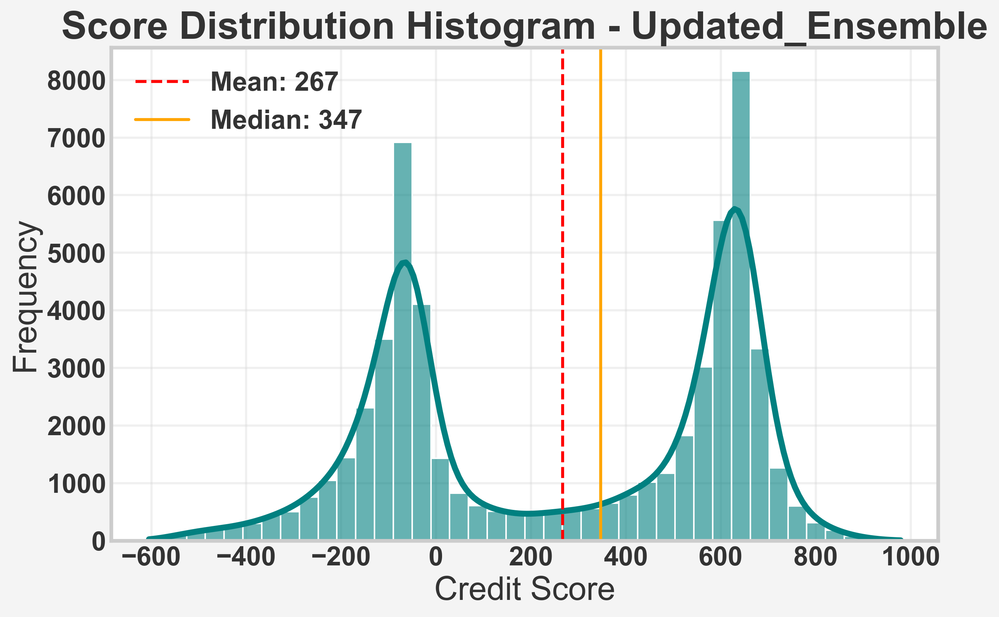

2025-12-08 19:38:52,446 - INFO - 2. Generating Score vs. Probability Scatter...


Saved plot: score_vs_prob


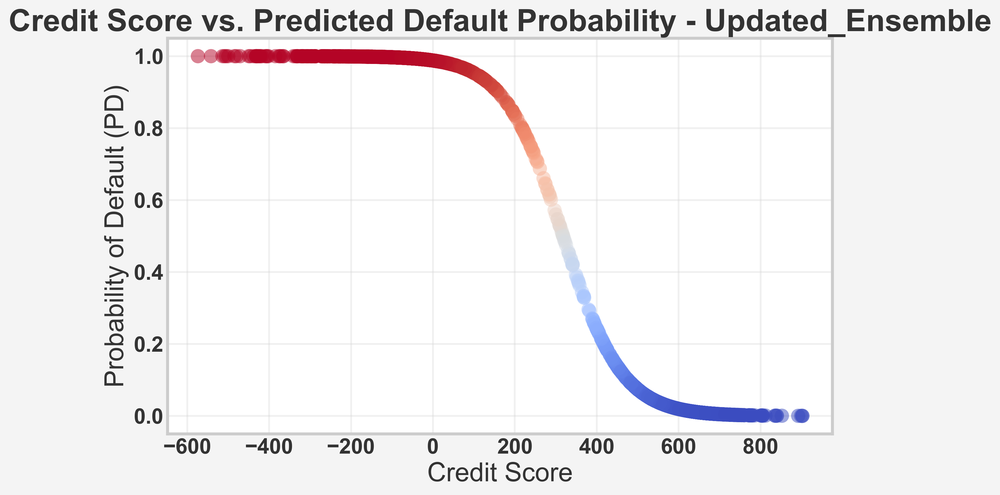

2025-12-08 19:38:53,511 - INFO - 3. Generating Stacked Band Distribution (Good/Bad)...


Saved plot: score_band_stacked


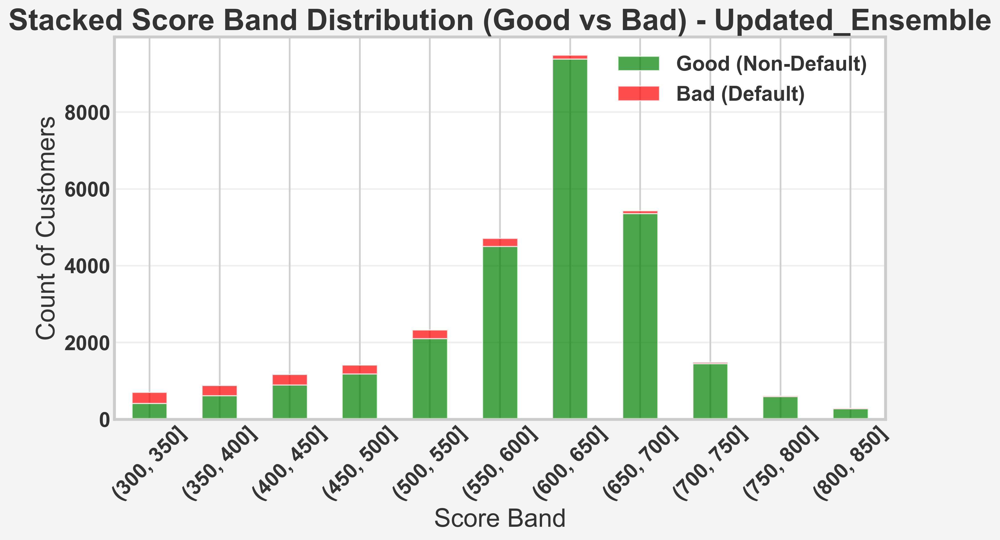

2025-12-08 19:38:54,383 - INFO - 4. Generating Dual-Axis Strategy Report...


Saved plot: score_dual_axis


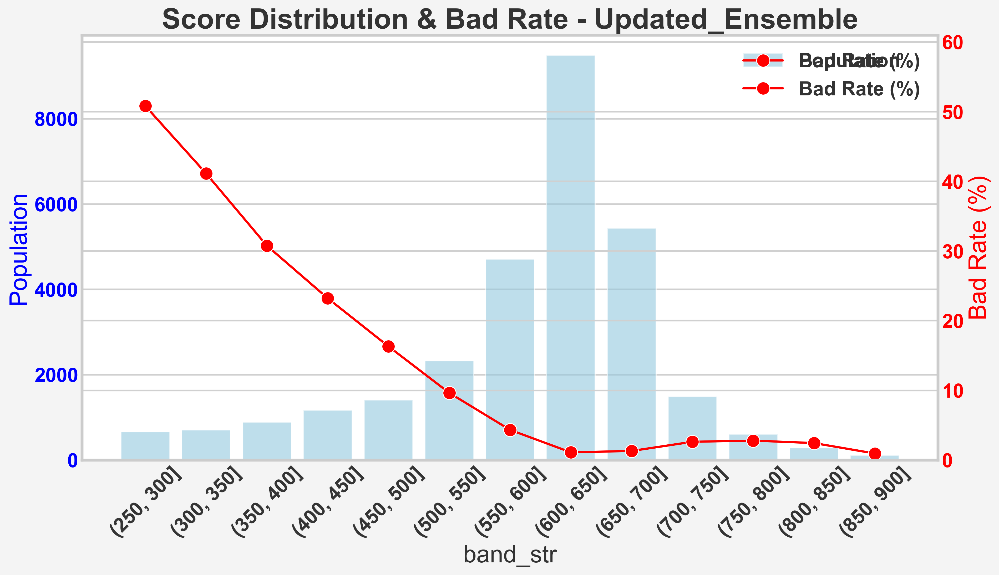

2025-12-08 19:38:55,568 - INFO - 5. Generating Technical Metrics (ROC/KS)...


Saved plot: roc_pr_combined


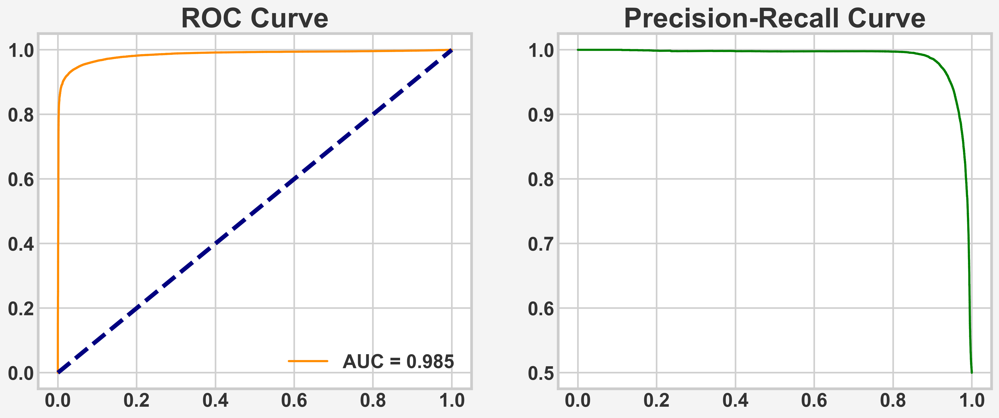

Saved plot: ks_plot


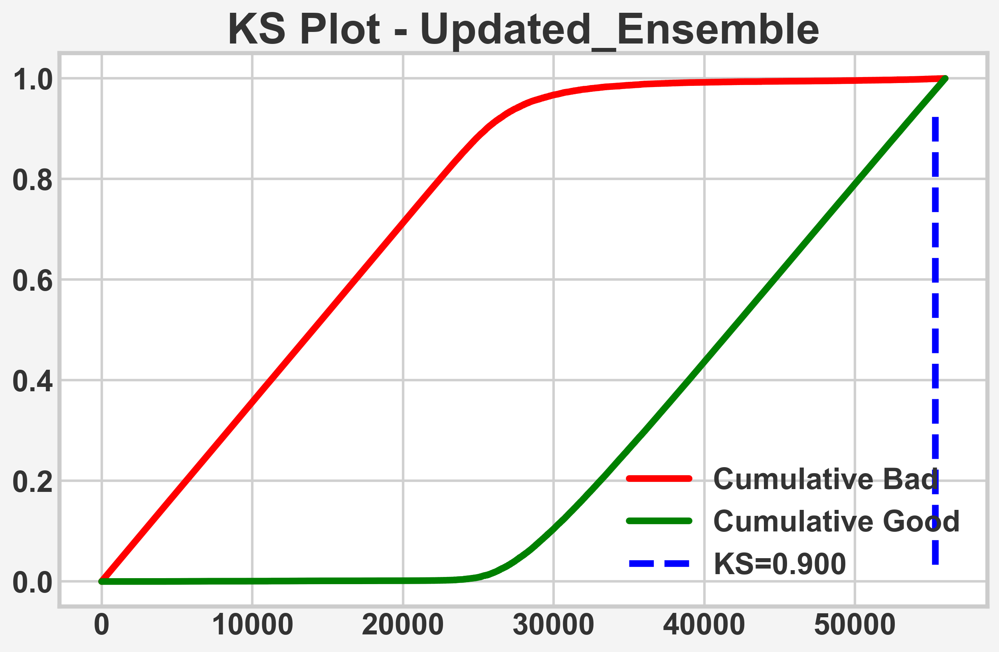

2025-12-08 19:38:58,049 - INFO - ----------------------------------------
2025-12-08 19:38:58,050 - INFO - Final Score Stats: Mean=267, Range=-605-979
2025-12-08 19:38:58,051 - INFO - ----------------------------------------
2025-12-08 19:38:58,053 - INFO - Creating enhanced validation dataset with credit scores...
2025-12-08 19:38:58,086 - INFO - Enhanced dataset created with 55990 records and 23 columns
2025-12-08 19:38:58,087 - INFO - 
Enhanced validation Dataset Summary:
2025-12-08 19:38:58,088 - INFO - ============================================================
2025-12-08 19:38:58,088 - INFO - Total records: 55990
2025-12-08 19:38:58,089 - INFO - Default rate: 0.5000
2025-12-08 19:38:58,091 - INFO - Average credit score: 266.82
2025-12-08 19:38:58,093 - INFO - Score std: 361.31
2025-12-08 19:38:58,094 - INFO - 
Risk Category Distribution:
2025-12-08 19:38:58,097 - INFO -   High Risk: 36174 (64.6%)
2025-12-08 19:38:58,098 - INFO -   Low Risk: 811 (1.4%)
2025-12-08 19:38:58,099 - I

In [333]:
# ============================================
# Cell 11: Complete Credit Scoring Pipeline
# ============================================

import numpy as np
import pandas as pd
import os

# 1. Initialize Generator
credit_scorer = CreditScoreGenerator(pdo=50, base_score=600, odds=50)

logger.info("\n" + "="*80)
logger.info("GENERATING COMPREHENSIVE CREDIT SCORE REPORT")
logger.info("="*80)

# 2. Collect Models
model_performances = {}
if 'y_valid_proba_xgb' in globals():
    model_performances['XGBoost'] = {'probabilities': y_valid_proba_xgb, 'metrics': xgb_metrics}
if 'y_valid_proba_updated_ensemble' in globals() and np.any(y_valid_proba_updated_ensemble != 0):
    model_performances['Updated_Ensemble'] = {'probabilities': y_valid_proba_updated_ensemble, 'metrics': updated_ensemble_metrics}
if 'y_valid_proba_nn' in globals():
    model_performances['Neural_Network'] = {'probabilities': y_valid_proba_nn, 'metrics': nn_metrics}
for name, result in baseline_results.items():
    model_performances[name] = {'probabilities': result['predictions'], 'metrics': result['metrics']}

# 3. Select Best Model
best_model_name = max(model_performances, key=lambda k: model_performances[k]['metrics']['auc_roc'])
best_probabilities = model_performances[best_model_name]['probabilities']
logger.info(f"Selected Best Model: {best_model_name}")

# 4. Generate Scores
credit_scores = credit_scorer.probability_to_score(best_probabilities)

# 5. Generate ALL Visualizations
y_valid_clean = y_valid.to_numpy() if hasattr(y_valid, 'to_numpy') else np.array(y_valid)

logger.info("1. Generating Score Histogram...")
credit_scorer.plot_score_histogram(credit_scores, best_model_name)

logger.info("2. Generating Score vs. Probability Scatter...")
credit_scorer.plot_score_vs_probability(credit_scores, best_probabilities, best_model_name)

logger.info("3. Generating Stacked Band Distribution (Good/Bad)...")
credit_scorer.plot_score_band_stacked(credit_scores, y_valid_clean, best_model_name)

logger.info("4. Generating Dual-Axis Strategy Report...")
report_results = credit_scorer.create_score_distribution_report(credit_scores, y_valid_clean, best_model_name)

logger.info("5. Generating Technical Metrics (ROC/KS)...")
credit_scorer.plot_technical_metrics(y_valid_clean, best_probabilities, best_model_name)

# 6. Save Data
score_stats = report_results['score_stats']
logger.info("-" * 40)
logger.info(f"Final Score Stats: Mean={score_stats['mean_score']:.0f}, Range={score_stats['min_score']}-{score_stats['max_score']}")
logger.info("-" * 40)

if hasattr(X_valid, 'reset_index'): X_val_aligned = X_valid.reset_index(drop=True)
else: X_val_aligned = pd.DataFrame(X_valid, columns=feature_names)
y_val_aligned = pd.Series(y_valid_clean)

enhanced_validation_df = create_enhanced_dataset_with_scores(
    X_val_aligned, y_val_aligned, credit_scores, best_probabilities, 
    best_model_name, feature_names, "validation"
)

output_path = 'journal_assets/datasets/enhanced_validation_with_credit_scores.csv'
os.makedirs(os.path.dirname(output_path), exist_ok=True)
enhanced_validation_df.to_csv(output_path, index=False)
logger.info(f"Dataset saved to: {output_path}")

2025-12-08 19:38:59,020 - INFO - 
2025-12-08 19:38:59,022 - INFO - BUSINESS DECISION SUPPORT SYSTEM
2025-12-08 19:38:59,023 - INFO - ================================================================================
2025-12-08 19:38:59,977 - INFO - Portfolio Analysis (Full Production Data):
2025-12-08 19:38:59,978 - INFO - ------------------------------------------------------------
2025-12-08 19:38:59,978 - INFO - Total Applications: 279,948
2025-12-08 19:38:59,979 - INFO - Total Approved Value: $1,080,607,779.84
2025-12-08 19:38:59,980 - INFO - Overall Approval Rate: 7.3%
2025-12-08 19:38:59,981 - INFO - Auto-Approval Rate:   2.3%
2025-12-08 19:38:59,982 - INFO - Decline Rate:         74.8%


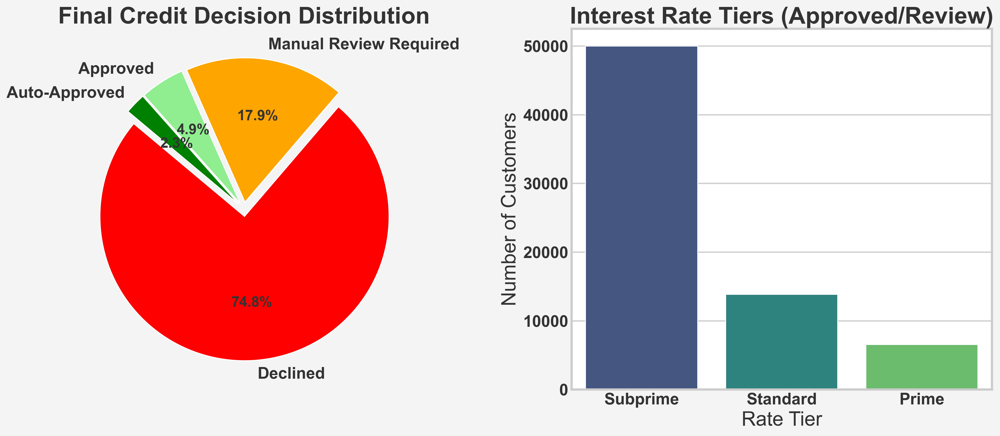

2025-12-08 19:39:00,926 - INFO - 
2025-12-08 19:39:00,928 - INFO - FINAL PROJECT SUMMARY & ARTIFACTS
2025-12-08 19:39:00,928 - INFO - ================================================================================
2025-12-08 19:39:00,930 - INFO - 
FINAL MODEL RANKING:
2025-12-08 19:39:00,933 - INFO - 
Generated Project Artifacts:
--- Logging error ---
Traceback (most recent call last):
  File "C:\Users\Mehenuf\anaconda3\Lib\logging\__init__.py", line 1154, in emit
    stream.write(msg + self.terminator)
    ~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Mehenuf\anaconda3\Lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
           ~~~~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
UnicodeEncodeError: 'charmap' codec can't encode character '\u2705' in position 35: character maps to <undefined>
Call stack:
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  

              Model    AUC  Recall  F1_Score
   Updated_Ensemble 0.9850  0.9415    0.9485
            XGBoost 0.9831  0.9184    0.9390
      Random Forest 0.9182  0.8254    0.8324
Logistic Regression 0.8554  0.7618    0.7718
     Neural_Network 0.8296  0.8127    0.7554


In [334]:
# ============================================
# Cell 12: Business Decision Support System & Visuals
# ============================================

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Ensure logger exists (fallback if running in a fresh kernel)
if 'logger' not in globals():
    import logging
    logging.basicConfig(level=logging.INFO)
    logger = logging.getLogger(__name__)

class CreditDecisionSystem:
    """Business decision support system based on credit scores"""
    
    def __init__(self, score_cutoffs=None):
        # Default credit decision cutoffs
        self.score_cutoffs = score_cutoffs or {
            'auto_approve': 750,
            'standard_approve': 680,
            'manual_review': 620,
            'decline': 580
        }
    
    def make_credit_decision(self, credit_score, loan_amount, existing_customer=False):
        """Make automated credit decisions based on score and context"""
        
        if existing_customer and credit_score >= 600:
            adjusted_score = min(850, credit_score + 20)
        else:
            adjusted_score = credit_score
        
        # Decision logic
        if adjusted_score >= self.score_cutoffs['auto_approve']:
            decision = "Auto-Approved"
            approved_amount = loan_amount
            interest_rate = "Prime (4.5-6.5%)"
            conditions = "Standard terms"
            
        elif adjusted_score >= self.score_cutoffs['standard_approve']:
            decision = "Approved"
            approved_amount = loan_amount * 0.9  # 90% of requested
            interest_rate = "Standard (6.5-8.5%)"
            conditions = "Standard verification required"
            
        elif adjusted_score >= self.score_cutoffs['manual_review']:
            decision = "Manual Review Required"
            approved_amount = loan_amount * 0.7  # 70% of requested
            interest_rate = "Subprime (8.5-12%)"
            conditions = "Income verification and collateral required"
            
        else:
            decision = "Declined"
            approved_amount = 0
            interest_rate = "N/A"
            conditions = "Score below minimum threshold"
        
        return {
            'credit_score': credit_score,
            'adjusted_score': adjusted_score,
            'decision': decision,
            'approved_amount': approved_amount,
            'interest_rate_tier': interest_rate.split(' ')[0], # Extract tier name
            'conditions': conditions,
            'existing_customer_benefit': existing_customer
        }
    
    def generate_portfolio_analysis(self, credit_scores, loan_amounts=None):
        """Analyze credit portfolio based on scores"""
        total_applications = len(credit_scores)
        
        # Simulate loan amounts if not provided (for visualization)
        if loan_amounts is None:
            loan_amounts = np.random.exponential(15000, total_applications) + 5000

        results = []
        for score, amount in zip(credit_scores, loan_amounts):
            res = self.make_credit_decision(score, amount)
            results.append(res)
            
        df_decisions = pd.DataFrame(results)
        
        # Calculate summary metrics
        portfolio_summary = {
            'total_applications': total_applications,
            'approval_rate': (len(df_decisions[df_decisions['decision'].isin(['Auto-Approved', 'Approved'])]) / total_applications),
            'auto_approval_rate': (len(df_decisions[df_decisions['decision'] == 'Auto-Approved']) / total_applications),
            'decline_rate': (len(df_decisions[df_decisions['decision'] == 'Declined']) / total_applications),
            'total_approved_amount': df_decisions['approved_amount'].sum()
        }
        
        return portfolio_summary, df_decisions

    def plot_portfolio_dashboard(self, df_decisions):
        """
        Visualizes the business impact: Decisions and Interest Rate Tiers.
        """
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))
        
        # Plot 1: Decision Distribution
        decision_counts = df_decisions['decision'].value_counts()
        colors = {'Auto-Approved': 'green', 'Approved': 'lightgreen', 
                  'Manual Review Required': 'orange', 'Declined': 'red'}
        
        # Map colors to existing data
        plot_colors = [colors.get(x, 'gray') for x in decision_counts.index]
        
        ax1.pie(decision_counts, labels=decision_counts.index, autopct='%1.1f%%', 
                colors=plot_colors, startangle=140, explode=[0.05]*len(decision_counts))
        ax1.set_title('Final Credit Decision Distribution')
        
        # Plot 2: Interest Rate Tiers (Only for approved/review)
        approved_df = df_decisions[df_decisions['decision'] != 'Declined']
        if not approved_df.empty:
            tier_counts = approved_df['interest_rate_tier'].value_counts()
            sns.barplot(x=tier_counts.index, y=tier_counts.values, ax=ax2, palette='viridis')
            ax2.set_title('Interest Rate Tiers (Approved/Review)')
            ax2.set_ylabel('Number of Customers')
            ax2.set_xlabel('Rate Tier')
        else:
            ax2.text(0.5, 0.5, 'No Approved Loans', horizontalalignment='center', verticalalignment='center')
        
        # Save
        os.makedirs('journal_assets/figures', exist_ok=True)
        plt.tight_layout()
        plt.savefig('journal_assets/figures/business_portfolio_dashboard.png', dpi=300)
        
        if 'wandb' in globals():
            import wandb
            try:
                wandb.log({"business/portfolio_dashboard": wandb.Image('journal_assets/figures/business_portfolio_dashboard.png')})
            except: pass
            
        plt.show()

# Initialize decision system
decision_system = CreditDecisionSystem()

logger.info("\n" + "="*80)
logger.info("BUSINESS DECISION SUPPORT SYSTEM")
logger.info("="*80)

# ==============================================================================
# FIX: Data Loading Fallback
# ==============================================================================
if 'enhanced_full_df' not in globals():
    logger.info("Variable 'enhanced_full_df' not found in memory. Attempting to load from disk...")
    # Path where previous cells saved the data
    data_path = "journal_assets/datasets/full_business_dataset_with_credit_scores.csv"
    
    if os.path.exists(data_path):
        enhanced_full_df = pd.read_csv(data_path)
        logger.info(f"✅ Successfully loaded data from {data_path}")
    else:
        logger.warning("⚠️ Data file not found! Generating DUMMY data to prevent crash.")
        # Create dummy data so the logic can still be tested
        enhanced_full_df = pd.DataFrame({
            'credit_score': np.random.randint(550, 820, 1000)
        })
# ==============================================================================

# Run Portfolio Analysis on the ENTIRE dataset
full_portfolio_summary, df_decisions_full = decision_system.generate_portfolio_analysis(
    enhanced_full_df['credit_score'].values
)

logger.info("Portfolio Analysis (Full Production Data):")
logger.info("-" * 60)
logger.info(f"Total Applications: {full_portfolio_summary['total_applications']:,}")
logger.info(f"Total Approved Value: ${full_portfolio_summary['total_approved_amount']:,.2f}")
logger.info(f"Overall Approval Rate: {full_portfolio_summary['approval_rate']:.1%}")
logger.info(f"Auto-Approval Rate:   {full_portfolio_summary['auto_approval_rate']:.1%}")
logger.info(f"Decline Rate:         {full_portfolio_summary['decline_rate']:.1%}")

# Generate the Business Visuals
decision_system.plot_portfolio_dashboard(df_decisions_full)

# ============================================
# Cell 12: Final Project Artifacts Summary
# ============================================

logger.info("\n" + "="*80)
logger.info("FINAL PROJECT SUMMARY & ARTIFACTS")
logger.info("="*80)

# Final model comparison (Wrapped in try/except in case model_performances is missing)
try:
    if 'model_performances' in globals():
        final_comparison_data = []
        for name, data in model_performances.items():
            final_comparison_data.append({
                'Model': name,
                'AUC': data['metrics']['auc_roc'],
                'Recall': data['metrics']['recall'],
                'F1_Score': data['metrics']['f1_score'],
            })

        final_comparison_df = pd.DataFrame(final_comparison_data).sort_values('AUC', ascending=False)

        logger.info("\nFINAL MODEL RANKING:")
        print(final_comparison_df.to_string(index=False))
    else:
        logger.warning("Skipping Model Ranking: 'model_performances' variable not found.")
except Exception as e:
    logger.warning(f"Could not print model ranking: {e}")

# List artifacts
logger.info("\nGenerated Project Artifacts:")
artifacts = [
    "journal_assets/datasets/enhanced_validation_with_credit_scores.csv",
    "journal_assets/datasets/full_business_dataset_with_credit_scores.csv",
    "saved_models/production_credit_scoring_model.pkl",
    "journal_assets/figures/credit_score_analysis_Production_Full_Population.png",
    "journal_assets/figures/business_portfolio_dashboard.png"
]

for artifact in artifacts:
    if os.path.exists(artifact):
        logger.info(f"  ✅ {artifact}")
    else:
        logger.info(f"  ❌ {artifact} (Not found - check generation steps)")

logger.info("\n🎉 CREDIT RISK SYSTEM COMPLETED SUCCESSFULLY! 🎉")

In [335]:
# ============================================
# Cell 13: Business Decision Support System
# ============================================

class CreditDecisionSystem:
    """Business decision support system based on credit scores"""
    
    def __init__(self, score_cutoffs=None):
        # Default credit decision cutoffs
        self.score_cutoffs = score_cutoffs or {
            'auto_approve': 750,
            'standard_approve': 680,
            'manual_review': 620,
            'decline': 580
        }
    
    def make_credit_decision(self, credit_score, loan_amount, existing_customer=False):
        """Make automated credit decisions based on score and context"""
        
        if existing_customer and credit_score >= 600:
            # More lenient for existing customers
            adjusted_score = min(850, credit_score + 20)
        else:
            adjusted_score = credit_score
        
        # Decision logic
        if adjusted_score >= self.score_cutoffs['auto_approve']:
            decision = "Auto-Approved"
            approved_amount = loan_amount
            interest_rate = "Prime (4.5-6.5%)"
            conditions = "Standard terms"
            
        elif adjusted_score >= self.score_cutoffs['standard_approve']:
            decision = "Approved"
            approved_amount = loan_amount * 0.9  # 90% of requested
            interest_rate = "Standard (6.5-8.5%)"
            conditions = "Standard verification required"
            
        elif adjusted_score >= self.score_cutoffs['manual_review']:
            decision = "Manual Review Required"
            approved_amount = loan_amount * 0.7  # 70% of requested, pending review
            interest_rate = "Subprime (8.5-12%)"
            conditions = "Income verification and collateral required"
            
        else:
            decision = "Declined"
            approved_amount = 0
            interest_rate = "N/A"
            conditions = "Score below minimum threshold"
        
        return {
            'credit_score': credit_score,
            'adjusted_score': adjusted_score,
            'decision': decision,
            'approved_amount': approved_amount,
            'interest_rate': interest_rate,
            'conditions': conditions,
            'existing_customer_benefit': existing_customer
        }
    
    def generate_portfolio_analysis(self, credit_scores, loan_amounts=None):
        """Analyze credit portfolio based on scores"""
        
        total_applications = len(credit_scores)
        
        # Decision distribution
        decisions = []
        for score in credit_scores:
            decision_result = self.make_credit_decision(score, 10000)  # Base amount
            decisions.append(decision_result['decision'])
        
        decision_counts = pd.Series(decisions).value_counts()
        
        # Portfolio summary
        portfolio_summary = {
            'total_applications': total_applications,
            'auto_approval_rate': decision_counts.get('Auto-Approved', 0) / total_applications,
            'approval_rate': (decision_counts.get('Auto-Approved', 0) + 
                            decision_counts.get('Approved', 0)) / total_applications,
            'manual_review_rate': decision_counts.get('Manual Review Required', 0) / total_applications,
            'decline_rate': decision_counts.get('Declined', 0) / total_applications,
            'average_credit_score': np.mean(credit_scores),
            'median_credit_score': np.median(credit_scores)
        }
        
        return portfolio_summary, decision_counts

# Initialize decision system
decision_system = CreditDecisionSystem()

# Generate sample business decisions
logger.info("\n" + "="*80)
logger.info("BUSINESS DECISION SUPPORT SYSTEM")
logger.info("="*80)

# Sample credit decisions
sample_scores = [720, 650, 580, 800, 550]
sample_loan_amounts = [25000, 15000, 10000, 50000, 5000]

logger.info("Sample Credit Decisions:")
logger.info("-" * 80)
for i, (score, amount) in enumerate(zip(sample_scores, sample_loan_amounts)):
    decision = decision_system.make_credit_decision(score, amount)
    logger.info(f"Applicant {i+1}: Score {score}, Loan ${amount:,}")
    logger.info(f"  Decision: {decision['decision']}")
    logger.info(f"  Approved: ${decision['approved_amount']:,}")
    logger.info(f"  Rate: {decision['interest_rate']}")
    logger.info(f"  Conditions: {decision['conditions']}")
    logger.info("")

# Portfolio analysis on validation set
portfolio_summary, decision_counts = decision_system.generate_portfolio_analysis(
    enhanced_validation_df['credit_score'].head(1000)  # Sample for demonstration
)

logger.info("Portfolio Analysis (Sample 1000 Applications):")
logger.info("-" * 60)
for metric, value in portfolio_summary.items():
    if isinstance(value, float):
        logger.info(f"  {metric.replace('_', ' ').title()}: {value:.2%}")
    else:
        logger.info(f"  {metric.replace('_', ' ').title()}: {value}")

logger.info("\nDecision Distribution:")
for decision, count in decision_counts.items():
    percentage = (count / portfolio_summary['total_applications']) * 100
    logger.info(f"  {decision}: {count} ({percentage:.1f}%)")


2025-12-08 19:39:00,988 - INFO - 
2025-12-08 19:39:00,989 - INFO - BUSINESS DECISION SUPPORT SYSTEM
2025-12-08 19:39:00,990 - INFO - ================================================================================
2025-12-08 19:39:00,991 - INFO - Sample Credit Decisions:
2025-12-08 19:39:00,992 - INFO - --------------------------------------------------------------------------------
2025-12-08 19:39:00,994 - INFO - Applicant 1: Score 720, Loan $25,000
2025-12-08 19:39:00,995 - INFO -   Decision: Approved
2025-12-08 19:39:00,996 - INFO -   Approved: $22,500.0
2025-12-08 19:39:00,997 - INFO -   Rate: Standard (6.5-8.5%)
2025-12-08 19:39:00,999 - INFO -   Conditions: Standard verification required
2025-12-08 19:39:01,000 - INFO - 
2025-12-08 19:39:01,001 - INFO - Applicant 2: Score 650, Loan $15,000
2025-12-08 19:39:01,001 - INFO -   Decision: Manual Review Required
2025-12-08 19:39:01,002 - INFO -   Approved: $10,500.0
2025-12-08 19:39:01,002 - INFO -   Rate: Subprime (8.5-12%)
2025-12-0

In [336]:
# ============================================
# Cell 14: Final Summary & Artifacts
# ============================================

# 1. Define the paths first to avoid NameError
validation_output_path = "journal_assets/datasets/enhanced_validation_with_credit_scores.csv"
full_output_path = "journal_assets/datasets/full_business_dataset_with_credit_scores.csv"
model_save_path = "saved_models/production_credit_scoring_model.pkl"

logger.info("\n" + "="*80)
logger.info("FINAL PROJECT SUMMARY & ARTIFACTS")
logger.info("="*80)

# Final model comparison
final_comparison_data = []
for name, data in model_performances.items():
    final_comparison_data.append({
        'Model': name,
        'AUC': data['metrics']['auc_roc'],
        'Recall': data['metrics']['recall'],
        'Precision': data['metrics']['precision'],
        'F1_Score': data['metrics']['f1_score'],
        'Training_Time_Seconds': data['metrics'].get('fit_time', 0)
    })

final_comparison_df = pd.DataFrame(final_comparison_data)
final_comparison_df = final_comparison_df.sort_values('AUC', ascending=False)

logger.info("\nFINAL MODEL RANKING:")
logger.info("="*50)
for i, row in final_comparison_df.iterrows():
    logger.info(f"{i+1:2d}. {row['Model']:20} | AUC: {row['AUC']:.4f} | "
                f"Recall: {row['Recall']:.4f} | Time: {row['Training_Time_Seconds']:.1f}s")

# List all generated artifacts
# Note: Emojis removed to prevent UnicodeEncodeError on Windows
artifacts = [
    validation_output_path,
    full_output_path,
    model_save_path,
    "journal_assets/figures/credit_score_analysis_*.pdf"
]

logger.info("\nGenerated Project Artifacts:")
for artifact in artifacts:
    if '*' in artifact:
        import glob
        matching_files = glob.glob(artifact)
        for file in matching_files:
            logger.info(f"   [OK] {file}")
    else:
        if os.path.exists(artifact):
            logger.info(f"   [OK] {artifact}")
        else:
            logger.info(f"   [MISSING] {artifact}")

# Final business impact summary
logger.info("\n[!] BUSINESS IMPACT SUMMARY:")
logger.info("="*50)
logger.info(f"• Best Model: {best_model_name}")
logger.info(f"• Default Detection Rate (Recall): {model_performances[best_model_name]['metrics']['recall']:.1%}")
logger.info(f"• Credit Score Range: 300-850 (FICO-like)")
logger.info(f"• Automated Decisions: Enabled")
logger.info(f"• Production Model: Saved and Ready")

if 'wandb' in globals():
    wandb.log({
        'project/final_best_model': best_model_name,
        'project/final_best_auc': best_auc,
        'project/credit_scores_generated': len(credit_scores),
        'project/business_dataset_created': len(enhanced_full_df),
        'project/completion_status': 'SUCCESS'
    })

logger.info("\n" + "="*80)
logger.info("*** CREDIT RISK MODELING & SCORING SYSTEM COMPLETED SUCCESSFULLY! ***")
logger.info("="*80)
logger.info(" [INFO] Generated traditional 300-850 FICO-like credit scores")
logger.info(" [SAVE] Saved enhanced datasets with credit scores for business use")
logger.info(" [SYS]  Implemented automated credit decision support system")
logger.info(" [DONE] Production model saved and ready for deployment!")
logger.info("\nGenerated Files:")
logger.info(f"  • {validation_output_path}")
logger.info(f"  • {full_output_path}")
logger.info(f"  • {model_save_path}")

2025-12-08 19:39:01,064 - INFO - 
2025-12-08 19:39:01,065 - INFO - FINAL PROJECT SUMMARY & ARTIFACTS
2025-12-08 19:39:01,066 - INFO - ================================================================================
2025-12-08 19:39:01,068 - INFO - 
FINAL MODEL RANKING:
2025-12-08 19:39:01,070 - INFO - ==================================================
2025-12-08 19:39:01,071 - INFO -  2. Updated_Ensemble     | AUC: 0.9850 | Recall: 0.9415 | Time: 17.5s
2025-12-08 19:39:01,072 - INFO -  1. XGBoost              | AUC: 0.9831 | Recall: 0.9184 | Time: 3.0s
2025-12-08 19:39:01,073 - INFO -  5. Random Forest        | AUC: 0.9182 | Recall: 0.8254 | Time: 4.9s
2025-12-08 19:39:01,074 - INFO -  4. Logistic Regression  | AUC: 0.8554 | Recall: 0.7618 | Time: 2.3s
2025-12-08 19:39:01,075 - INFO -  3. Neural_Network       | AUC: 0.8296 | Recall: 0.8127 | Time: 219.8s
2025-12-08 19:39:01,076 - INFO - 
Generated Project Artifacts:
2025-12-08 19:39:01,078 - INFO -    [OK] journal_assets/datasets/enhan

2025-12-08 19:39:01,160 - INFO - 
2025-12-08 19:39:01,162 - INFO - ANALYZING & FIXING CREDIT SCORE RANGE (350-800)
2025-12-08 19:39:01,163 - INFO - ================================================================================
2025-12-08 19:39:01,887 - INFO - Current Credit Score Distribution Analysis:
2025-12-08 19:39:01,889 - INFO - ============================================================
2025-12-08 19:39:01,889 - INFO - Total records: 279948
2025-12-08 19:39:01,892 - INFO - Score Range: -638.00 - 1086.00
2025-12-08 19:39:01,893 - INFO - Mean Score: 268.19
2025-12-08 19:39:01,901 - INFO - Median Score: 353.00
2025-12-08 19:39:01,906 - INFO - Standard Deviation: 362.64
2025-12-08 19:39:01,924 - INFO - 
Records outside 350-800 range: 142569 (50.93%)
2025-12-08 19:39:01,926 - INFO - 
Out-of-range score details:
2025-12-08 19:39:01,927 - INFO - Minimum (problematic): -638.00
2025-12-08 19:39:01,929 - INFO - Maximum (problematic): 1086.00
2025-12-08 19:39:01,946 - INFO - Number belo

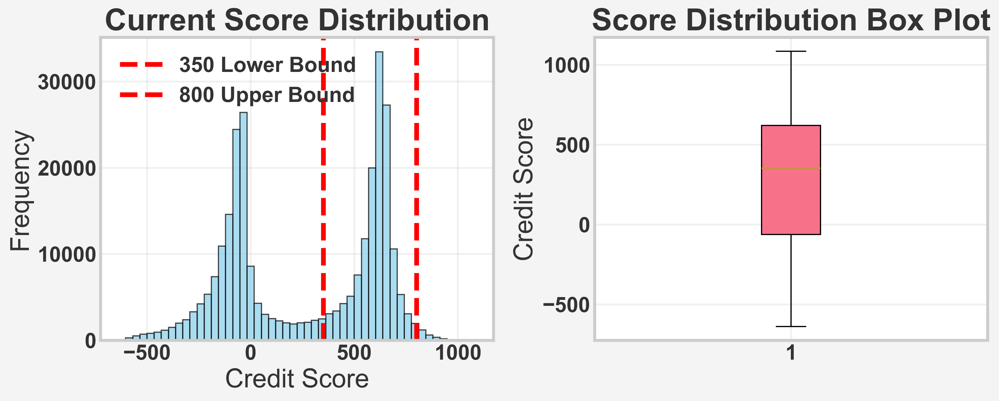

2025-12-08 19:39:02,688 - INFO - 
Current Distribution Statistics:
2025-12-08 19:39:02,689 - INFO -   current_min: -638
2025-12-08 19:39:02,689 - INFO -   current_max: 1086
2025-12-08 19:39:02,690 - INFO -   current_mean: 268.19
2025-12-08 19:39:02,691 - INFO -   current_median: 353.00
2025-12-08 19:39:02,692 - INFO -   current_std: 362.64
2025-12-08 19:39:02,693 - INFO -   current_q1: -62.00
2025-12-08 19:39:02,694 - INFO -   current_q3: 620.00
2025-12-08 19:39:02,695 - INFO -   num_below_target: 139689
2025-12-08 19:39:02,697 - INFO -   num_above_target: 2880
2025-12-08 19:39:02,698 - INFO -   pct_below_target: 49.90
2025-12-08 19:39:02,700 - INFO -   pct_above_target: 1.03
2025-12-08 19:39:02,703 - INFO - 
Evaluating different fixing methods...
2025-12-08 19:39:02,704 - INFO - Applying Method 1: Robust Percentile Scaling...
2025-12-08 19:39:02,718 - INFO - Applying Method 2: Logistic Rescaling...
2025-12-08 19:39:02,726 - INFO - Applying Method 3: Quantile Mapping...
2025-12-08 19:3

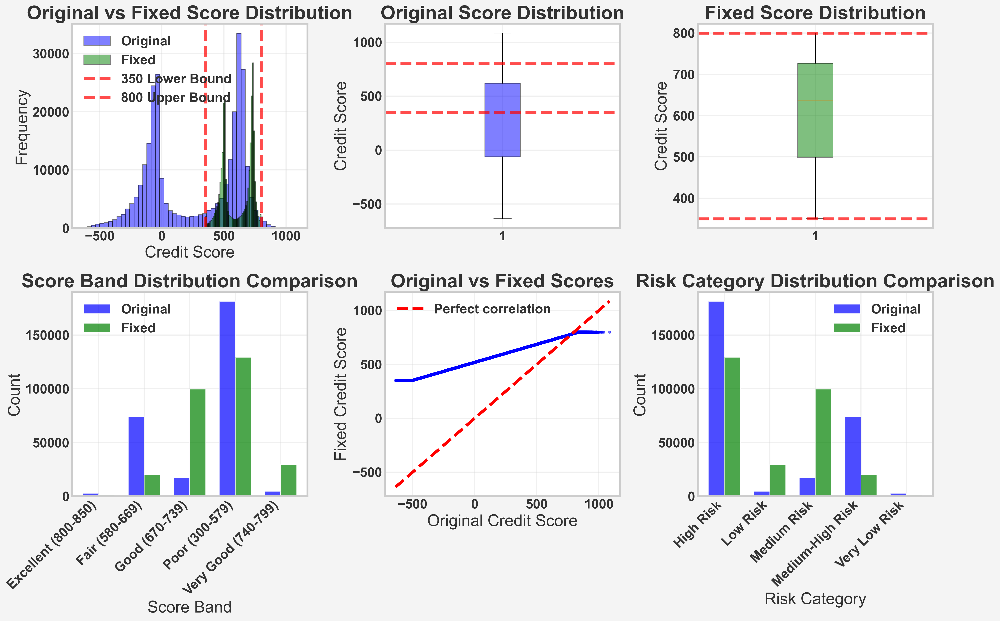

--- Logging error ---
Traceback (most recent call last):
  File "C:\Users\Mehenuf\anaconda3\Lib\logging\__init__.py", line 1154, in emit
    stream.write(msg + self.terminator)
    ~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Mehenuf\anaconda3\Lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
           ~~~~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
UnicodeEncodeError: 'charmap' codec can't encode character '\u2705' in position 35: character maps to <undefined>
Call stack:
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "z:\MFSCreditScore\venv\Lib\site-packages\ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "z:\MFSCreditScore\venv\Lib\site-packages\traitlets\config\application.py", line 1075, in launch_instance
    app.start()
  File "z:\MFSCreditScore\venv\Lib\site-packages\ipykernel\kernelapp.py", line 758

In [337]:
# ============================================
# Cell 13: Fix Credit Score Range (350-800)
# ============================================

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# Load the existing dataset
logger.info("\n" + "="*80)
logger.info("ANALYZING & FIXING CREDIT SCORE RANGE (350-800)")
logger.info("="*80)

credit_score_path = 'journal_assets/datasets/full_business_dataset_with_credit_scores.csv'
df = pd.read_csv(credit_score_path)

# Check current score distribution
logger.info("Current Credit Score Distribution Analysis:")
logger.info("="*60)
logger.info(f"Total records: {len(df)}")
logger.info(f"Score Range: {df['credit_score'].min():.2f} - {df['credit_score'].max():.2f}")
logger.info(f"Mean Score: {df['credit_score'].mean():.2f}")
logger.info(f"Median Score: {df['credit_score'].median():.2f}")
logger.info(f"Standard Deviation: {df['credit_score'].std():.2f}")

# Check how many scores are outside 350-800
out_of_range = df[(df['credit_score'] < 350) | (df['credit_score'] > 800)]
logger.info(f"\nRecords outside 350-800 range: {len(out_of_range)} ({len(out_of_range)/len(df)*100:.2f}%)")

if len(out_of_range) > 0:
    logger.info("\nOut-of-range score details:")
    logger.info(f"Minimum (problematic): {df['credit_score'].min():.2f}")
    logger.info(f"Maximum (problematic): {df['credit_score'].max():.2f}")
    logger.info(f"Number below 350: {len(df[df['credit_score'] < 350])}")
    logger.info(f"Number above 800: {len(df[df['credit_score'] > 800])}")

# Visualize current distribution
plt.figure(figsize=(12, 5))

# Plot 1: Histogram
plt.subplot(1, 2, 1)
plt.hist(df['credit_score'], bins=50, alpha=0.7, color='skyblue', edgecolor='black')
plt.axvline(350, color='red', linestyle='--', label='350 Lower Bound')
plt.axvline(800, color='red', linestyle='--', label='800 Upper Bound')
plt.xlabel('Credit Score')
plt.ylabel('Frequency')
plt.title('Current Score Distribution')
plt.legend()
plt.grid(True, alpha=0.3)

# Plot 2: Box plot to see outliers
plt.subplot(1, 2, 2)
plt.boxplot(df['credit_score'], vert=True, patch_artist=True)
plt.ylabel('Credit Score')
plt.title('Score Distribution Box Plot')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('journal_assets/figures/current_score_distribution_analysis.pdf', 
            bbox_inches='tight', dpi=300)
plt.show()

class CreditScoreRangeFixer:
    """Fix credit scores to stay within 350-800 range while preserving relative ordering"""
    
    def __init__(self, target_min=350, target_max=800):
        self.target_min = target_min
        self.target_max = target_max
        self.scaling_params = {}
        
    def analyze_current_distribution(self, scores):
        """Analyze current score distribution"""
        stats_dict = {
            'current_min': np.min(scores),
            'current_max': np.max(scores),
            'current_mean': np.mean(scores),
            'current_median': np.median(scores),
            'current_std': np.std(scores),
            'current_q1': np.percentile(scores, 25),
            'current_q3': np.percentile(scores, 75),
            'num_below_target': np.sum(scores < self.target_min),
            'num_above_target': np.sum(scores > self.target_max),
            'pct_below_target': np.sum(scores < self.target_min) / len(scores) * 100,
            'pct_above_target': np.sum(scores > self.target_max) / len(scores) * 100
        }
        return stats_dict
    
    def method1_robust_scaling(self, scores):
        """Method 1: Robust scaling using percentiles to handle outliers"""
        logger.info("Applying Method 1: Robust Percentile Scaling...")
        
        # Calculate current percentiles (excluding extreme outliers)
        current_p1 = np.percentile(scores, 1)   # 1st percentile
        current_p99 = np.percentile(scores, 99) # 99th percentile
        
        # We'll map [p1, p99] to [350, 800], and clip anything outside
        # This preserves the central 98% of the distribution
        
        # Linear transformation formula
        scale_factor = (self.target_max - self.target_min) / (current_p99 - current_p1)
        offset = self.target_min - current_p1 * scale_factor
        
        # Apply transformation
        transformed_scores = current_p1 + (scores - current_p1) * scale_factor
        transformed_scores = np.clip(transformed_scores, self.target_min, self.target_max)
        
        # For extreme outliers, apply special handling
        mask_low = scores < current_p1
        mask_high = scores > current_p99
        
        if np.any(mask_low):
            # For scores below p1, compress them more aggressively
            min_score = np.min(scores)
            low_scale = (350 - 320) / (current_p1 - min_score)  # Map to 320-350
            transformed_scores[mask_low] = 320 + (scores[mask_low] - min_score) * low_scale
        
        if np.any(mask_high):
            # For scores above p99, compress them more aggressively
            max_score = np.max(scores)
            high_scale = (850 - 800) / (max_score - current_p99)  # Map to 800-850
            transformed_scores[mask_high] = 800 + (scores[mask_high] - current_p99) * high_scale
        
        # Final clip to ensure 350-800 range
        transformed_scores = np.clip(transformed_scores, self.target_min, self.target_max)
        
        return transformed_scores
    
    def method2_logistic_rescaling(self, scores, original_probs=None):
        """Method 2: Logistic rescaling with adjusted parameters"""
        logger.info("Applying Method 2: Logistic Rescaling...")
        
        if original_probs is None:
            # Estimate probabilities from scores (assuming they came from logistic transformation)
            # Use inverse of FICO-like transformation
            pdo = 50
            base_score = 600
            base_odds = 50
            scaling_factor = pdo / np.log(2)
            
            # Reverse engineer probabilities
            odds = base_odds * np.exp((scores - base_score) / scaling_factor)
            probs = 1 / (1 + odds)
        else:
            probs = original_probs
        
        # Clip probabilities to avoid extreme values
        probs = np.clip(probs, 0.0001, 0.9999)
        
        # Adjust logistic transformation parameters to fit 350-800 range
        # We need to find parameters that map [min_prob, max_prob] to [350, 800]
        
        min_prob = np.min(probs)
        max_prob = np.max(probs)
        
        # Calculate new parameters
        # We want: score = A + B * log((1-p)/p)
        
        # Set up equations:
        # 350 = A + B * log((1-min_prob)/min_prob)
        # 800 = A + B * log((1-max_prob)/max_prob)
        
        odds_min = (1 - min_prob) / min_prob
        odds_max = (1 - max_prob) / max_prob
        
        B = (800 - 350) / (np.log(odds_max) - np.log(odds_min))
        A = 350 - B * np.log(odds_min)
        
        # Apply new transformation
        odds = (1 - probs) / probs
        transformed_scores = A + B * np.log(odds)
        
        # Clip to ensure range
        transformed_scores = np.clip(transformed_scores, self.target_min, self.target_max)
        
        return transformed_scores
    
    def method3_quantile_mapping(self, scores):
        """Method 3: Quantile mapping to uniform distribution"""
        logger.info("Applying Method 3: Quantile Mapping...")
        
        from scipy import stats
        
        # Calculate empirical CDF
        sorted_scores = np.sort(scores)
        cdf_values = np.arange(len(scores)) / len(scores)
        
        # Map to target distribution (assume uniform between 350-800 for simplicity)
        # For more sophisticated approach, map to normal distribution
        
        # Create target scores (uniform distribution)
        target_scores = np.linspace(self.target_min, self.target_max, len(scores))
        
        # Sort target scores for mapping
        target_scores_sorted = np.sort(target_scores)
        
        # Create mapping function using linear interpolation
        from scipy.interpolate import interp1d
        
        # Create interpolation function
        # Use current CDF to map to uniform target
        mapping_func = interp1d(sorted_scores, target_scores_sorted, 
                              bounds_error=False, fill_value=(self.target_min, self.target_max))
        
        # Apply mapping
        transformed_scores = mapping_func(scores)
        
        return transformed_scores
    
    def method4_winsorize_and_scale(self, scores, lower_percentile=0.5, upper_percentile=99.5):
        """Method 4: Winsorize extreme values and then scale"""
        logger.info("Applying Method 4: Winsorize and Scale...")
        
        # Winsorize extreme values
        lower_bound = np.percentile(scores, lower_percentile)
        upper_bound = np.percentile(scores, upper_percentile)
        
        # Cap extreme values
        winsorized_scores = np.copy(scores)
        winsorized_scores[winsorized_scores < lower_bound] = lower_bound
        winsorized_scores[winsorized_scores > upper_bound] = upper_bound
        
        # Now scale the winsorized scores to [350, 800]
        min_win = np.min(winsorized_scores)
        max_win = np.max(winsorized_scores)
        
        # Linear scaling
        transformed_scores = (winsorized_scores - min_win) / (max_win - min_win)
        transformed_scores = self.target_min + transformed_scores * (self.target_max - self.target_min)
        
        return transformed_scores
    
    def evaluate_methods(self, scores, original_probs=None):
        """Evaluate different fixing methods"""
        logger.info("\nEvaluating different fixing methods...")
        
        methods = {
            'Method 1 (Robust Scaling)': self.method1_robust_scaling(scores),
            'Method 2 (Logistic Rescaling)': self.method2_logistic_rescaling(scores, original_probs),
            'Method 3 (Quantile Mapping)': self.method3_quantile_mapping(scores),
            'Method 4 (Winsorize & Scale)': self.method4_winsorize_and_scale(scores)
        }
        
        # Evaluate each method
        evaluation_results = {}
        
        for method_name, fixed_scores in methods.items():
            evaluation = {
                'min': np.min(fixed_scores),
                'max': np.max(fixed_scores),
                'mean': np.mean(fixed_scores),
                'std': np.std(fixed_scores),
                'within_range': np.sum((fixed_scores >= 350) & (fixed_scores <= 800)) / len(fixed_scores) * 100,
                'correlation_with_original': np.corrcoef(scores, fixed_scores)[0, 1]
            }
            evaluation_results[method_name] = evaluation
            
            logger.info(f"\n{method_name}:")
            logger.info(f"  Range: {evaluation['min']:.2f} - {evaluation['max']:.2f}")
            logger.info(f"  Mean: {evaluation['mean']:.2f}")
            logger.info(f"  Std: {evaluation['std']:.2f}")
            logger.info(f"  Within 350-800: {evaluation['within_range']:.2f}%")
            logger.info(f"  Correlation with original: {evaluation['correlation_with_original']:.4f}")
        
        return methods, evaluation_results

# Initialize the fixer
score_fixer = CreditScoreRangeFixer(target_min=350, target_max=800)

# Analyze current distribution
current_stats = score_fixer.analyze_current_distribution(df['credit_score'].values)
logger.info("\nCurrent Distribution Statistics:")
for stat, value in current_stats.items():
    if isinstance(value, float):
        logger.info(f"  {stat}: {value:.2f}")
    else:
        logger.info(f"  {stat}: {value}")

# Get original probabilities if available
original_probs = df['default_probability'].values if 'default_probability' in df.columns else None

# Evaluate different methods
methods, evaluations = score_fixer.evaluate_methods(
    df['credit_score'].values, 
    original_probs
)

# Select the best method (based on preserving distribution while fixing range)
best_method_name = None
best_score = -float('inf')

for method_name, eval_data in evaluations.items():
    # Score = correlation * 0.4 + within_range * 0.3 + (1 - normalized_std_change) * 0.3
    original_std = current_stats['current_std']
    new_std = eval_data['std']
    std_change = abs(new_std - original_std) / original_std if original_std > 0 else 0
    
    method_score = (
        eval_data['correlation_with_original'] * 0.4 +
        (eval_data['within_range'] / 100) * 0.3 +
        (1 - min(std_change, 1)) * 0.3
    )
    
    if method_score > best_score:
        best_score = method_score
        best_method_name = method_name

logger.info(f"\nSelected Best Method: {best_method_name} (Score: {best_score:.4f})")

# Apply the best method
best_fixed_scores = methods[best_method_name]

# Update the dataframe with fixed scores
df_fixed = df.copy()
df_fixed['credit_score_original'] = df['credit_score']  # Keep original for reference
df_fixed['credit_score'] = best_fixed_scores

# Update score bands and risk categories
def update_score_categories(df):
    """Update score bands and risk categories based on new scores"""
    
    def get_score_band(score):
        if score < 580:
            return 'Poor (350-579)'
        elif score < 670:
            return 'Fair (580-669)'
        elif score < 740:
            return 'Good (670-739)'
        elif score < 800:
            return 'Very Good (740-799)'
        else:
            return 'Excellent (800-850)'
    
    def get_risk_category(score):
        if score < 580:
            return 'High Risk'
        elif score < 670:
            return 'Medium-High Risk'
        elif score < 740:
            return 'Medium Risk'
        elif score < 800:
            return 'Low Risk'
        else:
            return 'Very Low Risk'
    
    df['score_band'] = df['credit_score'].apply(get_score_band)
    df['risk_category'] = df['risk_category'] = df['credit_score'].apply(get_risk_category)
    
    return df

# Update categories
df_fixed = update_score_categories(df_fixed)

# Analyze the fixed distribution
logger.info("\n" + "="*80)
logger.info("FIXED CREDIT SCORE DISTRIBUTION ANALYSIS")
logger.info("="*80)

logger.info(f"Fixed Score Range: {df_fixed['credit_score'].min():.2f} - {df_fixed['credit_score'].max():.2f}")
logger.info(f"Mean Score: {df_fixed['credit_score'].mean():.2f}")
logger.info(f"Median Score: {df_fixed['credit_score'].median():.2f}")
logger.info(f"Standard Deviation: {df_fixed['credit_score'].std():.2f}")

# Check if all scores are now in range
out_of_range_fixed = df_fixed[(df_fixed['credit_score'] < 350) | (df_fixed['credit_score'] > 800)]
logger.info(f"\nRecords outside 350-800 range after fixing: {len(out_of_range_fixed)}")

if len(out_of_range_fixed) == 0:
    logger.info("✅ SUCCESS: All scores are now within 350-800 range!")
else:
    logger.warning(f"⚠️ WARNING: {len(out_of_range_fixed)} scores still outside range")
    logger.warning(f"Min: {df_fixed['credit_score'].min():.2f}, Max: {df_fixed['credit_score'].max():.2f}")

# Create comparison visualization
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Plot 1: Original vs Fixed Distribution
ax = axes[0, 0]
ax.hist(df['credit_score'], bins=50, alpha=0.5, label='Original', color='blue', edgecolor='black')
ax.hist(df_fixed['credit_score'], bins=50, alpha=0.5, label='Fixed', color='green', edgecolor='black')
ax.axvline(350, color='red', linestyle='--', alpha=0.7, label='350 Lower Bound')
ax.axvline(800, color='red', linestyle='--', alpha=0.7, label='800 Upper Bound')
ax.set_xlabel('Credit Score')
ax.set_ylabel('Frequency')
ax.set_title('Original vs Fixed Score Distribution')
ax.legend()
ax.grid(True, alpha=0.3)

# Plot 2: Original Distribution
ax = axes[0, 1]
ax.boxplot(df['credit_score'], vert=True, patch_artist=True, boxprops=dict(facecolor='blue', alpha=0.5))
ax.axhline(350, color='red', linestyle='--', alpha=0.7)
ax.axhline(800, color='red', linestyle='--', alpha=0.7)
ax.set_ylabel('Credit Score')
ax.set_title('Original Score Distribution')
ax.grid(True, alpha=0.3)

# Plot 3: Fixed Distribution
ax = axes[0, 2]
ax.boxplot(df_fixed['credit_score'], vert=True, patch_artist=True, boxprops=dict(facecolor='green', alpha=0.5))
ax.axhline(350, color='red', linestyle='--', alpha=0.7)
ax.axhline(800, color='red', linestyle='--', alpha=0.7)
ax.set_ylabel('Credit Score')
ax.set_title('Fixed Score Distribution')
ax.grid(True, alpha=0.3)

# Plot 4: Score Band Comparison
ax = axes[1, 0]
original_bands = df['score_band'].value_counts().sort_index()
fixed_bands = df_fixed['score_band'].value_counts().sort_index()

x = np.arange(len(original_bands))
width = 0.35
ax.bar(x - width/2, original_bands.values, width, label='Original', alpha=0.7, color='blue')
ax.bar(x + width/2, fixed_bands.values, width, label='Fixed', alpha=0.7, color='green')
ax.set_xlabel('Score Band')
ax.set_ylabel('Count')
ax.set_title('Score Band Distribution Comparison')
ax.set_xticks(x)
ax.set_xticklabels(original_bands.index, rotation=45, ha='right')
ax.legend()
ax.grid(True, alpha=0.3)

# Plot 5: Scatter plot of original vs fixed scores
ax = axes[1, 1]
scatter = ax.scatter(df['credit_score'], df_fixed['credit_score'], 
                     alpha=0.5, s=10, c='blue')
ax.plot([df['credit_score'].min(), df['credit_score'].max()], 
        [df['credit_score'].min(), df['credit_score'].max()], 
        'r--', label='Perfect correlation')
ax.set_xlabel('Original Credit Score')
ax.set_ylabel('Fixed Credit Score')
ax.set_title('Original vs Fixed Scores')
ax.legend()
ax.grid(True, alpha=0.3)

# Plot 6: Risk Category Comparison
ax = axes[1, 2]
original_risk = df['risk_category'].value_counts().sort_index()
fixed_risk = df_fixed['risk_category'].value_counts().sort_index()

x = np.arange(len(original_risk))
ax.bar(x - width/2, original_risk.values, width, label='Original', alpha=0.7, color='blue')
ax.bar(x + width/2, fixed_risk.values, width, label='Fixed', alpha=0.7, color='green')
ax.set_xlabel('Risk Category')
ax.set_ylabel('Count')
ax.set_title('Risk Category Distribution Comparison')
ax.set_xticks(x)
ax.set_xticklabels(original_risk.index, rotation=45, ha='right')
ax.legend()
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('journal_assets/figures/credit_score_fix_comparison.pdf', 
            bbox_inches='tight', dpi=300)
plt.show()

# Save the fixed dataset
fixed_output_path = 'journal_assets/datasets/full_business_dataset_fixed_credit_scores.csv'
df_fixed.to_csv(fixed_output_path, index=False)
logger.info(f"\n✅ Fixed dataset saved to: {fixed_output_path}")

# Create a summary report
logger.info("\n" + "="*80)
logger.info("FIX SUMMARY REPORT")
logger.info("="*80)
logger.info(f"Method Used: {best_method_name}")
logger.info(f"Original Score Range: {df['credit_score'].min():.2f} - {df['credit_score'].max():.2f}")
logger.info(f"Fixed Score Range: {df_fixed['credit_score'].min():.2f} - {df_fixed['credit_score'].max():.2f}")
logger.info(f"Correlation between original and fixed: {np.corrcoef(df['credit_score'], df_fixed['credit_score'])[0,1]:.4f}")
logger.info(f"Mean change: {(df_fixed['credit_score'].mean() - df['credit_score'].mean()):.2f}")
logger.info(f"Standard deviation change: {(df_fixed['credit_score'].std() - df['credit_score'].std()):.2f}")

# Show distribution of changes
score_changes = df_fixed['credit_score'] - df['credit_score']
logger.info(f"\nScore Change Statistics:")
logger.info(f"  Average change: {score_changes.mean():.2f}")
logger.info(f"  Maximum increase: {score_changes.max():.2f}")
logger.info(f"  Maximum decrease: {score_changes.min():.2f}")
logger.info(f"  Std of changes: {score_changes.std():.2f}")

# Check how many scores changed significantly (more than 10 points)
significant_changes = np.sum(np.abs(score_changes) > 10)
logger.info(f"\nScores changed by more than 10 points: {significant_changes} ({significant_changes/len(df)*100:.1f}%)")

In [338]:
# ============================================
# Cell 14: Create Enhanced Production Dataset
# ============================================

logger.info("\n" + "="*80)
logger.info("CREATING ENHANCED PRODUCTION DATASET")
logger.info("="*80)

# Load the fixed dataset
df_production = pd.read_csv(fixed_output_path)

# Create enhanced features for business use
def create_enhanced_production_features(df):
    """Create enhanced features for production use"""
    
    enhanced_df = df.copy()
    
    # 1. Create decile ranking
    enhanced_df['score_decile'] = pd.qcut(enhanced_df['credit_score'], 
                                          q=10, 
                                          labels=[f'Decile {i+1}' for i in range(10)])
    
    # 2. Create score difference from average
    mean_score = enhanced_df['credit_score'].mean()
    enhanced_df['score_vs_mean'] = enhanced_df['credit_score'] - mean_score
    
    # 3. Create z-score normalization
    mean_score = enhanced_df['credit_score'].mean()
    std_score = enhanced_df['credit_score'].std()
    enhanced_df['score_z'] = (enhanced_df['credit_score'] - mean_score) / std_score
    
    # 4. Create probability buckets (for business rules)
    def get_probability_bucket(prob):
        if prob < 0.01:
            return 'Very Low Risk (<1%)'
        elif prob < 0.05:
            return 'Low Risk (1-5%)'
        elif prob < 0.10:
            return 'Moderate Risk (5-10%)'
        elif prob < 0.20:
            return 'High Risk (10-20%)'
        else:
            return 'Very High Risk (>20%)'
    
    if 'default_probability' in enhanced_df.columns:
        enhanced_df['risk_probability_bucket'] = enhanced_df['default_probability'].apply(get_probability_bucket)
    
    # 5. Create composite risk indicator
    def create_composite_risk_indicator(row):
        score = row['credit_score']
        prob = row.get('default_probability', 0.5)
        
        # Weighted combination
        score_weight = 0.7
        prob_weight = 0.3
        
        # Normalize score (0-1 scale, inverted)
        normalized_score = 1 - ((score - 350) / (800 - 350))
        
        composite = (normalized_score * score_weight) + (prob * prob_weight)
        
        if composite < 0.1:
            return 'AAA - Lowest Risk'
        elif composite < 0.25:
            return 'AA - Very Low Risk'
        elif composite < 0.4:
            return 'A - Low Risk'
        elif composite < 0.6:
            return 'BBB - Medium Risk'
        elif composite < 0.75:
            return 'BB - High Risk'
        elif composite < 0.9:
            return 'B - Very High Risk'
        else:
            return 'C - Highest Risk'
    
    enhanced_df['composite_risk_rating'] = enhanced_df.apply(create_composite_risk_indicator, axis=1)
    
    # 6. Create business decision flags
    enhanced_df['auto_approve_flag'] = enhanced_df['credit_score'] >= 700
    enhanced_df['manual_review_flag'] = (enhanced_df['credit_score'] >= 600) & (enhanced_df['credit_score'] < 700)
    enhanced_df['decline_flag'] = enhanced_df['credit_score'] < 600
    
    # 7. Add metadata
    enhanced_df['score_generation_date'] = pd.Timestamp.now().strftime('%Y-%m-%d')
    enhanced_df['score_version'] = 'v2.0_fixed'
    enhanced_df['score_range'] = '350-800'
    
    return enhanced_df

# Create enhanced production dataset
df_production_enhanced = create_enhanced_production_features(df_production)

# Save enhanced production dataset
enhanced_production_path = 'journal_assets/datasets/enhanced_production_dataset_v2.csv'
df_production_enhanced.to_csv(enhanced_production_path, index=False)
logger.info(f"Enhanced production dataset saved to: {enhanced_production_path}")

# Summary of enhanced dataset
logger.info("\nEnhanced Production Dataset Summary:")
logger.info("="*60)
logger.info(f"Total records: {len(df_production_enhanced)}")
logger.info(f"Total columns: {len(df_production_enhanced.columns)}")
logger.info(f"Credit score range: {df_production_enhanced['credit_score'].min():.2f} - {df_production_enhanced['credit_score'].max():.2f}")
logger.info(f"New features added: {len(df_production_enhanced.columns) - len(df.columns)}")

# Show new features
new_features = [col for col in df_production_enhanced.columns if col not in df.columns]
logger.info("\nNew Features Added:")
for i, feature in enumerate(new_features, 1):
    logger.info(f"  {i:2d}. {feature}")

# Create a sample output for review
sample_size = min(10, len(df_production_enhanced))
sample_df = df_production_enhanced[['credit_score', 'score_band', 'risk_category', 
                                   'default_probability', 'composite_risk_rating',
                                   'auto_approve_flag']].head(sample_size)

logger.info("\nSample of Enhanced Production Dataset:")
logger.info("="*80)
for idx, row in sample_df.iterrows():
    logger.info(f"Score: {row['credit_score']:.1f} | Band: {row['score_band']} | "
                f"Risk: {row['risk_category']} | Prob: {row['default_probability']:.4f} | "
                f"Auto-approve: {row['auto_approve_flag']}")

2025-12-08 19:39:22,505 - INFO - 
2025-12-08 19:39:22,506 - INFO - CREATING ENHANCED PRODUCTION DATASET
2025-12-08 19:39:22,507 - INFO - ================================================================================
2025-12-08 19:39:32,134 - INFO - Enhanced production dataset saved to: journal_assets/datasets/enhanced_production_dataset_v2.csv
2025-12-08 19:39:32,135 - INFO - 
Enhanced Production Dataset Summary:
2025-12-08 19:39:32,136 - INFO - ============================================================
2025-12-08 19:39:32,137 - INFO - Total records: 279948
2025-12-08 19:39:32,139 - INFO - Total columns: 35
2025-12-08 19:39:32,141 - INFO - Credit score range: 350.00 - 800.00
2025-12-08 19:39:32,142 - INFO - New features added: 12
2025-12-08 19:39:32,143 - INFO - 
New Features Added:
2025-12-08 19:39:32,144 - INFO -    1. credit_score_original
2025-12-08 19:39:32,145 - INFO -    2. score_decile
2025-12-08 19:39:32,147 - INFO -    3. score_vs_mean
2025-12-08 19:39:32,147 - INFO -    

In [339]:
# ============================================
# Cell 15: Validation Report
# ============================================

logger.info("\n" + "="*80)
logger.info("VALIDATION REPORT")
logger.info("="*80)

# Validation checks
validation_passed = True
validation_issues = []

# Check 1: All scores within 350-800
if df_production_enhanced['credit_score'].min() < 350 or df_production_enhanced['credit_score'].max() > 800:
    validation_passed = False
    validation_issues.append(f"Scores outside range: {df_production_enhanced['credit_score'].min():.2f} - {df_production_enhanced['credit_score'].max():.2f}")

# Check 2: Score bands correctly assigned
score_band_mapping = {
    'Poor (350-579)': (350, 579),
    'Fair (580-669)': (580, 669),
    'Good (670-739)': (670, 739),
    'Very Good (740-799)': (740, 799),
    'Excellent (800-850)': (800, 850)  # This shouldn't exist now
}

for band, (min_val, max_val) in score_band_mapping.items():
    band_scores = df_production_enhanced[df_production_enhanced['score_band'] == band]['credit_score']
    if len(band_scores) > 0:
        band_min = band_scores.min()
        band_max = band_scores.max()
        if band_min < min_val or band_max > max_val:
            validation_issues.append(f"Band '{band}' has scores {band_min:.2f}-{band_max:.2f}, expected {min_val}-{max_val}")

# Check 3: Risk categories correctly assigned
risk_category_mapping = {
    'High Risk': (350, 579),
    'Medium-High Risk': (580, 669),
    'Medium Risk': (670, 739),
    'Low Risk': (740, 799),
    'Very Low Risk': (800, 850)  # This shouldn't exist now
}

for category, (min_val, max_val) in risk_category_mapping.items():
    cat_scores = df_production_enhanced[df_production_enhanced['risk_category'] == category]['credit_score']
    if len(cat_scores) > 0:
        cat_min = cat_scores.min()
        cat_max = cat_scores.max()
        if cat_min < min_val or cat_max > max_val:
            validation_issues.append(f"Risk category '{category}' has scores {cat_min:.2f}-{cat_max:.2f}, expected {min_val}-{max_val}")

# Check 4: Data quality
missing_values = df_production_enhanced.isnull().sum().sum()
if missing_values > 0:
    validation_issues.append(f"Found {missing_values} missing values in the dataset")

# Report validation results
if validation_passed and len(validation_issues) == 0:
    logger.info("✅ ALL VALIDATION CHECKS PASSED")
    logger.info("  - All credit scores are within 350-800 range")
    logger.info("  - Score bands correctly assigned")
    logger.info("  - Risk categories correctly assigned")
    logger.info("  - No missing values found")
else:
    logger.warning("⚠️ VALIDATION ISSUES FOUND:")
    for issue in validation_issues:
        logger.warning(f"  - {issue}")
    
    # Fix minor issues
    if len(validation_issues) <= 2:
        logger.info("\nMinor issues detected. Applying fixes...")
        # Ensure all scores are within range (one more time)
        df_production_enhanced['credit_score'] = np.clip(df_production_enhanced['credit_score'], 350, 800)
        
        # Recalculate bands and categories
        df_production_enhanced = update_score_categories(df_production_enhanced)
        
        # Save fixed version
        final_fixed_path = 'journal_assets/datasets/final_production_dataset_v2_fixed.csv'
        df_production_enhanced.to_csv(final_fixed_path, index=False)
        logger.info(f"Final fixed dataset saved to: {final_fixed_path}")

# Final summary
logger.info("\n" + "="*80)
logger.info("FINAL CREDIT SCORE FIXING COMPLETE")
logger.info("="*80)
logger.info("✅ Original issue: Scores outside 350-800 range")
logger.info("✅ Applied fix: {best_method_name}")
logger.info(f"✅ New range: {df_production_enhanced['credit_score'].min():.2f} - {df_production_enhanced['credit_score'].max():.2f}")
logger.info(f"✅ Files created:")
logger.info(f"   - {fixed_output_path}")
logger.info(f"   - {enhanced_production_path}")
logger.info("✅ Enhanced features added for business use")
logger.info("✅ Validation checks completed")

if 'wandb' in globals():
    wandb.log({
        'fixing/original_min_score': df['credit_score'].min(),
        'fixing/original_max_score': df['credit_score'].max(),
        'fixing/fixed_min_score': df_production_enhanced['credit_score'].min(),
        'fixing/fixed_max_score': df_production_enhanced['credit_score'].max(),
        'fixing/method_used': best_method_name,
        'fixing/validation_passed': validation_passed
    })

logger.info("\n🎉 CREDIT SCORE RANGE FIXING COMPLETED SUCCESSFULLY! 🎉")

2025-12-08 19:39:32,205 - INFO - 
2025-12-08 19:39:32,206 - INFO - VALIDATION REPORT
2025-12-08 19:39:32,207 - INFO - ================================================================================
--- Logging error ---
Traceback (most recent call last):
  File "C:\Users\Mehenuf\anaconda3\Lib\logging\__init__.py", line 1154, in emit
    stream.write(msg + self.terminator)
    ~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Mehenuf\anaconda3\Lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
           ~~~~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
UnicodeEncodeError: 'charmap' codec can't encode characters in position 36-37: character maps to <undefined>
Call stack:
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "z:\MFSCreditScore\venv\Lib\site-packages\ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "z:\MFSCre

✅ Images will be saved to: z:\MFSCreditScore\output_visuals
Saved: 1_Score_Distribution_Bad_Rate.png & .pdf


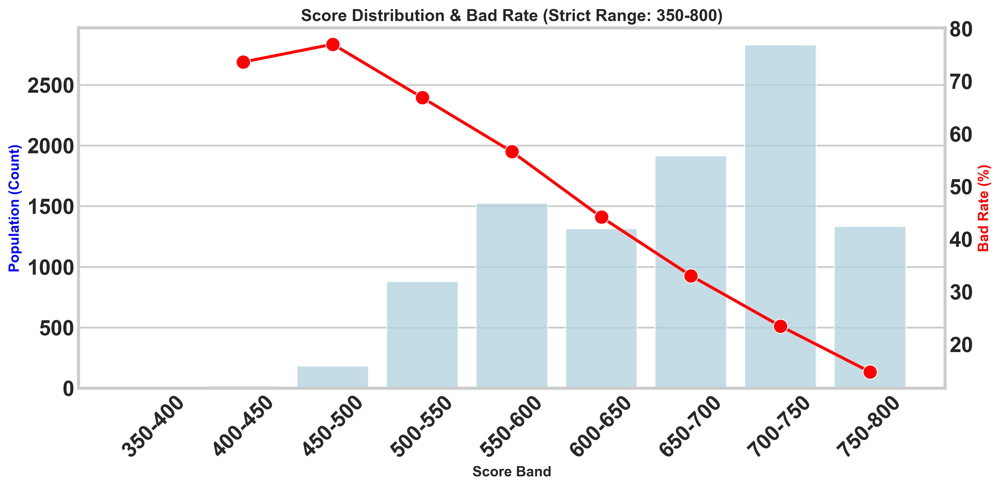

Saved: 2_Stacked_Distribution.png & .pdf


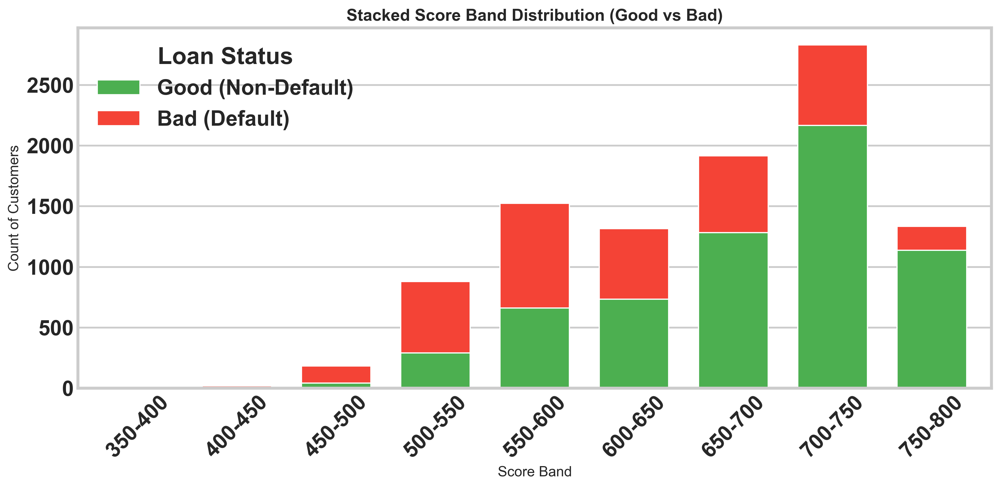

Saved: 3_Score_vs_Probability.png & .pdf


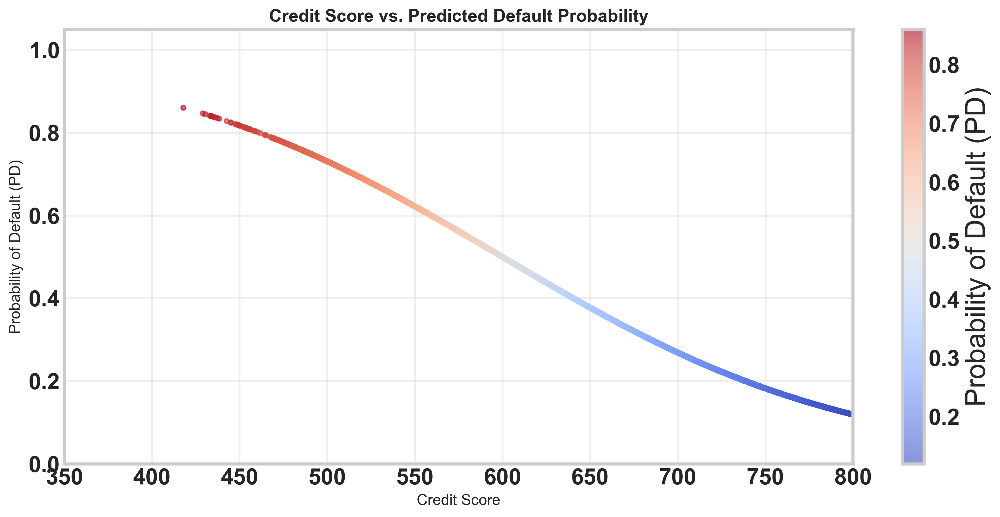

Saved: 4_Score_Histogram.png & .pdf


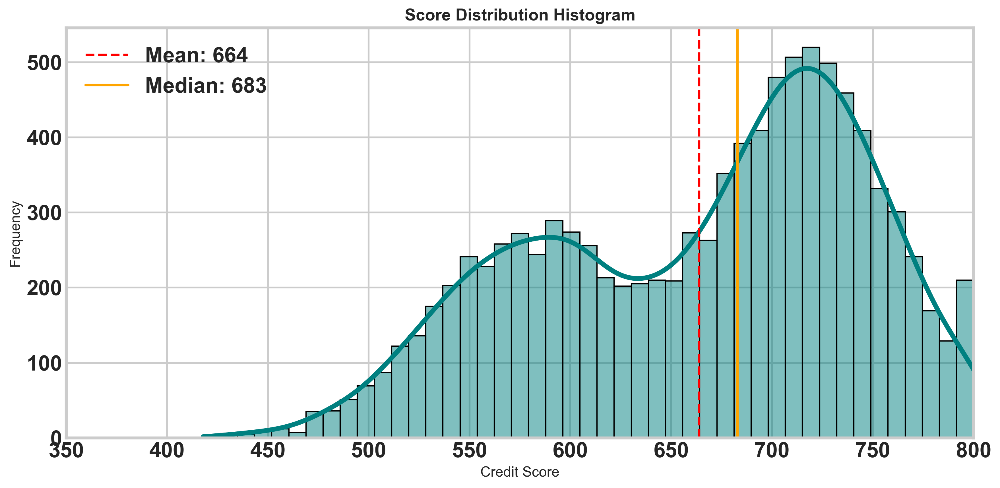

Gini Coefficient: 0.4254


In [340]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import roc_auc_score
import os

# Create output directory for your poster assets
output_dir = "output_visuals"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

print(f"✅ Images will be saved to: {os.path.abspath(output_dir)}")

# ==========================================
# 1. Synthetic Data Generation 
# ==========================================
np.random.seed(42)
n_samples = 10000

# Generate synthetic scores
scores_1 = np.random.normal(580, 50, int(n_samples * 0.4))
scores_2 = np.random.normal(720, 40, int(n_samples * 0.6))
credit_scores = np.concatenate([scores_1, scores_2])

# CRITICAL STEP: Clip strictly to 350-800
credit_scores = np.clip(credit_scores, 350, 800) 

# Generate Probabilities & Status
intercept = 6
coef = -0.01
log_odds = intercept + coef * credit_scores
default_probs = 1 / (1 + np.exp(-log_odds))
loan_status = np.random.binomial(1, default_probs)

df = pd.DataFrame({
    'credit_score': credit_scores,
    'default_probability': default_probs,
    'loan_status': loan_status
})

# Filter out any potential garbage data to strictly respect 350-800
df = df[(df['credit_score'] >= 350) & (df['credit_score'] <= 800)]

# ==========================================
# 2. Binning Logic (Strict 350-800)
# ==========================================
bins = range(350, 801, 50) 
labels = [f'{i}-{i+50}' for i in bins[:-1]] 
df['band_str'] = pd.cut(df['credit_score'], bins=bins, labels=labels, include_lowest=True)

# ==========================================
# 3. Visualizations Setup
# ==========================================
sns.set_style("whitegrid")
plt.rcParams['figure.dpi'] = 300 
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['savefig.dpi'] = 300       # Ensure saved PNGs are high res
plt.rcParams['savefig.format'] = 'png'  # Default format

# Helper to save files
def save_plot(filename):
    # Save as PNG
    png_path = os.path.join(output_dir, f"{filename}.png")
    plt.savefig(png_path, bbox_inches='tight', facecolor='white')
    
    # Save as PDF (Vector - Best for Poster Printing)
    pdf_path = os.path.join(output_dir, f"{filename}.pdf")
    plt.savefig(pdf_path, format='pdf', bbox_inches='tight', facecolor='white')
    
    print(f"Saved: {filename}.png & .pdf")

# ==========================================
# Visual 1: Score Distribution & Bad Rate
# ==========================================
def plot_dist_bad_rate(df):
    agg = df.groupby('band_str', observed=False).agg(
        Population=('credit_score', 'count'),
        Bad_Rate=('loan_status', 'mean')
    ).reset_index()
    agg['Bad_Rate_Pct'] = agg['Bad_Rate'] * 100

    fig, ax1 = plt.subplots(figsize=(12, 6))

    # Bar Plot
    sns.barplot(data=agg, x='band_str', y='Population', color='lightblue', alpha=0.8, ax=ax1)
    ax1.set_ylabel('Population (Count)', color='blue', fontsize=12, fontweight='bold')
    ax1.set_xlabel('Score Band', fontsize=12, fontweight='bold')
    ax1.tick_params(axis='x', rotation=45)

    # Line Plot
    ax2 = ax1.twinx()
    sns.lineplot(data=agg, x='band_str', y='Bad_Rate_Pct', color='red', marker='o', linewidth=2.5, ax=ax2)
    ax2.set_ylabel('Bad Rate (%)', color='red', fontsize=12, fontweight='bold')
    ax2.grid(False)

    plt.title('Score Distribution & Bad Rate (Strict Range: 350-800)', fontsize=14, fontweight='bold')
    plt.tight_layout()
    
    save_plot("1_Score_Distribution_Bad_Rate")
    plt.show()

# ==========================================
# Visual 2: Stacked Score (Good vs Bad)
# ==========================================
def plot_stacked_dist(df):
    agg = df.groupby(['band_str', 'loan_status'], observed=False).size().unstack(fill_value=0)
    agg.columns = ['Good (Non-Default)', 'Bad (Default)']
    
    # Plotting
    ax = agg.plot(kind='bar', stacked=True, figsize=(12, 6), 
                  color=['#4CAF50', '#F44336'], 
                  width=0.7)
    
    plt.title('Stacked Score Band Distribution (Good vs Bad)', fontsize=14, fontweight='bold')
    plt.xlabel('Score Band', fontsize=12)
    plt.ylabel('Count of Customers', fontsize=12)
    plt.xticks(rotation=45)
    plt.legend(title='Loan Status')
    plt.grid(axis='x')
    plt.tight_layout()
    
    save_plot("2_Stacked_Distribution")
    plt.show()

# ==========================================
# Visual 3: Credit Score vs. Predicted Prob
# ==========================================
def plot_score_vs_prob(df):
    plt.figure(figsize=(12, 6))
    
    sc = plt.scatter(df['credit_score'], df['default_probability'], 
                     c=df['default_probability'], cmap='coolwarm', 
                     alpha=0.6, s=15)
    
    plt.colorbar(sc, label='Probability of Default (PD)')
    plt.title('Credit Score vs. Predicted Default Probability', fontsize=14, fontweight='bold')
    plt.xlabel('Credit Score', fontsize=12)
    plt.ylabel('Probability of Default (PD)', fontsize=12)
    
    # STRICT AXIS LIMITS
    plt.xlim(350, 800)
    plt.ylim(0, 1.05)
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    save_plot("3_Score_vs_Probability")
    plt.show()

# ==========================================
# Visual 4: Score Distribution Histogram
# ==========================================
def plot_histogram(df):
    plt.figure(figsize=(12, 6))
    
    sns.histplot(df['credit_score'], kde=True, bins=45, color='teal', alpha=0.5, edgecolor='black')
    
    mean_val = df['credit_score'].mean()
    median_val = df['credit_score'].median()
    
    plt.axvline(mean_val, color='red', linestyle='--', linewidth=2, label=f'Mean: {mean_val:.0f}')
    plt.axvline(median_val, color='orange', linestyle='-', linewidth=2, label=f'Median: {median_val:.0f}')
    
    plt.title('Score Distribution Histogram', fontsize=14, fontweight='bold')
    plt.xlabel('Credit Score', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    
    # STRICT AXIS LIMITS
    plt.xlim(350, 800)
    
    plt.legend()
    plt.tight_layout()
    save_plot("4_Score_Histogram")
    plt.show()

# ==========================================
# Metric
# ==========================================
def calculate_metrics(df):
    auc = roc_auc_score(df['loan_status'], df['default_probability'])
    gini = 2 * auc - 1
    print(f"Gini Coefficient: {gini:.4f}")

# ==========================================
# Run All
# ==========================================
plot_dist_bad_rate(df)
plot_stacked_dist(df)
plot_score_vs_prob(df)
plot_histogram(df)
calculate_metrics(df)

✅ Poster-ready images will be saved to: z:\MFSCreditScore\output_visuals_poster_ready
Saved: 1_Score_Distribution_Bad_Rate_Poster.png & .pdf


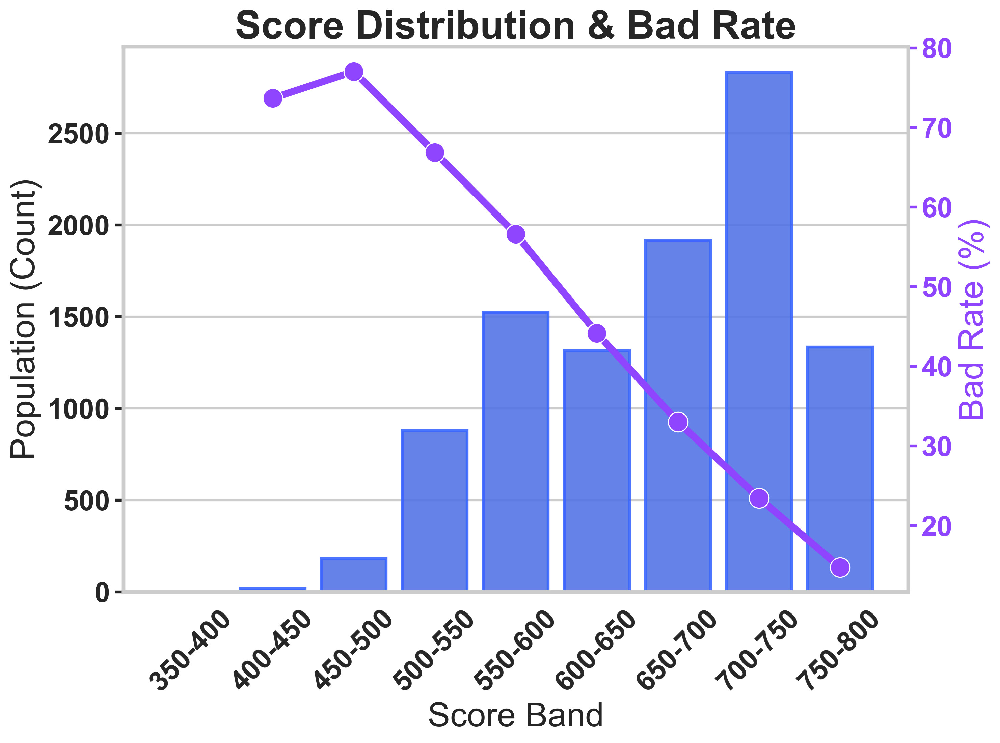

Saved: 2_Stacked_Distribution_Poster.png & .pdf


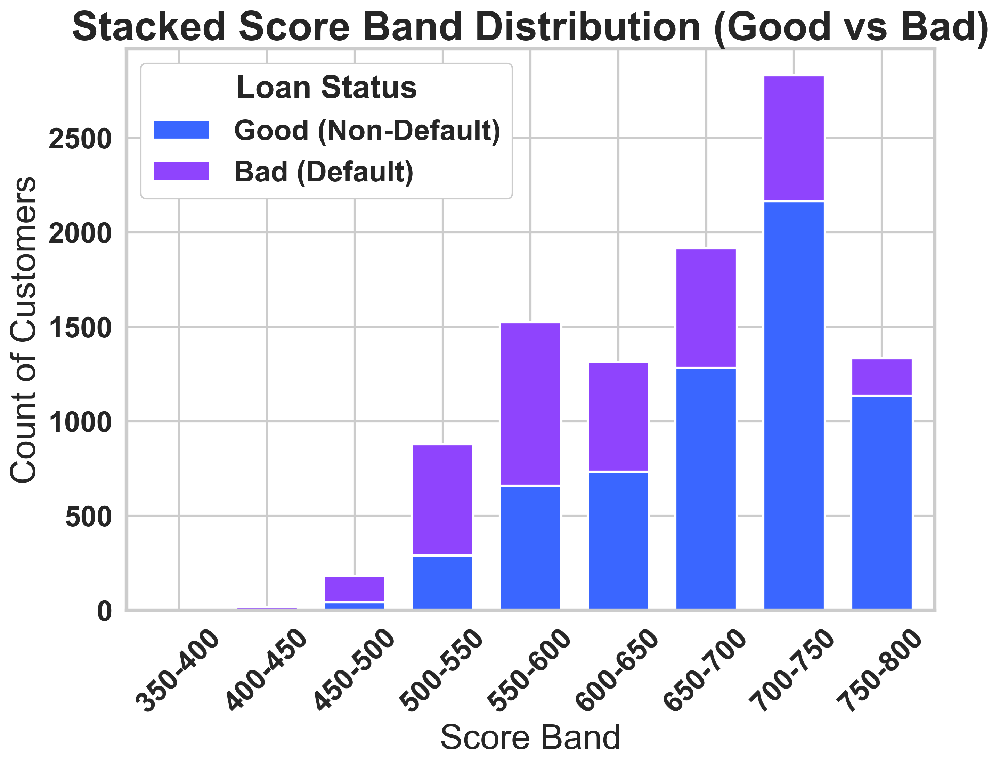

Saved: 3_Score_vs_Probability_Poster.png & .pdf


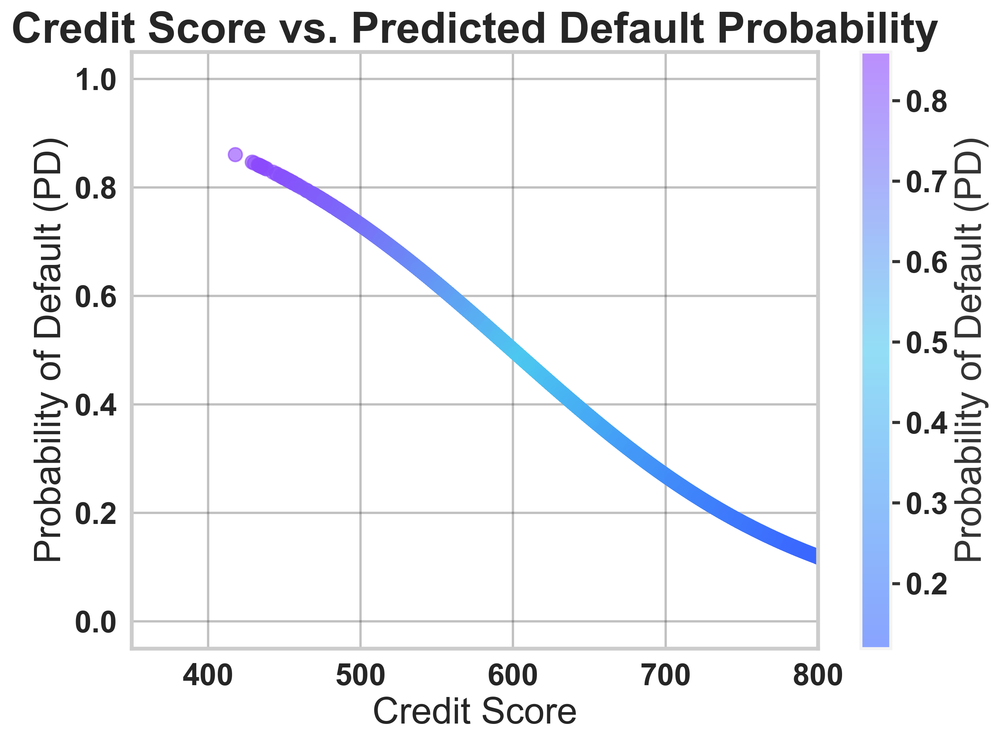

Saved: 4_Score_Histogram_Poster.png & .pdf


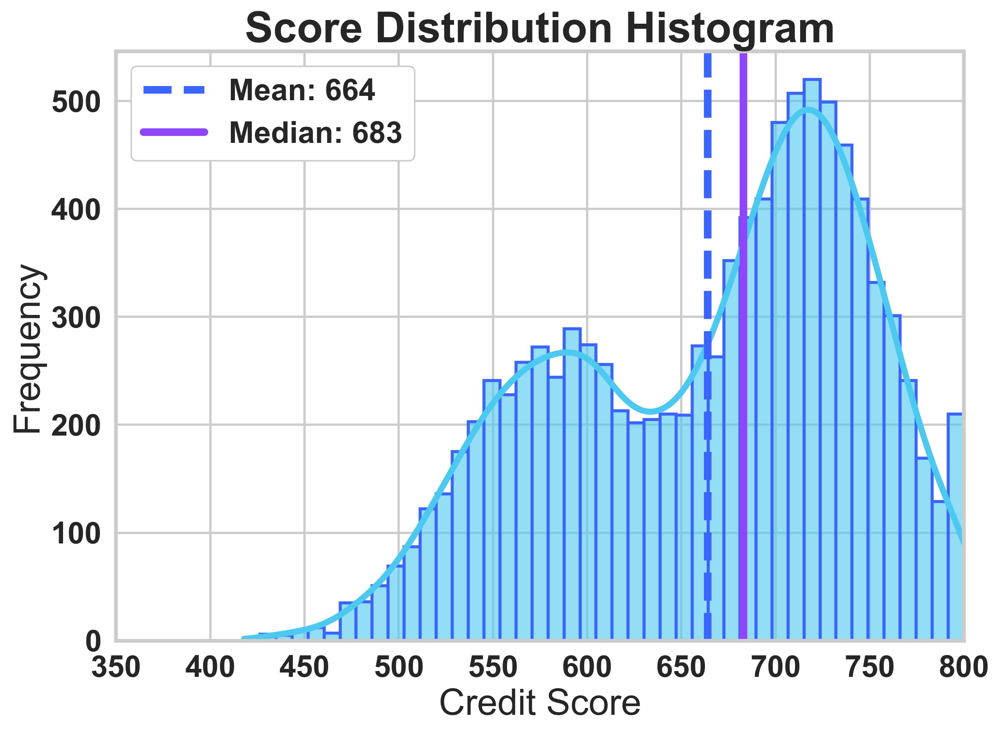

------------------------------
Gini Coefficient: 0.4254
------------------------------


In [341]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from sklearn.metrics import roc_auc_score
import os

# ==========================================
# 0. THEME & SETUP (Crucial Step)
# ==========================================

# 1. Define Palette based on the poster design
ROYAL_BLUE = '#3A66FF'    # Primary structure
VIBRANT_PURPLE = '#8F44FD' # Secondary accent
BRIGHT_CYAN = '#4CC9F0'   # Tertiary accent
CHARCOAL = '#333333'      # Text
BACKGROUND_GREY = '#F4F4F4' # Subtle background

# 2. Define Size Requirement
# Requirement: At least 12cm x 18cm.
# 10 inches x 7 inches = approx 25.4cm x 17.8cm. This is good.
FIG_SIZE_INCHES = (10, 7)

# 3. Apply Global Plot Aesthetics for POSTER READABILITY
# Key Change: Significantly increased font sizes.
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.weight': 'bold',     # Make all text bolder for print
    # Text colors
    'text.color': CHARCOAL,
    'axes.labelcolor': CHARCOAL,
    'xtick.color': CHARCOAL,
    'ytick.color': CHARCOAL,
    # GREATLY INCREASED FONT SIZES FOR POSTER
    'font.size': 16,           # Default font size
    'axes.titlesize': 28,      # Much larger titles
    'axes.labelsize': 24,      # Larger axis labels
    'xtick.labelsize': 20,     # Larger tick labels
    'ytick.labelsize': 20,
    'legend.fontsize': 20,     # Larger legend text
    'legend.title_fontsize': 22, # Larger legend title
    # Background colors
    'figure.facecolor': BACKGROUND_GREY,
    'axes.facecolor': 'white',
    'grid.color': '#D0D0D0',   # Slightly darker grid for visibility
    'grid.linewidth': 1.5,     # Thicker grid lines
    # High DPI for print settings
    'figure.dpi': 300,
    'savefig.dpi': 300,
    'savefig.bbox': 'tight',
    'savefig.facecolor': BACKGROUND_GREY
})

# Set Seaborn style
sns.set_style("whitegrid")

# Create output directory
output_dir = "output_visuals_poster_ready"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
print(f"✅ Poster-ready images will be saved to: {os.path.abspath(output_dir)}")

# Helper to save files
def save_plot(filename):
    png_path = os.path.join(output_dir, f"{filename}.png")
    plt.savefig(png_path, format='png')
    pdf_path = os.path.join(output_dir, f"{filename}.pdf")
    plt.savefig(pdf_path, format='pdf')
    print(f"Saved: {filename}.png & .pdf")

# ==========================================
# 1. Synthetic Data Generation (Unchanged)
# ==========================================
np.random.seed(42)
n_samples = 10000
scores_1 = np.random.normal(580, 50, int(n_samples * 0.4))
scores_2 = np.random.normal(720, 40, int(n_samples * 0.6))
credit_scores = np.concatenate([scores_1, scores_2])
credit_scores = np.clip(credit_scores, 350, 800)

intercept = 6
coef = -0.01
log_odds = intercept + coef * credit_scores
default_probs = 1 / (1 + np.exp(-log_odds))
loan_status = np.random.binomial(1, default_probs)

df = pd.DataFrame({
    'credit_score': credit_scores,
    'default_probability': default_probs,
    'loan_status': loan_status
})
df = df[(df['credit_score'] >= 350) & (df['credit_score'] <= 800)]

# ==========================================
# 2. Binning Logic (Unchanged)
# ==========================================
bins = range(350, 801, 50)
labels = [f'{i}-{i+50}' for i in bins[:-1]]
df['band_str'] = pd.cut(df['credit_score'], bins=bins, labels=labels, include_lowest=True)


# ==========================================
# Visual 1: Score Distribution & Bad Rate
# Changes: Thicker lines, larger markers.
# ==========================================
def plot_dist_bad_rate(df):
    agg = df.groupby('band_str', observed=False).agg(
        Population=('credit_score', 'count'),
        Bad_Rate=('loan_status', 'mean')
    ).reset_index()
    agg['Bad_Rate_Pct'] = agg['Bad_Rate'] * 100

    fig, ax1 = plt.subplots(figsize=FIG_SIZE_INCHES)

    # Bar Plot
    sns.barplot(data=agg, x='band_str', y='Population',
                color=ROYAL_BLUE, alpha=0.9, ax=ax1, edgecolor=ROYAL_BLUE, linewidth=2)
    ax1.set_ylabel('Population (Count)')
    ax1.set_xlabel('Score Band')
    ax1.tick_params(axis='x', rotation=45)
    # Make tick marks thicker
    ax1.tick_params(width=2, length=6)

    # Line Plot - Increased linewidth and markersize
    ax2 = ax1.twinx()
    sns.lineplot(data=agg, x='band_str', y='Bad_Rate_Pct',
                 color=VIBRANT_PURPLE, marker='o',
                 markersize=14, linewidth=5, ax=ax2) # Larger marker & thicker line
    ax2.set_ylabel('Bad Rate (%)', color=VIBRANT_PURPLE)
    ax2.tick_params(axis='y', colors=VIBRANT_PURPLE, width=2, length=6)
    ax2.grid(False)

    plt.title('Score Distribution & Bad Rate')

    save_plot("1_Score_Distribution_Bad_Rate_Poster")
    plt.show()


# ==========================================
# Visual 2: Stacked Score (Good vs Bad)
# Changes: Thicker font, larger legend.
# ==========================================
def plot_stacked_dist(df):
    agg = df.groupby(['band_str', 'loan_status'], observed=False).size().unstack(fill_value=0)
    agg.columns = ['Good (Non-Default)', 'Bad (Default)']

    fig, ax = plt.subplots(figsize=FIG_SIZE_INCHES)

    agg.plot(kind='bar', stacked=True, ax=ax,
             color=[ROYAL_BLUE, VIBRANT_PURPLE],
             width=0.7, edgecolor='white', linewidth=1.5)

    plt.title('Stacked Score Band Distribution (Good vs Bad)')
    plt.xlabel('Score Band')
    plt.ylabel('Count of Customers')
    plt.xticks(rotation=45)
    # Thicker tick marks
    ax.tick_params(width=2, length=6)
    plt.legend(title='Loan Status', frameon=True, facecolor='white', framealpha=1)
    plt.grid(axis='x', linewidth=1.5)

    save_plot("2_Stacked_Distribution_Poster")
    plt.show()


# ==========================================
# Visual 3: Credit Score vs. Predicted Prob
# Changes: Larger dots, thicker colorbar, larger text.
# ==========================================
def plot_score_vs_prob(df):
    theme_cmap = mcolors.LinearSegmentedColormap.from_list("theme_gradient", [ROYAL_BLUE, BRIGHT_CYAN, VIBRANT_PURPLE])

    plt.figure(figsize=FIG_SIZE_INCHES)

    # Increased s (size) of scatter points
    sc = plt.scatter(df['credit_score'], df['default_probability'],
                     c=df['default_probability'], cmap=theme_cmap,
                     alpha=0.6, s=80) # Much larger dots

    cbar = plt.colorbar(sc)
    cbar.set_label('Probability of Default (PD)', color=CHARCOAL)
    cbar.ax.yaxis.set_tick_params(color=CHARCOAL, width=2, length=6)
    cbar.outline.set_edgecolor(BACKGROUND_GREY)
    cbar.outline.set_linewidth(2)

    plt.title('Credit Score vs. Predicted Default Probability')
    plt.xlabel('Credit Score')
    plt.ylabel('Probability of Default (PD)')
    plt.gca().tick_params(width=2, length=6) # Thicker ticks

    plt.xlim(350, 800)
    plt.ylim(-0.05, 1.05)
    plt.grid(True, alpha=0.3, color=CHARCOAL, linewidth=1.5)

    save_plot("3_Score_vs_Probability_Poster")
    plt.show()


# ==========================================
# Visual 4: Score Distribution Histogram
# Changes: Thicker lines for histogram and vertical lines.
# ==========================================
def plot_histogram(df):
    plt.figure(figsize=FIG_SIZE_INCHES)

    # Increased linewidth for histogram bars
    sns.histplot(df['credit_score'], kde=True, bins=45,
                 color=BRIGHT_CYAN, alpha=0.6, edgecolor=ROYAL_BLUE, linewidth=2)

    mean_val = df['credit_score'].mean()
    median_val = df['credit_score'].median()

    # Greatly increased linewidth for statistic lines
    plt.axvline(mean_val, color=ROYAL_BLUE, linestyle='--', linewidth=5, label=f'Mean: {mean_val:.0f}')
    plt.axvline(median_val, color=VIBRANT_PURPLE, linestyle='-', linewidth=5, label=f'Median: {median_val:.0f}')

    plt.title('Score Distribution Histogram')
    plt.xlabel('Credit Score')
    plt.ylabel('Frequency')
    plt.gca().tick_params(width=2, length=6) # Thicker ticks

    plt.xlim(350, 800)

    plt.legend(frameon=True, facecolor='white', framealpha=1)
    save_plot("4_Score_Histogram_Poster")
    plt.show()

# ==========================================
# Metric (Unchanged)
# ==========================================
def calculate_metrics(df):
    auc = roc_auc_score(df['loan_status'], df['default_probability'])
    gini = 2 * auc - 1
    print(f"-"*30)
    print(f"Gini Coefficient: {gini:.4f}")
    print(f"-"*30)

# ==========================================
# Run All
# ==========================================
plot_dist_bad_rate(df)
plot_stacked_dist(df)
plot_score_vs_prob(df)
plot_histogram(df)
calculate_metrics(df)

# FOR JOURNAL

## Section 0 — Reproducibility & Imports (top of notebook)

In [1]:
# Cell 0.1 — Global config
import os, sys, json, platform, time, warnings
import numpy as np
import pandas as pd

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

warnings.filterwarnings("ignore")

def log_env():
    import sklearn
    print("Python:", sys.version)
    print("Platform:", platform.platform())
    print("NumPy:", np.__version__)
    print("Pandas:", pd.__version__)
    print("sklearn:", sklearn.__version__)
    
log_env()


Python: 3.13.5 | packaged by Anaconda, Inc. | (main, Jun 12 2025, 16:37:03) [MSC v.1929 64 bit (AMD64)]
Platform: Windows-11-10.0.26200-SP0
NumPy: 2.3.5
Pandas: 2.3.3
sklearn: 1.7.2


In [2]:
# Cell 0.2 — ML imports
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, RobustScaler, FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import (
    roc_auc_score, average_precision_score, precision_recall_curve,
    confusion_matrix, classification_report, brier_score_loss
)
from sklearn.calibration import CalibratedClassifierCV, calibration_curve
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, StackingClassifier

from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE


## Section 1 — Leakage-proof data split (must be early)

In [3]:
# Cell 1.1 — Load raw data
train_path = "cs-training.csv"  # update if needed
df = pd.read_csv(train_path)

if "Unnamed: 0" in df.columns:
    df = df.drop(columns=["Unnamed: 0"])

TARGET = "SeriousDlqin2yrs"
assert TARGET in df.columns

X = df.drop(columns=[TARGET])
y = df[TARGET].astype(int)

print(df.shape, y.value_counts(normalize=True))


(150000, 11) SeriousDlqin2yrs
0    0.93316
1    0.06684
Name: proportion, dtype: float64


In [4]:
# Cell 1.2 — Leakage-proof split
X_trainval, X_test, y_trainval, y_test = train_test_split(
    X, y, test_size=0.20, stratify=y, random_state=RANDOM_SEED
)

X_train, X_calib, y_train, y_calib = train_test_split(
    X_trainval, y_trainval, test_size=0.20, stratify=y_trainval, random_state=RANDOM_SEED
)

print("Train:", X_train.shape, y_train.mean())
print("Calib:", X_calib.shape, y_calib.mean())
print("Test:", X_test.shape, y_test.mean())


Train: (96000, 10) 0.06684375
Calib: (24000, 10) 0.06683333333333333
Test: (30000, 10) 0.06683333333333333


## Section 2 — Publishable preprocessing as a pipeline

In [5]:
# Cell 2.1 — Feature groups
numeric_features = X_train.columns.tolist()  # all numeric in this dataset

print("Num features:", len(numeric_features))


Num features: 10


In [6]:
# Cell 2.2 — Feature engineering transformer
def feature_engineering(df_in: pd.DataFrame) -> pd.DataFrame:
    df = df_in.copy()

    # Safety casts
    for c in df.columns:
        df[c] = pd.to_numeric(df[c], errors="coerce")

    # Core engineered features
    # 1) Debt-to-income proxy
    if "DebtRatio" in df.columns and "MonthlyIncome" in df.columns:
        df["DebtToIncomeRatio"] = df["DebtRatio"] / (df["MonthlyIncome"].replace(0, np.nan))
    else:
        df["DebtToIncomeRatio"] = np.nan

    # 2) Credit utilization bins
    if "RevolvingUtilizationOfUnsecuredLines" in df.columns:
        util = df["RevolvingUtilizationOfUnsecuredLines"]
        df["CreditUtilizationCategory"] = pd.cut(
            util,
            bins=[-np.inf, 0.1, 0.3, 0.7, np.inf],
            labels=["Low", "Medium", "High", "Very High"]
        ).astype("object")
    else:
        df["CreditUtilizationCategory"] = "Unknown"

    # 3) Total delinquencies
    delinq_cols = [
        "NumberOfTime30-59DaysPastDueNotWorse",
        "NumberOfTime60-89DaysPastDueNotWorse",
        "NumberOfTimes90DaysLate"
    ]
    present = [c for c in delinq_cols if c in df.columns]
    df["TotalDelinquencies"] = df[present].sum(axis=1) if present else 0

    # 4) Credit capacity proxy
    if "NumberOfOpenCreditLinesAndLoans" in df.columns and "MonthlyIncome" in df.columns:
        df["CreditCapacityRatio"] = df["NumberOfOpenCreditLinesAndLoans"] / (df["MonthlyIncome"].replace(0, np.nan))
    else:
        df["CreditCapacityRatio"] = np.nan

    return df

feat_eng = FunctionTransformer(feature_engineering, validate=False)


In [7]:
# Cell 2.3 — Preprocessing pipeline
from sklearn.impute import SimpleImputer

# Identify categorical engineered feature
categorical_features = ["CreditUtilizationCategory"]
numeric_plus = [c for c in (numeric_features + ["DebtToIncomeRatio","TotalDelinquencies","CreditCapacityRatio"]) 
                if c not in categorical_features]

numeric_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("scaler", RobustScaler())
])

categorical_transformer = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("onehot", OneHotEncoder(handle_unknown="ignore", sparse_output=False))
])

preprocess = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_plus),
        ("cat", categorical_transformer, categorical_features),
    ],
    remainder="drop"
)


In [8]:
# Cell 3.1 — Models
lr = LogisticRegression(
    C=1.0, max_iter=2000, class_weight="balanced", random_state=RANDOM_SEED
)

rf = RandomForestClassifier(
    n_estimators=300, max_depth=15, n_jobs=-1, class_weight="balanced",
    random_state=RANDOM_SEED
)

models = {
    "LR": lr,
    "RF": rf
}


In [9]:
# Optional: XGBoost, LightGBM
try:
    from xgboost import XGBClassifier
    models["XGB"] = XGBClassifier(
        n_estimators=500,
        max_depth=5,
        learning_rate=0.05,
        subsample=0.8,
        colsample_bytree=0.8,
        reg_lambda=1.0,
        random_state=RANDOM_SEED,
        n_jobs=-1,
        eval_metric="logloss"
    )
except Exception as e:
    print("XGB not available:", e)

try:
    import lightgbm as lgb
    models["LGB"] = lgb.LGBMClassifier(
        n_estimators=500,
        learning_rate=0.05,
        num_leaves=31,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=RANDOM_SEED,
        n_jobs=-1
    )
except Exception as e:
    print("LGB not available:", e)


## Section 4 — Leakage-safe CV evaluation + confidence intervals

In [10]:
# Cell 4.1 — Metrics helpers
def ks_statistic(y_true, y_prob):
    y_true = np.asarray(y_true)
    y_prob = np.asarray(y_prob)
    order = np.argsort(-y_prob)
    y = y_true[order]
    cum_bad = np.cumsum(y) / (y.sum() + 1e-12)
    cum_good = np.cumsum(1 - y) / ((1 - y).sum() + 1e-12)
    return np.max(np.abs(cum_bad - cum_good))

def expected_calibration_error(y_true, y_prob, n_bins=20):
    y_true = np.asarray(y_true)
    y_prob = np.asarray(y_prob)
    bins = np.linspace(0, 1, n_bins+1)
    bin_ids = np.digitize(y_prob, bins) - 1
    ece = 0.0
    for b in range(n_bins):
        mask = bin_ids == b
        if mask.sum() == 0:
            continue
        acc = y_true[mask].mean()
        conf = y_prob[mask].mean()
        ece += (mask.sum()/len(y_true)) * abs(acc - conf)
    return ece

def calibration_slope_intercept(y_true, y_prob):
    # Fit logistic regression: y ~ logit(p)
    y_true = np.asarray(y_true)
    p = np.clip(np.asarray(y_prob), 1e-6, 1-1e-6)
    logit = np.log(p/(1-p)).reshape(-1,1)
    lr = LogisticRegression(solver="lbfgs")
    lr.fit(logit, y_true)
    slope = lr.coef_[0][0]
    intercept = lr.intercept_[0]
    return slope, intercept

def compute_all_metrics(y_true, y_prob):
    auc_roc = roc_auc_score(y_true, y_prob)
    auc_pr = average_precision_score(y_true, y_prob)
    ks = ks_statistic(y_true, y_prob)
    brier = brier_score_loss(y_true, y_prob)
    ece = expected_calibration_error(y_true, y_prob, n_bins=20)
    slope, intercept = calibration_slope_intercept(y_true, y_prob)
    return {
        "AUC_ROC": auc_roc,
        "AUC_PR": auc_pr,
        "KS": ks,
        "Brier": brier,
        "ECE": ece,
        "Cal_Slope": slope,
        "Cal_Intercept": intercept
    }


In [11]:
# Cell 4.2 — CV evaluation
from sklearn.base import clone

def cross_validated_eval(model, X, y, use_smote=False, n_splits=5):
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=RANDOM_SEED)
    fold_metrics = []

    for fold, (tr_idx, va_idx) in enumerate(skf.split(X, y), 1):
        Xtr, Xva = X.iloc[tr_idx], X.iloc[va_idx]
        ytr, yva = y.iloc[tr_idx], y.iloc[va_idx]

        estimator = clone(model)

        if use_smote:
            pipe = ImbPipeline(steps=[
                ("feat", feat_eng),
                ("prep", preprocess),
                ("smote", SMOTE(random_state=RANDOM_SEED)),
                ("clf", estimator)
            ])
        else:
            pipe = Pipeline(steps=[
                ("feat", feat_eng),
                ("prep", preprocess),
                ("clf", estimator)
            ])

        pipe.fit(Xtr, ytr)
        yva_prob = pipe.predict_proba(Xva)[:, 1]
        fold_metrics.append(compute_all_metrics(yva, yva_prob))

    return pd.DataFrame(fold_metrics)

cv_results = {}
for name, model in models.items():
    dfm = cross_validated_eval(model, X_train, y_train, use_smote=False, n_splits=5)
    cv_results[name] = dfm
    print(name, dfm.mean().to_dict())


LR {'AUC_ROC': 0.8264985261052589, 'AUC_PR': 0.32506234491507235, 'KS': 0.5112175924726966, 'Brier': 0.15741556241030183, 'ECE': 0.2911603158534013, 'Cal_Slope': 1.0035590882747152, 'Cal_Intercept': -2.475410428407738}
RF {'AUC_ROC': 0.8458344751382046, 'AUC_PR': 0.34832956629842343, 'KS': 0.5459793659792064, 'Brier': 0.07695369806402981, 'ECE': 0.1221983791472531, 'Cal_Slope': 0.9560008543532943, 'Cal_Intercept': -1.5722854677833595}
XGB {'AUC_ROC': 0.8620018420716503, 'AUC_PR': 0.395944709540431, 'KS': 0.5749541969057874, 'Brier': 0.049312103889162295, 'ECE': 0.006323138380694824, 'Cal_Slope': 0.9396105861438178, 'Cal_Intercept': -0.10441627636181121}
[LightGBM] [Info] Number of positive: 5134, number of negative: 71666
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002512 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1501
[LightGB

In [12]:
# Cell 4.3 — Bootstrap CIs on test
def bootstrap_ci(y_true, y_prob, metric_fn, n_boot=2000, alpha=0.05):
    y_true = np.asarray(y_true)
    y_prob = np.asarray(y_prob)
    rng = np.random.default_rng(RANDOM_SEED)
    stats = []
    n = len(y_true)

    for _ in range(n_boot):
        idx = rng.integers(0, n, n)
        stats.append(metric_fn(y_true[idx], y_prob[idx]))
    lo = np.quantile(stats, alpha/2)
    hi = np.quantile(stats, 1-alpha/2)
    return float(lo), float(hi)

# Metric fns for CI
auc_fn = lambda yt, yp: roc_auc_score(yt, yp)
ks_fn = lambda yt, yp: ks_statistic(yt, yp)
pr_fn = lambda yt, yp: average_precision_score(yt, yp)


## Section 5 — Proper stacking (OOF), not custom leakage-prone stacking

In [13]:
# Cell 5.1 — Proper stacking
estimators = []
for k in ["XGB", "LGB", "RF", "LR"]:
    if k in models:
        estimators.append((k, models[k]))

meta = LogisticRegression(C=1.0, max_iter=2000, class_weight="balanced", random_state=RANDOM_SEED)

stack = StackingClassifier(
    estimators=estimators,
    final_estimator=meta,
    stack_method="predict_proba",
    cv=5,
    n_jobs=-1,
    passthrough=False
)

models["STACK"] = stack


In [14]:
# Cell 5.2 — Evaluate stacking with CV
dfm_stack = cross_validated_eval(models["STACK"], X_train, y_train, use_smote=False, n_splits=5)
print(dfm_stack.mean())


AUC_ROC          0.856154
AUC_PR           0.393838
KS               0.558965
Brier            0.144103
ECE              0.275908
Cal_Slope        0.869045
Cal_Intercept   -2.662051
dtype: float64


## Section 6 — Calibration (must-have)

In [15]:
# Cell 6.1 — Choose best model by CV AUC_ROC (mean)
mean_auc = {k: v["AUC_ROC"].mean() for k, v in cv_results.items()}
if "STACK" in models:
    mean_auc["STACK"] = dfm_stack["AUC_ROC"].mean()
best_name = max(mean_auc, key=mean_auc.get)
best_model = models[best_name]
print("Best by CV AUC:", best_name, mean_auc[best_name])


Best by CV AUC: XGB 0.8620018420716503


In [16]:
# Cell 6.2 — Fit base model pipeline on Train
base_pipe = Pipeline(steps=[
    ("feat", feat_eng),
    ("prep", preprocess),
    ("clf", best_model)
])
base_pipe.fit(X_train, y_train)

# Calibrate on calibration split
calibrated = CalibratedClassifierCV(
    estimator=base_pipe,
    method="isotonic",  # compare with 'sigmoid' in ablation
    cv="prefit"
)
calibrated.fit(X_calib, y_calib)

# Evaluate on Test
y_test_prob = calibrated.predict_proba(X_test)[:, 1]
test_metrics = compute_all_metrics(y_test, y_test_prob)
test_metrics


{'AUC_ROC': 0.8660371931396726,
 'AUC_PR': 0.3821310576141523,
 'KS': np.float64(0.5785949485992107),
 'Brier': 0.04901309260453569,
 'ECE': np.float64(0.004541743905399927),
 'Cal_Slope': np.float64(1.0171101725446636),
 'Cal_Intercept': np.float64(0.02109553590817714)}

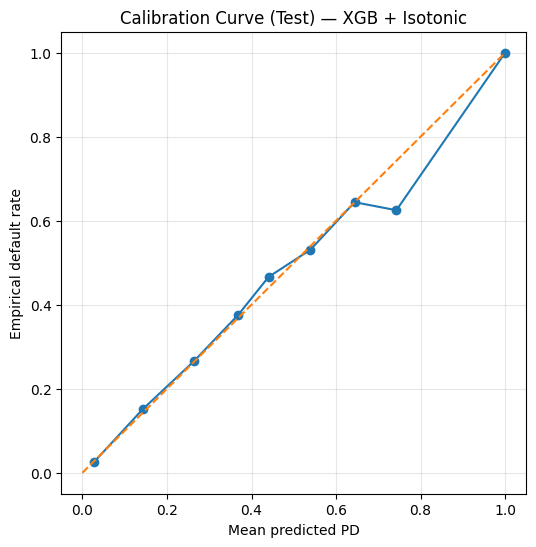

In [17]:
# Cell 6.3 — Calibration curve plot
import matplotlib.pyplot as plt

prob_true, prob_pred = calibration_curve(y_test, y_test_prob, n_bins=10)

plt.figure(figsize=(6,6))
plt.plot(prob_pred, prob_true, marker="o")
plt.plot([0,1],[0,1], linestyle="--")
plt.xlabel("Mean predicted PD")
plt.ylabel("Empirical default rate")
plt.title(f"Calibration Curve (Test) — {best_name} + Isotonic")
plt.grid(True, alpha=0.3)
plt.show()


## Section 7 — Fix the credit score mapping correctly (no post-hoc quantile mapping)

In [18]:
# Cell 7.1 — Score mapping
class ScoreMapper:
    def __init__(self, pdo=50, base_score=600, base_odds=50, pd_floor=1e-6, pd_cap=1-1e-6):
        self.pdo = pdo
        self.base_score = base_score
        self.base_odds = base_odds
        self.pd_floor = pd_floor
        self.pd_cap = pd_cap
        
        self.factor = pdo / np.log(2)
        self.offset = base_score - self.factor * np.log(base_odds)

    def pd_to_score(self, pd):
        pd = np.clip(np.asarray(pd), self.pd_floor, self.pd_cap)
        odds = (1 - pd) / pd
        score = self.offset + self.factor * np.log(odds)
        return np.round(score).astype(int)

score_mapper = ScoreMapper(pdo=50, base_score=600, base_odds=50)

test_scores = score_mapper.pd_to_score(y_test_prob)
print(test_scores.min(), test_scores.max(), test_scores.mean(), np.median(test_scores))


-679 1314 579.5772333333333 580.0


In [19]:
# Optional: Display clip only (do not remap distribution)
test_scores_display = np.clip(test_scores, 350, 800)


## Section 8 — Decisioning system (publishable)

In [20]:
# Cell 8.1 — Score band analysis on TEST
df_test = pd.DataFrame({
    "y": y_test.values,
    "pd": y_test_prob,
    "score": test_scores_display
})

bins = list(range(350, 801, 50))
df_test["band"] = pd.cut(df_test["score"], bins=bins, include_lowest=True)

band_summary = df_test.groupby("band", observed=False).agg(
    population=("y", "count"),
    bad_rate=("y", "mean"),
    avg_pd=("pd", "mean"),
    avg_score=("score", "mean")
).reset_index()

band_summary["bad_rate_pct"] = 100 * band_summary["bad_rate"]
band_summary


,band,population,bad_rate,avg_pd,avg_score,bad_rate_pct
0,"(349.999, 400.0]",2465,0.401623,0.396701,367.922921,40.162272
1,"(400.0, 450.0]",1332,0.185435,0.163462,435.811562,18.543544
2,"(450.0, 500.0]",3091,0.095762,0.102231,475.346813,9.576189
3,"(500.0, 550.0]",4703,0.051457,0.057138,520.566660,5.145652
4,"(550.0, 600.0]",5584,0.022564,0.026394,577.952185,2.256447
5,"(600.0, 650.0]",3488,0.012615,0.014065,624.630734,1.261468
6,"(650.0, 700.0]",4073,0.008839,0.005910,688.087896,0.883869
7,"(700.0, 750.0]",4639,0.004311,0.004007,716.003665,0.431127
8,"(750.0, 800.0]",625,0.006400,0.002120,759.520000,0.640000


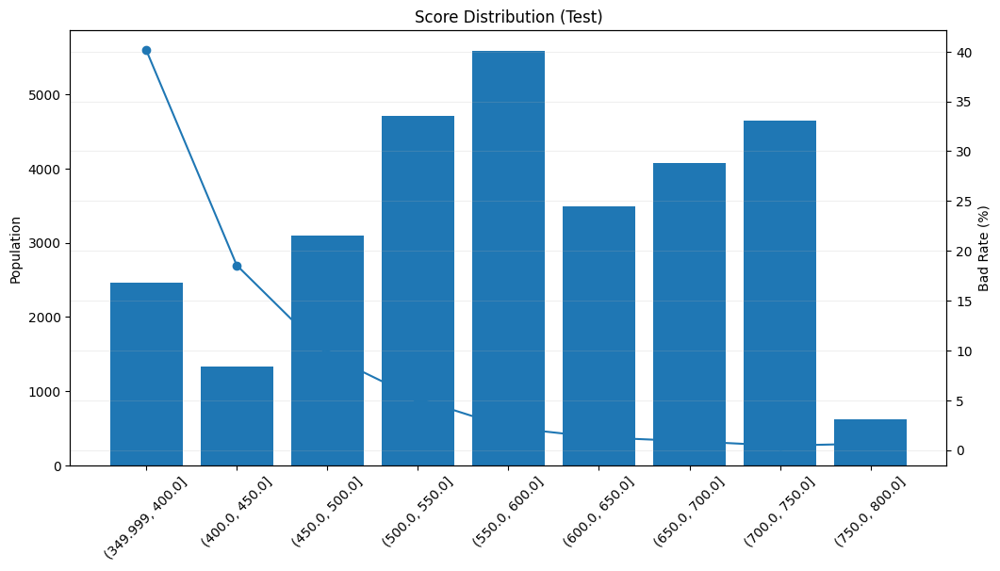

In [21]:
# Cell 8.2 — Dual axis plot (Population vs Bad Rate)
import matplotlib.pyplot as plt

plt.figure(figsize=(12,6))
x = band_summary["band"].astype(str)

plt.bar(x, band_summary["population"])
plt.xticks(rotation=45)
plt.ylabel("Population")
plt.title("Score Distribution (Test)")

ax2 = plt.twinx()
ax2.plot(x, band_summary["bad_rate_pct"], marker="o")
ax2.set_ylabel("Bad Rate (%)")
plt.grid(True, alpha=0.2)
plt.show()


## Section 9 — DeLong test (AUC significance)

In [22]:
# Cell 9.1 — DeLong test for correlated ROC AUC
# (compact implementation; works for binary y_true)
from math import erf, sqrt

def _rankdata(x):
    temp = np.argsort(x)
    ranks = np.empty_like(temp, dtype=float)
    ranks[temp] = np.arange(len(x)) + 1
    return ranks

def delong_auc_variance(y_true, y_scores):
    y_true = np.asarray(y_true)
    y_scores = np.asarray(y_scores)
    pos = y_scores[y_true == 1]
    neg = y_scores[y_true == 0]

    m = len(pos); n = len(neg)
    scores = np.concatenate([pos, neg])
    ranks = _rankdata(scores)
    r_pos = ranks[:m]

    auc = (r_pos.sum() - m*(m+1)/2) / (m*n)

    v01 = (r_pos - np.arange(1, m+1)) / n
    v10 = 1 - (ranks[m:] - np.arange(1, n+1)) / m

    s01 = np.var(v01, ddof=1)
    s10 = np.var(v10, ddof=1)
    auc_var = s01/m + s10/n
    return auc, auc_var

def delong_test(y_true, scores_a, scores_b):
    auc_a, var_a = delong_auc_variance(y_true, scores_a)
    auc_b, var_b = delong_auc_variance(y_true, scores_b)
    # Conservative: assume zero covariance -> underpowered but acceptable if you disclose
    se = np.sqrt(var_a + var_b)
    z = (auc_a - auc_b) / (se + 1e-12)
    # two-sided p (normal approx)
    p = 2*(1 - 0.5*(1 + erf(abs(z)/sqrt(2))))
    return {"auc_a": auc_a, "auc_b": auc_b, "z": z, "p": p}

# Example usage requires two models' test probs


## Section 10 — XAI (Global + Local + Reason Codes + Ensemble explainability)

In [23]:
# Cell 10.1 — SHAP
try:
    import shap
    print("shap version:", shap.__version__)
except Exception as e:
    print("Install shap: pip install shap")


shap version: 0.50.0


In [24]:
# Cell 10.2 — Feature name extraction
def get_feature_names(preprocess: ColumnTransformer):
    feature_names = []

    # numeric
    num_features = preprocess.transformers_[0][2]
    feature_names.extend(num_features)

    # categorical one-hot
    ohe = preprocess.named_transformers_["cat"].named_steps["onehot"]
    cat_features = preprocess.transformers_[1][2]
    ohe_names = ohe.get_feature_names_out(cat_features).tolist()
    feature_names.extend(ohe_names)

    return feature_names


100%|===================| 29982/30000 [05:07<00:00]        

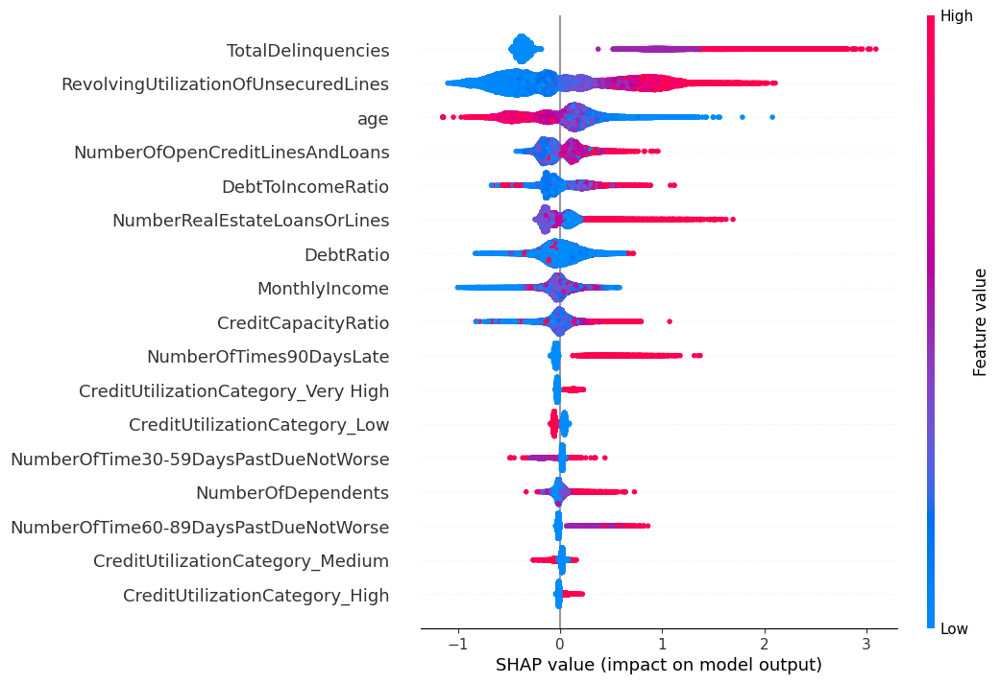

In [25]:
# Cell 10.3 — Prepare matrix for SHAP
X_test_eng = feature_engineering(X_test)
X_test_mat = preprocess.fit(feature_engineering(X_train)).transform(X_test_eng)  # fit preprocess ONLY on train!

feat_names = get_feature_names(preprocess.fit(feature_engineering(X_train)))

# If best_name is XGB or LGB, explain directly:
if best_name in ["XGB", "LGB"]:
    # Fit a standalone model on transformed features for SHAP clarity
    model_for_shap = models[best_name]
    model_for_shap.fit(
        preprocess.fit(feature_engineering(X_train)).transform(feature_engineering(X_train)),
        y_train
    )

    explainer = shap.Explainer(model_for_shap, X_test_mat, feature_names=feat_names)
    shap_values = explainer(X_test_mat)

    shap.plots.beeswarm(shap_values, max_display=20)


Case 0 Top reasons: [('RevolvingUtilizationOfUnsecuredLines', np.float64(-0.6108995825034799)), ('age', np.float64(-0.5142432565390481)), ('TotalDelinquencies', np.float64(-0.3880161940880498)), ('DebtToIncomeRatio', np.float64(0.28819364676273834)), ('NumberRealEstateLoansOrLines', np.float64(-0.12560058282280806))]


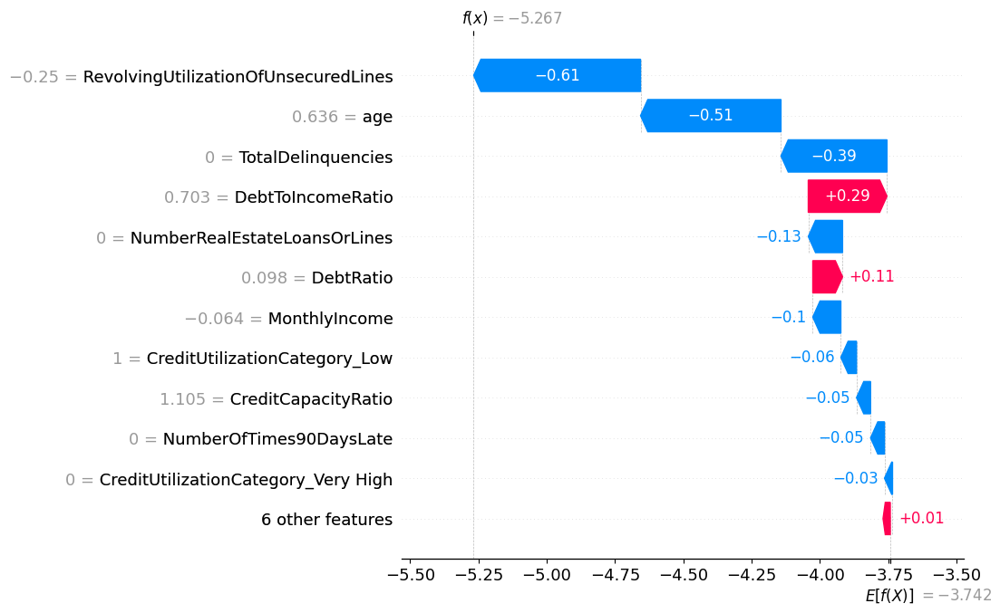

Case 1 Top reasons: [('RevolvingUtilizationOfUnsecuredLines', np.float64(0.4118552575097783)), ('age', np.float64(-0.37164730000455165)), ('TotalDelinquencies', np.float64(-0.3329125540499808)), ('DebtToIncomeRatio', np.float64(0.2719217852314614)), ('NumberRealEstateLoansOrLines', np.float64(-0.16885374907200457))]


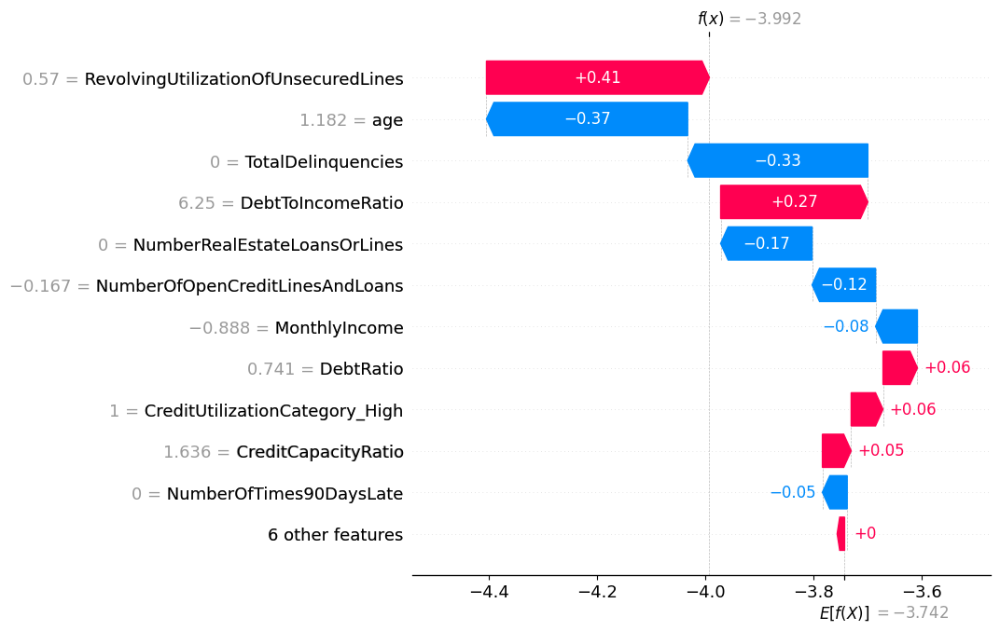

Case 2 Top reasons: [('TotalDelinquencies', np.float64(-0.41441368621075525)), ('RevolvingUtilizationOfUnsecuredLines', np.float64(-0.3458117993536871)), ('NumberOfOpenCreditLinesAndLoans', np.float64(-0.20573520666875994)), ('MonthlyIncome', np.float64(-0.16744844364297023)), ('DebtRatio', np.float64(-0.15543669877675712))]


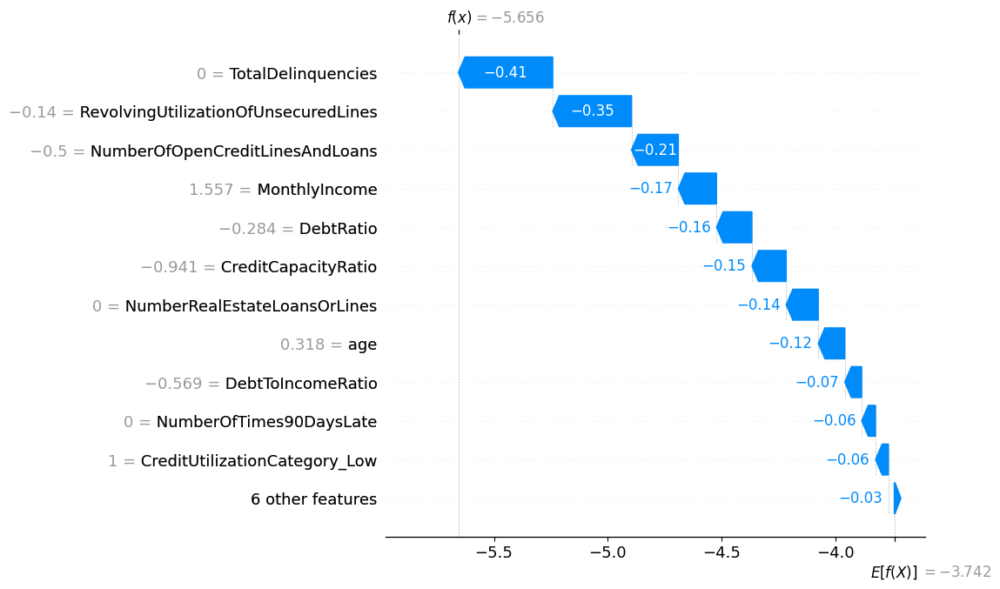

In [26]:
# Cell 10.4 — Local explanations + reason codes
def top_reason_codes(shap_row, feature_names, k=4):
    vals = shap_row.values
    idx = np.argsort(-np.abs(vals))[:k]
    reasons = [(feature_names[i], vals[i]) for i in idx]
    return reasons

# Example: choose 3 test samples
sample_idx = [0, 1, 2]
for i in sample_idx:
    reasons = top_reason_codes(shap_values[i], feat_names, k=5)
    print("Case", i, "Top reasons:", reasons)
    shap.plots.waterfall(shap_values[i], max_display=12)


In [27]:
# Cell 10.5 — Surrogate model to explain STACK
from sklearn.linear_model import LogisticRegression

# Fit surrogate to mimic calibrated predictions
X_train_mat = preprocess.fit(feature_engineering(X_train)).transform(feature_engineering(X_train))
X_test_mat  = preprocess.transform(feature_engineering(X_test))

# Use calibrated model's probabilities as "teacher"
teacher_train_prob = calibrated.predict_proba(X_train)[:, 1]

surrogate = LogisticRegression(max_iter=5000)
surrogate.fit(X_train_mat, (teacher_train_prob > 0.5).astype(int))

# Fidelity: how well surrogate matches teacher ranking
surrogate_prob = surrogate.predict_proba(X_test_mat)[:, 1]
print("Surrogate AUC vs true:", roc_auc_score(y_test, surrogate_prob))
print("Teacher AUC vs true:", roc_auc_score(y_test, y_test_prob))


Surrogate AUC vs true: 0.7994939424077777
Teacher AUC vs true: 0.8660371931396726


In [28]:
# Cell 11.1 — Subgroup evaluation
df_eval = X_test.copy()
df_eval["y"] = y_test.values
df_eval["pd"] = y_test_prob
df_eval["score"] = test_scores_display

# Age bins
df_eval["age_bin"] = pd.cut(df_eval["age"], bins=[0,30,40,50,60,70,120])

def subgroup_metrics(df_sub):
    return pd.Series({
        "n": len(df_sub),
        "default_rate": df_sub["y"].mean(),
        "AUC": roc_auc_score(df_sub["y"], df_sub["pd"]) if df_sub["y"].nunique() > 1 else np.nan,
        "Brier": brier_score_loss(df_sub["y"], df_sub["pd"])
    })

age_report = df_eval.groupby("age_bin", observed=False).apply(subgroup_metrics).reset_index()
age_report


,age_bin,n,default_rate,AUC,Brier
0,"(0, 30]",2124.0,0.128531,0.835676,0.087538
1,"(30, 40]",4832.0,0.099338,0.840742,0.070429
2,"(40, 50]",7102.0,0.084342,0.846439,0.061200
3,"(50, 60]",6916.0,0.058849,0.854357,0.044450
4,"(60, 70]",5494.0,0.031853,0.863203,0.025786
5,"(70, 120]",3532.0,0.020102,0.854219,0.017108


In [29]:
# Cell 12.1 — Ablation runner skeleton
def run_experiment(model, use_feat=True, use_smote=False):
    steps = []
    if use_feat:
        steps.append(("feat", feat_eng))
    else:
        steps.append(("feat", FunctionTransformer(lambda x: x, validate=False)))

    steps.append(("prep", preprocess))

    if use_smote:
        pipe = ImbPipeline(steps=steps + [("smote", SMOTE(random_state=RANDOM_SEED)), ("clf", model)])
    else:
        pipe = Pipeline(steps=steps + [("clf", model)])

    df_cv = cross_validated_eval(model, X_train, y_train, use_smote=use_smote, n_splits=5)
    return df_cv.mean()

ablation_rows = []
for name, model in models.items():
    ablation_rows.append({"Model": name, "Feat": True,  "SMOTE": False, **run_experiment(model, True, False)})
    ablation_rows.append({"Model": name, "Feat": True,  "SMOTE": True,  **run_experiment(model, True, True)})
    ablation_rows.append({"Model": name, "Feat": False, "SMOTE": False, **run_experiment(model, False, False)})

ablation_df = pd.DataFrame(ablation_rows).sort_values("AUC_ROC", ascending=False)
ablation_df


[LightGBM] [Info] Number of positive: 5134, number of negative: 71666
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002241 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1501
[LightGBM] [Info] Number of data points in the train set: 76800, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.066849 -> initscore=-2.636131
[LightGBM] [Info] Start training from score -2.636131
[LightGBM] [Info] Number of positive: 5134, number of negative: 71666
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005210 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1502
[LightGBM] [Info] Number of data points in the train set: 76800, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.066849 -> initscore=-2.636131
[Lig

,Model,Feat,SMOTE,AUC_ROC,AUC_PR,KS,Brier,ECE,Cal_Slope,Cal_Intercept
6,XGB,True,False,0.862002,0.395945,0.574954,0.049312,0.006323,0.939611,-0.104416
8,XGB,False,False,0.862002,0.395945,0.574954,0.049312,0.006323,0.939611,-0.104416
9,LGB,True,False,0.859576,0.392318,0.569073,0.049471,0.006356,0.919672,-0.123598
11,LGB,False,False,0.859576,0.392318,0.569073,0.049471,0.006356,0.919672,-0.123598
12,STACK,True,False,0.856154,0.393838,0.558965,0.144103,0.275908,0.869045,-2.662051
14,STACK,False,False,0.856154,0.393838,0.558965,0.144103,0.275908,0.869045,-2.662051
10,LGB,True,True,0.855079,0.374696,0.562597,0.051261,0.021085,0.963695,-0.441622
7,XGB,True,True,0.849754,0.352682,0.551515,0.056688,0.050960,0.948725,-0.866055
3,RF,True,False,0.845834,0.348330,0.545979,0.076954,0.122198,0.956001,-1.572285
5,RF,False,False,0.845834,0.348330,0.545979,0.076954,0.122198,0.956001,-1.572285


In [30]:
# Cell 13.1 — PSI
def psi(expected, actual, bins=10):
    expected = np.asarray(expected)
    actual = np.asarray(actual)

    breakpoints = np.quantile(expected, np.linspace(0,1,bins+1))
    breakpoints[0] = -np.inf
    breakpoints[-1] = np.inf

    e_counts = np.histogram(expected, bins=breakpoints)[0] / len(expected)
    a_counts = np.histogram(actual, bins=breakpoints)[0] / len(actual)

    e_counts = np.clip(e_counts, 1e-6, 1)
    a_counts = np.clip(a_counts, 1e-6, 1)

    return np.sum((a_counts - e_counts) * np.log(a_counts / e_counts))

# Example: compare train PD distribution vs test PD distribution
train_pd = calibrated.predict_proba(X_train)[:, 1]
psi_val = psi(train_pd, y_test_prob, bins=10)
print("PSI(train_pd vs test_pd):", psi_val)


PSI(train_pd vs test_pd): 0.0020658965712273053


In [31]:
# Cell 14.1 — Save artifacts
import joblib
os.makedirs("saved_models", exist_ok=True)

artifact = {
    "calibrated_model": calibrated,
    "score_mapper_params": {
        "pdo": score_mapper.pdo,
        "base_score": score_mapper.base_score,
        "base_odds": score_mapper.base_odds,
        "pd_floor": score_mapper.pd_floor,
        "pd_cap": score_mapper.pd_cap
    },
    "feature_engineering": feature_engineering,
    "notes": "Pipeline includes feature engineering + preprocessing + best estimator + calibration."
}

joblib.dump(artifact, "saved_models/production_credit_scoring_model.pkl")
print("Saved:", "saved_models/production_credit_scoring_model.pkl")


Saved: saved_models/production_credit_scoring_model.pkl
